# Loan Approval Prediction

## The Lifecycle In A Data Science Projects


### 1. Data Gathering
1. Problem Identification/problem understanding
2.	Data collection
3.	Train Val Test split
4.	Just look at the data/try to get a sense of the data/Understand the data
5.	Data cleaning

### 2.EDA

6.	Univariate Analysis
7.	Bi-variate Analysis
8.	Explore Numerical features
9.	Explore Categorical features

### 3.Feature Engineering

10.	Handing Missing values
11.	Handling Outliers
12. Feature transformation
13. Categorical Feature Encoding
14.	Feature scaling
15.	Imbalanced dataset

### 4.Model building

### 5.Feature Selection
16.	Feature Importance
17.	Feature Selection

### 6.Model Evaluation

### 7.Model Saving

### 8.Model Deployment

### 1.Problem Identification/problem understanding

### Context
The dataset is from the U.S. Small Business Administration (SBA)

The U.S. SBA was founded in 1953 on the principle of promoting and assisting small enterprises in the U.S. credit market (SBA Overview and History, US Small Business Administration (2015)). Small businesses have been a primary source of job creation in the United States; therefore, fostering small business formation and growth has social benefits by creating job opportunities and reducing unemployment.

There have been many success stories of start-ups receiving SBA loan guarantees such as FedEx and Apple Computer. However, there have also been stories of small businesses and/or start-ups that have defaulted on their SBA-guaranteed loans.

### 2.Data collection

#### The dataset is taken from Kaggle 
https://www.kaggle.com/datasets/mirbektoktogaraev/should-this-loan-be-approved-or-denied?datasetId=558648&sortBy=voteCount&select=SBAnational.csv


#### A good read about the background of the dataset
https://www.investopedia.com/terms/s/small-business-administration.asp

In [1]:
## Importing the required libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.utils import shuffle

# to ignore warnings
import warnings
warnings.filterwarnings('ignore')

# setting the plot style 
# plt.style.use('ggplot')
sns.set_style('darkgrid')

# To display all the columns of the dataframe
pd.pandas.set_option('display.max_columns',None)

### 3.Train Test split

#### It's a very good practice to split the data into train test sets as soon as you get the data to avoid overfitting of the model and data leakage.

In [2]:
# Load the data

df = pd.read_csv('../Data/Loan_Approval_Prediction/SBAnational.csv')

In [3]:
df

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,451120,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,P I F,$0.00,"$60,000.00","$48,000.00"
1,1000024006,LANDMARK BAR & GRILLE (THE),NEW PARIS,IN,46526,1ST SOURCE BANK,IN,722410,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,P I F,$0.00,"$40,000.00","$32,000.00"
2,1000034009,"WHITLOCK DDS, TODD M.",BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,621210,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,P I F,$0.00,"$287,000.00","$215,250.00"
3,1000044001,"BIG BUCKS PAWN & JEWELRY, LLC",BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,0,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,P I F,$0.00,"$35,000.00","$28,000.00"
4,1000054004,"ANASTASIA CONFECTIONS, INC.",ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,0,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,P I F,$0.00,"$229,000.00","$229,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,9995573004,FABRIC FARMS,UPPER ARLINGTON,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,451120,27-Feb-97,1997,60,6,1.0,0,0,1,0,0,N,NaN,30-Sep-97,"$70,000.00",$0.00,P I F,$0.00,"$70,000.00","$56,000.00"
899160,9995603000,FABRIC FARMS,COLUMBUS,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,451130,27-Feb-97,1997,60,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,P I F,$0.00,"$85,000.00","$42,500.00"
899161,9995613003,"RADCO MANUFACTURING CO.,INC.",SANTA MARIA,CA,93455,"RABOBANK, NATIONAL ASSOCIATION",CA,332321,27-Feb-97,1997,108,26,1.0,0,0,1,0,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,P I F,$0.00,"$300,000.00","$225,000.00"
899162,9995973006,"MARUTAMA HAWAII, INC.",HONOLULU,HI,96830,BANK OF HAWAII,HI,0,27-Feb-97,1997,60,6,1.0,0,0,1,0,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,CHGOFF,"$46,383.00","$75,000.00","$60,000.00"


In [4]:
df.loc[df['DisbursementGross']>df['GrAppv']]

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
28,1000506000,WEYLAND CORPORATION,CAMARILLO,CA,93010,WELLS FARGO BANK NATL ASSOC,SD,611110,7-Feb-06,2006,83,18,2.0,5,23,1,1,Y,N,NaN,28-Feb-06,"$438,541.00",$0.00,P I F,$0.00,"$100,000.00","$50,000.00"
30,1000516003,CHICAGO BRICK UNLIMITED INC,MIAMI,FL,33186,"CITIBANK, N.A.",FL,238140,7-Feb-06,2006,84,4,1.0,0,4,1,1,Y,N,NaN,28-Feb-06,"$51,440.00",$0.00,P I F,$0.00,"$35,000.00","$17,500.00"
34,1000536009,HUTMACHER HOLDINGS INC,LEANDER,TX,78641,WELLS FARGO BANK NATL ASSOC,SD,541611,7-Feb-06,2006,80,2,1.0,4,6,1,2,Y,N,NaN,31-May-06,"$63,076.00",$0.00,P I F,$0.00,"$25,000.00","$12,500.00"
48,1000685001,ANYWHERE SPORTS PRODUCTIONS,Marina del Ray,CA,90292,WELLS FARGO BANK NATL ASSOC,SD,0,25-Mar-97,1997,84,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$30,570.00",$0.00,P I F,$0.00,"$25,000.00","$12,500.00"
65,1000756005,B&B DIPNETS,WASILLA,AK,99654,WELLS FARGO BANK NATL ASSOC,SD,314999,7-Feb-06,2006,83,2,1.0,0,2,1,1,Y,N,NaN,28-Feb-06,"$78,218.00",$0.00,P I F,$0.00,"$30,000.00","$15,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
898580,9983283003,"FALKENBERG, INC.",CLACKAMAS,OR,97015,JPMORGAN CHASE BANK NATL ASSOC,OR,0,24-Feb-97,1997,12,12,1.0,0,0,1,0,Y,N,NaN,30-Apr-97,"$311,192.00",$0.00,P I F,$0.00,"$200,000.00","$150,000.00"
898593,9983523003,CARING HANDS ANIMAL HOSPITAL,FRANKLIN,TN,37064,FIFTH THIRD BANK,TN,541940,24-Feb-97,1997,120,5,2.0,0,0,1,0,N,Y,NaN,31-Mar-97,"$99,992.00",$0.00,P I F,$0.00,"$100,000.00","$80,000.00"
898624,9984153001,VICTORIAN MANOR RESTAURANT,GENESEO,IL,61254,WELLS FARGO BANK NATL ASSOC,SD,0,24-Feb-97,1997,60,22,1.0,0,0,1,0,T,N,NaN,31-Jul-97,"$25,297.00",$0.00,P I F,$0.00,"$25,000.00","$12,500.00"
898679,9985823003,"MINORITY TEMPORARY AGENCY, INC",NEW YORK,NY,10017,"C & A INVESTMENTS, INC",NY,0,25-Feb-97,1997,12,6,1.0,0,0,1,0,Y,N,NaN,30-Jun-97,"$418,930.00",$0.00,P I F,$0.00,"$100,000.00","$50,000.00"


In [5]:
# From the initial observations we can drop ['LoanNr_ChkDgt','Name']
# because this feature wont be having any predictive power over the target variable

df.drop(['LoanNr_ChkDgt','Name'],axis = 1,inplace=True)

In [6]:
df['MIS_Status'].value_counts(normalize=True)

# By the context of the dataset PIF means total loan amount was paid in full to the bank by the company/person 
# which means there is no default
# CHGOFF means the loan was defaulted and the SBAnational paid the CHGOFF amount to the bank on behalf of company/person 
# which is given in ChgOffPrinGr 

P I F     0.824383
CHGOFF    0.175617
Name: MIS_Status, dtype: float64

In [7]:
# Renaming the 'Risk_Flag' feature to 'target' for the ease

df.rename(columns = {'MIS_Status':'target'}, inplace = True)

In [8]:
df['target'] = df['target'].map({'P I F':1,'CHGOFF':0})

In [9]:
df['target'].value_counts(normalize=True)

1.0    0.824383
0.0    0.175617
Name: target, dtype: float64

In [10]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv
0,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,451120,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,1.0,$0.00,"$60,000.00","$48,000.00"
1,NEW PARIS,IN,46526,1ST SOURCE BANK,IN,722410,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,1.0,$0.00,"$40,000.00","$32,000.00"
2,BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,621210,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,1.0,$0.00,"$287,000.00","$215,250.00"
3,BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,0,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,1.0,$0.00,"$35,000.00","$28,000.00"
4,ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,0,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,1.0,$0.00,"$229,000.00","$229,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,451120,27-Feb-97,1997,60,6,1.0,0,0,1,0,0,N,NaN,30-Sep-97,"$70,000.00",$0.00,1.0,$0.00,"$70,000.00","$56,000.00"
899160,COLUMBUS,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,451130,27-Feb-97,1997,60,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,1.0,$0.00,"$85,000.00","$42,500.00"
899161,SANTA MARIA,CA,93455,"RABOBANK, NATIONAL ASSOCIATION",CA,332321,27-Feb-97,1997,108,26,1.0,0,0,1,0,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,1.0,$0.00,"$300,000.00","$225,000.00"
899162,HONOLULU,HI,96830,BANK OF HAWAII,HI,0,27-Feb-97,1997,60,6,1.0,0,0,1,0,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,0.0,"$46,383.00","$75,000.00","$60,000.00"


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 899164 entries, 0 to 899163
Data columns (total 25 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   City               899134 non-null  object 
 1   State              899150 non-null  object 
 2   Zip                899164 non-null  int64  
 3   Bank               897605 non-null  object 
 4   BankState          897598 non-null  object 
 5   NAICS              899164 non-null  int64  
 6   ApprovalDate       899164 non-null  object 
 7   ApprovalFY         899164 non-null  object 
 8   Term               899164 non-null  int64  
 9   NoEmp              899164 non-null  int64  
 10  NewExist           899028 non-null  float64
 11  CreateJob          899164 non-null  int64  
 12  RetainedJob        899164 non-null  int64  
 13  FranchiseCode      899164 non-null  int64  
 14  UrbanRural         899164 non-null  int64  
 15  RevLineCr          894636 non-null  object 
 16  Lo

In [12]:
# prints the no.of null values in each feature
# prints the % of null values in each feature

total = df.isnull().sum().sort_values(ascending=False)
percent = np.round_(((df.isnull().sum()/df.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
ChgOffDate,736465,81.91
RevLineCr,4528,0.50
LowDoc,2582,0.29
DisbursementDate,2368,0.26
target,1997,0.22
BankState,1566,0.17
Bank,1559,0.17
NewExist,136,0.02
City,30,0.00
State,14,0.00


In [13]:
zeros_count = {}
for col in df.columns:
    if col == 'Outcome':
        continue
    count = (df[col] == 0).sum()
    zeros_count[col]=count
    df_zeros = pd.DataFrame.from_dict(zeros_count,orient='index',columns=['zeros'])
df_zeros['Percent'] = df_zeros['zeros']/len(df)*100
df_zeros.sort_values(by=['zeros'],ascending=False)

,zeros,Percent
CreateJob,629248,69.981449
RetainedJob,440403,48.979163
UrbanRural,323167,35.940829
FranchiseCode,208835,23.225463
NAICS,201948,22.459529
target,157558,17.522721
NoEmp,6631,0.737463
NewExist,1034,0.114996
Term,810,0.090084
Zip,283,0.031474


In [14]:
df['NAICS'] = df['NAICS'].astype(str)

In [15]:
df['NAICS'] = df['NAICS'].str[0:2]

In [16]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv
0,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,45,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,1.0,$0.00,"$60,000.00","$48,000.00"
1,NEW PARIS,IN,46526,1ST SOURCE BANK,IN,72,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,1.0,$0.00,"$40,000.00","$32,000.00"
2,BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,62,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,1.0,$0.00,"$287,000.00","$215,250.00"
3,BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,0,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,1.0,$0.00,"$35,000.00","$28,000.00"
4,ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,0,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,1.0,$0.00,"$229,000.00","$229,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,45,27-Feb-97,1997,60,6,1.0,0,0,1,0,0,N,NaN,30-Sep-97,"$70,000.00",$0.00,1.0,$0.00,"$70,000.00","$56,000.00"
899160,COLUMBUS,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,45,27-Feb-97,1997,60,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,1.0,$0.00,"$85,000.00","$42,500.00"
899161,SANTA MARIA,CA,93455,"RABOBANK, NATIONAL ASSOCIATION",CA,33,27-Feb-97,1997,108,26,1.0,0,0,1,0,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,1.0,$0.00,"$300,000.00","$225,000.00"
899162,HONOLULU,HI,96830,BANK OF HAWAII,HI,0,27-Feb-97,1997,60,6,1.0,0,0,1,0,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,0.0,"$46,383.00","$75,000.00","$60,000.00"


## Description of the first two digits of NAICS.

#### 11. Agriculture, forestry, fishing and hunting
#### 21. Mining, quarrying, and oil and gas extraction
#### 22.	Utilities
#### 23.	Construction
#### 31–33. Manufacturing
#### 42.	Wholesale trade
#### 44–45.	Retail trade
#### 48–49.	Transportation and warehousing
#### 51.	Information
#### 52.	Finance and insurance
#### 53.	Real estate and rental and leasing
#### 54.	Professional, scientific, and technical services
#### 55.	Management of companies and enterprises
#### 56.	Administrative and support and waste management and remediation services
#### 61.	Educational services
#### 62.	Health care and social assistance
#### 71.	Arts, entertainment, and recreation
#### 72.	Accommodation and food services
#### 81.	Other services (except public administration) 
#### 92. Public administration

In [17]:
df['NAICS'].value_counts()

0     201948
44     84737
81     72618
54     68170
72     67600
23     66646
62     55366
42     48743
45     42514
33     38284
56     32685
48     20310
32     17936
71     14640
53     13632
31     11809
51     11379
52      9496
11      9005
61      6425
49      2221
21      1851
22       663
55       257
92       229
Name: NAICS, dtype: int64

In [18]:
df['NAICS'] = df['NAICS'].astype(int)

In [19]:
df['NAICS'] = df['NAICS'].map({11:'Agriculture, forestry, fishing and hunting',
                               21:'Mining, quarrying, and oil and gas extraction',
                               22:'Utilities',23:'Construction',31:'Manufacturing',
                               33:'Manufacturing',42:'Wholesale trade',44:'Retail trade',
                               45:'Retail trade',48:'Transportation and warehousing',
                               49:'Transportation and warehousing',51:'Information',
                               52:'Finance and insurance',53:'Real estate and rental and leasing',
                               54:'Professional, scientific, and technical services',
                               55:'Management of companies and enterprises',
                               56:'Administrative and support and waste management and remediation services',
                               61:'Educational services',62:'Health care and social assistance',
                               71:'Arts, entertainment, and recreation',72:'Accommodation and food services',
                               81:'Other services (except public administration) ',92:'Public administration'})

In [20]:
df['NAICS'] = df['NAICS'].fillna('Unknown')

In [21]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv
0,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,Retail trade,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,1.0,$0.00,"$60,000.00","$48,000.00"
1,NEW PARIS,IN,46526,1ST SOURCE BANK,IN,Accommodation and food services,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,1.0,$0.00,"$40,000.00","$32,000.00"
2,BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,Health care and social assistance,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,1.0,$0.00,"$287,000.00","$215,250.00"
3,BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,Unknown,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,1.0,$0.00,"$35,000.00","$28,000.00"
4,ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,Unknown,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,1.0,$0.00,"$229,000.00","$229,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,1,0,0,N,NaN,30-Sep-97,"$70,000.00",$0.00,1.0,$0.00,"$70,000.00","$56,000.00"
899160,COLUMBUS,OH,43221,JPMORGAN CHASE BANK NATL ASSOC,IL,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,1.0,$0.00,"$85,000.00","$42,500.00"
899161,SANTA MARIA,CA,93455,"RABOBANK, NATIONAL ASSOCIATION",CA,Manufacturing,27-Feb-97,1997,108,26,1.0,0,0,1,0,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,1.0,$0.00,"$300,000.00","$225,000.00"
899162,HONOLULU,HI,96830,BANK OF HAWAII,HI,Unknown,27-Feb-97,1997,60,6,1.0,0,0,1,0,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,0.0,"$46,383.00","$75,000.00","$60,000.00"


In [22]:
df['NAICS'].value_counts()

Unknown                                                                     219884
Retail trade                                                                127251
Other services (except public administration)                                72618
Professional, scientific, and technical services                             68170
Accommodation and food services                                              67600
Construction                                                                 66646
Health care and social assistance                                            55366
Manufacturing                                                                50093
Wholesale trade                                                              48743
Administrative and support and waste management and remediation services     32685
Transportation and warehousing                                               22531
Arts, entertainment, and recreation                                          14640
Real

In [23]:
df['State'].value_counts().sort_index()

AK      2405
AL      8362
AR      6341
AZ     17631
CA    130619
CO     20605
CT     12229
DC      1613
DE      2220
FL     41212
GA     22277
HI      3610
IA     11996
ID      9498
IL     29669
IN     14132
KS     11464
KY      7723
LA      9576
MA     25272
MD     13269
ME      5944
MI     20545
MN     24373
MO     20678
MS      7686
MT      8749
NC     14294
ND      5245
NE      6386
NH     12109
NJ     24035
NM      6033
NV      8024
NY     57693
OH     32622
OK      9950
OR     11051
PA     35170
RI      9028
SC      5597
SD      4431
TN      9403
TX     70458
UT     18776
VA     13264
VT      5454
WA     23263
WI     21040
WV      3287
WY      2839
Name: State, dtype: int64

In [24]:
df['BankState'].value_counts().sort_index()

AK      1439
AL     12134
AN         1
AR      6322
AZ      3957
CA    118116
CO     10582
CT      9917
DC      4003
DE     24537
EN         1
FL     13810
GA     13812
GU         5
HI      2991
IA      9866
ID      4314
IL     65908
IN      7623
KS      8876
KY      4382
LA      5062
MA     13913
MD      7016
ME      3691
MI      7369
MN     19960
MO     14861
MS      5942
MT      7860
NC     79514
ND      5113
NE      5337
NH      6807
NJ      9436
NM      4422
NV      4325
NY     39592
OH     58461
OK      7326
OR     11374
PA     17081
PR       156
RI     45366
SC      7472
SD     51095
TN      5620
TX     47790
UT     18997
VA     29002
VI         1
VT      4757
WA     10693
WI     15416
WV      2007
WY      2168
Name: BankState, dtype: int64

In [25]:
# taken from https://gist.github.com/rogerallen/1583593

df['State'] = df['State'].map({
            'AL': 'Alabama',
            'AK': 'Alaska',
            'AZ': 'Arizona',
            'AR': 'Arkansas',
            'CA': 'California',
            'CO': 'Colorado',
            'CT': 'Connecticut',
            'DE': 'Delaware',
            'FL': 'Florida',
            'GA': 'Georgia',
            'HI': 'Hawaii',
            'ID': 'Idaho',
            'IL': 'Illinois',
            'IN': 'Indiana',
            'IA': 'Iowa',
            'KS': 'Kansas',
            'KY': 'Kentucky',
            'LA': 'Louisiana',
            'ME': 'Maine',
            'MD': 'Maryland',
            'MA': 'Massachusetts',
            'MI': 'Michigan',
            'MN': 'Minnesota',
            'MS': 'Mississippi',
            'MO': 'Missouri',
            'MT': 'Montana',
            'NE': 'Nebraska',
            'NV': 'Nevada',
            'NH': 'New Hampshire',
            'NJ': 'New Jersey',
            'NM': 'New Mexico',
            'NY': 'New York',
            'NC': 'North Carolina',
            'ND': 'North Dakota',
            'OH': 'Ohio',
            'OK': 'Oklahoma',
            'OR': 'Oregon',
            'PA': 'Pennsylvania',
            'RI': 'Rhode Island',
            'SC': 'South Carolina',
            'SD': 'South Dakota',
            'TN': 'Tennessee',
            'TX': 'Texas',
            'UT': 'Utah',
            'VT': 'Vermont',
            'VA': 'Virginia',
            'WA': 'Washington',
            'WV': 'West Virginia',
            'WI': 'Wisconsin',
            'WY': 'Wyoming',
            'DC': 'District of Columbia',
            'MP': 'Northern Mariana Islands',
            'PW': 'Palau',
            'PR': 'Puerto Rico',
            'VI': 'Virgin Islands',
            'AA': 'Armed Forces Americas (Except Canada)',
            'AE': 'Armed Forces Africa/Canada/Europe/Middle East',
            'AP': 'Armed Forces Pacific'
        })

In [26]:
df['BankState'] = df['BankState'].map({
            'AL': 'Alabama',
            'AK': 'Alaska',
            'AZ': 'Arizona',
            'AR': 'Arkansas',
            'CA': 'California',
            'CO': 'Colorado',
            'CT': 'Connecticut',
            'DE': 'Delaware',
            'FL': 'Florida',
            'GA': 'Georgia',
            'HI': 'Hawaii',
            'ID': 'Idaho',
            'IL': 'Illinois',
            'IN': 'Indiana',
            'IA': 'Iowa',
            'KS': 'Kansas',
            'KY': 'Kentucky',
            'LA': 'Louisiana',
            'ME': 'Maine',
            'MD': 'Maryland',
            'MA': 'Massachusetts',
            'MI': 'Michigan',
            'MN': 'Minnesota',
            'MS': 'Mississippi',
            'MO': 'Missouri',
            'MT': 'Montana',
            'NE': 'Nebraska',
            'NV': 'Nevada',
            'NH': 'New Hampshire',
            'NJ': 'New Jersey',
            'NM': 'New Mexico',
            'NY': 'New York',
            'NC': 'North Carolina',
            'ND': 'North Dakota',
            'OH': 'Ohio',
            'OK': 'Oklahoma',
            'OR': 'Oregon',
            'PA': 'Pennsylvania',
            'RI': 'Rhode Island',
            'SC': 'South Carolina',
            'SD': 'South Dakota',
            'TN': 'Tennessee',
            'TX': 'Texas',
            'UT': 'Utah',
            'VT': 'Vermont',
            'VA': 'Virginia',
            'WA': 'Washington',
            'WV': 'West Virginia',
            'WI': 'Wisconsin',
            'WY': 'Wyoming',
            'DC': 'District of Columbia',
            'MP': 'Northern Mariana Islands',
            'PW': 'Palau',
            'PR': 'Puerto Rico',
            'VI': 'Virgin Islands',
            'AA': 'Armed Forces Americas (Except Canada)',
            'AE': 'Armed Forces Africa/Canada/Europe/Middle East',
            'AP': 'Armed Forces Pacific'
        })

In [27]:
df['State'].value_counts().sort_index()

Alabama                   8362
Alaska                    2405
Arizona                  17631
Arkansas                  6341
California              130619
Colorado                 20605
Connecticut              12229
Delaware                  2220
District of Columbia      1613
Florida                  41212
Georgia                  22277
Hawaii                    3610
Idaho                     9498
Illinois                 29669
Indiana                  14132
Iowa                     11996
Kansas                   11464
Kentucky                  7723
Louisiana                 9576
Maine                     5944
Maryland                 13269
Massachusetts            25272
Michigan                 20545
Minnesota                24373
Mississippi               7686
Missouri                 20678
Montana                   8749
Nebraska                  6386
Nevada                    8024
New Hampshire            12109
New Jersey               24035
New Mexico                6033
New York

In [28]:
df['BankState'].value_counts().sort_index()

Alabama                  12134
Alaska                    1439
Arizona                   3957
Arkansas                  6322
California              118116
Colorado                 10582
Connecticut               9917
Delaware                 24537
District of Columbia      4003
Florida                  13810
Georgia                  13812
Hawaii                    2991
Idaho                     4314
Illinois                 65908
Indiana                   7623
Iowa                      9866
Kansas                    8876
Kentucky                  4382
Louisiana                 5062
Maine                     3691
Maryland                  7016
Massachusetts            13913
Michigan                  7369
Minnesota                19960
Mississippi               5942
Missouri                 14861
Montana                   7860
Nebraska                  5337
Nevada                    4325
New Hampshire             6807
New Jersey                9436
New Mexico                4422
New York

In [29]:
df.shape

(899164, 25)

In [30]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv
0,EVANSVILLE,Indiana,47711,FIFTH THIRD BANK,Ohio,Retail trade,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,1.0,$0.00,"$60,000.00","$48,000.00"
1,NEW PARIS,Indiana,46526,1ST SOURCE BANK,Indiana,Accommodation and food services,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,1.0,$0.00,"$40,000.00","$32,000.00"
2,BLOOMINGTON,Indiana,47401,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,1.0,$0.00,"$287,000.00","$215,250.00"
3,BROKEN ARROW,Oklahoma,74012,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,1.0,$0.00,"$35,000.00","$28,000.00"
4,ORLANDO,Florida,32801,FLORIDA BUS. DEVEL CORP,Florida,Unknown,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,1.0,$0.00,"$229,000.00","$229,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,1,0,0,N,NaN,30-Sep-97,"$70,000.00",$0.00,1.0,$0.00,"$70,000.00","$56,000.00"
899160,COLUMBUS,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,1.0,$0.00,"$85,000.00","$42,500.00"
899161,SANTA MARIA,California,93455,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,27-Feb-97,1997,108,26,1.0,0,0,1,0,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,1.0,$0.00,"$300,000.00","$225,000.00"
899162,HONOLULU,Hawaii,96830,BANK OF HAWAII,Hawaii,Unknown,27-Feb-97,1997,60,6,1.0,0,0,1,0,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,0.0,"$46,383.00","$75,000.00","$60,000.00"


In [31]:
df['NewExist'].value_counts()

# 1 = Existing business, 2 = New business

1.0    644869
2.0    253125
0.0      1034
Name: NewExist, dtype: int64

In [32]:
df['Newbusiness'] = df['NewExist'].map({1:0,2:1,0:np.nan})

In [33]:
df['Newbusiness'].value_counts()

0.0    644869
1.0    253125
Name: Newbusiness, dtype: int64

In [34]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness
0,EVANSVILLE,Indiana,47711,FIFTH THIRD BANK,Ohio,Retail trade,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,1.0,$0.00,"$60,000.00","$48,000.00",1.0
1,NEW PARIS,Indiana,46526,1ST SOURCE BANK,Indiana,Accommodation and food services,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,1.0,$0.00,"$40,000.00","$32,000.00",1.0
2,BLOOMINGTON,Indiana,47401,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,1.0,$0.00,"$287,000.00","$215,250.00",0.0
3,BROKEN ARROW,Oklahoma,74012,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,1.0,$0.00,"$35,000.00","$28,000.00",0.0
4,ORLANDO,Florida,32801,FLORIDA BUS. DEVEL CORP,Florida,Unknown,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,1.0,$0.00,"$229,000.00","$229,000.00",0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,1,0,0,N,NaN,30-Sep-97,"$70,000.00",$0.00,1.0,$0.00,"$70,000.00","$56,000.00",0.0
899160,COLUMBUS,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,1,0,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,1.0,$0.00,"$85,000.00","$42,500.00",0.0
899161,SANTA MARIA,California,93455,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,27-Feb-97,1997,108,26,1.0,0,0,1,0,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,1.0,$0.00,"$300,000.00","$225,000.00",0.0
899162,HONOLULU,Hawaii,96830,BANK OF HAWAII,Hawaii,Unknown,27-Feb-97,1997,60,6,1.0,0,0,1,0,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,0.0,"$46,383.00","$75,000.00","$60,000.00",0.0


In [35]:
# At the moment i dont know what to do with 'FranchiseCode' becoz i am thinking it wont be giving any new info
# becoz we got the enough info from NewExist and urbalrural features 
# Thinking to drop it

df['FranchiseCode'].value_counts()

1        638554
0        208835
78760      3373
68020      1921
50564      1034
          ...  
24421         1
61615         1
81580         1
83876         1
15930         1
Name: FranchiseCode, Length: 2768, dtype: int64

In [36]:
df['FranchiseCode'] = df['FranchiseCode'].replace([1],0)

In [37]:
df['FranchiseCode'].value_counts()

0        847389
78760      3373
68020      1921
50564      1034
21780      1003
          ...  
24421         1
61615         1
81580         1
83876         1
15930         1
Name: FranchiseCode, Length: 2767, dtype: int64

In [38]:
# Franchise code, (00000 or 00001) = No franchise
# replacing 1 with 0 becoz both means No franchise

df['Has_Franchise'] = df['FranchiseCode'].apply(lambda x: 'No' if (x==0 or x==1) else 'Yes')

In [39]:
df['Has_Franchise'].value_counts()

No     847389
Yes     51775
Name: Has_Franchise, dtype: int64

In [40]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 899164 entries, 0 to 899163
Data columns (total 27 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   City               899134 non-null  object 
 1   State              899150 non-null  object 
 2   Zip                899164 non-null  int64  
 3   Bank               897605 non-null  object 
 4   BankState          897591 non-null  object 
 5   NAICS              899164 non-null  object 
 6   ApprovalDate       899164 non-null  object 
 7   ApprovalFY         899164 non-null  object 
 8   Term               899164 non-null  int64  
 9   NoEmp              899164 non-null  int64  
 10  NewExist           899028 non-null  float64
 11  CreateJob          899164 non-null  int64  
 12  RetainedJob        899164 non-null  int64  
 13  FranchiseCode      899164 non-null  int64  
 14  UrbanRural         899164 non-null  int64  
 15  RevLineCr          894636 non-null  object 
 16  Lo

In [41]:
# 1 = Urban, 2 = rural, 0 = undefined

df['UrbanRural'].value_counts()

# Tried to find the Unknown Urbanrural values based on City values but the it seems City feature isn ot exactly a feature 
# there are king of Area/zone names so couldn't do it so keeping as it is.

1    470654
0    323167
2    105343
Name: UrbanRural, dtype: int64

In [42]:
# replacing with text for EDA purpose. (Anyway we have to do encoding in FE) 

df['UrbanRural'] = df['UrbanRural'].map({1:'Urban',2:'Rural',0:'Unknown'})

In [43]:
df['UrbanRural'].value_counts()

Urban      470654
Unknown    323167
Rural      105343
Name: UrbanRural, dtype: int64

In [44]:
df['RevLineCr'].value_counts()

N    420288
0    257602
Y    201397
T     15284
1        23
R        14
`        11
2         6
C         2
3         1
,         1
7         1
A         1
5         1
.         1
4         1
-         1
Q         1
Name: RevLineCr, dtype: int64

In [45]:
df['LowDoc'].value_counts()

N    782822
Y    110335
0      1491
C       758
S       603
A       497
R        75
1         1
Name: LowDoc, dtype: int64

In [46]:
df['RevLineCr'].unique()

array(['N', '0', 'Y', 'T', nan, '`', ',', '1', 'C', '3', '2', 'R', '7',
       'A', '5', '.', '4', '-', 'Q'], dtype=object)

In [47]:
df['LowDoc'].unique()

array(['Y', 'N', 'C', '1', nan, 'S', 'R', 'A', '0'], dtype=object)

In [48]:
df = df.replace({
    'RevLineCr':['Y', 'T','1'],
    'LowDoc':['Y','1']
},'Y')

In [49]:
df = df.replace({
    'RevLineCr':['N', '0', np.nan, '`', ',', 'C', '3', '2', 'R', '7','A', '5', '.', '4', '-', 'Q'],
    'LowDoc':['N', 'C',np.nan, 'S', 'R', 'A', '0']
},'N')

In [50]:
df['RevLineCr'].value_counts()

N    682460
Y    216704
Name: RevLineCr, dtype: int64

In [51]:
df['LowDoc'].value_counts()

N    788828
Y    110336
Name: LowDoc, dtype: int64

In [52]:
np.round(df['DisbursementGross'].str[:-4].map(lambda x: ''.join([i for i in x if i.isdigit()])).astype(int)/1000,1)

0          60.0
1          40.0
2         287.0
3          35.0
4         229.0
          ...  
899159     70.0
899160     85.0
899161    300.0
899162     75.0
899163     30.0
Name: DisbursementGross, Length: 899164, dtype: float64

In [53]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise
0,EVANSVILLE,Indiana,47711,FIFTH THIRD BANK,Ohio,Retail trade,28-Feb-97,1997,84,4,2.0,0,0,0,Unknown,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,1.0,$0.00,"$60,000.00","$48,000.00",1.0,No
1,NEW PARIS,Indiana,46526,1ST SOURCE BANK,Indiana,Accommodation and food services,28-Feb-97,1997,60,2,2.0,0,0,0,Unknown,N,Y,NaN,31-May-97,"$40,000.00",$0.00,1.0,$0.00,"$40,000.00","$32,000.00",1.0,No
2,BLOOMINGTON,Indiana,47401,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,28-Feb-97,1997,180,7,1.0,0,0,0,Unknown,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,1.0,$0.00,"$287,000.00","$215,250.00",0.0,No
3,BROKEN ARROW,Oklahoma,74012,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,28-Feb-97,1997,60,2,1.0,0,0,0,Unknown,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,1.0,$0.00,"$35,000.00","$28,000.00",0.0,No
4,ORLANDO,Florida,32801,FLORIDA BUS. DEVEL CORP,Florida,Unknown,28-Feb-97,1997,240,14,1.0,7,7,0,Unknown,N,N,NaN,14-May-97,"$229,000.00",$0.00,1.0,$0.00,"$229,000.00","$229,000.00",0.0,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,0,Unknown,N,N,NaN,30-Sep-97,"$70,000.00",$0.00,1.0,$0.00,"$70,000.00","$56,000.00",0.0,No
899160,COLUMBUS,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,0,Unknown,Y,N,NaN,31-Oct-97,"$85,000.00",$0.00,1.0,$0.00,"$85,000.00","$42,500.00",0.0,No
899161,SANTA MARIA,California,93455,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,27-Feb-97,1997,108,26,1.0,0,0,0,Unknown,N,N,NaN,30-Sep-97,"$300,000.00",$0.00,1.0,$0.00,"$300,000.00","$225,000.00",0.0,No
899162,HONOLULU,Hawaii,96830,BANK OF HAWAII,Hawaii,Unknown,27-Feb-97,1997,60,6,1.0,0,0,0,Unknown,N,Y,8-Mar-00,31-Mar-97,"$75,000.00",$0.00,0.0,"$46,383.00","$75,000.00","$60,000.00",0.0,No


In [54]:
# Converting ['DisbursementGross','BalanceGross','ChgOffPrinGr','GrAppv','SBA_Appv'] to thousands

for col in ['DisbursementGross','BalanceGross','ChgOffPrinGr','GrAppv','SBA_Appv']:
    df[col] = np.round(df[col].str[:-4].map(lambda x: ''.join([i for i in x if i.isdigit()])).astype(int)/1000,1)

In [55]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise
0,EVANSVILLE,Indiana,47711,FIFTH THIRD BANK,Ohio,Retail trade,28-Feb-97,1997,84,4,2.0,0,0,0,Unknown,N,Y,NaN,28-Feb-99,60.0,0.0,1.0,0.0,60.0,48.0,1.0,No
1,NEW PARIS,Indiana,46526,1ST SOURCE BANK,Indiana,Accommodation and food services,28-Feb-97,1997,60,2,2.0,0,0,0,Unknown,N,Y,NaN,31-May-97,40.0,0.0,1.0,0.0,40.0,32.0,1.0,No
2,BLOOMINGTON,Indiana,47401,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,28-Feb-97,1997,180,7,1.0,0,0,0,Unknown,N,N,NaN,31-Dec-97,287.0,0.0,1.0,0.0,287.0,215.2,0.0,No
3,BROKEN ARROW,Oklahoma,74012,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,28-Feb-97,1997,60,2,1.0,0,0,0,Unknown,N,Y,NaN,30-Jun-97,35.0,0.0,1.0,0.0,35.0,28.0,0.0,No
4,ORLANDO,Florida,32801,FLORIDA BUS. DEVEL CORP,Florida,Unknown,28-Feb-97,1997,240,14,1.0,7,7,0,Unknown,N,N,NaN,14-May-97,229.0,0.0,1.0,0.0,229.0,229.0,0.0,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,0,Unknown,N,N,NaN,30-Sep-97,70.0,0.0,1.0,0.0,70.0,56.0,0.0,No
899160,COLUMBUS,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,27-Feb-97,1997,60,6,1.0,0,0,0,Unknown,Y,N,NaN,31-Oct-97,85.0,0.0,1.0,0.0,85.0,42.5,0.0,No
899161,SANTA MARIA,California,93455,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,27-Feb-97,1997,108,26,1.0,0,0,0,Unknown,N,N,NaN,30-Sep-97,300.0,0.0,1.0,0.0,300.0,225.0,0.0,No
899162,HONOLULU,Hawaii,96830,BANK OF HAWAII,Hawaii,Unknown,27-Feb-97,1997,60,6,1.0,0,0,0,Unknown,N,Y,8-Mar-00,31-Mar-97,75.0,0.0,0.0,46.4,75.0,60.0,0.0,No


In [56]:
df.loc[(df['DisbursementGross']>df['GrAppv'])]['RevLineCr'].value_counts()

Y    151062
N      4131
Name: RevLineCr, dtype: int64

In [57]:
df.loc[(df['DisbursementGross']>df['GrAppv'])]

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise
28,CAMARILLO,California,93010,WELLS FARGO BANK NATL ASSOC,South Dakota,Educational services,7-Feb-06,2006,83,18,2.0,5,23,0,Urban,Y,N,NaN,28-Feb-06,438.5,0.0,1.0,0.0,100.0,50.0,1.0,No
30,MIAMI,Florida,33186,"CITIBANK, N.A.",Florida,Construction,7-Feb-06,2006,84,4,1.0,0,4,0,Urban,Y,N,NaN,28-Feb-06,51.4,0.0,1.0,0.0,35.0,17.5,0.0,No
34,LEANDER,Texas,78641,WELLS FARGO BANK NATL ASSOC,South Dakota,"Professional, scientific, and technical services",7-Feb-06,2006,80,2,1.0,4,6,0,Rural,Y,N,NaN,31-May-06,63.1,0.0,1.0,0.0,25.0,12.5,0.0,No
48,Marina del Ray,California,90292,WELLS FARGO BANK NATL ASSOC,South Dakota,Unknown,25-Mar-97,1997,84,6,1.0,0,0,0,Unknown,Y,N,NaN,31-Oct-97,30.6,0.0,1.0,0.0,25.0,12.5,0.0,No
65,WASILLA,Alaska,99654,WELLS FARGO BANK NATL ASSOC,South Dakota,Manufacturing,7-Feb-06,2006,83,2,1.0,0,2,0,Urban,Y,N,NaN,28-Feb-06,78.2,0.0,1.0,0.0,30.0,15.0,0.0,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
898534,BABYLON,New York,11702,JPMORGAN CHASE BANK NATL ASSOC,Illinois,"Professional, scientific, and technical services",24-Feb-97,1997,36,3,1.0,0,0,0,Unknown,Y,N,NaN,31-Aug-97,37.6,0.0,1.0,0.0,35.0,17.5,0.0,No
898580,CLACKAMAS,Oregon,97015,JPMORGAN CHASE BANK NATL ASSOC,Oregon,Unknown,24-Feb-97,1997,12,12,1.0,0,0,0,Unknown,Y,N,NaN,30-Apr-97,311.2,0.0,1.0,0.0,200.0,150.0,0.0,No
898624,GENESEO,Illinois,61254,WELLS FARGO BANK NATL ASSOC,South Dakota,Unknown,24-Feb-97,1997,60,22,1.0,0,0,0,Unknown,Y,N,NaN,31-Jul-97,25.3,0.0,1.0,0.0,25.0,12.5,0.0,No
898679,NEW YORK,New York,10017,"C & A INVESTMENTS, INC",New York,Unknown,25-Feb-97,1997,12,6,1.0,0,0,0,Unknown,Y,N,NaN,30-Jun-97,418.9,0.0,1.0,0.0,100.0,50.0,0.0,No


In [58]:
df.loc[(df['DisbursementGross']>df['GrAppv']) & (df['RevLineCr']=='N')]

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise
130,PASADENA,California,91011,MUFG UNION BANK NATL ASSOC,California,Accommodation and food services,7-Feb-06,2006,84,60,1.0,0,0,0,Urban,N,N,NaN,31-Mar-06,123.0,0.0,1.0,0.0,50.0,25.0,0.0,No
423,MANCHESTER,Connecticut,6040,BERKSHIRE BANK,Massachusetts,"Professional, scientific, and technical services",7-Feb-06,2006,84,3,1.0,5,3,0,Urban,N,N,NaN,28-Feb-06,366.2,0.0,1.0,0.0,300.0,150.0,0.0,No
961,MCCOMB,Mississippi,39648,TRUSTMARK NATIONAL BANK,Mississippi,Retail trade,6-Jun-03,2003,84,5,1.0,0,0,0,Rural,N,N,NaN,31-Jul-03,15.2,0.0,1.0,0.0,10.2,5.1,0.0,No
1699,JACKSON,Mississippi,39211,TRUSTMARK NATIONAL BANK,Mississippi,Retail trade,15-Apr-04,2004,118,3,2.0,0,0,0,Urban,N,N,NaN,31-May-04,94.5,0.0,1.0,0.0,75.5,37.8,1.0,No
2019,SARASOTA,Florida,34243,BANK OF AMERICA NATL ASSOC,North Carolina,Administrative and support and waste managemen...,9-Jun-04,2004,84,3,2.0,0,0,0,Urban,N,N,NaN,30-Jun-04,23.0,0.0,1.0,0.0,20.0,10.0,1.0,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
885954,TORRANCE,California,90505,MUFG UNION BANK NATL ASSOC,California,Wholesale trade,18-Jan-06,2006,84,7,1.0,0,0,0,Urban,N,N,NaN,30-Apr-06,242.3,0.0,1.0,0.0,50.0,25.0,0.0,No
886059,LEE'S SUMMIT,Missouri,64086,COMMERCE BANK,Missouri,Administrative and support and waste managemen...,18-Jan-06,2006,100,110,1.0,13,113,0,Urban,N,N,NaN,28-Feb-06,125.8,0.0,1.0,0.0,70.0,35.0,0.0,No
888889,OKLAHOMA CITY,Oklahoma,73127,BANCFIRST,Oklahoma,Wholesale trade,26-Jan-06,2006,82,10,1.0,0,10,0,Urban,N,N,NaN,28-Feb-06,244.5,0.0,1.0,0.0,100.0,50.0,0.0,No
892136,CANONSBURG,Pennsylvania,15317,"PNC BANK, NATIONAL ASSOCIATION",Delaware,Manufacturing,2-Feb-06,2006,117,1,1.0,2,1,0,Urban,N,N,NaN,31-Mar-06,93.0,0.0,1.0,0.0,65.0,32.5,0.0,No


In [59]:
df.loc[(df['DisbursementGross']>df['GrAppv'])]['target'].value_counts()

1.0    105133
0.0     49894
Name: target, dtype: int64

In [60]:
# From above we can see that in some cases DisbursementGross is more compared to GrAppv. which doesnt seem right.
# And there isn't a relationship around this. needs further analysis.

In [61]:
df.loc[(df['DisbursementGross']>df['GrAppv']) & (df['RevLineCr']=='N')]['ApprovalFY'].value_counts()

2007    1299
2006    1152
2005     653
2008     255
2002     176
2004     146
2003     144
2004     131
2000      53
2001      40
2005      25
1999      24
1998       9
2009       6
2010       6
1996       5
1995       3
1993       2
1997       2
Name: ApprovalFY, dtype: int64

In [62]:
df.loc[(df['DisbursementGross']>df['GrAppv']) & (df['RevLineCr']=='N')]['Bank'].value_counts()

BANK OF AMERICA NATL ASSOC        3185
PNC BANK, NATIONAL ASSOCIATION     245
BANCO POPULAR NORTH AMERICA        103
MUFG UNION BANK NATL ASSOC          40
WELLS FARGO BANK NATL ASSOC         30
                                  ... 
NORTH AMERICAN BANKING COMPANY       1
NORWAY SAVINGS BANK                  1
PACIFIC CONTINENTAL BANK             1
FIRSTRUST SAVINGS BANK               1
PEOPLES BANK & TRUST CO.             1
Name: Bank, Length: 175, dtype: int64

In [63]:
df.loc[df['BalanceGross']!=0]

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise
18555,ALLENTOWN,Pennsylvania,18103,BANK OF AMERICA NATL ASSOC,North Carolina,Other services (except public administration),21-Dec-04,2005,83,3,1.0,0,0,0,Urban,Y,N,NaN,31-Jan-05,39.9,12.8,1.0,0.0,13.0,6.5,0.0,No
28198,SCOTT,Louisiana,70583,HOME BANK,Louisiana,"Mining, quarrying, and oil and gas extraction",1-Mar-06,2006,129,3,2.0,0,0,0,Rural,N,N,NaN,30-Jun-06,1080.0,827.9,1.0,0.0,1080.0,810.0,1.0,No
253953,LAFAYETTE,Colorado,80026,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Accommodation and food services,30-Oct-07,2008,84,10,2.0,3,13,22684,Urban,Y,N,NaN,30-Nov-07,87.5,25.0,1.0,0.0,25.0,12.5,1.0,Yes
339776,Newport,Oregon,97365,WEST COAST BANK,Oregon,Accommodation and food services,7-Apr-09,2009,60,30,1.0,5,30,0,Rural,Y,N,NaN,30-Apr-09,166.8,37.1,1.0,0.0,100.0,50.0,0.0,No
382117,Blue bell,Pennsylvania,19422,PENN LIBERTY BANK,Pennsylvania,Other services (except public administration),9-Oct-09,2010,12,8,1.0,0,8,0,Urban,Y,N,NaN,1-May-10,75.0,43.1,1.0,0.0,75.0,37.5,0.0,No
389415,Chicago,Illinois,60617,CENTIER BANK,Indiana,Retail trade,16-Nov-09,2010,60,8,2.0,8,0,0,Urban,N,N,NaN,1-Jan-10,90.0,84.6,1.0,0.0,120.0,60.0,1.0,No
518257,MARKESAN,Wisconsin,53946,BMO HARRIS BK NATL ASSOC,Illinois,"Arts, entertainment, and recreation",8-Sep-92,1992,249,1,2.0,0,0,0,Unknown,N,N,NaN,31-Oct-92,245.0,1.8,1.0,0.0,245.0,183.8,1.0,No
534838,HOLBROOK,New York,11741,"READYCAP LENDING, LLC",California,Unknown,20-Feb-02,2002,57,12,2.0,12,0,0,Urban,N,N,NaN,30-Apr-02,825.0,115.8,1.0,0.0,825.0,618.8,1.0,No
759993,MIDDLETOWN,Ohio,45044,SPRING VALLEY BANK,Ohio,Manufacturing,19-Oct-04,2005,237,12,1.0,0,0,0,Urban,N,N,NaN,30-Sep-05,1070.0,996.3,1.0,0.0,1070.0,802.5,0.0,No
766068,WILKES-BARRE,Pennsylvania,18702,CUSTOMERS BANK,New Jersey,Accommodation and food services,3-Nov-04,2005,235,1,2.0,6,6,0,Rural,N,N,NaN,31-Jan-05,1330.0,395.5,1.0,0.0,1330.0,997.5,1.0,No


In [64]:
df.loc[df['BalanceGross']!=0]['ApprovalFY'].value_counts()

2005    3
2005    3
2006    2
2010    2
2008    1
2009    1
1992    1
2002    1
Name: ApprovalFY, dtype: int64

In [65]:
df.loc[df['BalanceGross']!=0]['Bank'].value_counts()

BANK OF AMERICA NATL ASSOC        1
HOME BANK                         1
JPMORGAN CHASE BANK NATL ASSOC    1
WEST COAST BANK                   1
PENN LIBERTY BANK                 1
CENTIER BANK                      1
BMO HARRIS BK NATL ASSOC          1
READYCAP LENDING, LLC             1
SPRING VALLEY BANK                1
CUSTOMERS BANK                    1
U.S. BANK NATIONAL ASSOCIATION    1
FIFTH THIRD BANK                  1
BANCO POPULAR NORTH AMERICA       1
AMER NATL BK OF TEXAS             1
Name: Bank, dtype: int64

In [66]:
df['BalanceGross'].value_counts()

0.0      899150
12.8          1
827.9         1
25.0          1
37.1          1
43.1          1
84.6          1
1.8           1
115.8         1
996.3         1
395.5         1
41.5          1
0.6           1
9.1           1
96.9          1
Name: BalanceGross, dtype: int64

In [67]:
# From above we can observe that BalanceGross is not zero for couple of records. 
# And i couldn't find a relation between other parameters and BalanceGross and things are not adding up here
# One thing is this could be data entry error.needs further analysis.

In [68]:
# I am thinking to drop BalanceGross records where non -zero values because if you observe 
# wherever non-zero values are there things are not adding up with DisbursementGross, GrAppv and BalanceGross. 
# IF do that we will left with a consatnt 0 column. so dropping the entire column BalanceGross

In [69]:
df.drop('BalanceGross',axis=1,inplace=True)

In [70]:
df["ApprovalDate"] = pd.to_datetime(df['ApprovalDate'], format="%d-%b-%y")

# Extracting Year,month,day,day_of_week
df['ApprovalDate_Year']=df['ApprovalDate'].dt.year
df['ApprovalDate_Month']=df['ApprovalDate'].dt.month
df['ApprovalDate_Day']=df['ApprovalDate'].dt.day

In [71]:
df["DisbursementDate"] = pd.to_datetime(df['DisbursementDate'], format="%d-%b-%y")

# Extracting Year,month,day,day_of_week
df['DisbursementDate_Year']=df['DisbursementDate'].dt.year
df['DisbursementDate_Month']=df['DisbursementDate'].dt.month
df['DisbursementDate_Day']=df['DisbursementDate'].dt.day

In [72]:
df["ChgOffDate"] = pd.to_datetime(df['ChgOffDate'], format="%d-%b-%y")

# Extracting Year,month,day,day_of_week
df['ChgOffDate_Year']=df['ChgOffDate'].dt.year
df['ChgOffDate_Month']=df['ChgOffDate'].dt.month
df['ChgOffDate_Day']=df['ChgOffDate'].dt.day

In [73]:
df

,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day
0,EVANSVILLE,Indiana,47711,FIFTH THIRD BANK,Ohio,Retail trade,1997-02-28,1997,84,4,2.0,0,0,0,Unknown,N,Y,NaT,1999-02-28,60.0,1.0,0.0,60.0,48.0,1.0,No,1997,2,28,1999.0,2.0,28.0,NaN,NaN,NaN
1,NEW PARIS,Indiana,46526,1ST SOURCE BANK,Indiana,Accommodation and food services,1997-02-28,1997,60,2,2.0,0,0,0,Unknown,N,Y,NaT,1997-05-31,40.0,1.0,0.0,40.0,32.0,1.0,No,1997,2,28,1997.0,5.0,31.0,NaN,NaN,NaN
2,BLOOMINGTON,Indiana,47401,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,1997-02-28,1997,180,7,1.0,0,0,0,Unknown,N,N,NaT,1997-12-31,287.0,1.0,0.0,287.0,215.2,0.0,No,1997,2,28,1997.0,12.0,31.0,NaN,NaN,NaN
3,BROKEN ARROW,Oklahoma,74012,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,1997-02-28,1997,60,2,1.0,0,0,0,Unknown,N,Y,NaT,1997-06-30,35.0,1.0,0.0,35.0,28.0,0.0,No,1997,2,28,1997.0,6.0,30.0,NaN,NaN,NaN
4,ORLANDO,Florida,32801,FLORIDA BUS. DEVEL CORP,Florida,Unknown,1997-02-28,1997,240,14,1.0,7,7,0,Unknown,N,N,NaT,1997-05-14,229.0,1.0,0.0,229.0,229.0,0.0,No,1997,2,28,1997.0,5.0,14.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997-02-27,1997,60,6,1.0,0,0,0,Unknown,N,N,NaT,1997-09-30,70.0,1.0,0.0,70.0,56.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN
899160,COLUMBUS,Ohio,43221,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997-02-27,1997,60,6,1.0,0,0,0,Unknown,Y,N,NaT,1997-10-31,85.0,1.0,0.0,85.0,42.5,0.0,No,1997,2,27,1997.0,10.0,31.0,NaN,NaN,NaN
899161,SANTA MARIA,California,93455,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,1997-02-27,1997,108,26,1.0,0,0,0,Unknown,N,N,NaT,1997-09-30,300.0,1.0,0.0,300.0,225.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN
899162,HONOLULU,Hawaii,96830,BANK OF HAWAII,Hawaii,Unknown,1997-02-27,1997,60,6,1.0,0,0,0,Unknown,N,Y,2000-03-08,1997-03-31,75.0,0.0,46.4,75.0,60.0,0.0,No,1997,2,27,1997.0,3.0,31.0,2000.0,3.0,8.0


In [74]:
df['Approval_Disbursement_in_days'] = (df['DisbursementDate'] - df['ApprovalDate']) / np.timedelta64(1, 'D')

In [75]:
df.drop(['NewExist','ApprovalDate','DisbursementDate','ChgOffDate','FranchiseCode','Zip'],axis=1,inplace=True)

In [76]:
df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,target,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,Approval_Disbursement_in_days
0,EVANSVILLE,Indiana,FIFTH THIRD BANK,Ohio,Retail trade,1997,84,4,0,0,Unknown,N,Y,60.0,1.0,0.0,60.0,48.0,1.0,No,1997,2,28,1999.0,2.0,28.0,NaN,NaN,NaN,730.0
1,NEW PARIS,Indiana,1ST SOURCE BANK,Indiana,Accommodation and food services,1997,60,2,0,0,Unknown,N,Y,40.0,1.0,0.0,40.0,32.0,1.0,No,1997,2,28,1997.0,5.0,31.0,NaN,NaN,NaN,92.0
2,BLOOMINGTON,Indiana,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,1997,180,7,0,0,Unknown,N,N,287.0,1.0,0.0,287.0,215.2,0.0,No,1997,2,28,1997.0,12.0,31.0,NaN,NaN,NaN,306.0
3,BROKEN ARROW,Oklahoma,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,1997,60,2,0,0,Unknown,N,Y,35.0,1.0,0.0,35.0,28.0,0.0,No,1997,2,28,1997.0,6.0,30.0,NaN,NaN,NaN,122.0
4,ORLANDO,Florida,FLORIDA BUS. DEVEL CORP,Florida,Unknown,1997,240,14,7,7,Unknown,N,N,229.0,1.0,0.0,229.0,229.0,0.0,No,1997,2,28,1997.0,5.0,14.0,NaN,NaN,NaN,75.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997,60,6,0,0,Unknown,N,N,70.0,1.0,0.0,70.0,56.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN,215.0
899160,COLUMBUS,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997,60,6,0,0,Unknown,Y,N,85.0,1.0,0.0,85.0,42.5,0.0,No,1997,2,27,1997.0,10.0,31.0,NaN,NaN,NaN,246.0
899161,SANTA MARIA,California,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,1997,108,26,0,0,Unknown,N,N,300.0,1.0,0.0,300.0,225.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN,215.0
899162,HONOLULU,Hawaii,BANK OF HAWAII,Hawaii,Unknown,1997,60,6,0,0,Unknown,N,Y,75.0,0.0,46.4,75.0,60.0,0.0,No,1997,2,27,1997.0,3.0,31.0,2000.0,3.0,8.0,32.0


In [77]:
df.columns

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'ApprovalFY', 'Term',
       'NoEmp', 'CreateJob', 'RetainedJob', 'UrbanRural', 'RevLineCr',
       'LowDoc', 'DisbursementGross', 'target', 'ChgOffPrinGr', 'GrAppv',
       'SBA_Appv', 'Newbusiness', 'Has_Franchise', 'ApprovalDate_Year',
       'ApprovalDate_Month', 'ApprovalDate_Day', 'DisbursementDate_Year',
       'DisbursementDate_Month', 'DisbursementDate_Day', 'ChgOffDate_Year',
       'ChgOffDate_Month', 'ChgOffDate_Day', 'Approval_Disbursement_in_days'],
      dtype='object')

In [78]:
df = df[['City', 'State', 'Bank', 'BankState', 'NAICS', 'ApprovalFY',
       'Term', 'NoEmp', 'CreateJob', 'RetainedJob', 'UrbanRural', 'RevLineCr',
       'LowDoc', 'DisbursementGross', 'ChgOffPrinGr',
       'GrAppv', 'SBA_Appv', 'Newbusiness', 'Has_Franchise',
       'ApprovalDate_Year', 'ApprovalDate_Month', 'ApprovalDate_Day',
       'DisbursementDate_Year', 'DisbursementDate_Month',
       'DisbursementDate_Day', 'ChgOffDate_Year', 'ChgOffDate_Month',
       'ChgOffDate_Day','target']]

In [79]:
df['ApprovalFY'] = df['ApprovalFY'].replace(['1976A'],'1976')

In [80]:
df['ApprovalFY'] = pd.to_numeric(df['ApprovalFY'], errors='ignore')

In [81]:
df['ApprovalFY'].unique()

array([1997, 1980, 2006, 1998, 1999, 2000, 2001, 1972, 2003, 2004, 1978,
       1979, 1981, 2005, 1962, 1982, 1965, 1966, 1983, 1973, 1984, 2007,
       1985, 1986, 1987, 2008, 1988, 2009, 1989, 1991, 1990, 1974, 2010,
       1967, 2011, 1992, 1993, 2002, 2012, 2013, 1994, 2014, 1975, 1977,
       1976, 1968, 1969, 1995, 1970, 1996, 1971], dtype=int64)

In [82]:
df['ApprovalFY'].unique()

array([1997, 1980, 2006, 1998, 1999, 2000, 2001, 1972, 2003, 2004, 1978,
       1979, 1981, 2005, 1962, 1982, 1965, 1966, 1983, 1973, 1984, 2007,
       1985, 1986, 1987, 2008, 1988, 2009, 1989, 1991, 1990, 1974, 2010,
       1967, 2011, 1992, 1993, 2002, 2012, 2013, 1994, 2014, 1975, 1977,
       1976, 1968, 1969, 1995, 1970, 1996, 1971], dtype=int64)

In [83]:
df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,EVANSVILLE,Indiana,FIFTH THIRD BANK,Ohio,Retail trade,1997,84,4,0,0,Unknown,N,Y,60.0,0.0,60.0,48.0,1.0,No,1997,2,28,1999.0,2.0,28.0,NaN,NaN,NaN,1.0
1,NEW PARIS,Indiana,1ST SOURCE BANK,Indiana,Accommodation and food services,1997,60,2,0,0,Unknown,N,Y,40.0,0.0,40.0,32.0,1.0,No,1997,2,28,1997.0,5.0,31.0,NaN,NaN,NaN,1.0
2,BLOOMINGTON,Indiana,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,1997,180,7,0,0,Unknown,N,N,287.0,0.0,287.0,215.2,0.0,No,1997,2,28,1997.0,12.0,31.0,NaN,NaN,NaN,1.0
3,BROKEN ARROW,Oklahoma,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,1997,60,2,0,0,Unknown,N,Y,35.0,0.0,35.0,28.0,0.0,No,1997,2,28,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
4,ORLANDO,Florida,FLORIDA BUS. DEVEL CORP,Florida,Unknown,1997,240,14,7,7,Unknown,N,N,229.0,0.0,229.0,229.0,0.0,No,1997,2,28,1997.0,5.0,14.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997,60,6,0,0,Unknown,N,N,70.0,0.0,70.0,56.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN,1.0
899160,COLUMBUS,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997,60,6,0,0,Unknown,Y,N,85.0,0.0,85.0,42.5,0.0,No,1997,2,27,1997.0,10.0,31.0,NaN,NaN,NaN,1.0
899161,SANTA MARIA,California,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,1997,108,26,0,0,Unknown,N,N,300.0,0.0,300.0,225.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN,1.0
899162,HONOLULU,Hawaii,BANK OF HAWAII,Hawaii,Unknown,1997,60,6,0,0,Unknown,N,Y,75.0,46.4,75.0,60.0,0.0,No,1997,2,27,1997.0,3.0,31.0,2000.0,3.0,8.0,0.0


In [84]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 899164 entries, 0 to 899163
Data columns (total 29 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   City                    899134 non-null  object 
 1   State                   899150 non-null  object 
 2   Bank                    897605 non-null  object 
 3   BankState               897591 non-null  object 
 4   NAICS                   899164 non-null  object 
 5   ApprovalFY              899164 non-null  int64  
 6   Term                    899164 non-null  int64  
 7   NoEmp                   899164 non-null  int64  
 8   CreateJob               899164 non-null  int64  
 9   RetainedJob             899164 non-null  int64  
 10  UrbanRural              899164 non-null  object 
 11  RevLineCr               899164 non-null  object 
 12  LowDoc                  899164 non-null  object 
 13  DisbursementGross       899164 non-null  float64
 14  ChgOffPrinGr        

In [85]:
# prints the no.of null values in each feature
# prints the % of null values in each feature

total = df.isnull().sum().sort_values(ascending=False)
percent = np.round_(((df.isnull().sum()/df.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
ChgOffDate_Day,736465,81.91
ChgOffDate_Month,736465,81.91
ChgOffDate_Year,736465,81.91
DisbursementDate_Day,2368,0.26
DisbursementDate_Month,2368,0.26
DisbursementDate_Year,2368,0.26
target,1997,0.22
BankState,1573,0.17
Bank,1559,0.17
Newbusiness,1170,0.13


In [86]:
zeros_count = {}
for col in df.columns:
    if col == 'Outcome':
        continue
    count = (df[col] == 0).sum()
    zeros_count[col]=count
    df_zeros = pd.DataFrame.from_dict(zeros_count,orient='index',columns=['zeros'])
df_zeros['Percent'] = df_zeros['zeros']/len(df)*100
df_zeros.sort_values(by=['zeros'],ascending=False)

,zeros,Percent
ChgOffPrinGr,737232,81.990827
Newbusiness,644869,71.718730
CreateJob,629248,69.981449
RetainedJob,440403,48.979163
target,157558,17.522721
NoEmp,6631,0.737463
Term,810,0.090084
DisbursementGross,274,0.030473
ApprovalFY,0,0.000000
ApprovalDate_Year,0,0.000000


In [87]:
df.nunique().sort_values(ascending=False)

City                      32581
DisbursementGross         13097
GrAppv                    11448
SBA_Appv                  10442
ChgOffPrinGr               7394
Bank                       5802
NoEmp                       599
Term                        412
RetainedJob                 358
CreateJob                   246
BankState                    53
ApprovalFY                   51
DisbursementDate_Year        51
ApprovalDate_Year            51
State                        51
DisbursementDate_Day         31
ChgOffDate_Day               31
ApprovalDate_Day             31
ChgOffDate_Year              28
NAICS                        21
ChgOffDate_Month             12
ApprovalDate_Month           12
DisbursementDate_Month       12
UrbanRural                    3
Newbusiness                   2
Has_Franchise                 2
LowDoc                        2
RevLineCr                     2
target                        2
dtype: int64

In [88]:
data = df.copy()

In [89]:
data

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,EVANSVILLE,Indiana,FIFTH THIRD BANK,Ohio,Retail trade,1997,84,4,0,0,Unknown,N,Y,60.0,0.0,60.0,48.0,1.0,No,1997,2,28,1999.0,2.0,28.0,NaN,NaN,NaN,1.0
1,NEW PARIS,Indiana,1ST SOURCE BANK,Indiana,Accommodation and food services,1997,60,2,0,0,Unknown,N,Y,40.0,0.0,40.0,32.0,1.0,No,1997,2,28,1997.0,5.0,31.0,NaN,NaN,NaN,1.0
2,BLOOMINGTON,Indiana,GRANT COUNTY STATE BANK,Indiana,Health care and social assistance,1997,180,7,0,0,Unknown,N,N,287.0,0.0,287.0,215.2,0.0,No,1997,2,28,1997.0,12.0,31.0,NaN,NaN,NaN,1.0
3,BROKEN ARROW,Oklahoma,1ST NATL BK & TR CO OF BROKEN,Oklahoma,Unknown,1997,60,2,0,0,Unknown,N,Y,35.0,0.0,35.0,28.0,0.0,No,1997,2,28,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
4,ORLANDO,Florida,FLORIDA BUS. DEVEL CORP,Florida,Unknown,1997,240,14,7,7,Unknown,N,N,229.0,0.0,229.0,229.0,0.0,No,1997,2,28,1997.0,5.0,14.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899159,UPPER ARLINGTON,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997,60,6,0,0,Unknown,N,N,70.0,0.0,70.0,56.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN,1.0
899160,COLUMBUS,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Retail trade,1997,60,6,0,0,Unknown,Y,N,85.0,0.0,85.0,42.5,0.0,No,1997,2,27,1997.0,10.0,31.0,NaN,NaN,NaN,1.0
899161,SANTA MARIA,California,"RABOBANK, NATIONAL ASSOCIATION",California,Manufacturing,1997,108,26,0,0,Unknown,N,N,300.0,0.0,300.0,225.0,0.0,No,1997,2,27,1997.0,9.0,30.0,NaN,NaN,NaN,1.0
899162,HONOLULU,Hawaii,BANK OF HAWAII,Hawaii,Unknown,1997,60,6,0,0,Unknown,N,Y,75.0,46.4,75.0,60.0,0.0,No,1997,2,27,1997.0,3.0,31.0,2000.0,3.0,8.0,0.0


In [90]:
data.dropna(subset=['target'],inplace=True)

In [91]:
df.shape

(899164, 29)

In [125]:
test_df = data.sample(n=2000,random_state=5)

In [126]:
test_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
727319,KINGSPORT,Tennessee,1ST BK & TR CO,Tennessee,Manufacturing,2004,42,1,0,0,Urban,N,Y,31.0,0.0,31.0,26.4,1.0,No,2004,6,29,2006.0,3.0,31.0,NaN,NaN,NaN,1.0
357031,BOTHELL,Washington,NORTHWEST BUS. DEVEL ASSOC,Washington,Unknown,2000,240,5,3,0,Rural,N,N,209.0,0.0,209.0,209.0,0.0,No,1999,12,21,2000.0,5.0,17.0,NaN,NaN,NaN,1.0
8497,GLENDALE,Wisconsin,MILLER & SCHROEDER SMALL,Wisconsin,Construction,1997,120,30,0,0,Unknown,N,N,750.0,0.0,750.0,562.5,0.0,No,1997,3,21,1997.0,5.0,31.0,NaN,NaN,NaN,1.0
711812,LUBBOCK,Texas,PLAINSCAPITAL BANK,Texas,Accommodation and food services,2004,87,19,19,38,Urban,N,N,202.0,0.0,202.0,151.5,1.0,Yes,2004,5,4,2006.0,1.0,31.0,NaN,NaN,NaN,1.0
746711,COLUMBIA,Missouri,BANK OF AMERICA NATL ASSOC,North Carolina,Retail trade,2004,84,7,0,7,Rural,N,N,50.0,0.0,50.0,25.0,0.0,No,2004,9,8,2004.0,9.0,30.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122882,MOORPARK,California,U.S. BANK NATIONAL ASSOCIATION,California,Other services (except public administration),1998,300,1,0,0,Unknown,N,N,241.0,0.0,241.0,180.8,1.0,No,1998,3,11,1998.0,4.0,30.0,NaN,NaN,NaN,1.0
167007,FAIRFAX,Virginia,BRANCH BK. & TR CO,North Carolina,Accommodation and food services,2007,36,5,0,5,Urban,N,N,25.0,0.0,25.0,12.5,0.0,No,2007,1,2,2007.0,1.0,31.0,NaN,NaN,NaN,1.0
98629,ALLIANCE,Ohio,THE HUNTINGTON NATIONAL BANK,Ohio,Construction,2006,87,9,1,9,Urban,N,N,82.0,0.0,82.0,61.5,0.0,No,2006,3,24,2006.0,4.0,30.0,NaN,NaN,NaN,1.0
228239,REDLANDS,California,SECURITY BANK OF CALIFORNIA,California,Health care and social assistance,2007,120,9,1,9,Urban,N,N,1060.0,0.0,1060.0,795.0,1.0,No,2007,1,5,2007.0,2.0,28.0,NaN,NaN,NaN,1.0


In [127]:
test_df['target'].value_counts(normalize=True)

1.0    0.827
0.0    0.173
Name: target, dtype: float64

In [128]:
data = data.drop(test_df.index)

In [129]:
train_df = data.sample(n=20000,random_state=5)

target_1_df = data.loc[data['target']==1].sample(n=10000,random_state=5)
target_0_df = data.loc[data['target']==0].sample(n=10000,random_state=5)

target_0_df

target_1_df

train_df = shuffle(pd.concat([target_0_df,target_1_df]))

In [130]:
train_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
873116,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
315052,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
684931,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
196285,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
503539,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
460719,NEW YORK,New York,CAPITAL ONE NATL ASSOC,Virginia,Construction,1991,144,20,0,0,Unknown,N,N,200.0,0.0,250.0,212.5,0.0,No,1991,5,13,1991.0,10.0,31.0,NaN,NaN,NaN,1.0
495175,ST. ALBANS,West Virginia,BRANCH BK. & TR CO,West Virginia,Unknown,1992,231,5,0,0,Unknown,N,N,285.0,0.0,285.0,242.2,0.0,No,1992,4,3,1992.0,4.0,30.0,NaN,NaN,NaN,1.0
479991,BUENA PARK,California,WELLS FARGO BANK NATL ASSOC,California,Other services (except public administration),2001,120,1,3,0,Urban,N,N,240.0,0.0,240.0,180.0,1.0,No,2001,6,29,2001.0,7.0,31.0,NaN,NaN,NaN,1.0
156634,KENNER,Louisiana,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Other services (except public administration),2007,84,1,4,1,Urban,Y,N,108.8,0.0,25.0,12.5,1.0,No,2006,11,21,2006.0,11.0,30.0,NaN,NaN,NaN,1.0


In [131]:
train_df = train_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

In [132]:
train_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
1,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
2,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
3,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
4,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,NEW YORK,New York,CAPITAL ONE NATL ASSOC,Virginia,Construction,1991,144,20,0,0,Unknown,N,N,200.0,0.0,250.0,212.5,0.0,No,1991,5,13,1991.0,10.0,31.0,NaN,NaN,NaN,1.0
19996,ST. ALBANS,West Virginia,BRANCH BK. & TR CO,West Virginia,Unknown,1992,231,5,0,0,Unknown,N,N,285.0,0.0,285.0,242.2,0.0,No,1992,4,3,1992.0,4.0,30.0,NaN,NaN,NaN,1.0
19997,BUENA PARK,California,WELLS FARGO BANK NATL ASSOC,California,Other services (except public administration),2001,120,1,3,0,Urban,N,N,240.0,0.0,240.0,180.0,1.0,No,2001,6,29,2001.0,7.0,31.0,NaN,NaN,NaN,1.0
19998,KENNER,Louisiana,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Other services (except public administration),2007,84,1,4,1,Urban,Y,N,108.8,0.0,25.0,12.5,1.0,No,2006,11,21,2006.0,11.0,30.0,NaN,NaN,NaN,1.0


In [133]:
test_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,KINGSPORT,Tennessee,1ST BK & TR CO,Tennessee,Manufacturing,2004,42,1,0,0,Urban,N,Y,31.0,0.0,31.0,26.4,1.0,No,2004,6,29,2006.0,3.0,31.0,NaN,NaN,NaN,1.0
1,BOTHELL,Washington,NORTHWEST BUS. DEVEL ASSOC,Washington,Unknown,2000,240,5,3,0,Rural,N,N,209.0,0.0,209.0,209.0,0.0,No,1999,12,21,2000.0,5.0,17.0,NaN,NaN,NaN,1.0
2,GLENDALE,Wisconsin,MILLER & SCHROEDER SMALL,Wisconsin,Construction,1997,120,30,0,0,Unknown,N,N,750.0,0.0,750.0,562.5,0.0,No,1997,3,21,1997.0,5.0,31.0,NaN,NaN,NaN,1.0
3,LUBBOCK,Texas,PLAINSCAPITAL BANK,Texas,Accommodation and food services,2004,87,19,19,38,Urban,N,N,202.0,0.0,202.0,151.5,1.0,Yes,2004,5,4,2006.0,1.0,31.0,NaN,NaN,NaN,1.0
4,COLUMBIA,Missouri,BANK OF AMERICA NATL ASSOC,North Carolina,Retail trade,2004,84,7,0,7,Rural,N,N,50.0,0.0,50.0,25.0,0.0,No,2004,9,8,2004.0,9.0,30.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,MOORPARK,California,U.S. BANK NATIONAL ASSOCIATION,California,Other services (except public administration),1998,300,1,0,0,Unknown,N,N,241.0,0.0,241.0,180.8,1.0,No,1998,3,11,1998.0,4.0,30.0,NaN,NaN,NaN,1.0
1996,FAIRFAX,Virginia,BRANCH BK. & TR CO,North Carolina,Accommodation and food services,2007,36,5,0,5,Urban,N,N,25.0,0.0,25.0,12.5,0.0,No,2007,1,2,2007.0,1.0,31.0,NaN,NaN,NaN,1.0
1997,ALLIANCE,Ohio,THE HUNTINGTON NATIONAL BANK,Ohio,Construction,2006,87,9,1,9,Urban,N,N,82.0,0.0,82.0,61.5,0.0,No,2006,3,24,2006.0,4.0,30.0,NaN,NaN,NaN,1.0
1998,REDLANDS,California,SECURITY BANK OF CALIFORNIA,California,Health care and social assistance,2007,120,9,1,9,Urban,N,N,1060.0,0.0,1060.0,795.0,1.0,No,2007,1,5,2007.0,2.0,28.0,NaN,NaN,NaN,1.0


In [134]:
train_df['target'].value_counts(normalize=True)

1.0    0.82895
0.0    0.17105
Name: target, dtype: float64

### 4.Explore the data/try to get a sense of the data

In [135]:
# prints the first 5 rows/records

train_df.head()

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
1,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
2,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
3,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
4,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0


In [136]:
# prints the shape of the dataframe (rows, columns)

train_df.shape

(20000, 29)

In [137]:
# Prints the no.of rows, no.of colunmns, and each columns datatype and the no.of non-null values in each column

train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   City                    19998 non-null  object 
 1   State                   20000 non-null  object 
 2   Bank                    19972 non-null  object 
 3   BankState               19972 non-null  object 
 4   NAICS                   20000 non-null  object 
 5   ApprovalFY              20000 non-null  int64  
 6   Term                    20000 non-null  int64  
 7   NoEmp                   20000 non-null  int64  
 8   CreateJob               20000 non-null  int64  
 9   RetainedJob             20000 non-null  int64  
 10  UrbanRural              20000 non-null  object 
 11  RevLineCr               20000 non-null  object 
 12  LowDoc                  20000 non-null  object 
 13  DisbursementGross       20000 non-null  float64
 14  ChgOffPrinGr            20000 non-null

#### Note : Its a very good practice to understand what each column represents / means by reading documents provided my subject matter expert or discusing with the domain expert if not do some reaserch. So that we can have an idea of how important each column/feature is and how to deal with it moving forward

#### -- Here we don't have much info. we just have to understand by observing each columns data

1. City	- Borrower city
2. State - Borrower state
3. Zip - Borrower zip code
4. Bank	- Bank name
5. BankState - Bank state
6. NAICS - North American industry classification system code
7. ApprovalFY - Fiscal year of commitment
8. Term - Loan term in months
9. NoEmp - Number of business employees
10. CreateJob - Number of jobs created
11. RetainedJob	- Number of jobs retained --- Revolving credit is a credit line that remains available even as you pay the balance. Borrowers can access credit up to a certain amount and then have ongoing access to that amount of credit. They can repay the balance in full, or make regular payments.
12. UrbanRural - 1 = Urban, 2 = rural, 0 = undefined
13. RevLineCr - Revolving line of credit: Y = Yes, N = No
14. LowDoc - LowDoc Loan Program: Y = Yes, N = No --  Lowor no document needed for loan approval
15. DisbursementGross - Amount disbursed (Gross amount paid to Borrower)
16. BalanceGross - Gross amount outstanding
17. ChgOffPrinGr - Charged-off amount (Charge-off is an accounting term which means that the creditor considers a debt uncollectable. This can be due to things like an agreement not to collect an amount, an account being many months past due, or failure to perform a settlement agreement.)
18. GrAppv - Gross amount of loan approved by bank
19. SBA_Appv - SBA’s guaranteed amount of approved loan
20. Newbusiness - Y = Yes, N = No
21. Has_Franchise - Y = Yes, N = No
22. ApprovalDate - SBA commitment issued (SBA guarantee approval date)
25. DisbursementDate - Disbursement date (the date the loan was funded to Borrower.)
28. ChgOffDate - The date when a loan is declared to be in default
31. target - 1 = should approve,0 = should reject

#### -- And this data set is having 31 no.of features (including "target" ) and we must try to understand what each feature means so that it will be helpfull for us to do the better feature selection

In [138]:
train_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
1,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
2,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
3,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
4,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,NEW YORK,New York,CAPITAL ONE NATL ASSOC,Virginia,Construction,1991,144,20,0,0,Unknown,N,N,200.0,0.0,250.0,212.5,0.0,No,1991,5,13,1991.0,10.0,31.0,NaN,NaN,NaN,1.0
19996,ST. ALBANS,West Virginia,BRANCH BK. & TR CO,West Virginia,Unknown,1992,231,5,0,0,Unknown,N,N,285.0,0.0,285.0,242.2,0.0,No,1992,4,3,1992.0,4.0,30.0,NaN,NaN,NaN,1.0
19997,BUENA PARK,California,WELLS FARGO BANK NATL ASSOC,California,Other services (except public administration),2001,120,1,3,0,Urban,N,N,240.0,0.0,240.0,180.0,1.0,No,2001,6,29,2001.0,7.0,31.0,NaN,NaN,NaN,1.0
19998,KENNER,Louisiana,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Other services (except public administration),2007,84,1,4,1,Urban,Y,N,108.8,0.0,25.0,12.5,1.0,No,2006,11,21,2006.0,11.0,30.0,NaN,NaN,NaN,1.0


In [139]:
#prints the list of collumns, yes its not exactly a list but Index type

train_df.columns

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'ApprovalFY', 'Term',
       'NoEmp', 'CreateJob', 'RetainedJob', 'UrbanRural', 'RevLineCr',
       'LowDoc', 'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'Has_Franchise', 'ApprovalDate_Year',
       'ApprovalDate_Month', 'ApprovalDate_Day', 'DisbursementDate_Year',
       'DisbursementDate_Month', 'DisbursementDate_Day', 'ChgOffDate_Year',
       'ChgOffDate_Month', 'ChgOffDate_Day', 'target'],
      dtype='object')

In [140]:
# prints the no.of null values in each feature
# prints the % of null values in each feature

total = train_df.isnull().sum().sort_values(ascending=False)
percent = np.round_(((train_df.isnull().sum()/train_df.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
ChgOffDate_Day,16467,82.34
ChgOffDate_Month,16467,82.34
ChgOffDate_Year,16467,82.34
DisbursementDate_Day,47,0.24
DisbursementDate_Month,47,0.24
DisbursementDate_Year,47,0.24
Newbusiness,34,0.17
Bank,28,0.14
BankState,28,0.14
City,2,0.01


In [141]:
zeros_count = {}
for col in train_df.columns:
    if col == 'Outcome':
        continue
    count = (train_df[col] == 0).sum()
    zeros_count[col]=count
    df_zeros = pd.DataFrame.from_dict(zeros_count,orient='index',columns=['zeros'])
df_zeros['Percent'] = df_zeros['zeros']/len(train_df)*100
df_zeros.sort_values(by=['zeros'],ascending=False)

,zeros,Percent
ChgOffPrinGr,16485,82.425
Newbusiness,14328,71.640
CreateJob,13974,69.870
RetainedJob,9923,49.615
target,3421,17.105
NoEmp,160,0.800
Term,15,0.075
ApprovalFY,0,0.000
Has_Franchise,0,0.000
ChgOffDate_Day,0,0.000


In [142]:
train_df.nunique().sort_values(ascending=False)

City                      5892
DisbursementGross         3317
SBA_Appv                  2949
GrAppv                    2424
Bank                      2022
ChgOffPrinGr              1303
Term                       305
NoEmp                      177
RetainedJob                121
CreateJob                   84
BankState                   52
State                       51
ApprovalDate_Year           42
DisbursementDate_Year       42
ApprovalFY                  42
ChgOffDate_Day              31
ApprovalDate_Day            31
DisbursementDate_Day        31
ChgOffDate_Year             27
NAICS                       21
ApprovalDate_Month          12
ChgOffDate_Month            12
DisbursementDate_Month      12
UrbanRural                   3
Newbusiness                  2
Has_Franchise                2
LowDoc                       2
RevLineCr                    2
target                       2
dtype: int64

In [143]:
train_df['target'].value_counts(normalize=True)

1.0    0.82895
0.0    0.17105
Name: target, dtype: float64

### Observations :

1. From above we can see that the datatypes are represented properly.
2. Its a hude dataset with nearly 9 lakh records. but we sampled 20,000 records for EDA.

## EDA Exploratory Data Analysis

1. EDA can be leveraged to check for outliers, patterns, and trends in the given data.
2. EDA helps to find meaningful patterns in data.
3. EDA provides in-depth insights into the data sets to solve our business problems.
4. EDA gives a clue to impute missing values in the dataset 

In [144]:
# Extracting numerical column names

numerical_features = train_df.select_dtypes(include=np.number).columns
print(numerical_features)
print(len(numerical_features))

Index(['ApprovalFY', 'Term', 'NoEmp', 'CreateJob', 'RetainedJob',
       'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'ApprovalDate_Year', 'ApprovalDate_Month',
       'ApprovalDate_Day', 'DisbursementDate_Year', 'DisbursementDate_Month',
       'DisbursementDate_Day', 'ChgOffDate_Year', 'ChgOffDate_Month',
       'ChgOffDate_Day', 'target'],
      dtype='object')
20


In [145]:
# Extracting categorical features

categorical_features = train_df.select_dtypes(include='object').columns
print(categorical_features)
print(len(categorical_features))

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise'],
      dtype='object')
9


In [146]:
# prints the no.of null values in each feature
# prints the % of null values in each feature

total = train_df.isnull().sum().sort_values(ascending=False)
percent = np.round_(((train_df.isnull().sum()/train_df.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
ChgOffDate_Day,16467,82.34
ChgOffDate_Month,16467,82.34
ChgOffDate_Year,16467,82.34
DisbursementDate_Day,47,0.24
DisbursementDate_Month,47,0.24
DisbursementDate_Year,47,0.24
Newbusiness,34,0.17
Bank,28,0.14
BankState,28,0.14
City,2,0.01


In [147]:
zeros_count = {}
for col in train_df.columns:
    if col == 'Outcome':
        continue
    count = (train_df[col] == 0).sum()
    zeros_count[col]=count
    df_zeros = pd.DataFrame.from_dict(zeros_count,orient='index',columns=['zeros'])
df_zeros['Percent'] = df_zeros['zeros']/len(train_df)*100
df_zeros.sort_values(by=['zeros'],ascending=False)

# See there are 'Zeros' in Mileage and Seats faetures

,zeros,Percent
ChgOffPrinGr,16485,82.425
Newbusiness,14328,71.640
CreateJob,13974,69.870
RetainedJob,9923,49.615
target,3421,17.105
NoEmp,160,0.800
Term,15,0.075
ApprovalFY,0,0.000
Has_Franchise,0,0.000
ChgOffDate_Day,0,0.000


In [148]:
train_df.loc[train_df['NoEmp']==0]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
201,MADISON,Wisconsin,BMO HARRIS BK NATL ASSOC,Illinois,Other services (except public administration),2005,84,0,24,0,Urban,N,N,423.3,0.0,430.0,322.5,1.0,No,2005,9,27,2006.0,4.0,30.0,NaN,NaN,NaN,1.0
532,GLADSTONE,Missouri,COMMERCE BANK,Missouri,Accommodation and food services,2007,8,0,10,10,Urban,N,N,147.5,43.9,147.5,73.8,1.0,No,2006,12,4,2006.0,12.0,31.0,2014.0,5.0,12.0,0.0
569,Mount Vernon,Washington,PACIFIC CITY BANK,California,Retail trade,2013,300,0,4,4,Urban,N,N,710.0,0.0,710.0,532.5,0.0,No,2013,2,13,2013.0,2.0,13.0,NaN,NaN,NaN,1.0
675,PURCELLVILLE,Virginia,ACCESS NATIONAL BANK,Virginia,Real estate and rental and leasing,2011,300,0,0,0,Rural,N,N,730.0,0.0,730.0,657.0,0.0,No,2010,12,10,2011.0,1.0,1.0,NaN,NaN,NaN,1.0
1278,LOS ANGELES,California,BBCN BANK,California,Accommodation and food services,2008,45,0,0,0,Urban,N,N,10.0,7.2,10.0,8.5,1.0,No,2007,10,1,2007.0,10.0,31.0,2011.0,3.0,14.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19124,Jennings,Florida,SUNTRUST BANK,Georgia,"Professional, scientific, and technical services",2006,72,0,17,0,Urban,Y,N,85.6,0.0,50.0,25.0,1.0,No,2006,9,18,2006.0,11.0,30.0,NaN,NaN,NaN,1.0
19256,Williamsport,Pennsylvania,FIRST NATL BK OF PENNSYLVANIA,Pennsylvania,Accommodation and food services,2005,264,0,7,7,Urban,N,N,290.0,0.0,290.0,217.5,1.0,No,2005,8,26,2005.0,10.0,31.0,NaN,NaN,NaN,1.0
19449,OGDEN,Utah,JPMORGAN CHASE BANK NATL ASSOC,Illinois,"Professional, scientific, and technical services",2007,84,0,0,0,Urban,N,N,25.0,0.0,25.0,12.5,0.0,No,2007,5,8,2007.0,5.0,31.0,NaN,NaN,NaN,1.0
19535,Whitmore Lake,Michigan,"PNC BANK, NATIONAL ASSOCIATION",Delaware,Transportation and warehousing,2007,30,0,15,15,Urban,Y,N,77.6,30.1,35.0,17.5,1.0,No,2007,1,4,2007.0,10.0,31.0,2010.0,6.0,2.0,0.0


In [149]:
train_df.loc[train_df['Term']==0]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
143,LEHI,Utah,CENTRAL BANK,Utah,Real estate and rental and leasing,2005,0,7,0,7,Urban,N,N,132.7,51.0,132.7,66.4,1.0,No,2005,6,7,2005.0,7.0,31.0,2010.0,6.0,24.0,0.0
889,GRAND RAPIDS,Michigan,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Accommodation and food services,2007,0,3,3,3,Urban,N,N,20.3,18.6,20.3,10.2,0.0,No,2006,10,23,2006.0,11.0,30.0,2014.0,5.0,5.0,0.0
2724,HIALEAH,Florida,BANCO POPULAR NORTH AMERICA,New York,Manufacturing,2007,0,12,3,15,Urban,Y,N,199.3,98.3,100.0,50.0,0.0,No,2007,8,30,2007.0,9.0,30.0,2012.0,2.0,10.0,0.0
5081,NEW ORLEANS,Louisiana,BUSINESS RES. CAP. SPECIALTY B,Louisiana,Construction,2005,0,2,0,0,Urban,N,N,81.0,14.6,81.0,68.8,0.0,No,2004,11,26,2005.0,1.0,31.0,2014.0,6.0,19.0,0.0
8796,San francisco,California,WELLS FARGO BANK NATL ASSOC,South Dakota,Retail trade,2009,0,8,8,8,Urban,Y,N,431.0,0.0,150.0,75.0,0.0,No,2009,5,15,2009.0,12.0,1.0,NaN,NaN,NaN,1.0
10220,AUSTIN,Texas,JPMORGAN CHASE BANK NATL ASSOC,Nevada,Manufacturing,1998,0,5,75,0,Unknown,N,N,230.0,191.0,230.0,172.5,1.0,No,1998,8,20,1998.0,8.0,31.0,2007.0,6.0,11.0,0.0
10720,Londonderry,New Hampshire,ST. MARY'S BANK,New Hampshire,"Professional, scientific, and technical services",2009,0,6,2,6,Urban,Y,N,342.4,165.4,200.0,100.0,0.0,No,2009,5,1,2010.0,4.0,1.0,2011.0,8.0,18.0,0.0
10925,GRAND RAPIDS,Michigan,UNITED BANK OF MICHIGAN,Michigan,Retail trade,1997,0,75,0,0,Unknown,N,N,1100.0,124.3,1100.0,748.0,0.0,No,1997,1,22,1997.0,3.0,31.0,2011.0,8.0,3.0,0.0
14080,ATHENS,Georgia,BANK OF AMERICA NATL ASSOC,North Carolina,Retail trade,2006,0,4,1,5,Urban,N,N,100.0,9.5,100.0,50.0,0.0,No,2006,1,27,2006.0,7.0,31.0,2013.0,9.0,4.0,0.0
14258,HACKENSACK,New Jersey,BANK OF AMERICA NATL ASSOC,North Carolina,Wholesale trade,2006,0,8,0,8,Urban,Y,N,197.2,18.4,100.0,50.0,0.0,No,2006,1,19,2006.0,1.0,31.0,2013.0,2.0,19.0,0.0


In [150]:
train_df.loc[train_df['Term']==0]['target'].value_counts()

0.0    14
1.0     1
Name: target, dtype: int64

In [151]:
## The zeros for the above features are accepteble/valid except for 'Term' feature we will come to this later .the rest we will leave those.

### Statistics summary
#### Statistics summary gives a high-level idea to identify whether the data has any outliers, data entry error, distribution of data such as the data is normally distributed or left/right skewed

In [152]:
train_df.columns

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'ApprovalFY', 'Term',
       'NoEmp', 'CreateJob', 'RetainedJob', 'UrbanRural', 'RevLineCr',
       'LowDoc', 'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'Has_Franchise', 'ApprovalDate_Year',
       'ApprovalDate_Month', 'ApprovalDate_Day', 'DisbursementDate_Year',
       'DisbursementDate_Month', 'DisbursementDate_Day', 'ChgOffDate_Year',
       'ChgOffDate_Month', 'ChgOffDate_Day', 'target'],
      dtype='object')

In [153]:
numerical_features

Index(['ApprovalFY', 'Term', 'NoEmp', 'CreateJob', 'RetainedJob',
       'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'ApprovalDate_Year', 'ApprovalDate_Month',
       'ApprovalDate_Day', 'DisbursementDate_Year', 'DisbursementDate_Month',
       'DisbursementDate_Day', 'ChgOffDate_Year', 'ChgOffDate_Month',
       'ChgOffDate_Day', 'target'],
      dtype='object')

In [154]:
categorical_features

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise'],
      dtype='object')

In [155]:
# statistical summary of the data (only for Numerical features)

train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
ApprovalFY,20000.0,2001.131950,5.952799,1971.0,1997.0,2002.0,2006.000,2014.0
Term,20000.0,111.520250,79.095693,0.0,60.0,84.0,120.000,360.0
NoEmp,20000.0,11.330050,64.908321,0.0,2.0,4.0,10.000,6000.0
CreateJob,20000.0,10.490350,271.175109,0.0,0.0,0.0,1.000,8800.0
RetainedJob,20000.0,12.773350,271.346414,0.0,0.0,1.0,4.000,8800.0
DisbursementGross,20000.0,201.626590,283.846717,4.0,43.0,100.0,240.000,4125.0
ChgOffPrinGr,20000.0,13.006880,64.922799,0.0,0.0,0.0,0.000,1647.4
GrAppv,20000.0,192.628405,280.023048,1.0,35.0,93.6,229.125,4125.0
SBA_Appv,20000.0,149.946180,228.131678,0.5,21.2,63.0,176.200,4000.0
Newbusiness,19966.0,0.282380,0.450169,0.0,0.0,0.0,1.000,1.0


### Observations :

These are very high level and approx observations. we must do further analysis.

1. We have data from 1970-2014. i.e.44 years of data. but the 50th % values is 2004 which means more loan were given/taken between 2004-2014 than 1970-2004. that is obvious.
2. Mean Term value is 90 months with std of 72 ranging from 0-425. (min is 0 that is weird we will further analyze this). and nearly 3/4th of the loan were takenwith 101 months term. which is right skewed.





4. Avg Loan_Amount_Term is 340 months with std of 65 months ranging from (12-480). and nearly 50% of the customers Loan_Amount_Term is 360 months

In [156]:
train_df.loc[train_df['NoEmp']>500]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
711,BURLEY,Idaho,D. L. EVANS BANK,Idaho,Manufacturing,2005,216,4300,0,0,Unknown,N,N,400.0,0.0,400.0,300.0,0.0,No,2004,10,6,2004.0,11.0,30.0,NaN,NaN,NaN,1.0
1193,NORTH SALT LAKE,Utah,MOUNTAIN W. SMALL BUS. FINAN,Utah,Wholesale trade,2003,240,1900,4,19,Urban,N,N,345.0,0.0,345.0,345.0,0.0,No,2003,7,24,2004.0,6.0,16.0,NaN,NaN,NaN,1.0
2755,SAN DIEGO,California,CITY NATIONAL BANK,California,Unknown,1994,240,850,0,0,Unknown,N,N,833.0,0.0,833.0,449.8,0.0,No,1993,10,6,1994.0,1.0,31.0,NaN,NaN,NaN,1.0
3858,CHARLOTTE,North Carolina,"PNC BANK, NATIONAL ASSOCIATION",Delaware,Construction,1994,72,4000,0,0,Unknown,N,N,300.0,0.0,300.0,225.0,0.0,No,1994,7,20,1995.0,1.0,31.0,NaN,NaN,NaN,1.0
5614,MESA,Arizona,WELLS FARGO BANK NATL ASSOC,South Dakota,Other services (except public administration),1989,192,6000,0,0,Unknown,N,N,227.0,0.0,227.0,170.2,0.0,No,1989,3,30,1989.0,4.0,30.0,NaN,NaN,NaN,1.0
7964,CORPUS CHRISTI,Texas,LOANS FROM OLD CLOSED LENDERS,District of Columbia,Unknown,1995,60,635,0,0,Unknown,N,N,380.0,0.0,380.0,304.0,0.0,No,1994,10,25,1995.0,1.0,31.0,NaN,NaN,NaN,1.0
17105,CARLSBAD,California,CDC SMALL BUS. FINAN CORP,California,Manufacturing,2001,240,660,40,660,Urban,N,N,1300.0,0.0,1300.0,1300.0,0.0,No,2000,12,7,2001.0,11.0,14.0,NaN,NaN,NaN,1.0
17257,DALLAS,Texas,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Administrative and support and waste managemen...,2011,84,700,100,150,Urban,N,N,1000.0,0.0,1000.0,500.0,0.0,No,2010,12,20,2011.0,1.0,1.0,NaN,NaN,NaN,1.0


In [157]:
train_df.loc[train_df['NoEmp']==9999]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target


In [158]:
train_df['NoEmp'].value_counts(normalize=True)

1       0.17125
2       0.15280
3       0.09760
4       0.08225
5       0.06615
         ...   
289     0.00005
153     0.00005
4000    0.00005
176     0.00005
91      0.00005
Name: NoEmp, Length: 177, dtype: float64

In [159]:
train_df.loc[train_df['CreateJob']>1000]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
979,BLACKLICK,Ohio,COMMUNITY CAP. DEVEL CORP,Ohio,Unknown,1986,240,17,8800,8800,Unknown,N,N,124.0,0.0,124.0,124.0,0.0,No,1986,9,30,1987.0,3.0,11.0,NaN,NaN,NaN,1.0
1733,SOUTH BEND,Indiana,1ST SOURCE BANK,Indiana,Unknown,1986,97,8,8800,8800,Unknown,N,N,72.0,7.7,72.0,64.8,1.0,No,1986,7,9,1986.0,11.0,3.0,1995.0,5.0,23.0,0.0
2802,GOLD HILL,Oregon,WELLS FARGO BANK NATL ASSOC,South Dakota,Unknown,1986,18,2,8800,8800,Unknown,N,N,120.0,0.7,120.0,106.8,0.0,No,1986,7,18,1986.0,8.0,29.0,1994.0,5.0,20.0,0.0
2838,WEST CHESTER,Ohio,ACCESS BUS. DEVEL & FINANCE IN,Ohio,Unknown,1986,240,15,8800,8800,Unknown,N,N,115.0,0.0,141.0,141.0,0.0,No,1986,8,29,1987.0,2.0,11.0,NaN,NaN,NaN,1.0
2887,BOHEMIA,New York,LONG ISLAND DEVEL CORP,New York,Unknown,1986,240,53,8800,8800,Unknown,N,N,477.0,0.0,477.0,477.0,0.0,No,1986,9,24,1988.0,6.0,15.0,NaN,NaN,NaN,1.0
5399,DEER PARK,New York,LONG ISLAND DEVEL CORP,New York,Unknown,1986,240,35,8800,8800,Unknown,N,N,350.0,0.0,350.0,350.0,0.0,No,1986,9,25,1988.0,2.0,17.0,NaN,NaN,NaN,1.0
5566,UNIONTOWN,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Ohio,Unknown,1986,78,10,8800,8800,Unknown,N,N,190.0,108.4,190.0,161.5,1.0,No,1986,8,27,1987.0,7.0,22.0,1991.0,4.0,18.0,0.0
7295,TYNER,Kentucky,JACKSON COUNTY BANK,Kentucky,Unknown,1986,52,2,8800,8800,Unknown,N,N,135.0,86.2,135.0,121.5,1.0,No,1986,7,2,1986.0,8.0,4.0,1992.0,9.0,23.0,0.0
9357,ST. GEORGE,Utah,MOUNTAIN W. SMALL BUS. FINAN,Utah,Unknown,1986,240,22,8800,8800,Unknown,N,N,314.0,0.0,314.0,314.0,0.0,No,1986,6,30,1987.0,5.0,6.0,NaN,NaN,NaN,1.0
10434,JACKSON,Mississippi,PRIORITYONE BANK,Mississippi,Unknown,1986,62,3,8800,8800,Unknown,N,N,55.0,36.7,55.0,49.5,0.0,No,1986,9,26,1986.0,11.0,10.0,1989.0,8.0,8.0,0.0


In [160]:
train_df.loc[train_df['RetainedJob']>1000]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
979,BLACKLICK,Ohio,COMMUNITY CAP. DEVEL CORP,Ohio,Unknown,1986,240,17,8800,8800,Unknown,N,N,124.0,0.0,124.0,124.0,0.0,No,1986,9,30,1987.0,3.0,11.0,NaN,NaN,NaN,1.0
1733,SOUTH BEND,Indiana,1ST SOURCE BANK,Indiana,Unknown,1986,97,8,8800,8800,Unknown,N,N,72.0,7.7,72.0,64.8,1.0,No,1986,7,9,1986.0,11.0,3.0,1995.0,5.0,23.0,0.0
2802,GOLD HILL,Oregon,WELLS FARGO BANK NATL ASSOC,South Dakota,Unknown,1986,18,2,8800,8800,Unknown,N,N,120.0,0.7,120.0,106.8,0.0,No,1986,7,18,1986.0,8.0,29.0,1994.0,5.0,20.0,0.0
2838,WEST CHESTER,Ohio,ACCESS BUS. DEVEL & FINANCE IN,Ohio,Unknown,1986,240,15,8800,8800,Unknown,N,N,115.0,0.0,141.0,141.0,0.0,No,1986,8,29,1987.0,2.0,11.0,NaN,NaN,NaN,1.0
2887,BOHEMIA,New York,LONG ISLAND DEVEL CORP,New York,Unknown,1986,240,53,8800,8800,Unknown,N,N,477.0,0.0,477.0,477.0,0.0,No,1986,9,24,1988.0,6.0,15.0,NaN,NaN,NaN,1.0
5399,DEER PARK,New York,LONG ISLAND DEVEL CORP,New York,Unknown,1986,240,35,8800,8800,Unknown,N,N,350.0,0.0,350.0,350.0,0.0,No,1986,9,25,1988.0,2.0,17.0,NaN,NaN,NaN,1.0
5566,UNIONTOWN,Ohio,JPMORGAN CHASE BANK NATL ASSOC,Ohio,Unknown,1986,78,10,8800,8800,Unknown,N,N,190.0,108.4,190.0,161.5,1.0,No,1986,8,27,1987.0,7.0,22.0,1991.0,4.0,18.0,0.0
7295,TYNER,Kentucky,JACKSON COUNTY BANK,Kentucky,Unknown,1986,52,2,8800,8800,Unknown,N,N,135.0,86.2,135.0,121.5,1.0,No,1986,7,2,1986.0,8.0,4.0,1992.0,9.0,23.0,0.0
9357,ST. GEORGE,Utah,MOUNTAIN W. SMALL BUS. FINAN,Utah,Unknown,1986,240,22,8800,8800,Unknown,N,N,314.0,0.0,314.0,314.0,0.0,No,1986,6,30,1987.0,5.0,6.0,NaN,NaN,NaN,1.0
10434,JACKSON,Mississippi,PRIORITYONE BANK,Mississippi,Unknown,1986,62,3,8800,8800,Unknown,N,N,55.0,36.7,55.0,49.5,0.0,No,1986,9,26,1986.0,11.0,10.0,1989.0,8.0,8.0,0.0


In [161]:
train_df.loc[train_df['DisbursementGross']>1000]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
27,CARTERSVILLE,Georgia,"BUSINESS LOAN CENTER, LLC",South Carolina,Unknown,2000,300,3,2,3,Urban,N,N,1050.0,0.0,1050.0,750.0,0.0,Yes,2000,5,18,2000.0,5.0,31.0,NaN,NaN,NaN,1.0
81,BEDFORD PARK,Illinois,WELLS FARGO BANK NATL ASSOC,South Dakota,Unknown,1996,276,88,0,0,Unknown,N,N,1200.0,0.0,1200.0,750.0,0.0,No,1996,3,11,1996.0,9.0,30.0,NaN,NaN,NaN,1.0
123,LAKE FOREST,California,"WACHOVIA SBA LENDING, INC.",California,Unknown,2000,300,13,0,13,Urban,N,N,1665.8,0.0,1665.8,750.0,0.0,No,2000,4,24,2000.0,12.0,31.0,NaN,NaN,NaN,1.0
139,OWASSO,Oklahoma,SECURITY BANK,Oklahoma,Other services (except public administration),2003,149,5,0,0,Urban,N,N,1242.0,206.0,1242.0,931.5,1.0,No,2003,9,23,2003.0,11.0,30.0,2007.0,8.0,29.0,0.0
172,PROVIDENCE,Rhode Island,SANTANDER BANK NATL ASSOC,Delaware,Administrative and support and waste managemen...,2011,60,300,150,150,Urban,N,N,1700.0,0.0,1700.0,1530.0,0.0,No,2010,10,29,2010.0,11.0,1.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19859,ALPHARETTA,Georgia,COMMUNITY W. BANK NATL ASSOC,California,Educational services,2007,126,6,11,6,Urban,N,N,1020.0,0.0,1020.0,765.0,1.0,Yes,2007,2,23,2007.0,3.0,31.0,NaN,NaN,NaN,1.0
19870,UNION (UNIONBURY),New Jersey,"COMMERCE BANK, A DIVISION OF",Pennsylvania,Other services (except public administration),2001,300,2,0,15,Urban,N,N,1375.0,0.0,1375.0,1000.0,0.0,No,2001,9,27,2002.0,3.0,31.0,NaN,NaN,NaN,1.0
19897,DENVER,Colorado,"COLORADO LENDING SOURCE, LTD.",Colorado,Manufacturing,2001,240,27,25,0,Urban,N,N,1300.0,0.0,1300.0,1300.0,0.0,No,2001,4,19,2001.0,8.0,15.0,NaN,NaN,NaN,1.0
19929,ST. PAUL,Minnesota,TWIN CITIES-METRO CERT. DEVEL,Minnesota,Manufacturing,2006,240,25,29,0,Urban,N,N,1419.0,0.0,1419.0,1419.0,0.0,No,2006,4,5,2007.0,2.0,14.0,NaN,NaN,NaN,1.0


In [162]:
train_df.loc[train_df['ChgOffPrinGr']>1000]

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
2647,SPRINGFIELD,Missouri,"UMB BANK, NATIONAL ASSOCIATION",Missouri,Unknown,2007,91,21,0,21,Urban,N,N,1874.0,1619.5,1874.0,1405.5,1.0,No,2006,11,16,2006.0,12.0,31.0,2010.0,5.0,28.0,0.0
3249,HUGO,Minnesota,PREMIER BANK,Minnesota,Unknown,2008,39,36,30,6,Urban,N,N,1639.6,1362.0,1639.6,1229.7,0.0,No,2008,4,3,2008.0,5.0,31.0,2013.0,12.0,24.0,0.0
6671,BROOKLYN,New York,"PNC BANK, NATIONAL ASSOCIATION",Delaware,Manufacturing,2006,111,100,10,100,Urban,N,N,1700.0,1647.4,1700.0,1275.0,0.0,No,2006,8,22,2006.0,11.0,30.0,2010.0,4.0,20.0,0.0
7079,MELROSE PARK,Illinois,BANCO POPULAR NORTH AMERICA,New York,Manufacturing,2004,80,7,0,7,Rural,N,N,1350.0,1009.1,1350.0,1012.5,0.0,No,2004,6,8,2004.0,7.0,31.0,2010.0,9.0,9.0,0.0
10121,LYNN HAVEN,Florida,BANCO POPULAR NORTH AMERICA,New York,Administrative and support and waste managemen...,2007,99,6,0,6,Rural,N,N,1604.0,1207.6,1604.0,1203.0,0.0,Yes,2007,8,13,2007.0,10.0,31.0,2014.0,7.0,1.0,0.0
10330,HEALDSBURG,California,HERITAGE BANK OF COMMERCE,California,Retail trade,2006,263,3,0,3,Urban,N,N,1650.0,1363.9,1650.0,1237.5,0.0,No,2006,7,11,2006.0,7.0,31.0,2010.0,11.0,30.0,0.0
11182,SARASOTA,Florida,HOME LOAN INVEST BANK F.S.B.,Rhode Island,Retail trade,2008,271,8,0,8,Urban,N,N,1950.0,1247.1,1950.0,1462.5,0.0,No,2007,11,15,2007.0,11.0,30.0,2010.0,10.0,19.0,0.0
11221,MEMPHIS,Tennessee,JPMORGAN CHASE BANK NATL ASSOC,Texas,Accommodation and food services,1999,254,25,0,0,Urban,N,N,1310.9,1315.9,1346.5,749.9,1.0,Yes,1999,8,24,1999.0,9.0,30.0,2006.0,11.0,28.0,0.0
13106,ORANGE,California,WELLS FARGO BANK NATL ASSOC,South Dakota,Manufacturing,2006,157,25,0,0,Urban,N,N,2000.0,1136.9,2000.0,1500.0,1.0,No,2006,1,10,2006.0,1.0,31.0,2010.0,11.0,3.0,0.0
13414,Nicholasville,Kentucky,THE HUNTINGTON NATIONAL BANK,Ohio,Transportation and warehousing,2008,202,17,0,17,Urban,N,N,2000.0,1556.2,2000.0,1320.0,0.0,No,2008,8,13,2008.0,9.0,30.0,2014.0,6.0,18.0,0.0


In [163]:
fig = px.bar(x=train_df['target'].value_counts().index, y=train_df['target'].value_counts().values,
             text = train_df['target'].value_counts(),color=['blue', 'red'],opacity=0.8)
fig.show()

fig = px.pie(train_df, values=train_df['target'].value_counts().values, names=['Loan approved','Loan rejected'], title='target',opacity=0.8)
fig.show()

### Univariate Analysis of Numerical_features

In [164]:
train_df[numerical_features].nunique().sort_values(ascending=False)

DisbursementGross         3317
SBA_Appv                  2949
GrAppv                    2424
ChgOffPrinGr              1303
Term                       305
NoEmp                      177
RetainedJob                121
CreateJob                   84
ApprovalFY                  42
DisbursementDate_Year       42
ApprovalDate_Year           42
ApprovalDate_Day            31
DisbursementDate_Day        31
ChgOffDate_Day              31
ChgOffDate_Year             27
ApprovalDate_Month          12
DisbursementDate_Month      12
ChgOffDate_Month            12
Newbusiness                  2
target                       2
dtype: int64

In [165]:
## Numerical variables are usually of 2 type
## 1. Continous variable and Discrete Variables

discrete_features = [feature for feature in numerical_features if len(train_df[feature].unique())<46]
print("Discrete Variables Count: {}".format(len(discrete_features)))

Discrete Variables Count: 12


In [166]:
discrete_features

['ApprovalFY',
 'Newbusiness',
 'ApprovalDate_Year',
 'ApprovalDate_Month',
 'ApprovalDate_Day',
 'DisbursementDate_Year',
 'DisbursementDate_Month',
 'DisbursementDate_Day',
 'ChgOffDate_Year',
 'ChgOffDate_Month',
 'ChgOffDate_Day',
 'target']

In [167]:
train_df[discrete_features].head()

,ApprovalFY,Newbusiness,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,1996,0.0,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
1,2008,0.0,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
2,1994,0.0,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
3,1999,1.0,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
4,2001,1.0,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0


In [168]:
continuous_features=[feature for feature in numerical_features if feature not in discrete_features]
print("Continuous feature Count {}".format(len(continuous_features)))

Continuous feature Count 8


In [169]:
train_df[continuous_features].head()

,Term,NoEmp,CreateJob,RetainedJob,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv
0,84,2,0,0,70.0,0.0,70.0,56.0
1,12,10,0,10,500.0,0.0,500.0,450.0
2,107,4,0,0,40.0,0.0,40.0,33.0
3,114,2,0,0,329.0,0.0,329.0,246.8
4,104,12,0,12,392.0,166.4,392.0,294.0


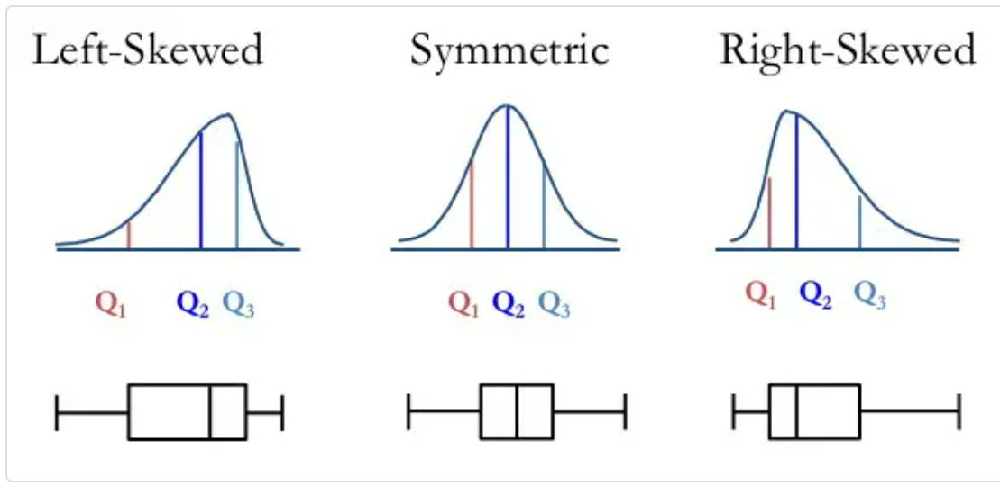

Box plots visually show the distribution of numerical data and skewness through displaying the data quartiles (or percentiles) and averages.

1. When the median is closer to the bottom of the box, and if the whisker is shorter on the lower end of the box, then the distribution is positively skewed (skewed right).

2. When the median is closer to the top of the box, and if the whisker is shorter on the upper end of the box, then the distribution is negatively skewed (skewed left).

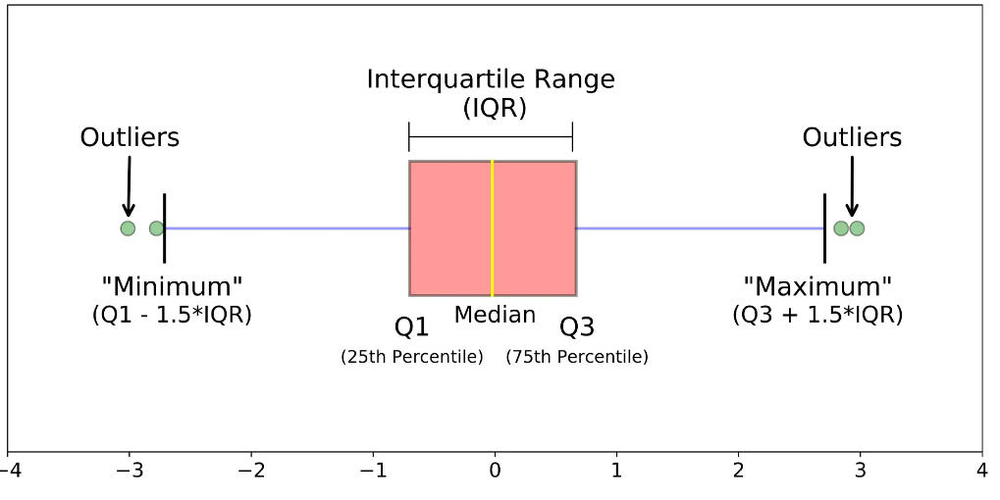

1. If the skewness is between -0.5 and 0.5, the data are fairly symmetrical. If the skewness is between -1 and – 0.5 or between 0.5 and 1, the data are moderately skewed. If the skewness is less than -1 or greater than 1, the data are highly skewed.

2. When the value of the skewness is negative, the tail of the distribution is longer towards the left hand side of the curve. and vice-versa

### Univariate/Bivariate distributions

In [170]:
# Removing few extreme ouliers for better understanding of the graphs

In [171]:
train_df.drop(train_df.loc[train_df['NoEmp']>60].index,inplace=True)
train_df.drop(train_df.loc[train_df['CreateJob']>20].index,inplace=True)
train_df.drop(train_df.loc[train_df['RetainedJob']>30].index,inplace=True)
train_df.drop(train_df.loc[train_df['DisbursementGross']>1500].index,inplace=True)
train_df.drop(train_df.loc[train_df['ChgOffPrinGr']>300].index,inplace=True)
train_df.drop(train_df.loc[train_df['GrAppv']>1500].index,inplace=True)
train_df.drop(train_df.loc[train_df['SBA_Appv']>800].index,inplace=True)

In [172]:
discrete_features

['ApprovalFY',
 'Newbusiness',
 'ApprovalDate_Year',
 'ApprovalDate_Month',
 'ApprovalDate_Day',
 'DisbursementDate_Year',
 'DisbursementDate_Month',
 'DisbursementDate_Day',
 'ChgOffDate_Year',
 'ChgOffDate_Month',
 'ChgOffDate_Day',
 'target']

In [173]:
discrete_features = ['ApprovalDate_Year', 'ApprovalFY', 'DisbursementDate_Year',
       'RetainedJob', 'ApprovalDate_Day', 'DisbursementDate_Day',
       'ChgOffDate_Day', 'ChgOffDate_Year', 'CreateJob', 'ApprovalDate_Month',
       'DisbursementDate_Month', 'ChgOffDate_Month', 'Newbusiness']

discrete_features

['ApprovalDate_Year',
 'ApprovalFY',
 'DisbursementDate_Year',
 'RetainedJob',
 'ApprovalDate_Day',
 'DisbursementDate_Day',
 'ChgOffDate_Day',
 'ChgOffDate_Year',
 'CreateJob',
 'ApprovalDate_Month',
 'DisbursementDate_Month',
 'ChgOffDate_Month',
 'Newbusiness']

In [174]:
def plot_comparison(data, col, title):
    fig, ax = plt.subplots(3, 1, sharex=True, figsize=[18,18])
    sns.histplot(data=train_df, x=col, kde=True,ax=ax[0],color = 'cornflowerblue')
    ax[0].set_title('Histogram + KDE')
    sns.boxenplot(x=col, ax=ax[1],color = 'cornflowerblue')
    ax[1].set_title('Boxplot')
    sns.violinplot(x=col,saturation=1, ax=ax[2],color = 'cornflowerblue', bw=.15,cut=0)
    ax[2].set_title('Violin plot')
    fig.suptitle(title, fontsize=16)
    plt.show()

Term
Skew : 1.23
no.of zeros : 13
% of zeros : 0.07
no.of nulls : 0
% of nulls : 0.0


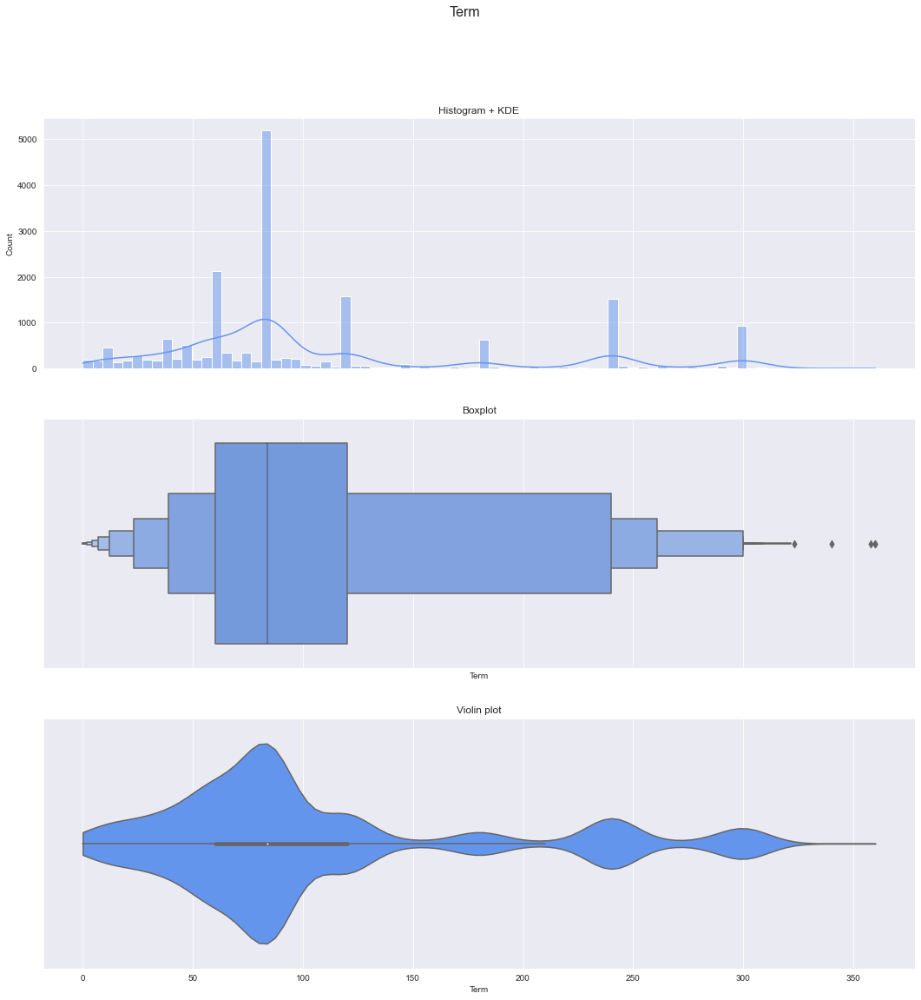

NoEmp
Skew : 2.62
no.of zeros : 153
% of zeros : 0.83
no.of nulls : 0
% of nulls : 0.0


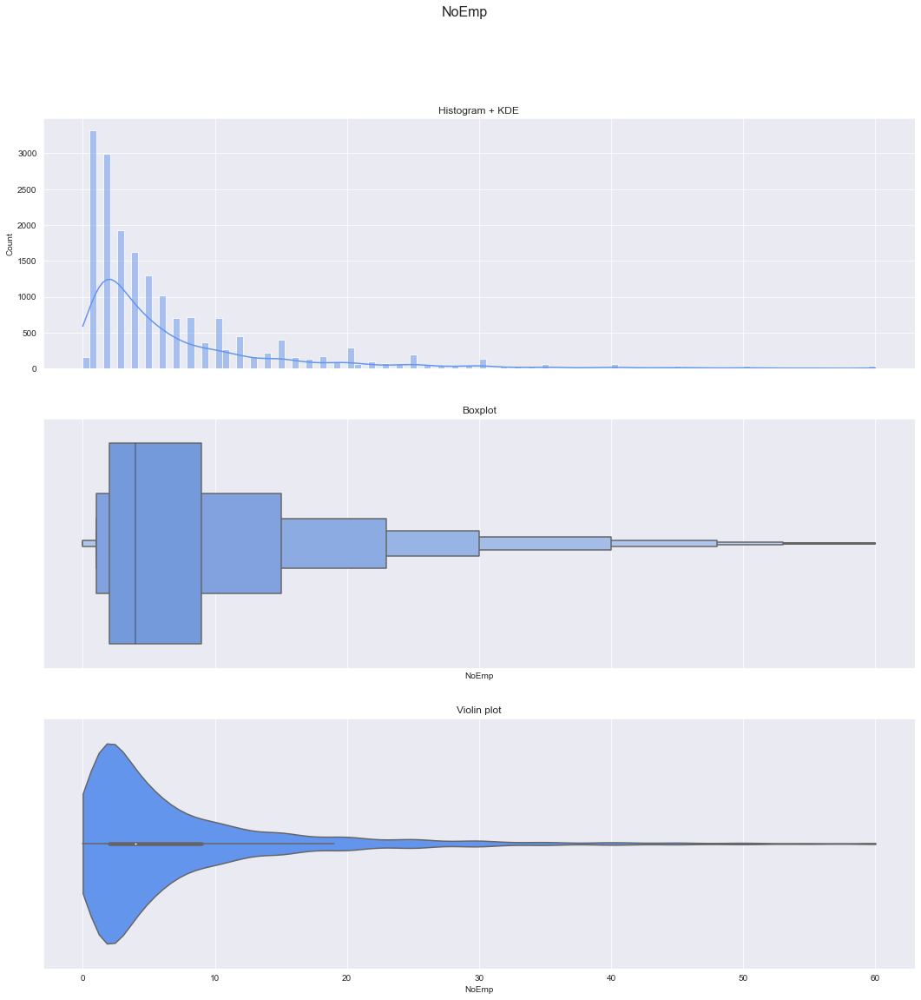

CreateJob
Skew : 3.57
no.of zeros : 13324
% of zeros : 71.96
no.of nulls : 0
% of nulls : 0.0


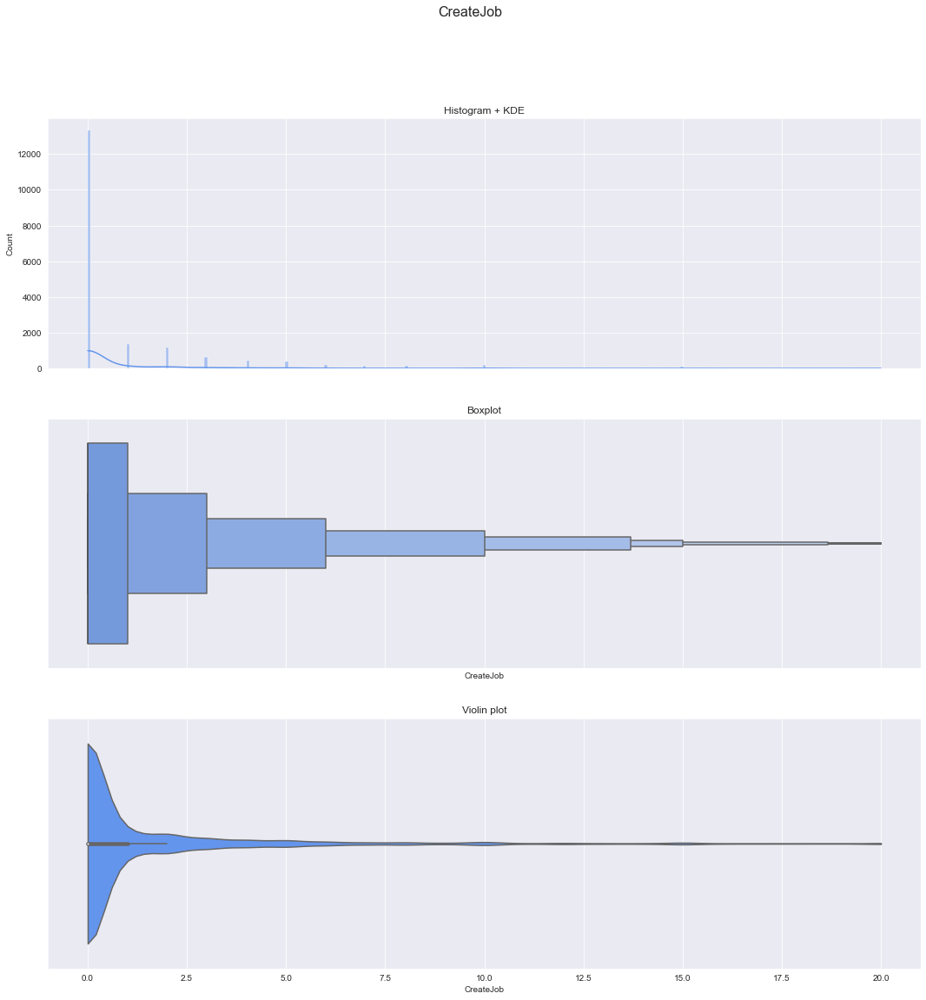

RetainedJob
Skew : 2.7
no.of zeros : 9338
% of zeros : 50.43
no.of nulls : 0
% of nulls : 0.0


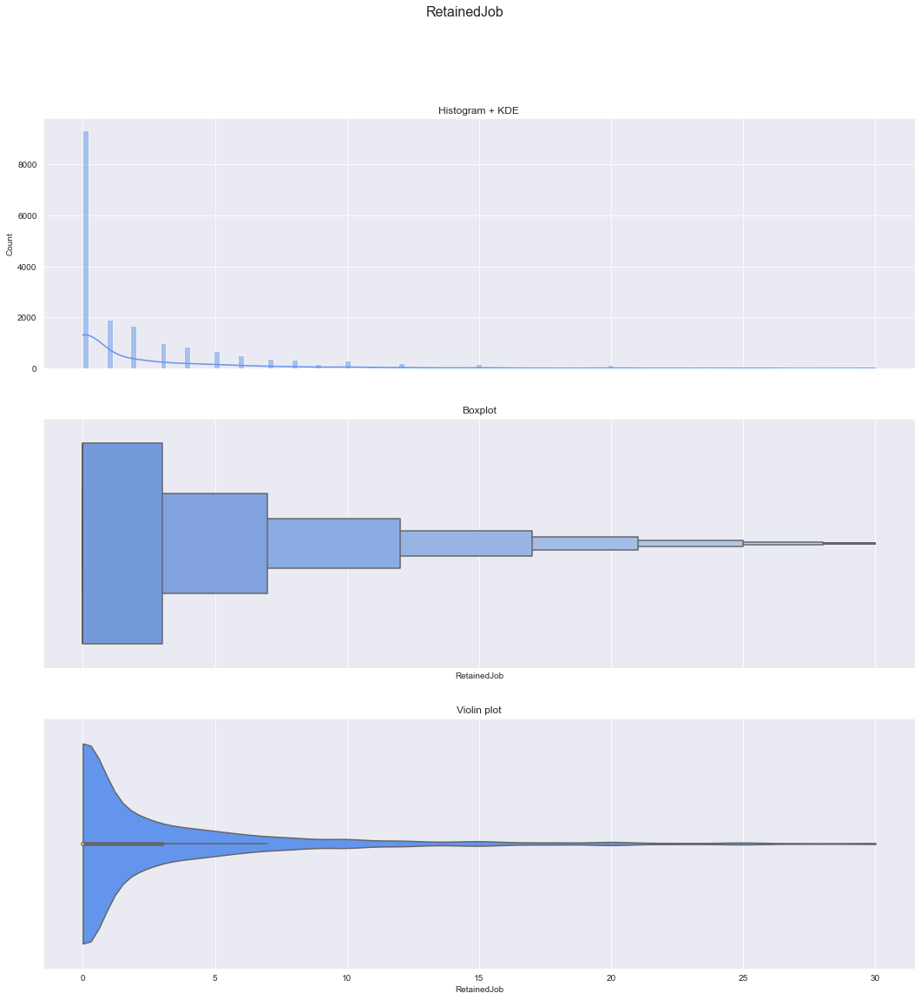

DisbursementGross
Skew : 2.41
no.of zeros : 0
% of zeros : 0.0
no.of nulls : 0
% of nulls : 0.0


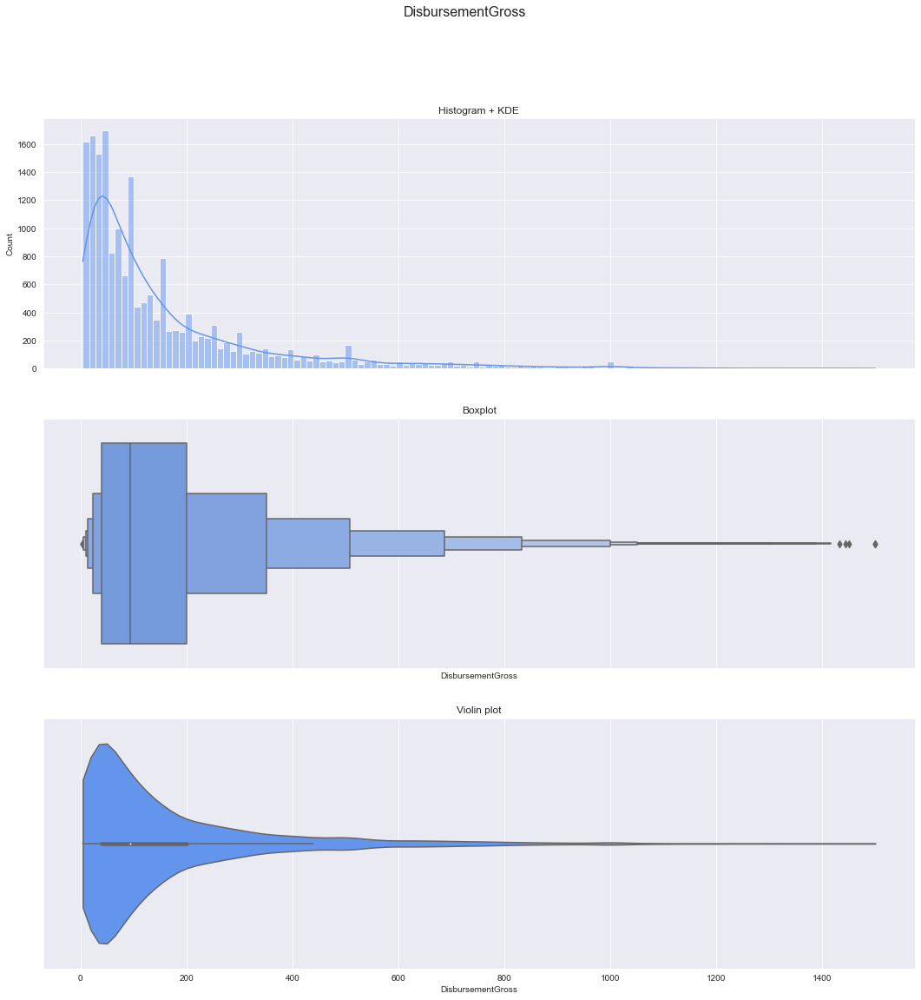

ChgOffPrinGr
Skew : 5.23
no.of zeros : 15235
% of zeros : 82.28
no.of nulls : 0
% of nulls : 0.0


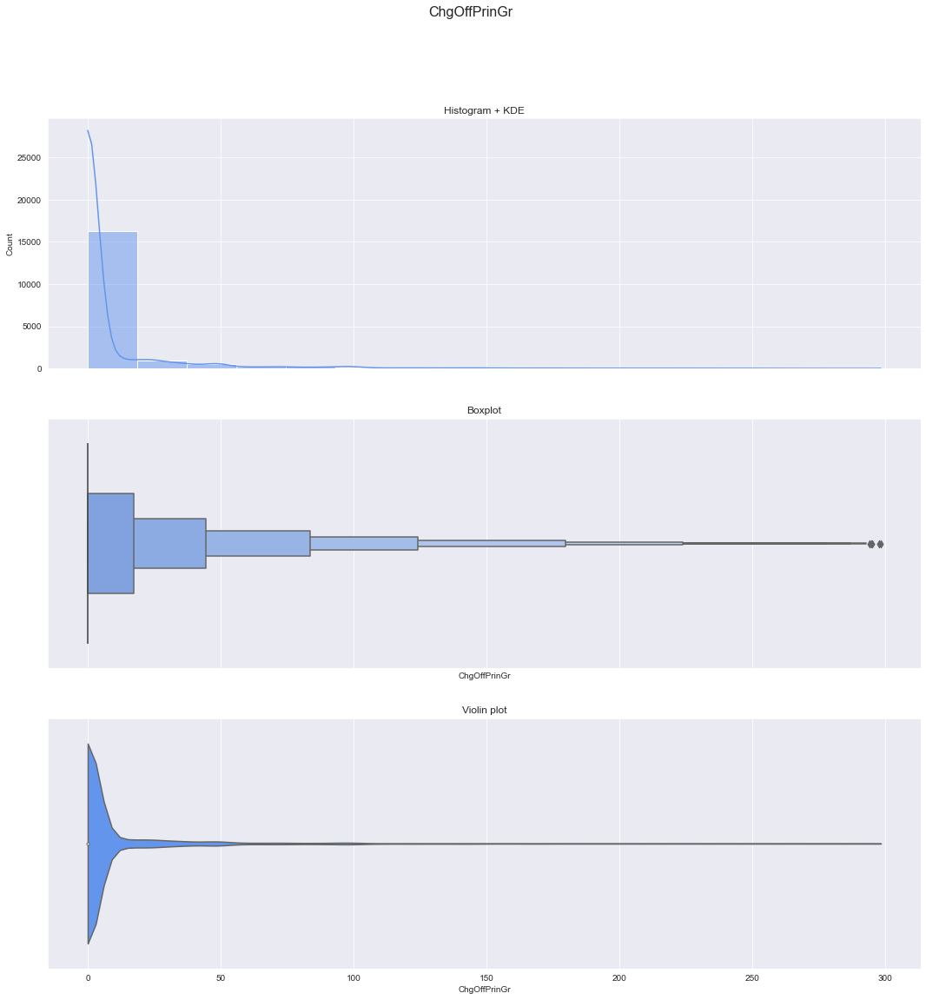

GrAppv
Skew : 2.43
no.of zeros : 0
% of zeros : 0.0
no.of nulls : 0
% of nulls : 0.0


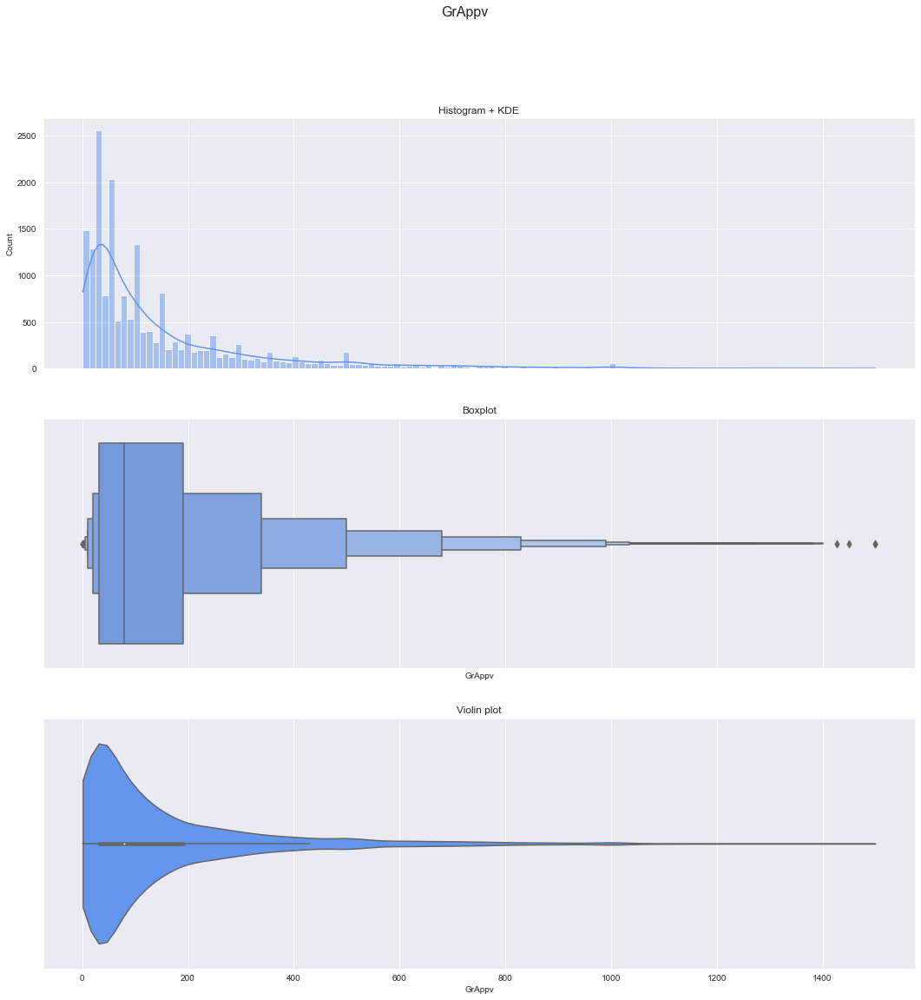

SBA_Appv
Skew : 2.18
no.of zeros : 0
% of zeros : 0.0
no.of nulls : 0
% of nulls : 0.0


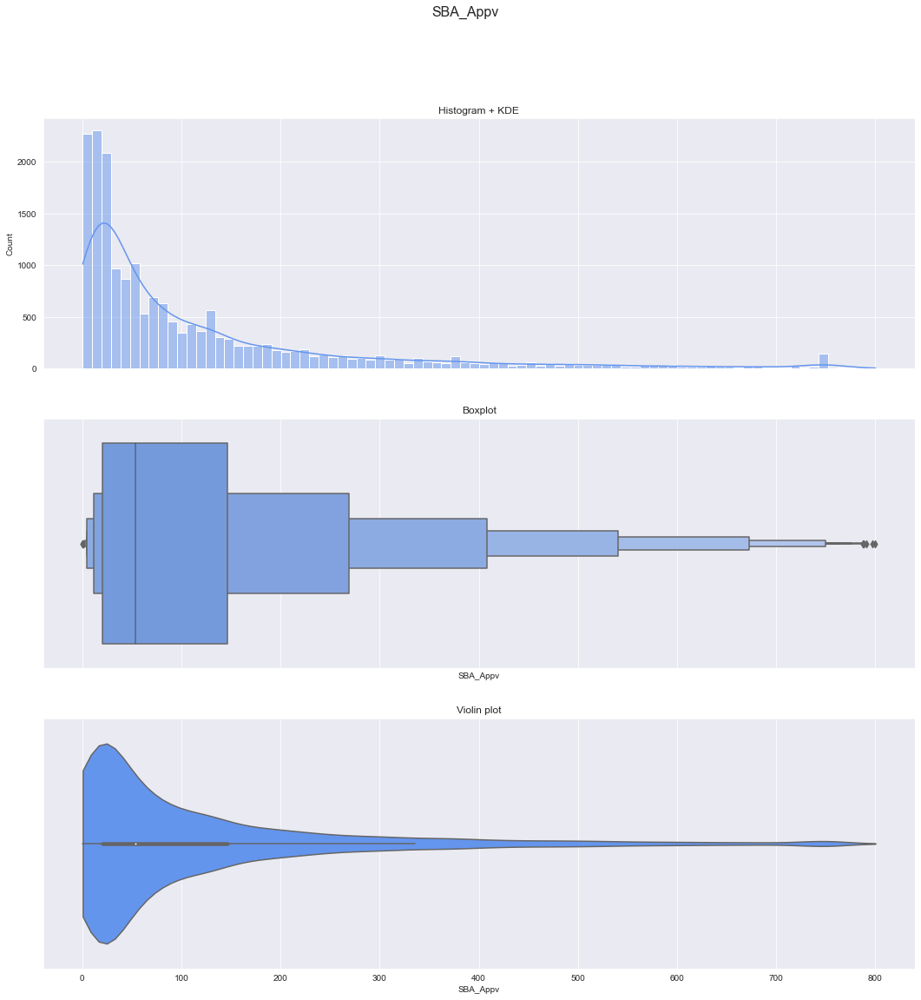

In [175]:
for col in continuous_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    print('no.of zeros :',(train_df[col]==0).sum())
    print('% of zeros :',np.round_((train_df[col]==0).sum()/len(train_df)*100,decimals=2))
    print('no.of nulls :',train_df[col].isna().sum())
    print('% of nulls :',np.round_(train_df[col].isna().sum()/len(train_df)*100,decimals=2))
    plot_comparison(train_df, train_df[col], col)

Term
no.of nulls : 0
% of nulls : 0.0
Skew : 1.23


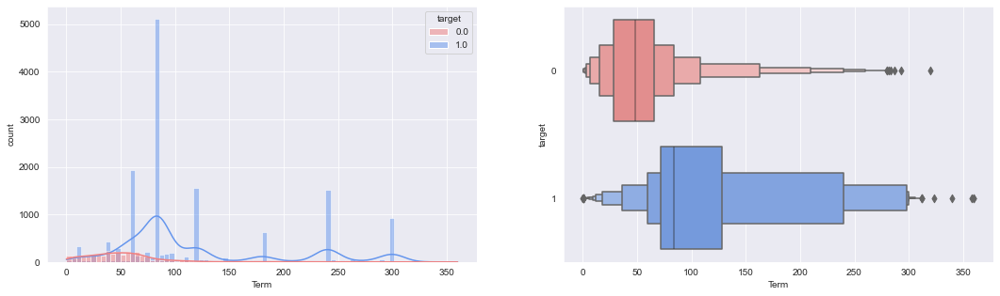

NoEmp
no.of nulls : 0
% of nulls : 0.0
Skew : 2.62


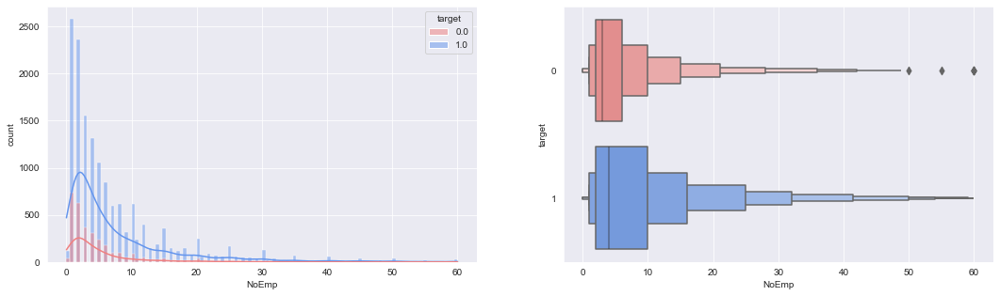

CreateJob
no.of nulls : 0
% of nulls : 0.0
Skew : 3.57


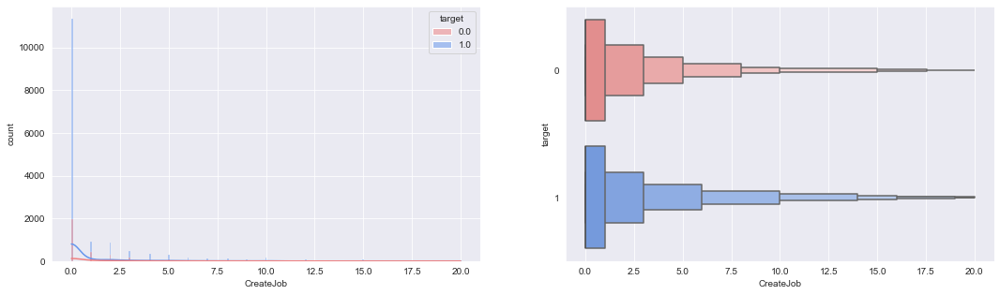

RetainedJob
no.of nulls : 0
% of nulls : 0.0
Skew : 2.7


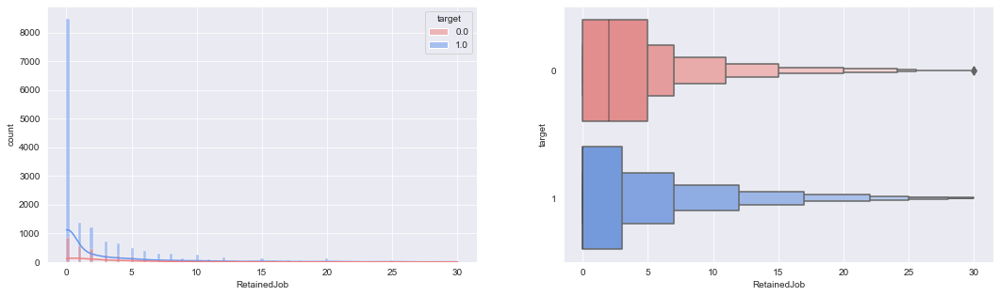

DisbursementGross
no.of nulls : 0
% of nulls : 0.0
Skew : 2.41


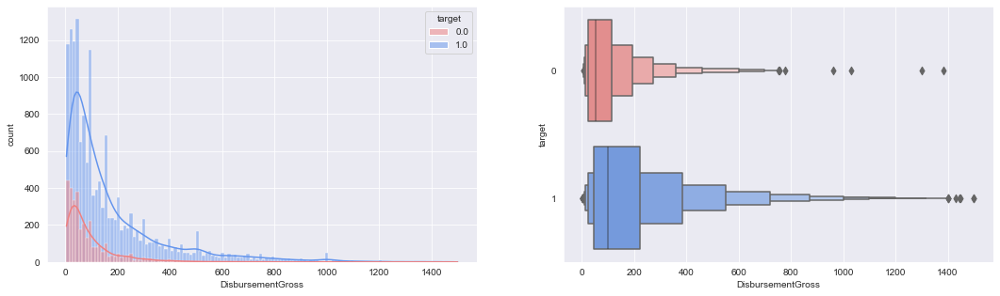

ChgOffPrinGr
no.of nulls : 0
% of nulls : 0.0
Skew : 5.23


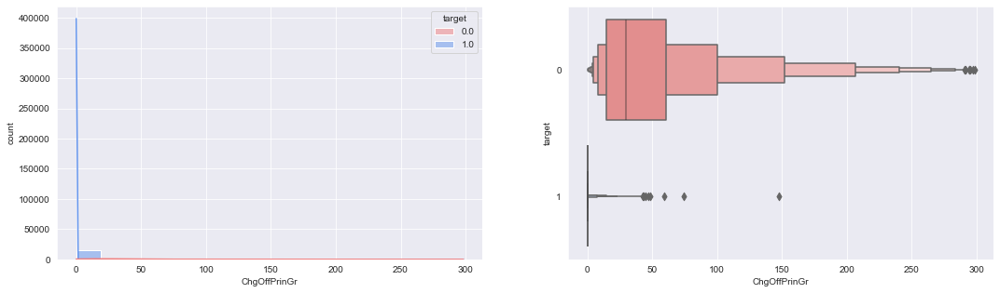

GrAppv
no.of nulls : 0
% of nulls : 0.0
Skew : 2.43


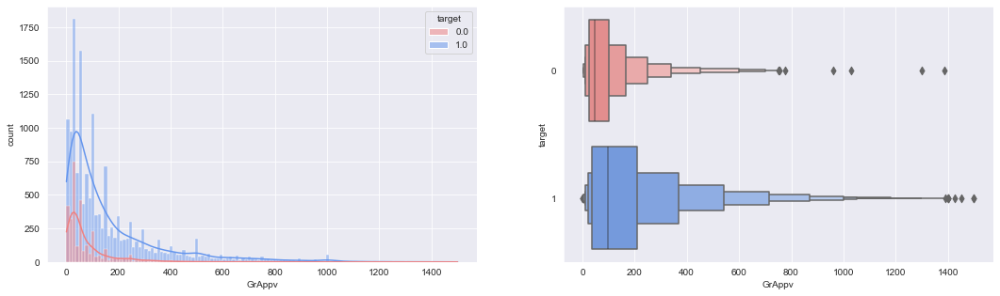

SBA_Appv
no.of nulls : 0
% of nulls : 0.0
Skew : 2.18


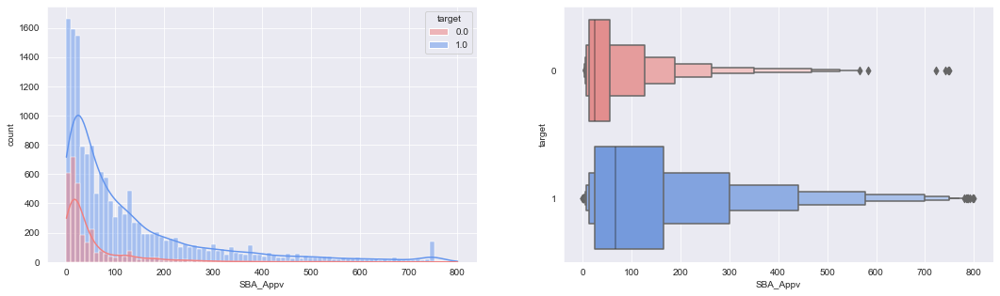

In [176]:
for col in continuous_features:
    print(col)
    print('no.of nulls :',train_df[col].isna().sum())
    print('% of nulls :',np.round_(train_df[col].isna().sum()/len(train_df)*100,decimals=2))
    print('Skew :', round(train_df[col].skew(), 2))
    plt.figure(figsize = (18,5))
    plt.subplot(1, 2, 1)
    sns.histplot(data=train_df, x=col, kde=True,hue='target',palette=['lightcoral','cornflowerblue'])
    plt.xlabel(col)
    plt.ylabel('count')
    plt.subplot(1, 2, 2)
    sns.boxenplot(data=train_df, x=col, y='target', order=[0,1],orient='h',palette=['lightcoral','cornflowerblue'])
    plt.show()

Term
Skew : 1.23


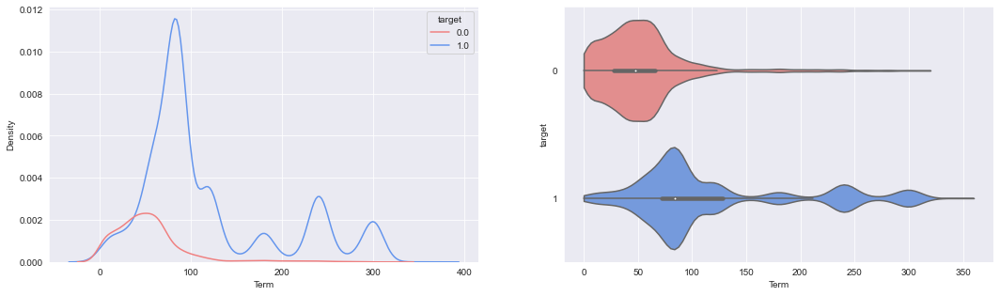

NoEmp
Skew : 2.62


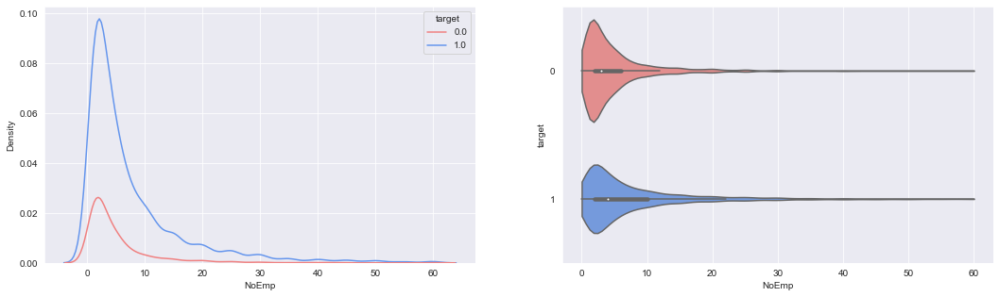

CreateJob
Skew : 3.57


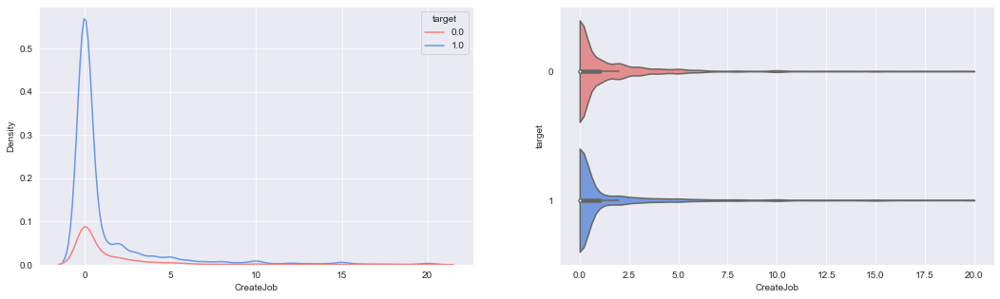

RetainedJob
Skew : 2.7


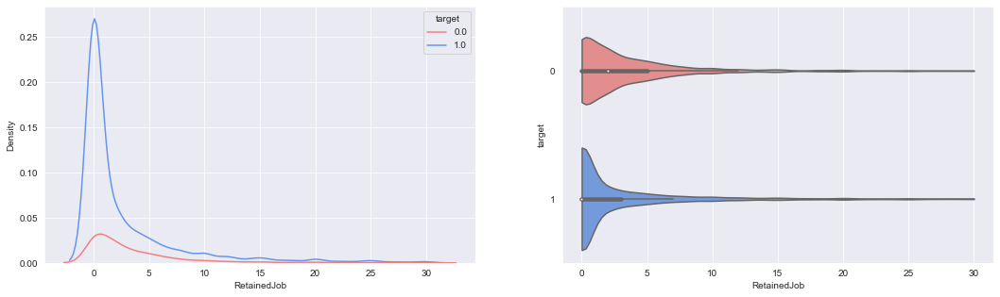

DisbursementGross
Skew : 2.41


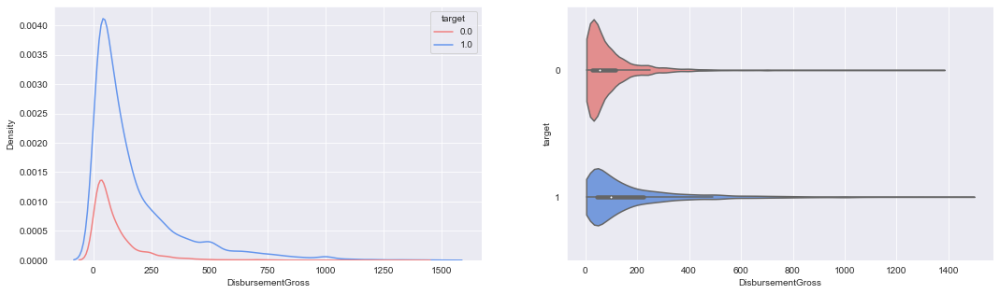

ChgOffPrinGr
Skew : 5.23


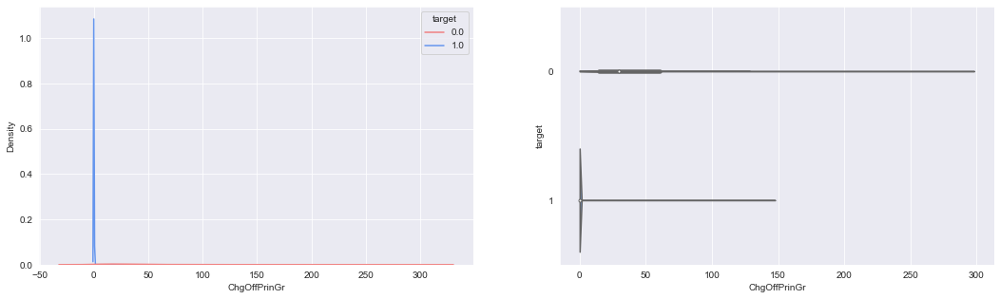

GrAppv
Skew : 2.43


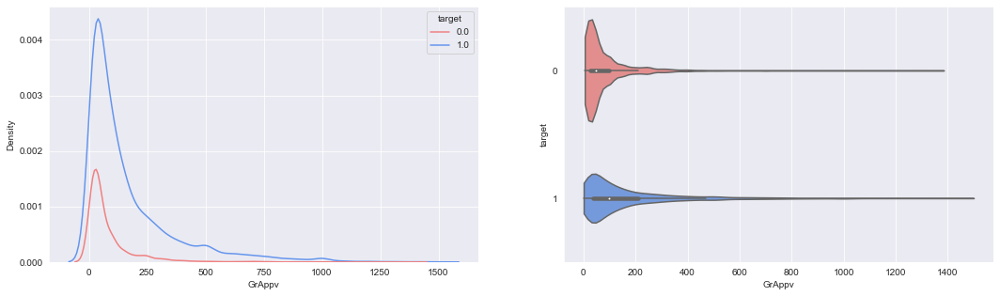

SBA_Appv
Skew : 2.18


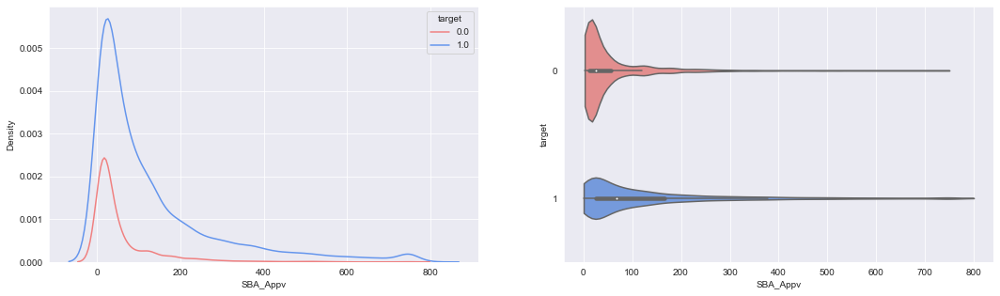

In [177]:
for col in continuous_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    plt.figure(figsize = (18,5))
    plt.subplot(1, 2, 1)
    sns.kdeplot(data=train_df, x=col,hue='target',palette=['lightcoral','cornflowerblue'])
    plt.xlabel(col)
    plt.ylabel('Density')
    plt.subplot(1, 2, 2)
    #sns.violinplot(x=train_df[col],saturation=1)
    sns.violinplot(data=train_df, x=col, y='target', order=[0,1],orient='h',palette=['lightcoral','cornflowerblue'], bw=.15,cut=0)
    plt.show()

#### If you want to check whether feature is guassian or normal distributed
#### Q-Q plot

In [178]:
import scipy.stats as stat
import pylab 

_, p = stats.normaltest(df[col].to_numpy())
print(p)

Term
Skew : 1.23
0.0


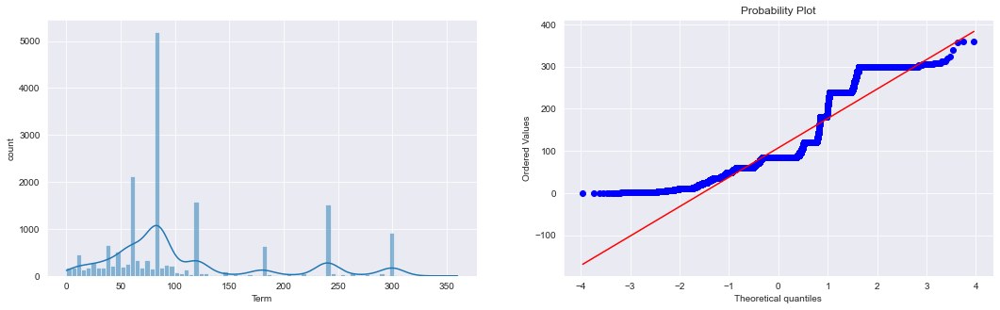

NoEmp
Skew : 2.62
0.0


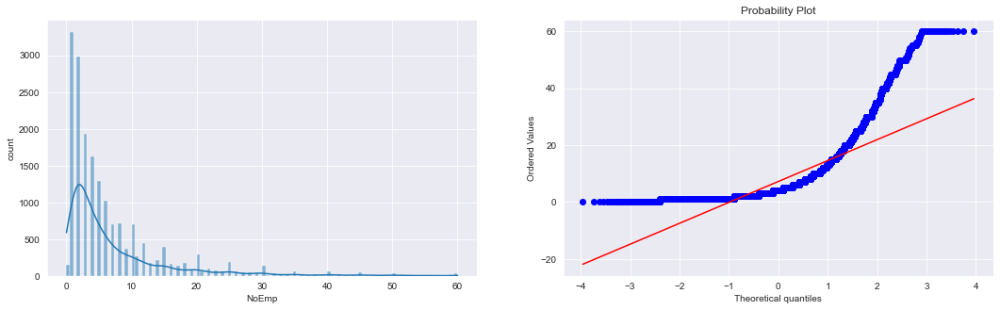

CreateJob
Skew : 3.57
0.0


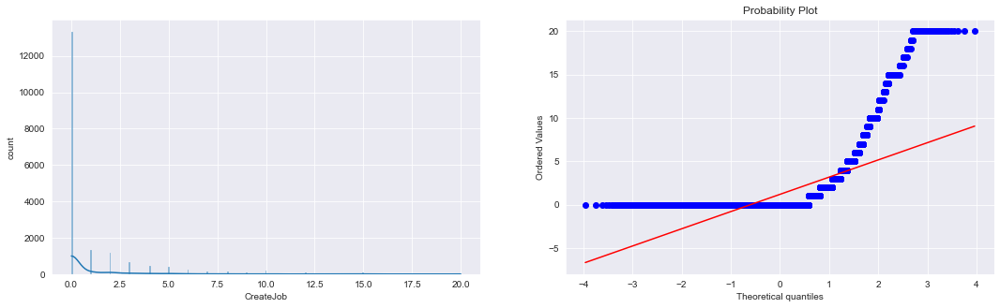

RetainedJob
Skew : 2.7
0.0


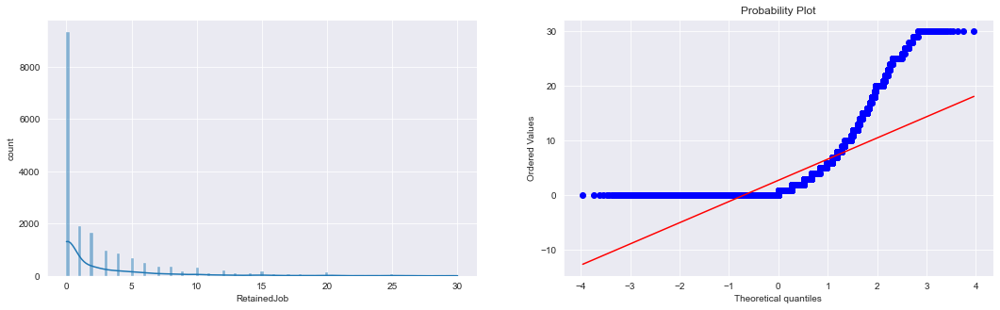

DisbursementGross
Skew : 2.41
0.0


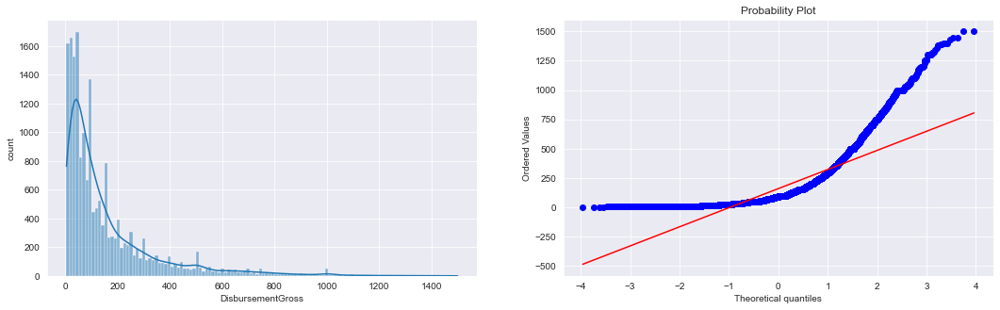

ChgOffPrinGr
Skew : 5.23
0.0


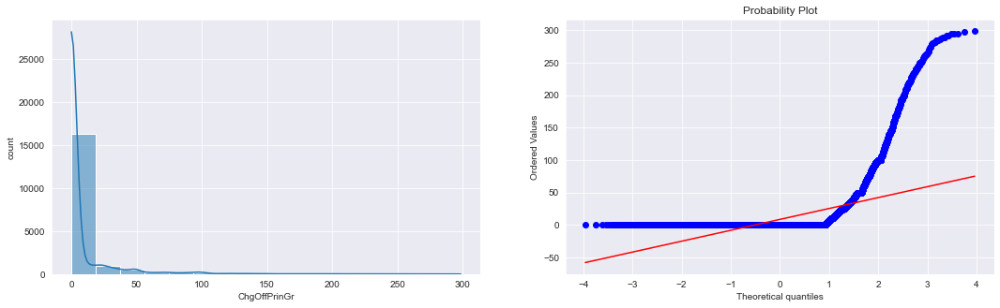

GrAppv
Skew : 2.43
0.0


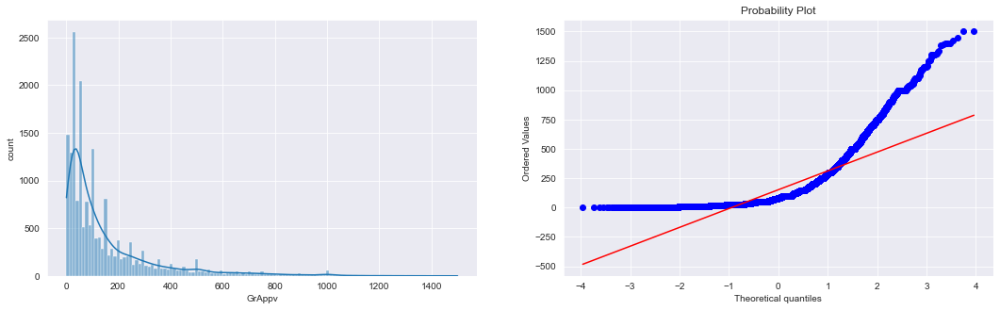

SBA_Appv
Skew : 2.18
0.0


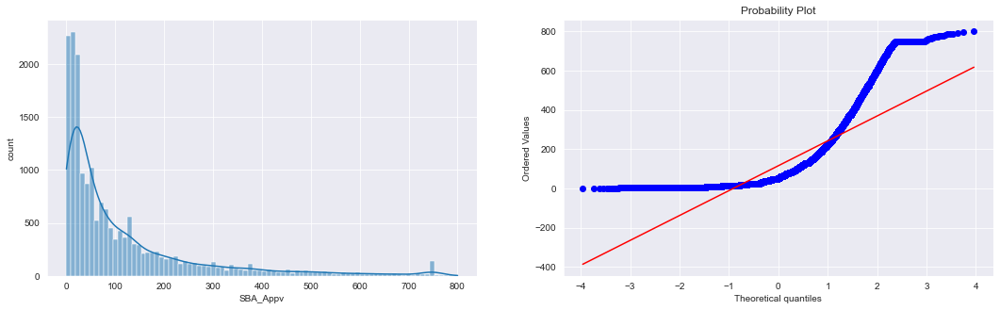

In [179]:
for col in continuous_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    _, p = stat.normaltest(train_df[col].to_numpy())
    print(p)
    plt.figure(figsize = (18,5))
    plt.subplot(1, 2, 1)
    sns.histplot(data=train_df, x=col, kde=True)
    plt.xlabel(col)
    plt.ylabel('count')
    plt.subplot(1, 2, 2)
    stat.probplot(train_df[col],dist='norm',plot=pylab)
    plt.show()

1. A normal fasting blood glucose level is lower than 95 mg/dL (5.3 mmol/L). One hour after drinking the glucose solution, a normal blood glucose level is lower than 180 mg/dL (10 mmol/L). Two hours after drinking the glucose solution, a normal blood glucose level is lower than 155 mg/dL (8.6 mmol/L).
2. Insulin allows the cells in the muscles, fat and liver to absorb glucose that is in the blood. The glucose serves as energy to these cells, or it can be converted into fat when needed

### Observations :

1. From above we can see that 'Glucose' is close to normal distribution with slightly right skewed.
   And it seems we got the Glucose values measured after taking the meal(assuming) and we can observe that Healthy peoples        Glucose values concentrated around 90-130 while the Diabetic people values spread across 130-190 and we have one outlier(we can ignore) in the entire dist. and we can observe that there are outliers Healthy people Glucsoe values dist (despite the abnormal values people are healthy)
2. 'BloodPressure' is also very close to normal dist. and we can't really observe any difference between Healthy and Diabetic peoples BloodPressure values both are concentrated around 70-90 with few outliers. we cannot really call them as ouliers except the lower end values because the highest value is little over 120 which is normal.
3. 'SkinThickness' seems right skewed but if you ignore that one outlier its close to normal dist. Even though both the Healthy and Diabetic peoples dist. overlaping mojorly but we can see that the Diabetic peoples SkinThickness is more compared to Healthy people.
4. 'Insulin' is heavily right skewed and have quite no.of outliers. and we can observe that the concentration of Insulin values of Diabetic people are higher than the Healthy people
5. 'BMI' is slightly right skewed and have few outliers. and we can observe that the concentration of BMI values of Diabetic people(around 30-40) are higher than the Healthy people(around 25-35)
6. 'DiabetesPedigreeFunction' is slightly right skewed and have few outliers. and we can observe that even though the concentration of BMI values of Diabetic and Healthy people overlap but the dist. of Diabetic people is more right skewed with more higher values.
7. 'Age' is right skewed and we can observe that even though the concentration of Age values of Diabetic and Healthy people overlap majorly but the dist. of Diabetic peoples Age is more right skewed with more higher values.

In [180]:
train_df.columns

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'ApprovalFY', 'Term',
       'NoEmp', 'CreateJob', 'RetainedJob', 'UrbanRural', 'RevLineCr',
       'LowDoc', 'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'Has_Franchise', 'ApprovalDate_Year',
       'ApprovalDate_Month', 'ApprovalDate_Day', 'DisbursementDate_Year',
       'DisbursementDate_Month', 'DisbursementDate_Day', 'ChgOffDate_Year',
       'ChgOffDate_Month', 'ChgOffDate_Day', 'target'],
      dtype='object')

### Visualizing bivariate/multivariate distributions

sns.pairplot(train_df, hue='target',palette=['lightcoral','cornflowerblue'])

#### Its not clear to observe graphs closely we will plot indvidual plots for some features

In [181]:
continuous_features

['Term',
 'NoEmp',
 'CreateJob',
 'RetainedJob',
 'DisbursementGross',
 'ChgOffPrinGr',
 'GrAppv',
 'SBA_Appv']

Term


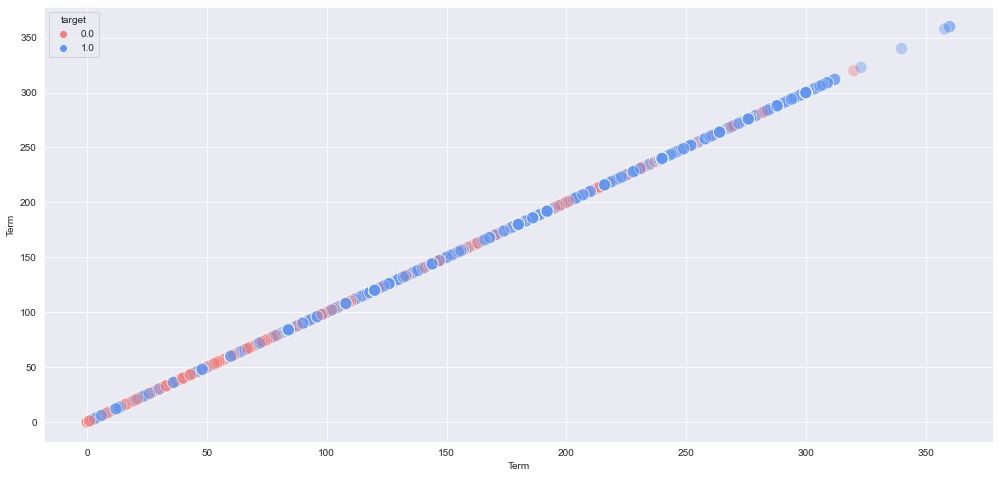

NoEmp


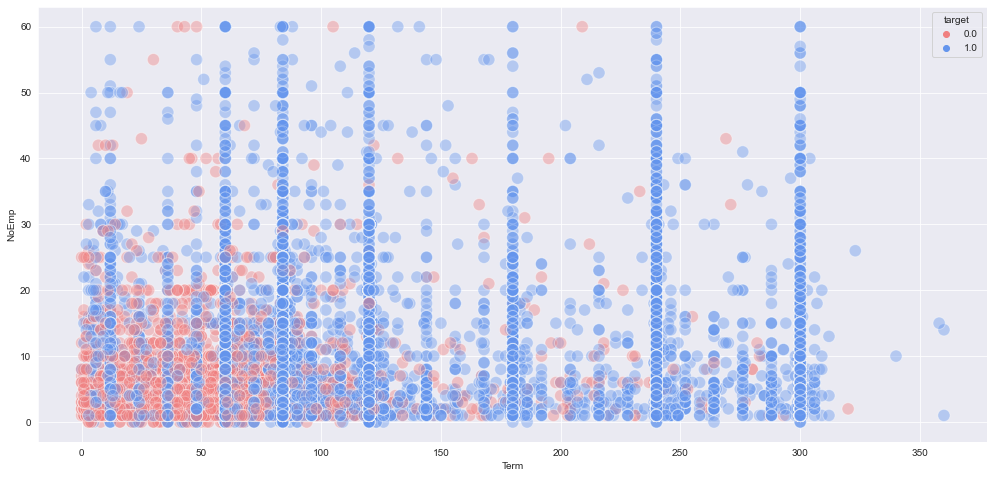

CreateJob


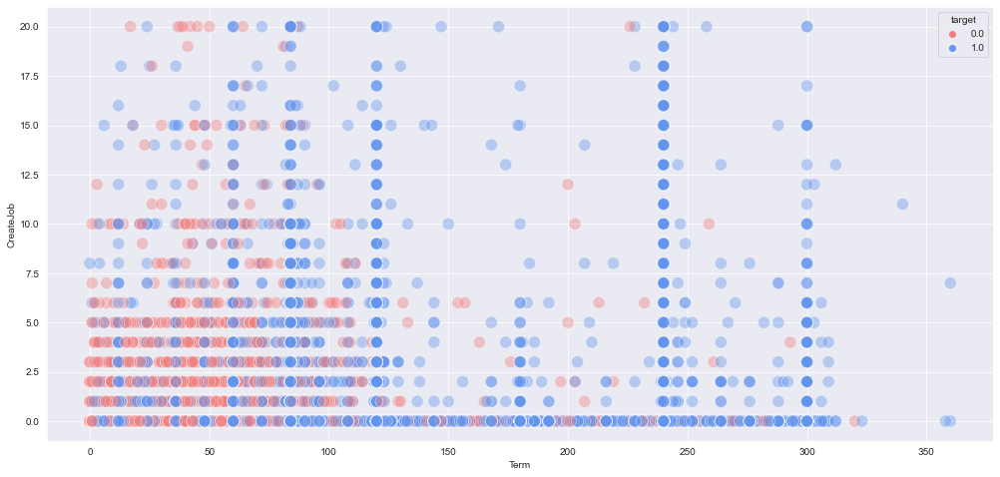

RetainedJob


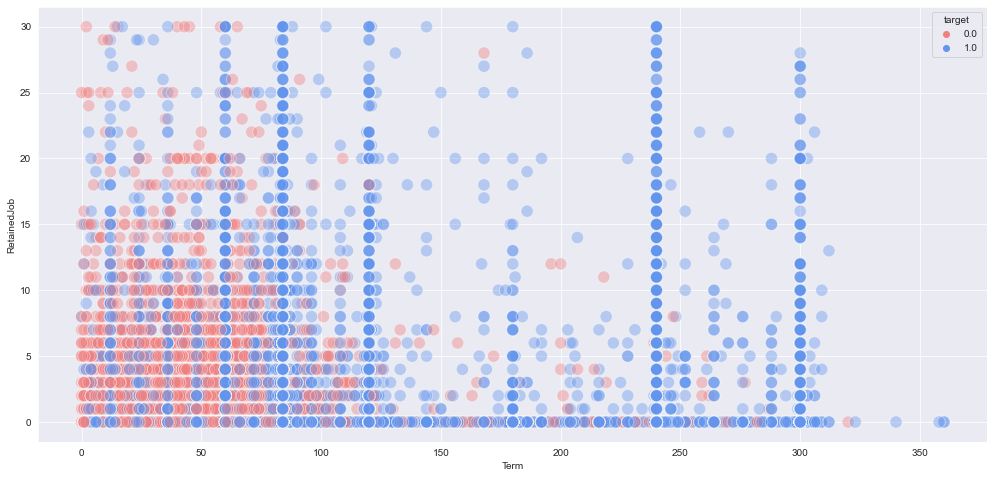

DisbursementGross


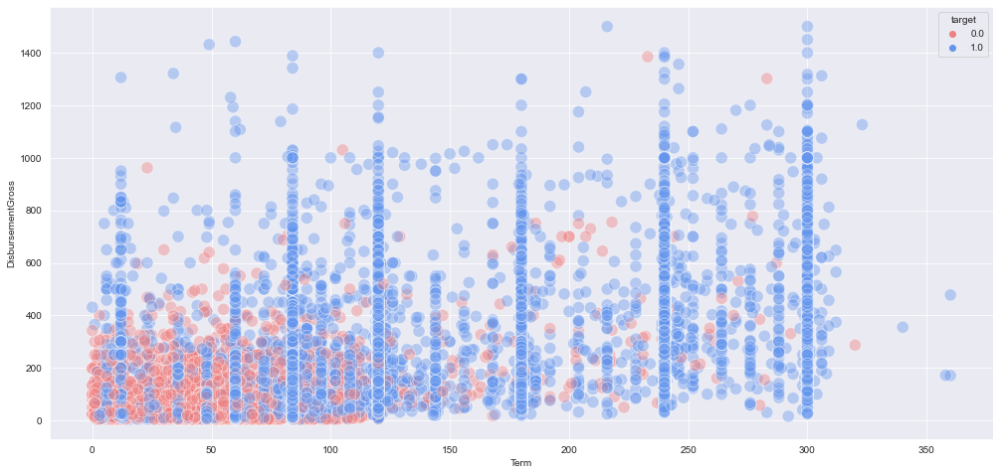

ChgOffPrinGr


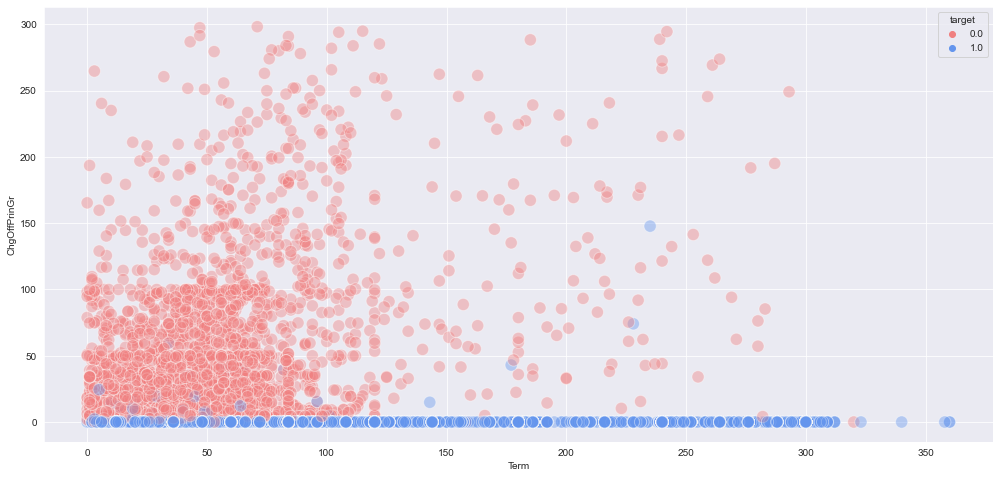

GrAppv


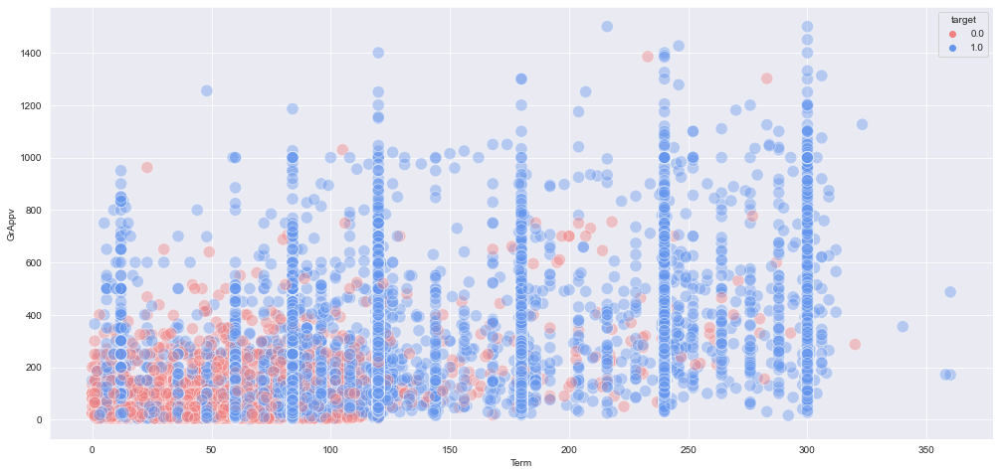

SBA_Appv


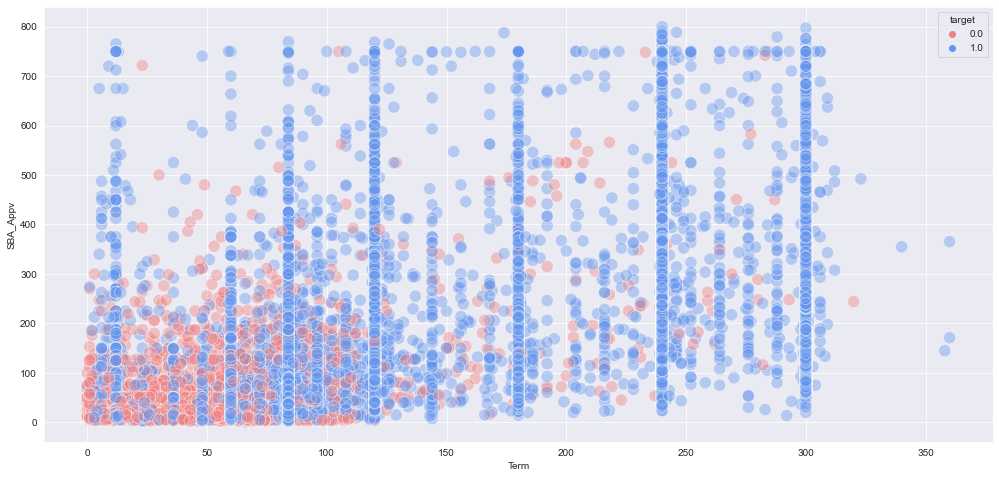

In [182]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (17,8))
    sns.scatterplot(data=train_df, x='Term',y=col,hue='target',palette=['lightcoral','cornflowerblue'],alpha=0.4,s=150)
    plt.xlabel('Term')
    plt.ylabel(col)
    plt.show()

### Observations :

1. From Age vs [Glucose,Insulin,BMI,DiabetesPedigreeFunction] we can observe that there is no clear relationship between Age and [Glucose,Insulin,BMI,DiabetesPedigreeFunction]. Diabetic people have high [Glucose,Insulin] values compared to healthy people but in the case of [BMI,DiabetesPedigreeFunction] even the Diabetic people have lower/normal values also irrespective of their Age.
2. And there is not a clear relation ship between 'Age' and [BloodPressure,SkinThickness,BMI] 

Term


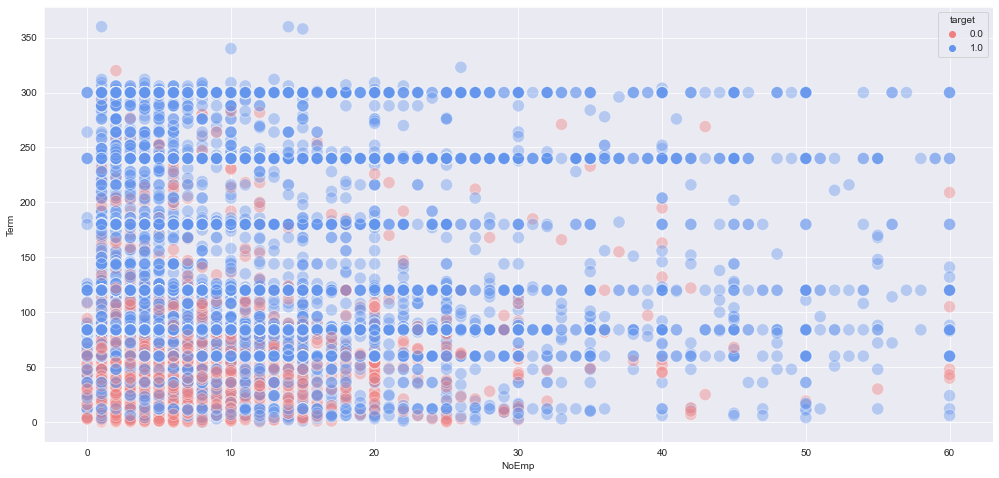

NoEmp


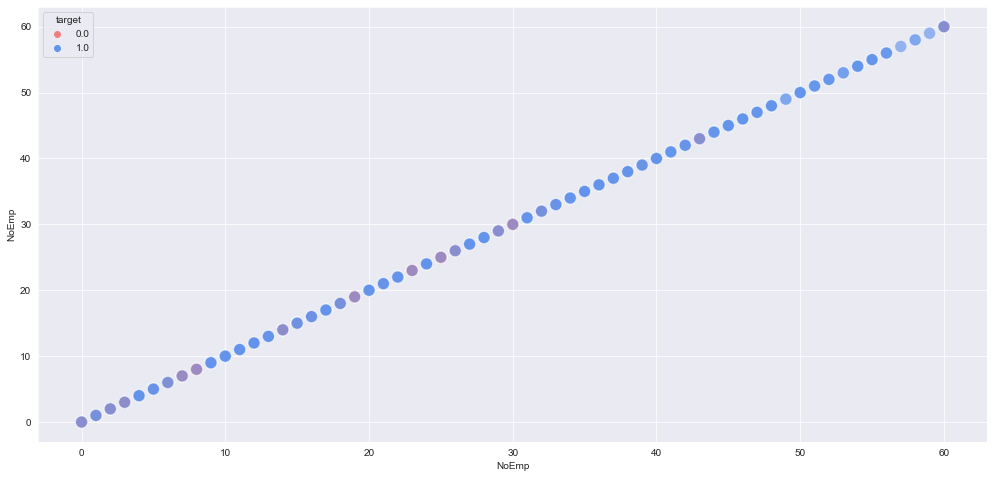

CreateJob


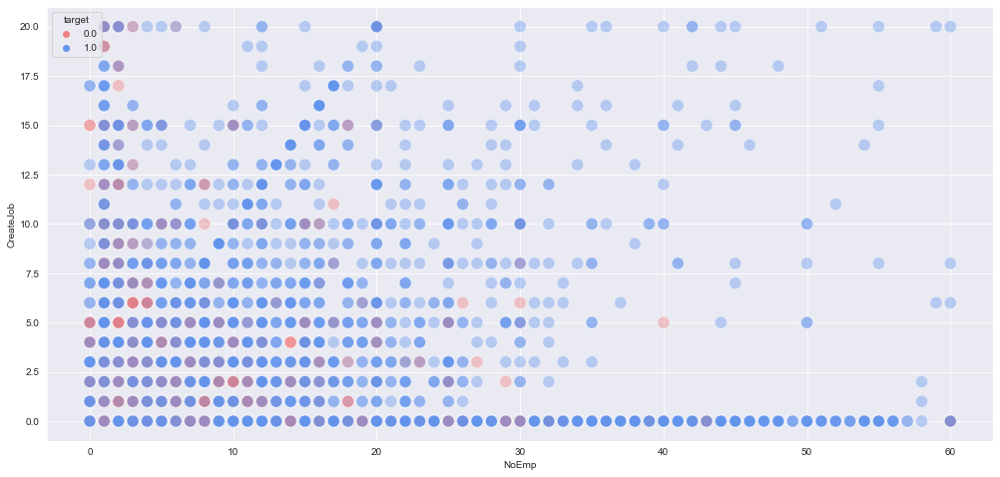

RetainedJob


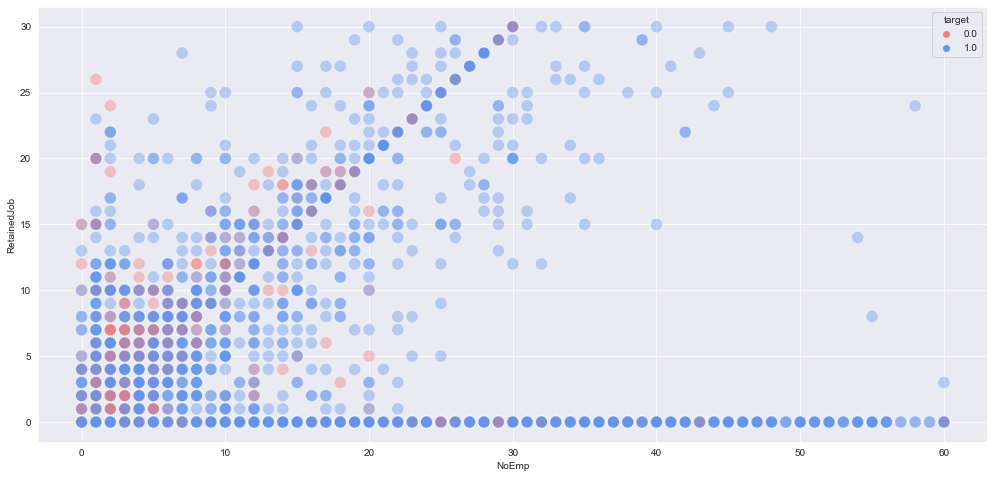

DisbursementGross


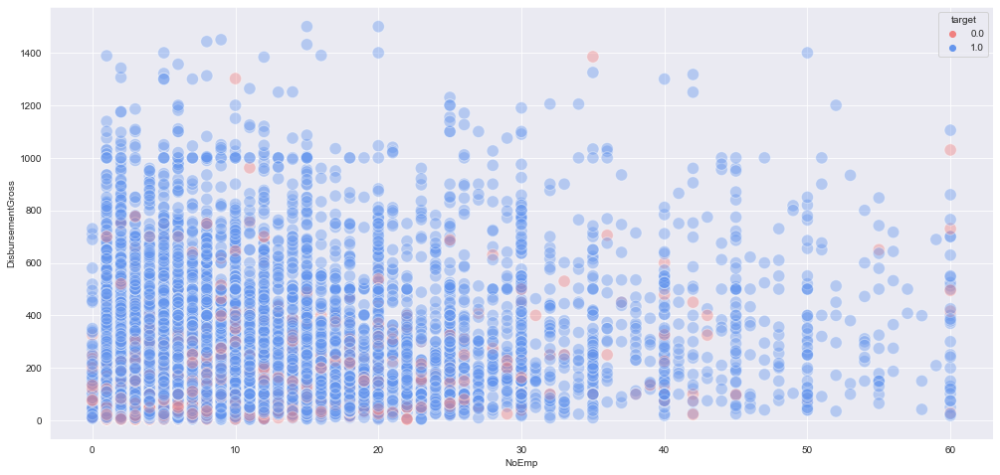

ChgOffPrinGr


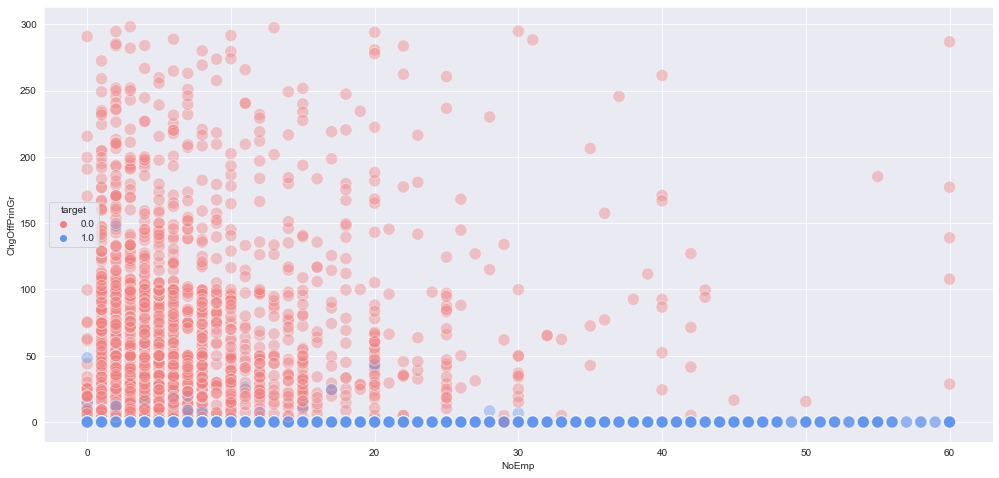

GrAppv


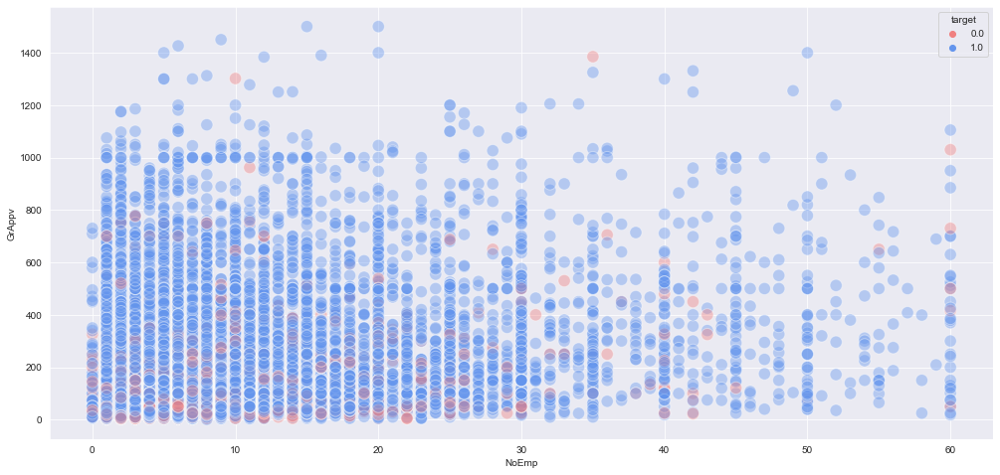

SBA_Appv


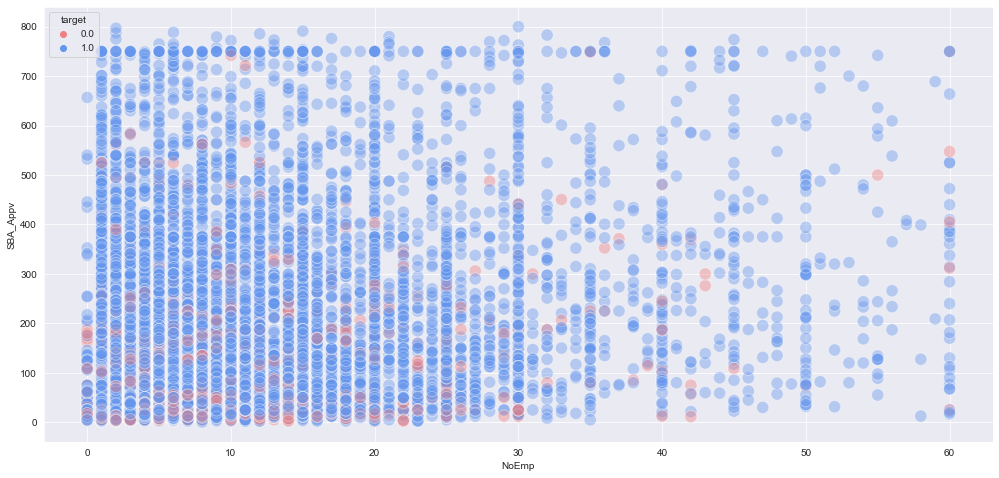

In [183]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (17,8))
    sns.scatterplot(data=train_df, x='NoEmp',y=col,hue='target',palette=['lightcoral','cornflowerblue'],alpha=0.4,s=150)
    plt.xlabel('NoEmp')
    plt.ylabel(col)
    plt.show()

Term


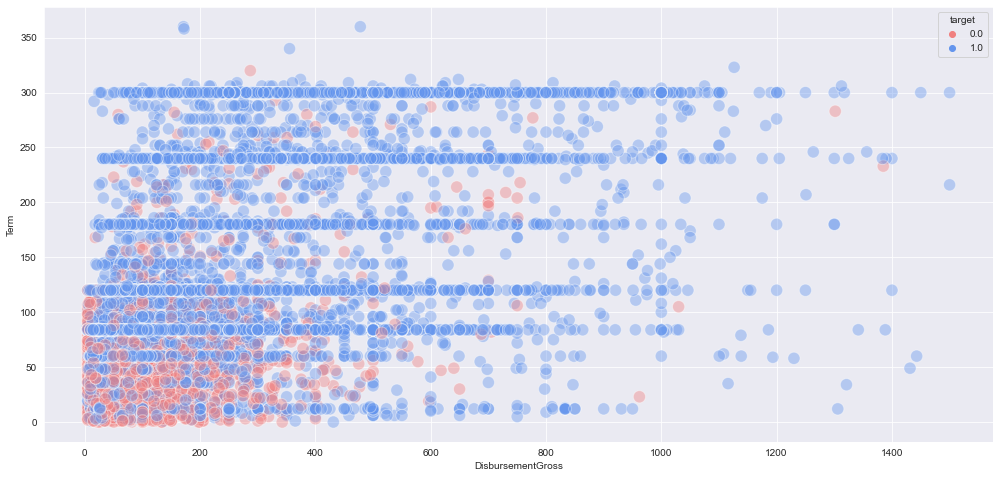

NoEmp


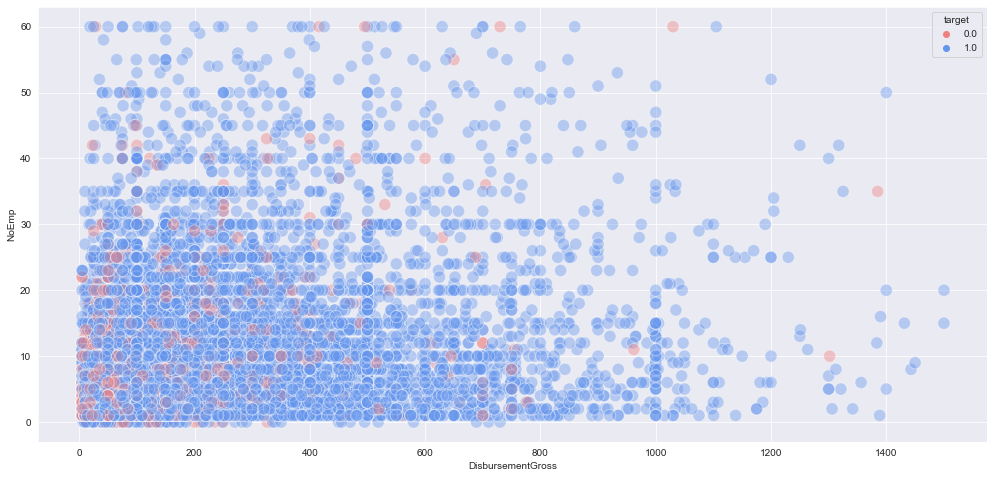

CreateJob


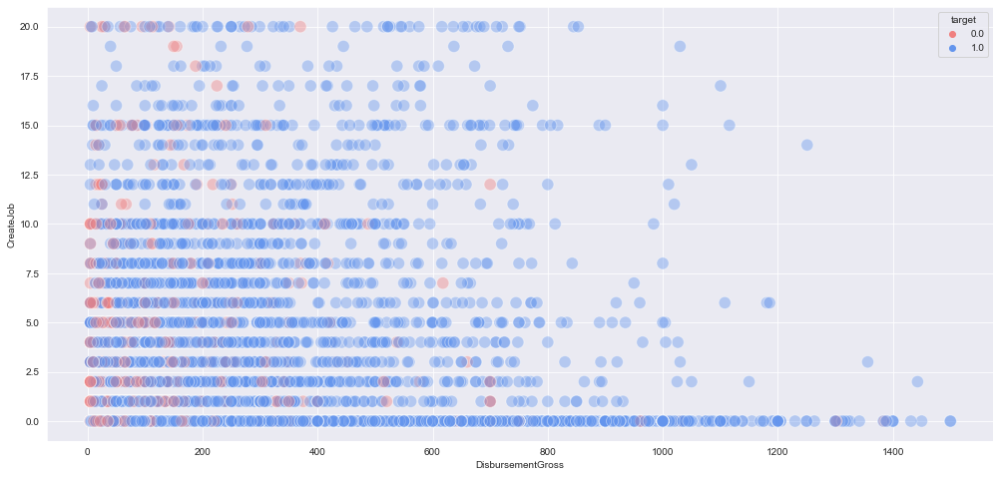

RetainedJob


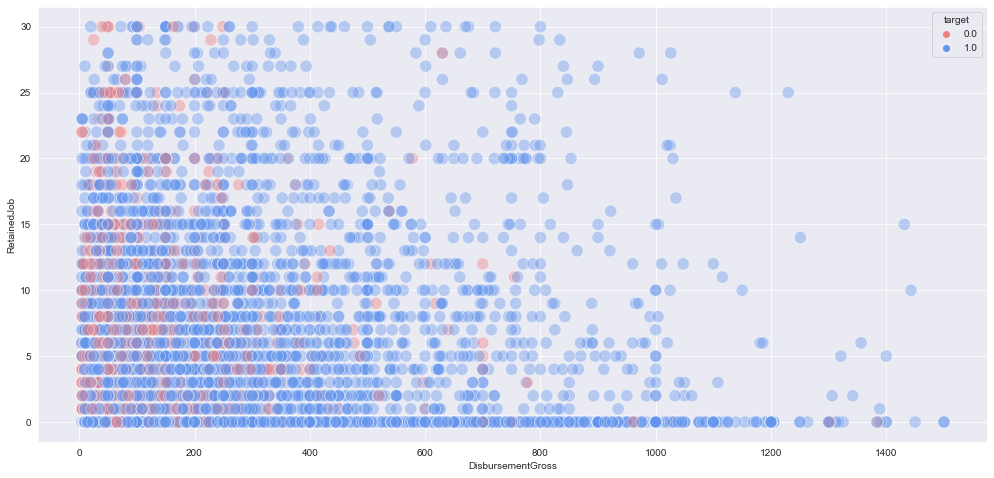

DisbursementGross


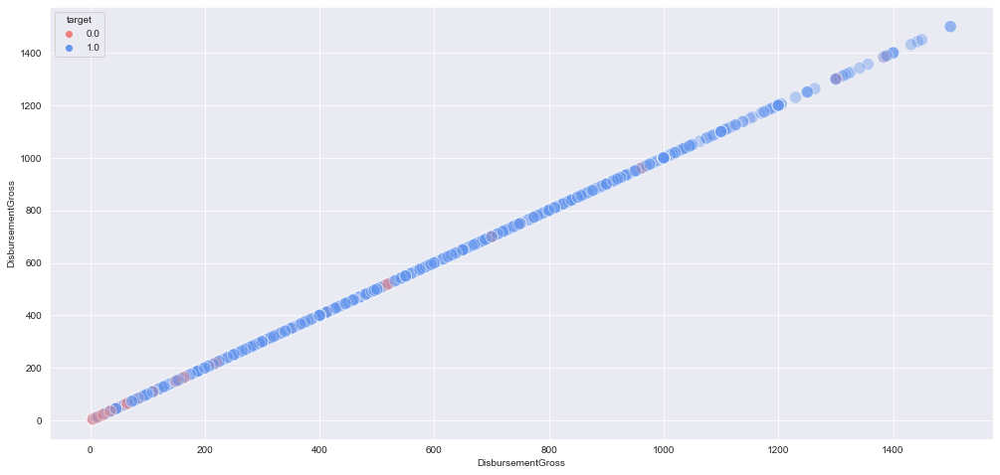

ChgOffPrinGr


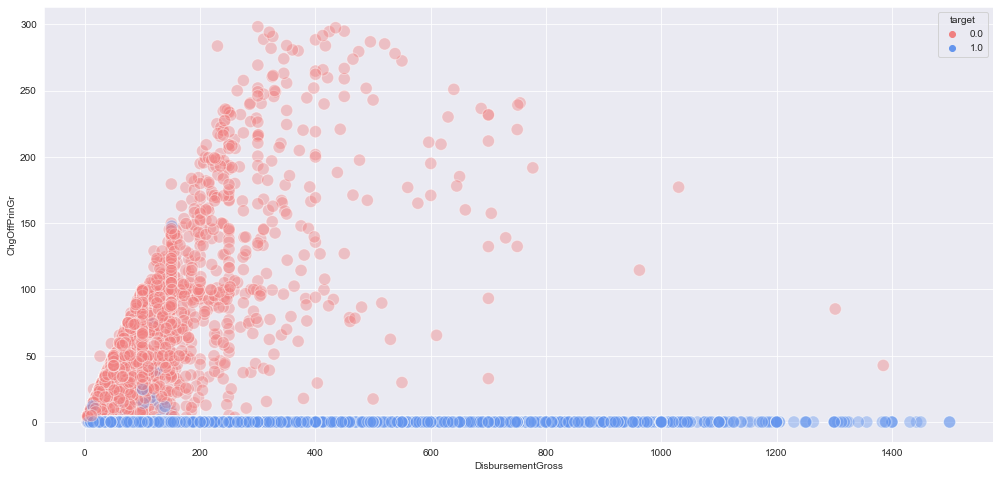

GrAppv


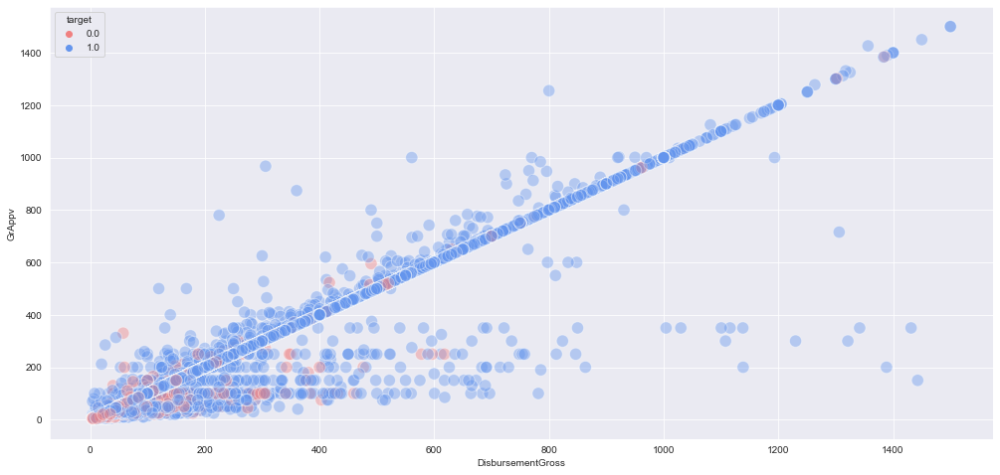

SBA_Appv


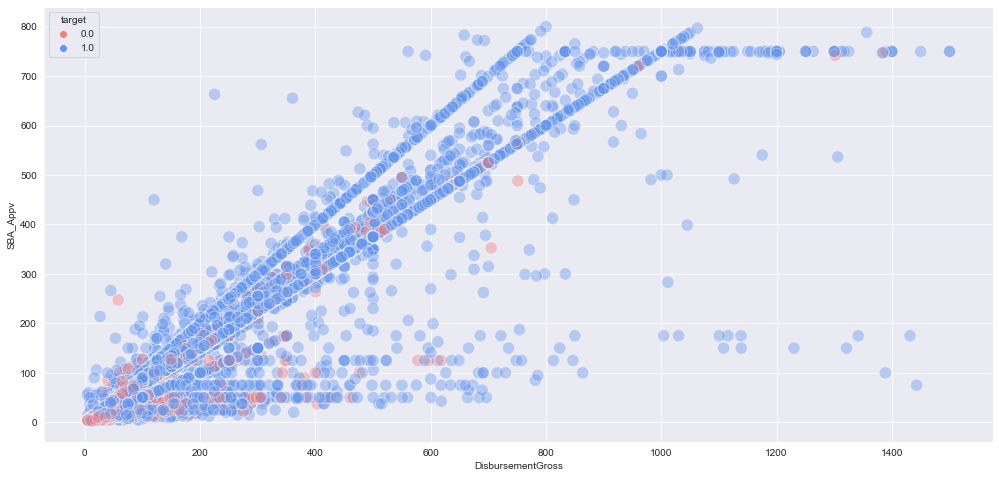

In [184]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (17,8))
    sns.scatterplot(data=train_df, x='DisbursementGross',y=col,hue='target',palette=['lightcoral','cornflowerblue'],alpha=0.4,s=150)
    plt.xlabel('DisbursementGross')
    plt.ylabel(col)
    plt.show()

Term


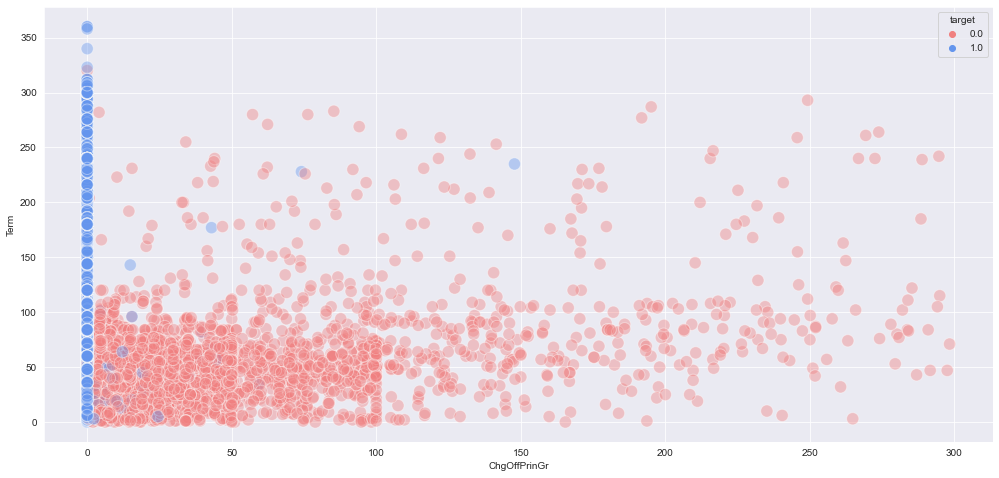

NoEmp


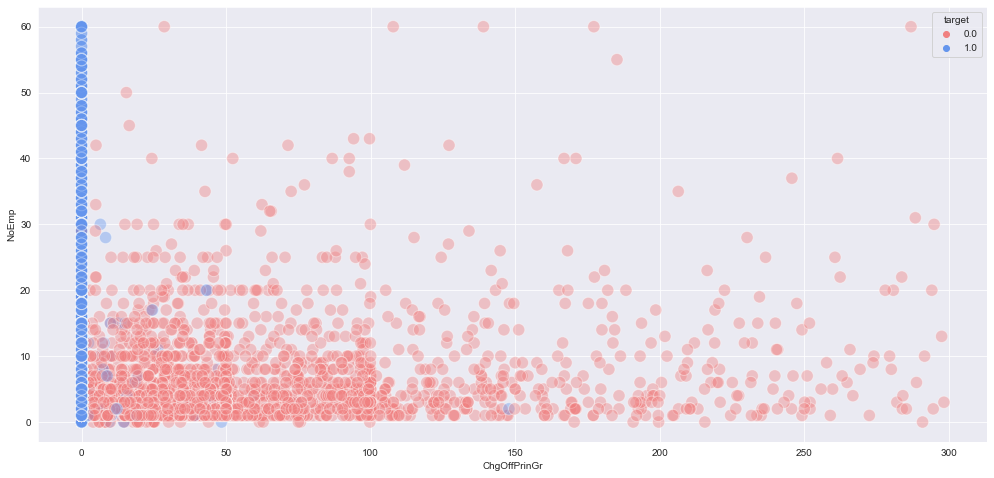

CreateJob


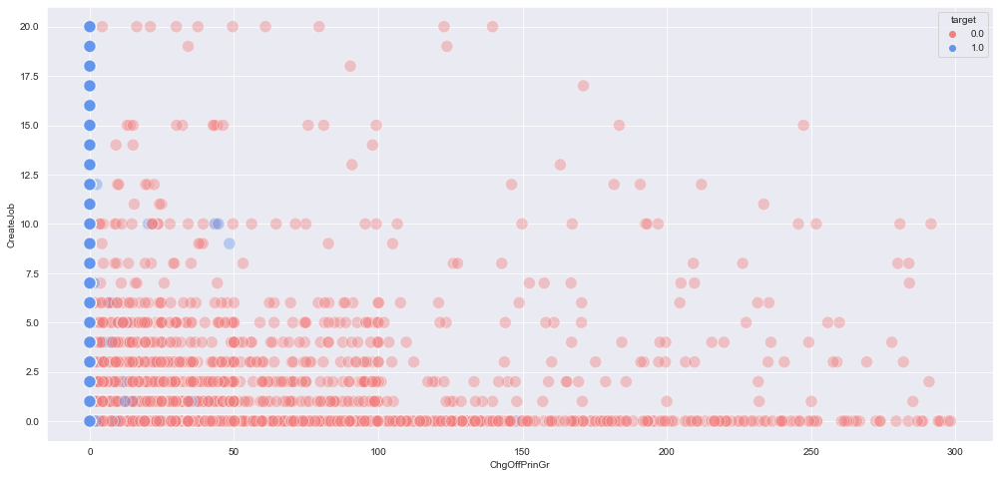

RetainedJob


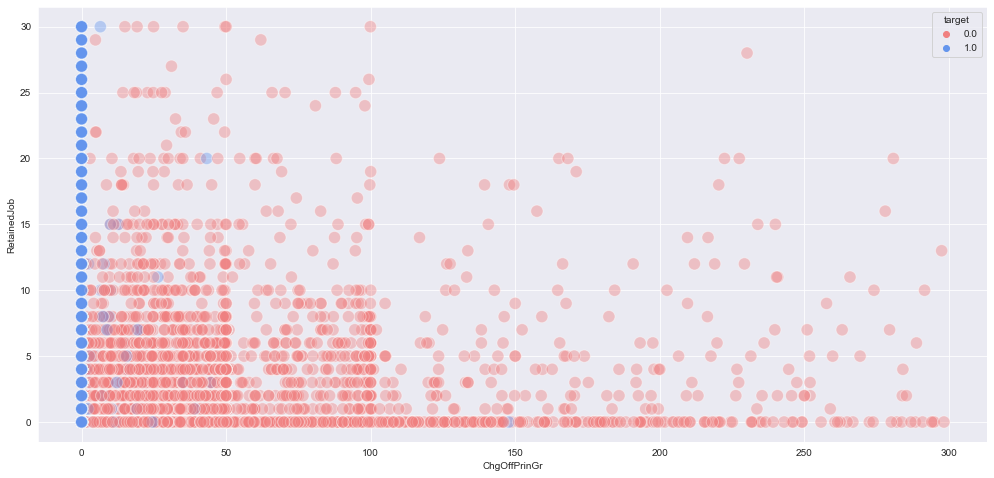

DisbursementGross


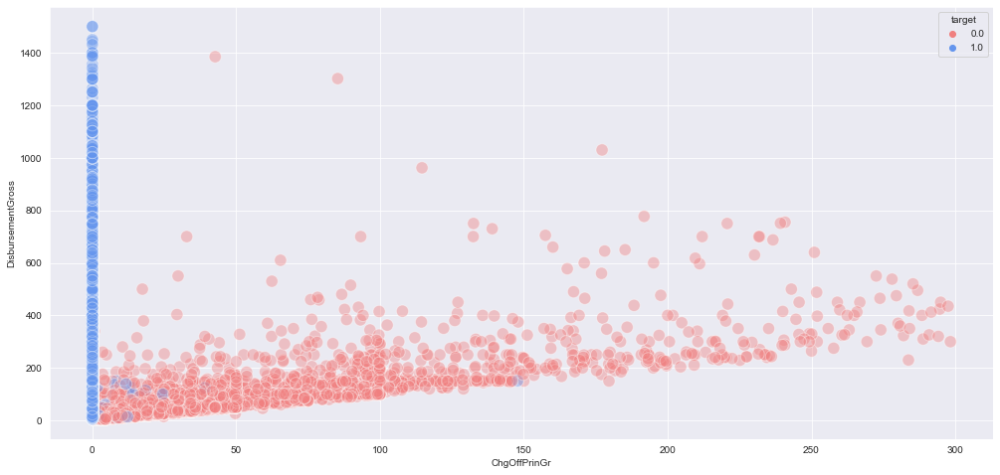

ChgOffPrinGr


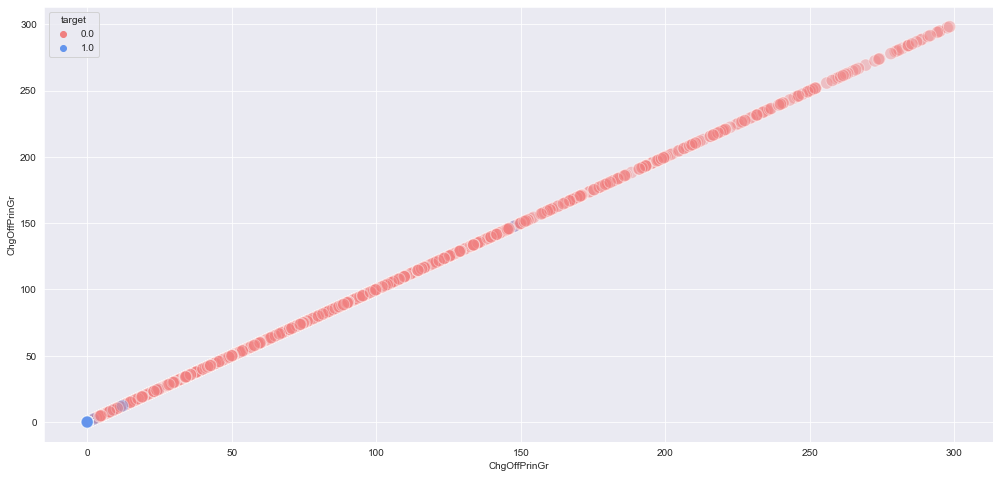

GrAppv


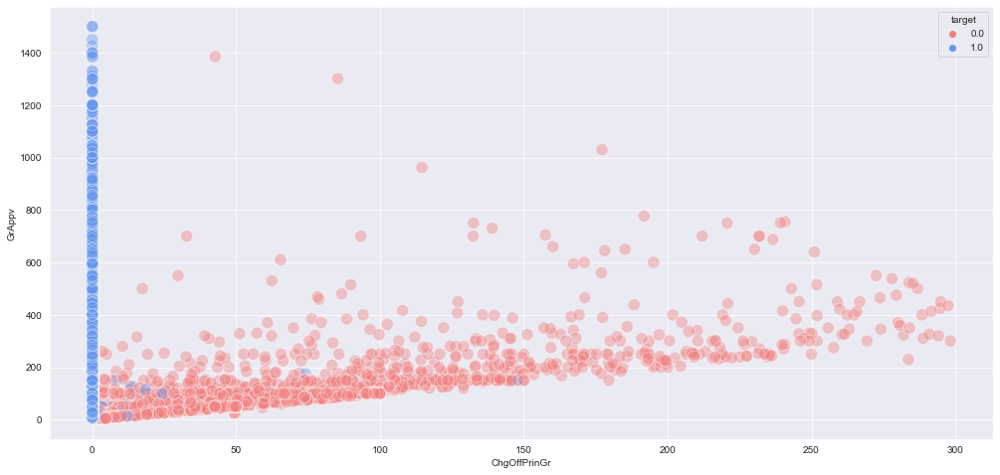

SBA_Appv


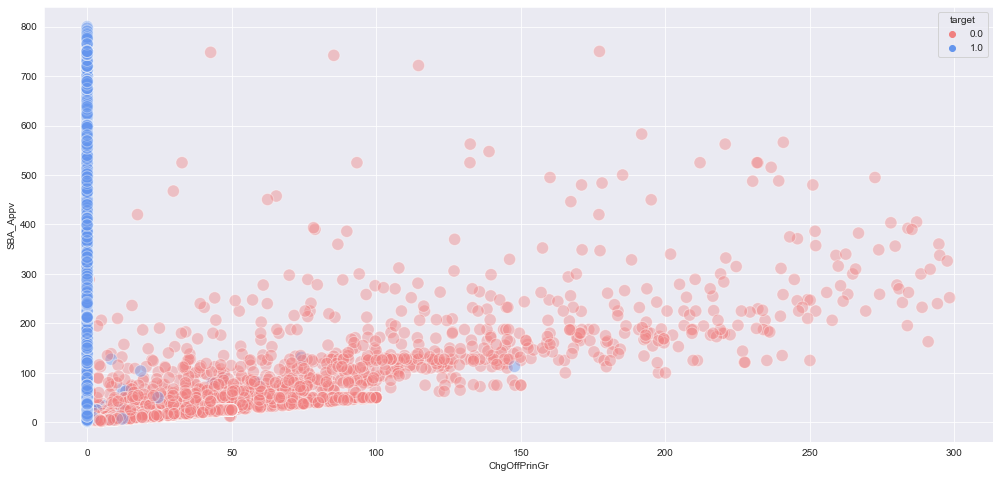

In [185]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (17,8))
    sns.scatterplot(data=train_df, x='ChgOffPrinGr',y=col,hue='target',palette=['lightcoral','cornflowerblue'],alpha=0.4,s=150)
    plt.xlabel('ChgOffPrinGr')
    plt.ylabel(col)
    plt.show()

Term


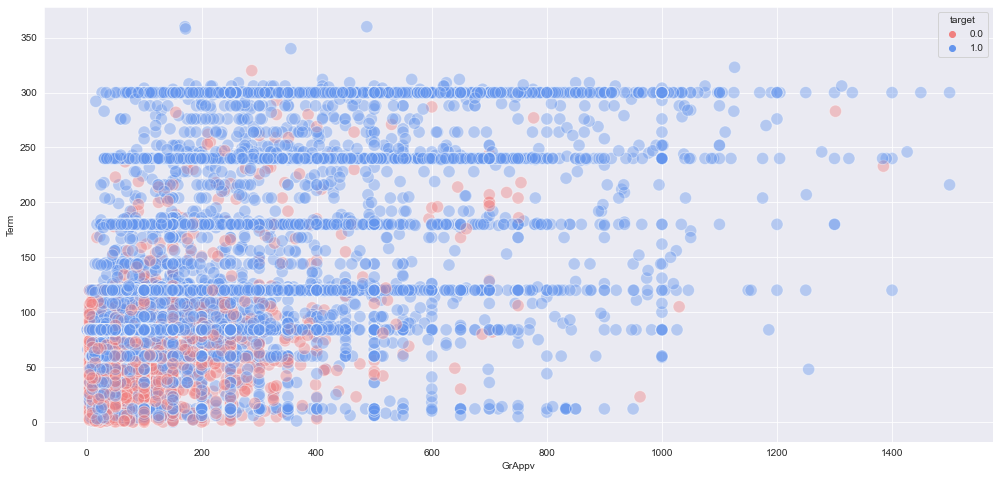

NoEmp


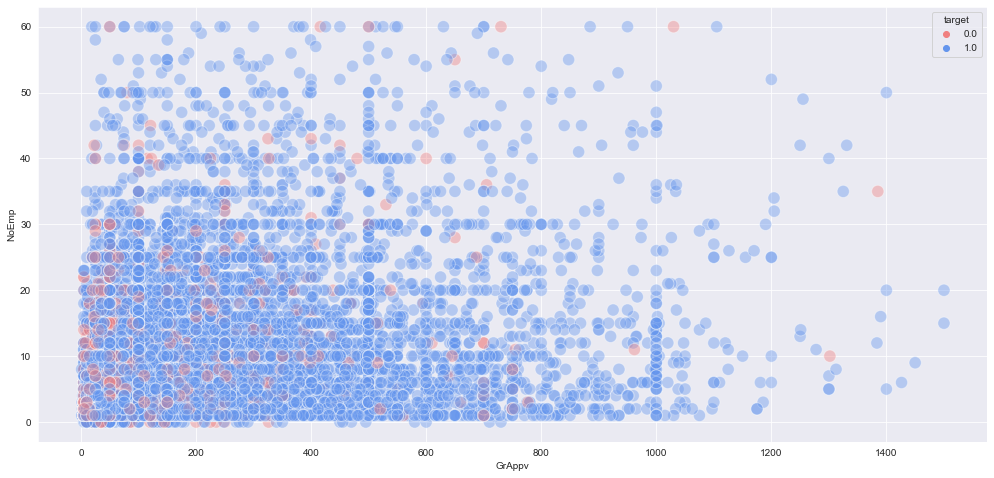

CreateJob


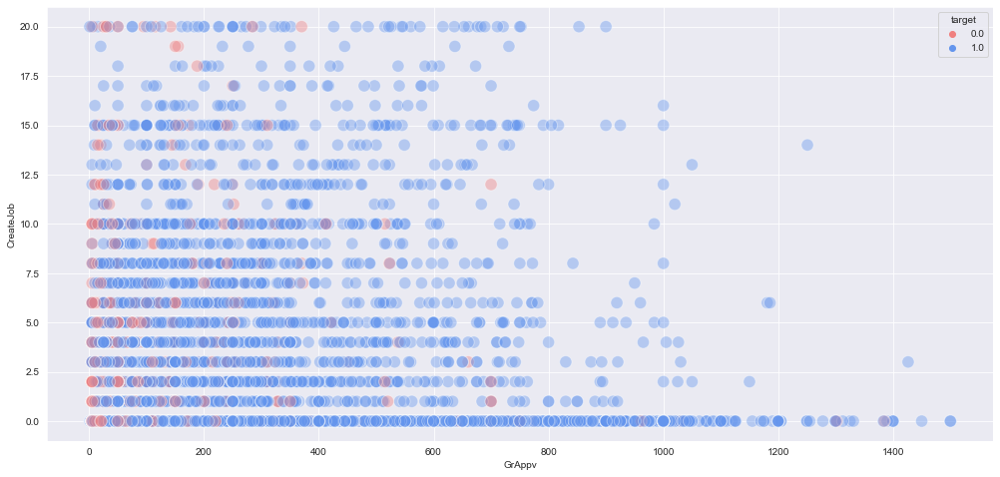

RetainedJob


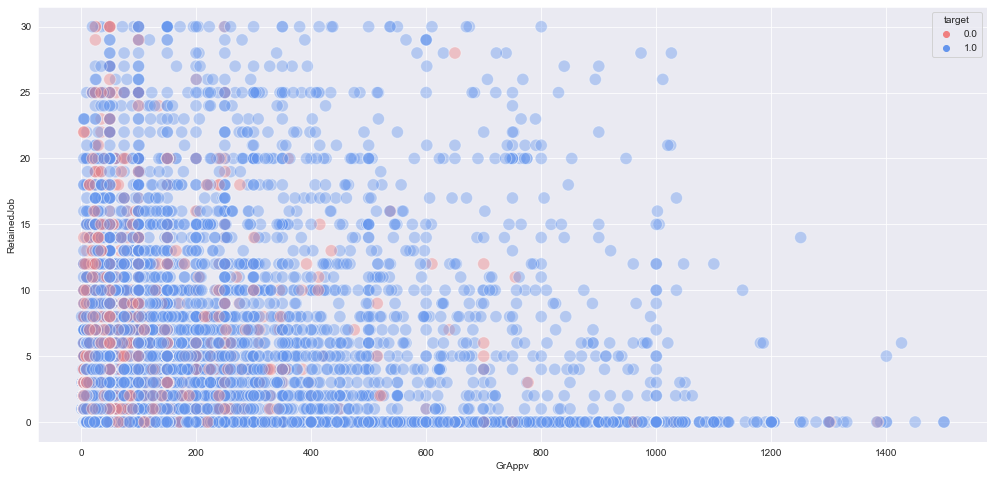

DisbursementGross


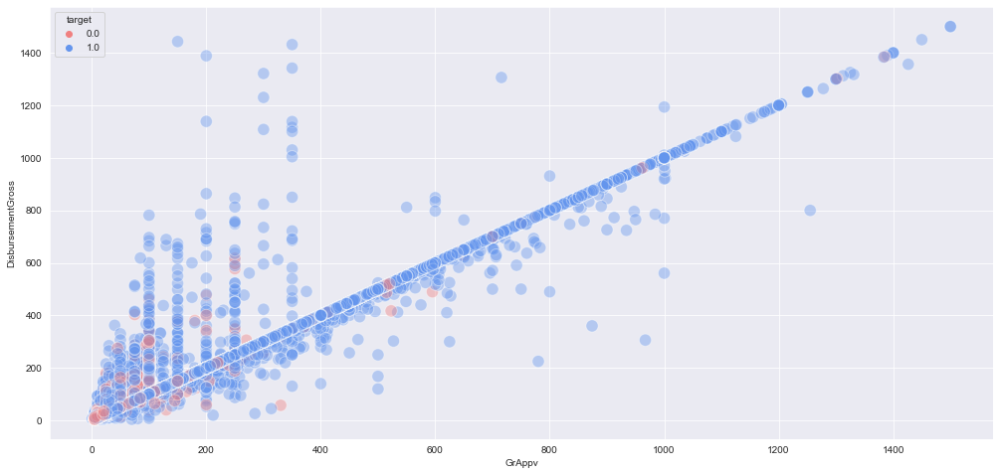

ChgOffPrinGr


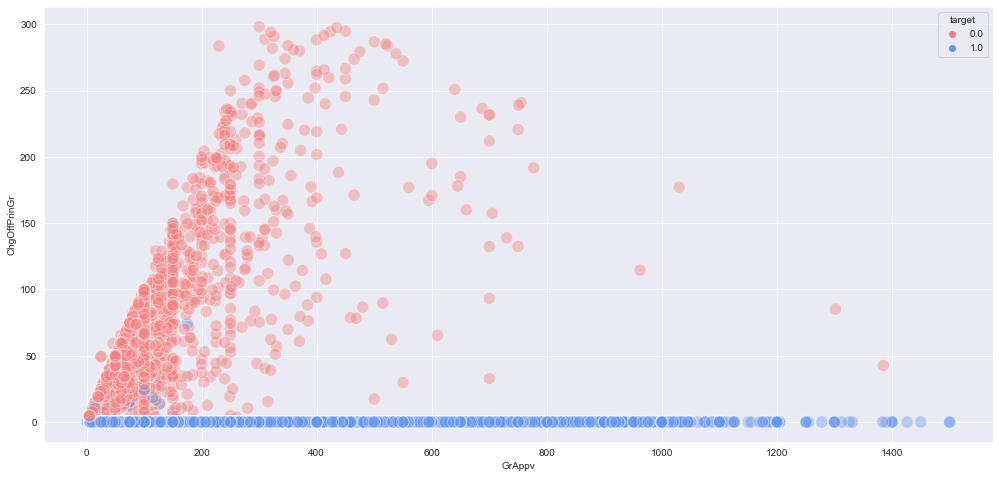

GrAppv


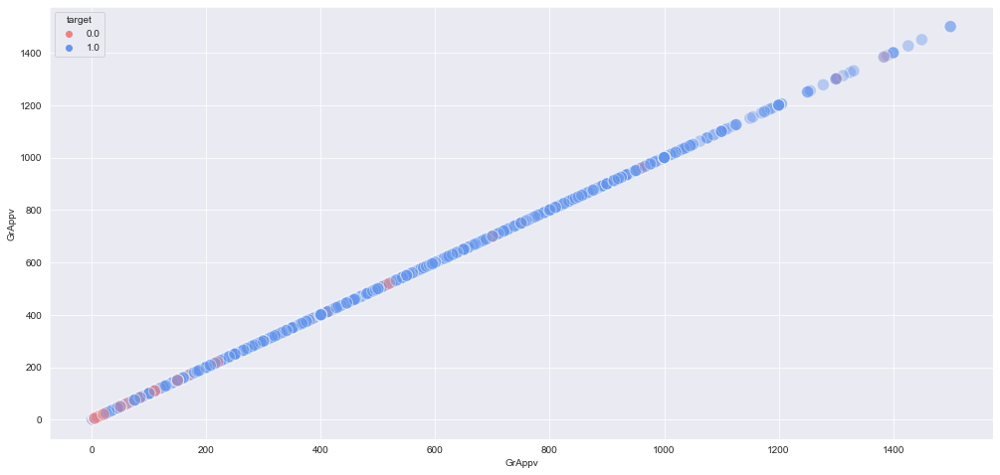

SBA_Appv


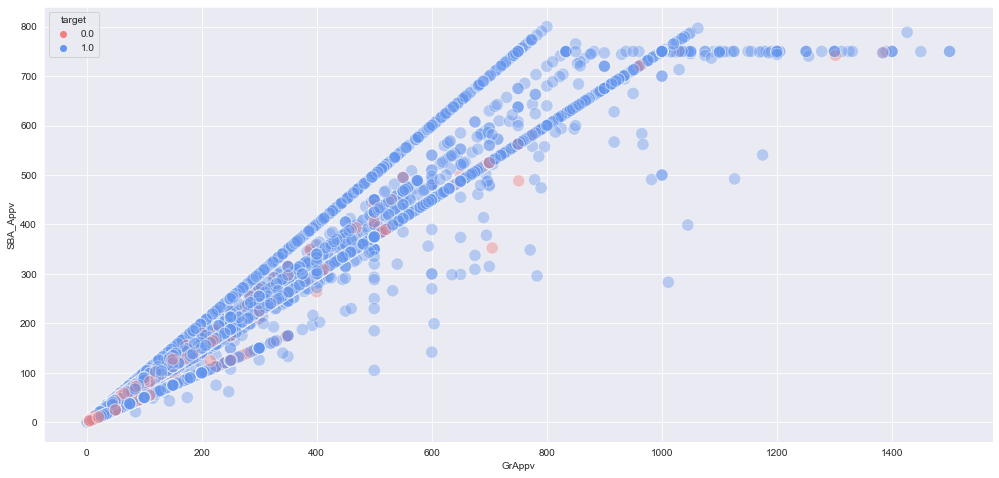

In [186]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (17,8))
    sns.scatterplot(data=train_df, x='GrAppv',y=col,hue='target',palette=['lightcoral','cornflowerblue'],alpha=0.4,s=150)
    plt.xlabel('GrAppv')
    plt.ylabel(col)
    plt.show()

Term


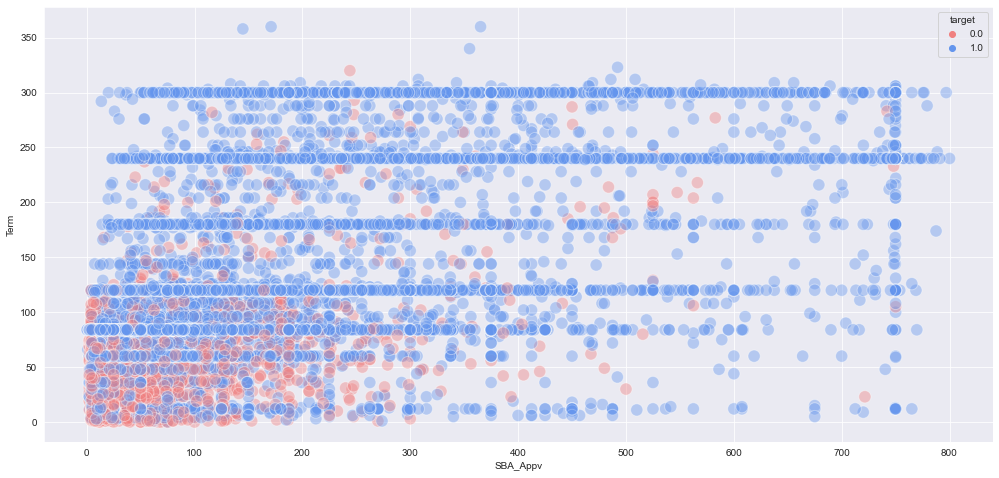

NoEmp


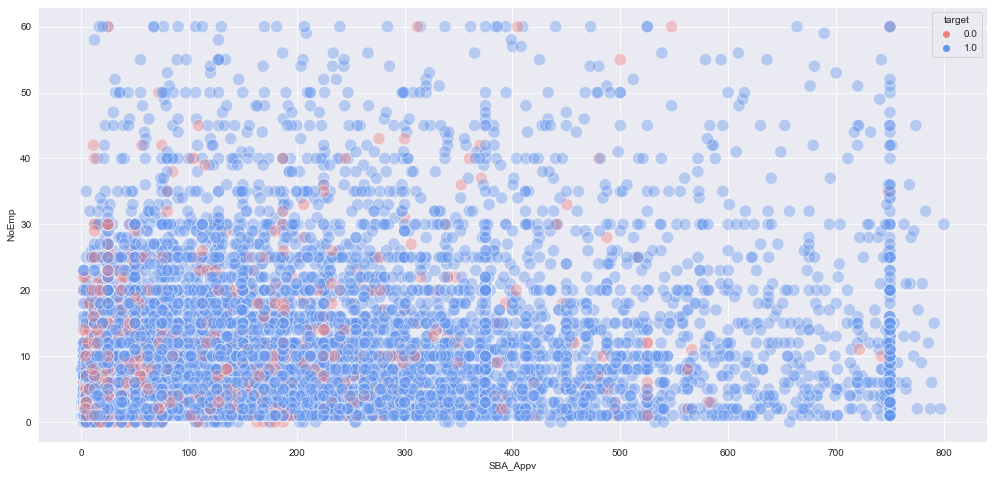

CreateJob


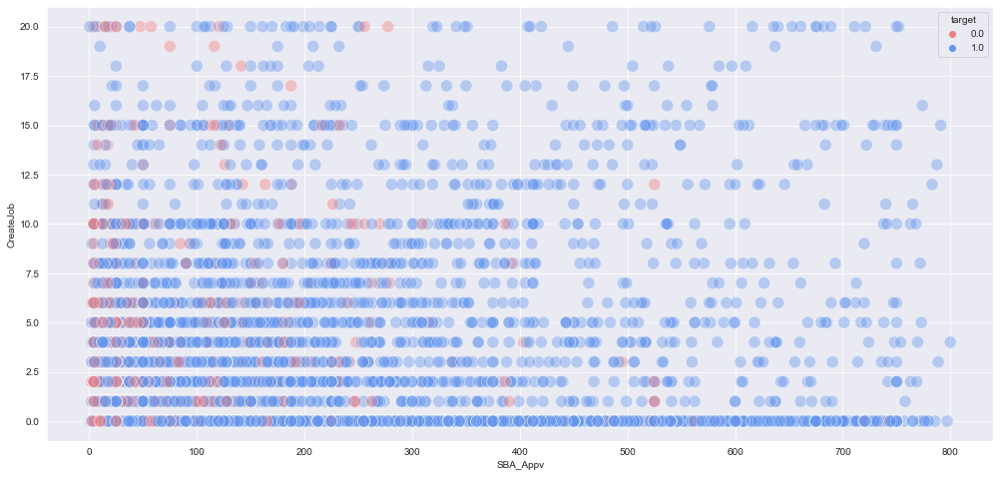

RetainedJob


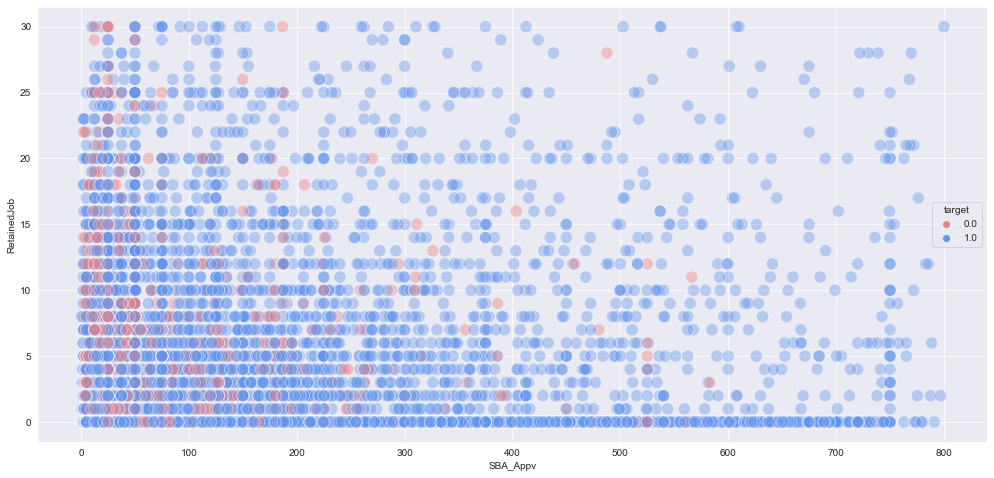

DisbursementGross


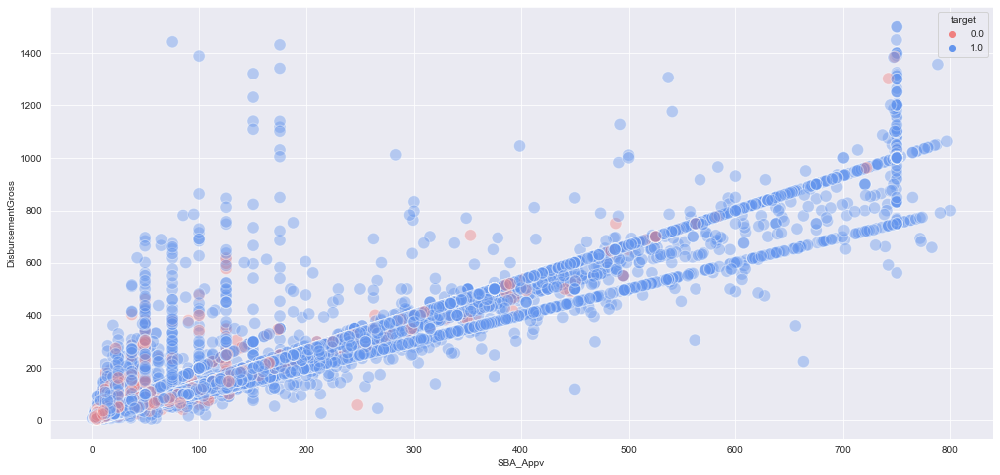

ChgOffPrinGr


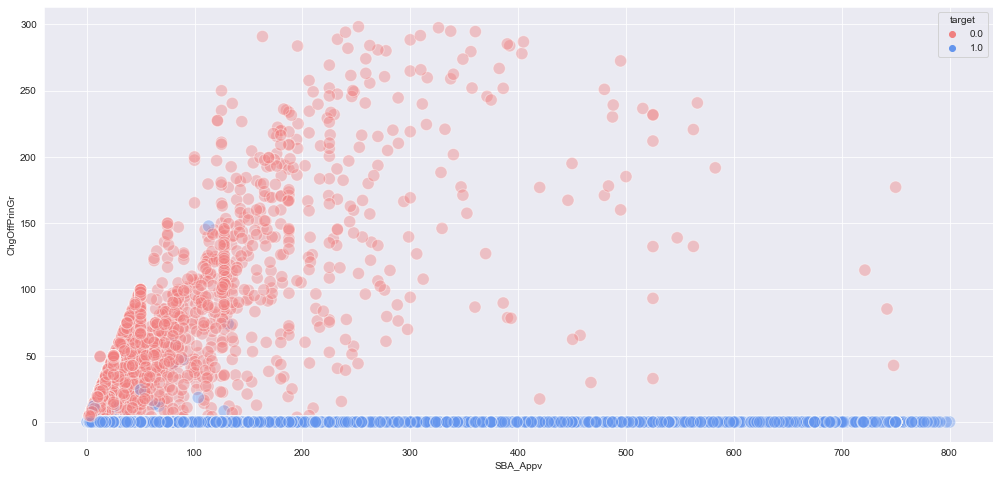

GrAppv


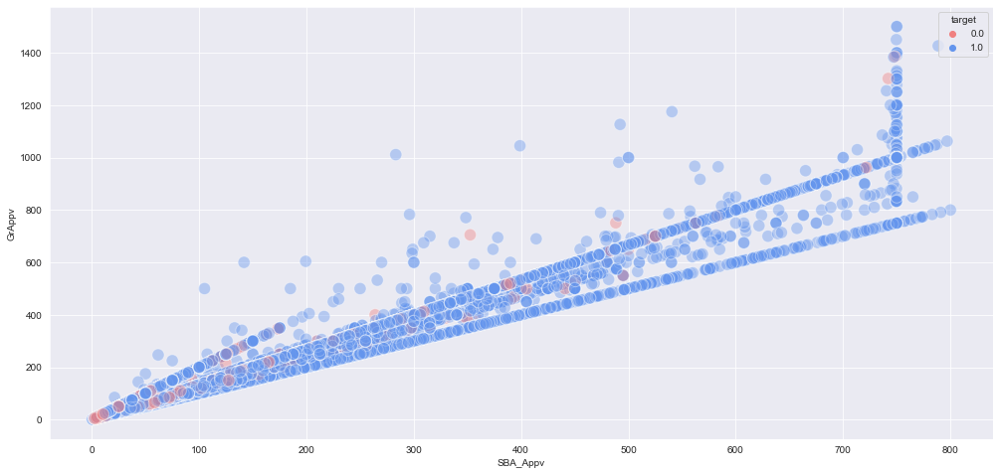

SBA_Appv


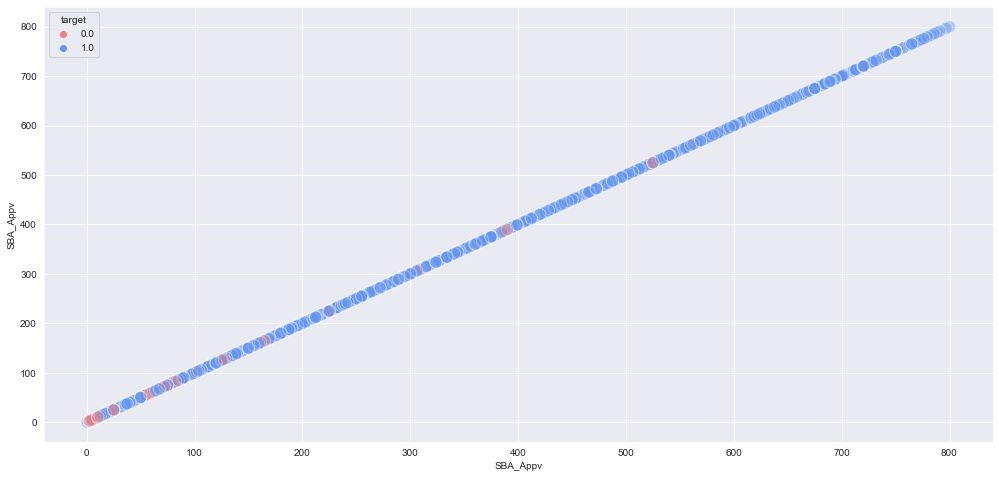

In [187]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (17,8))
    sns.scatterplot(data=train_df, x='SBA_Appv',y=col,hue='target',palette=['lightcoral','cornflowerblue'],alpha=0.4,s=150)
    plt.xlabel('SBA_Appv')
    plt.ylabel(col)
    plt.show()

In [188]:
continuous_features

['Term',
 'NoEmp',
 'CreateJob',
 'RetainedJob',
 'DisbursementGross',
 'ChgOffPrinGr',
 'GrAppv',
 'SBA_Appv']

In [189]:
fig = px.scatter_3d(train_df, x="Term", y="DisbursementGross", z="NoEmp", color="target")
fig.show()

### Discrete_features

### Univariate/Bivariate analysis

In [190]:
train_df[discrete_features].nunique().sort_values(ascending=False)

ApprovalDate_Year         42
ApprovalFY                41
DisbursementDate_Year     41
RetainedJob               31
ApprovalDate_Day          31
DisbursementDate_Day      31
ChgOffDate_Day            31
ChgOffDate_Year           27
CreateJob                 21
ApprovalDate_Month        12
DisbursementDate_Month    12
ChgOffDate_Month          12
Newbusiness                2
dtype: int64

In [191]:
discrete_features = train_df[discrete_features].nunique().sort_values(ascending=False).index

In [192]:
discrete_features

Index(['ApprovalDate_Year', 'ApprovalFY', 'DisbursementDate_Year',
       'RetainedJob', 'ApprovalDate_Day', 'DisbursementDate_Day',
       'ChgOffDate_Day', 'ChgOffDate_Year', 'CreateJob', 'ApprovalDate_Month',
       'DisbursementDate_Month', 'ChgOffDate_Month', 'Newbusiness'],
      dtype='object')

ApprovalDate_Year


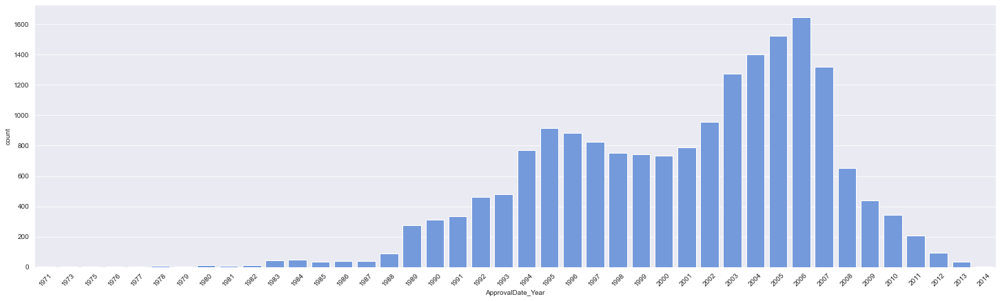

ApprovalFY


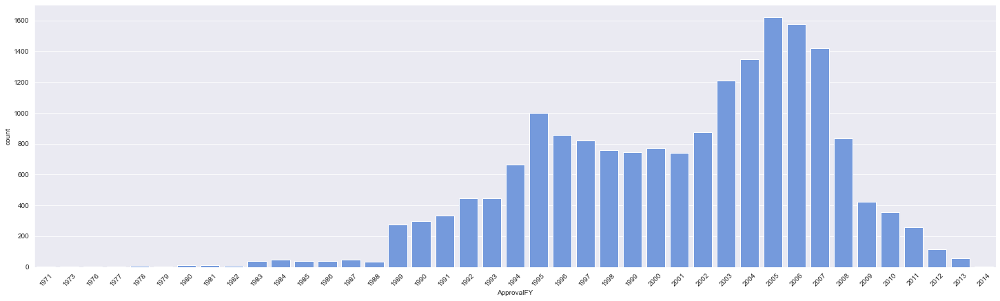

DisbursementDate_Year


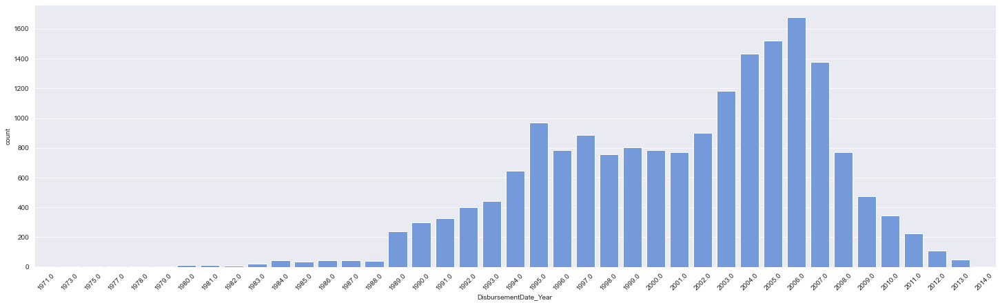

RetainedJob


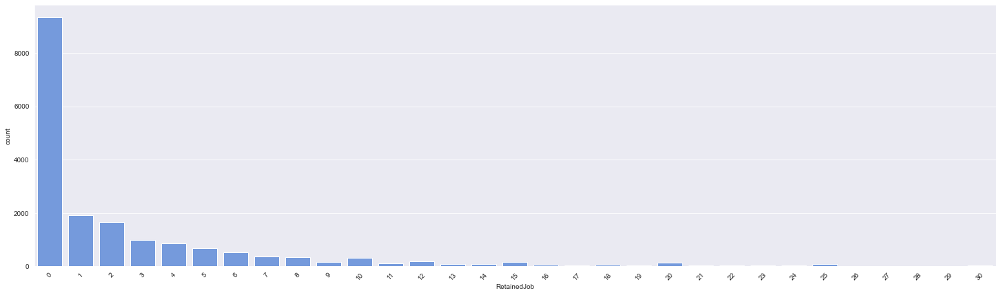

ApprovalDate_Day


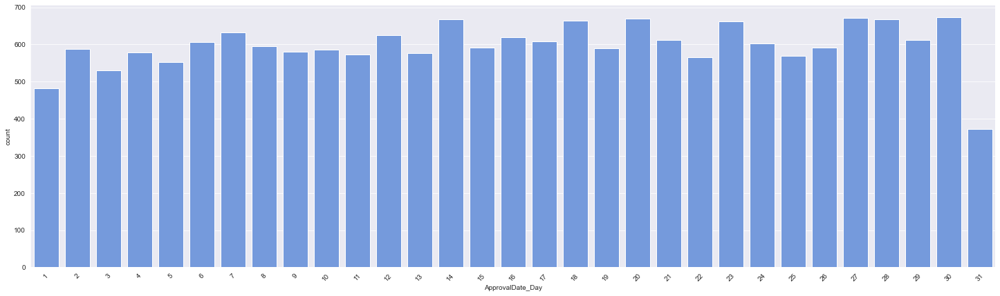

DisbursementDate_Day


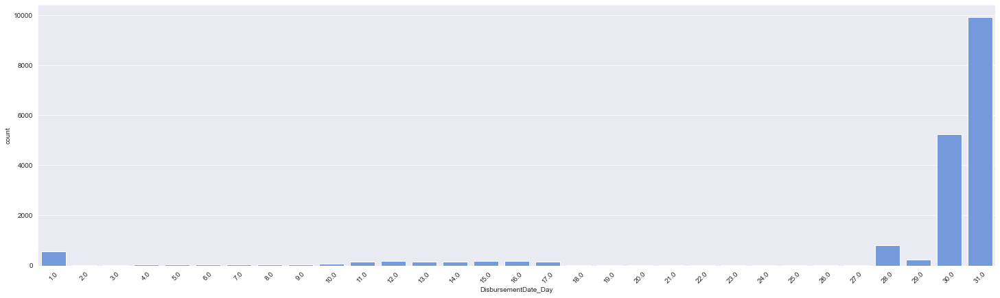

ChgOffDate_Day


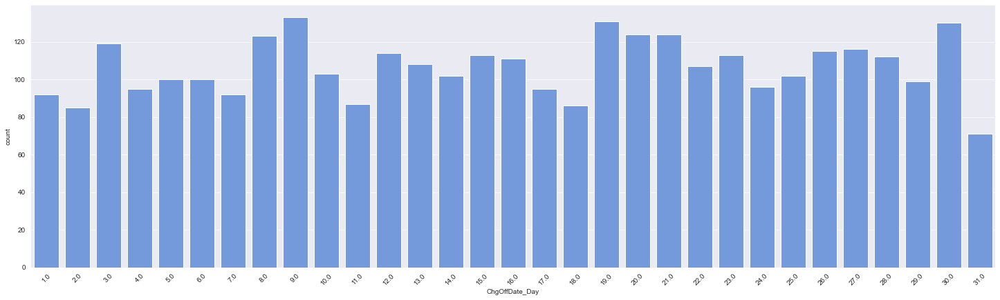

ChgOffDate_Year


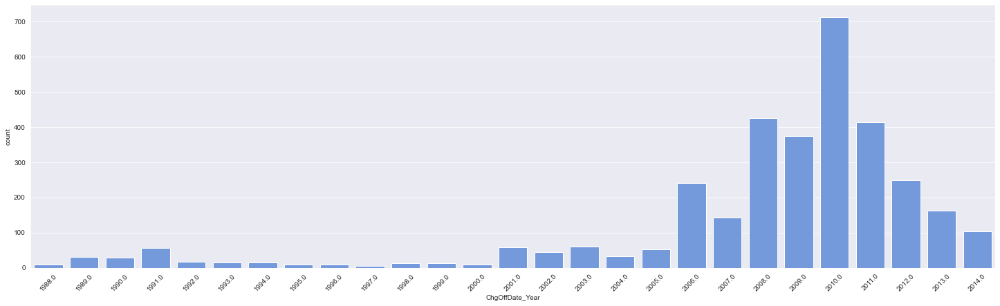

CreateJob


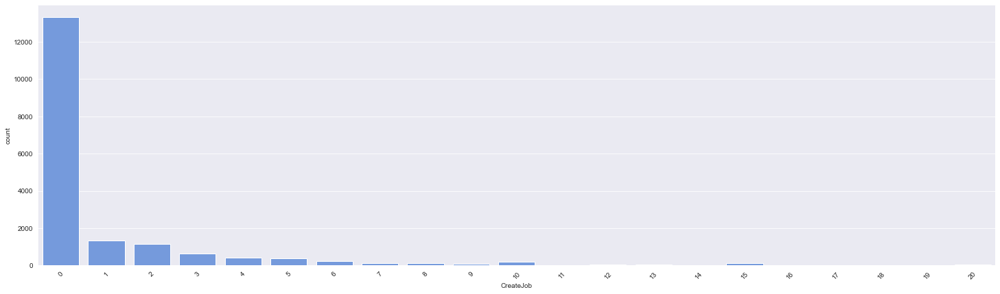

ApprovalDate_Month


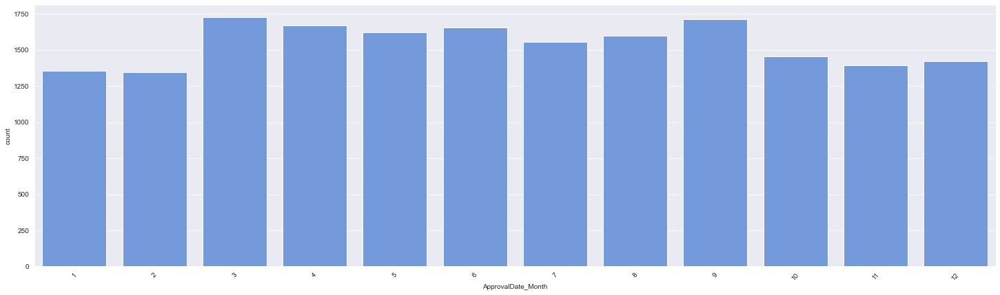

DisbursementDate_Month


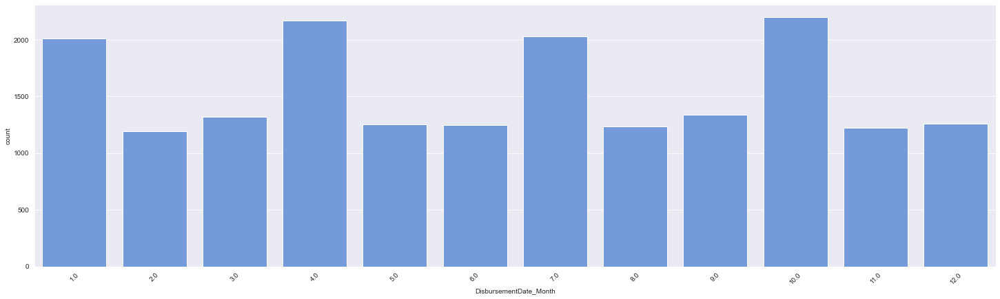

ChgOffDate_Month


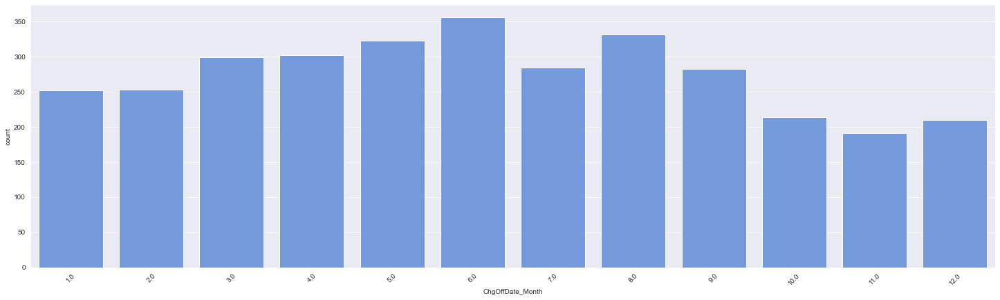

Newbusiness


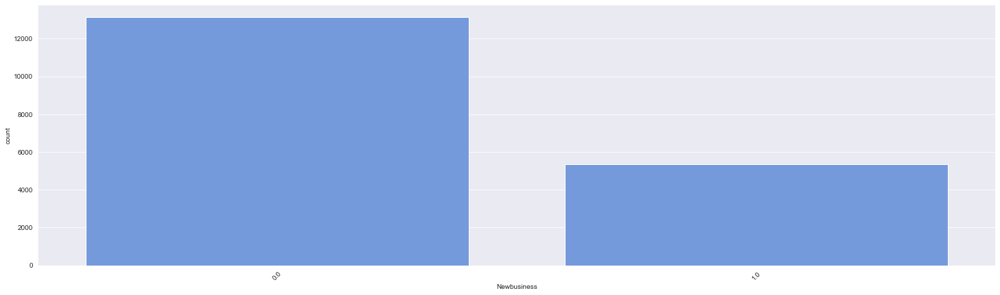

In [193]:
for col in discrete_features:
    print(col)
    plt.figure(figsize = (25,7))
    sns.countplot(data=train_df, x=col,color='cornflowerblue')
    plt.xlabel(col)
    plt.ylabel('count')
    plt.xticks(rotation = 45)
    plt.show()

ApprovalDate_Year


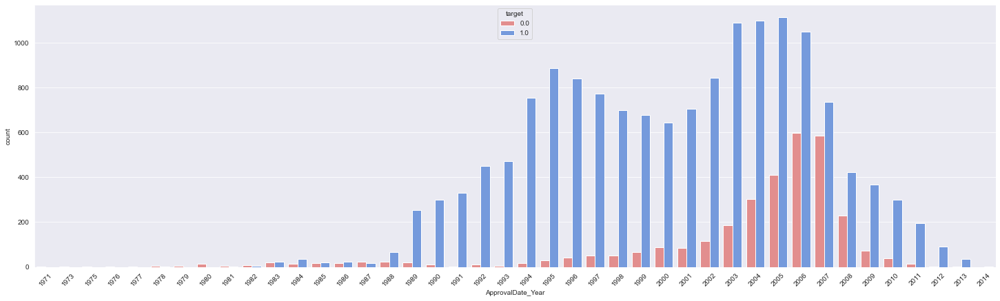

ApprovalFY


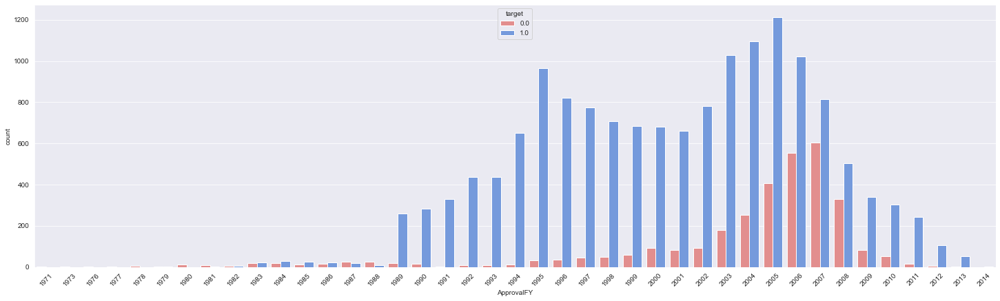

DisbursementDate_Year


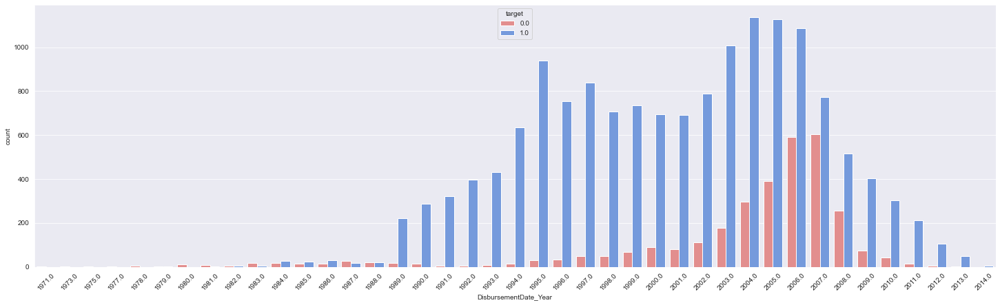

RetainedJob


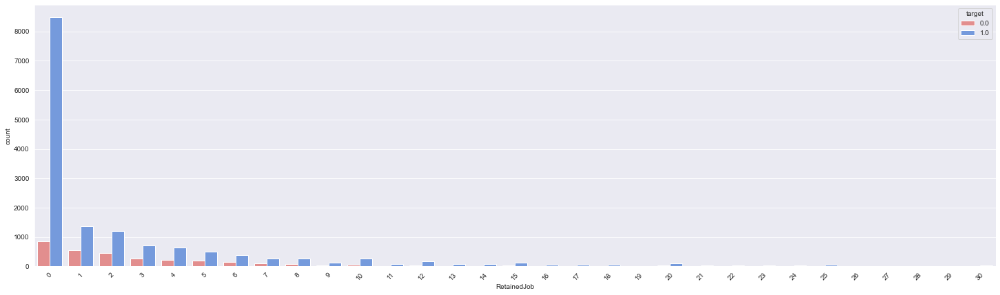

ApprovalDate_Day


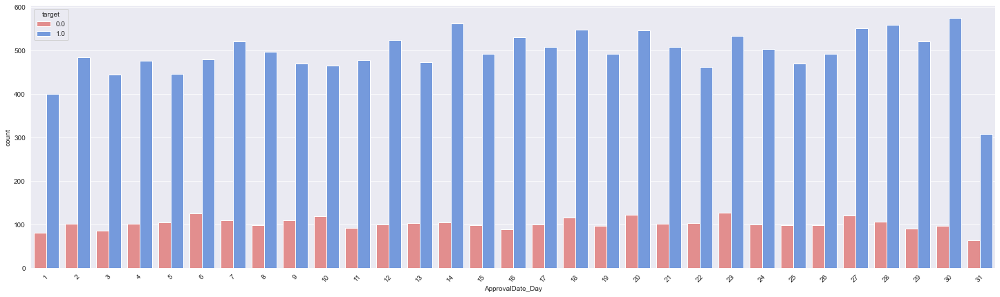

DisbursementDate_Day


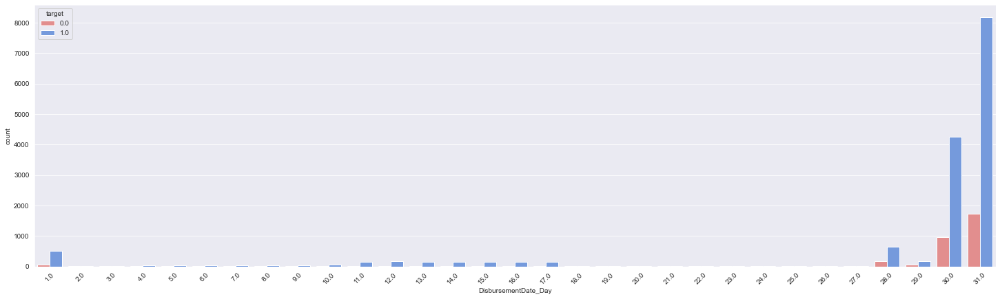

ChgOffDate_Day


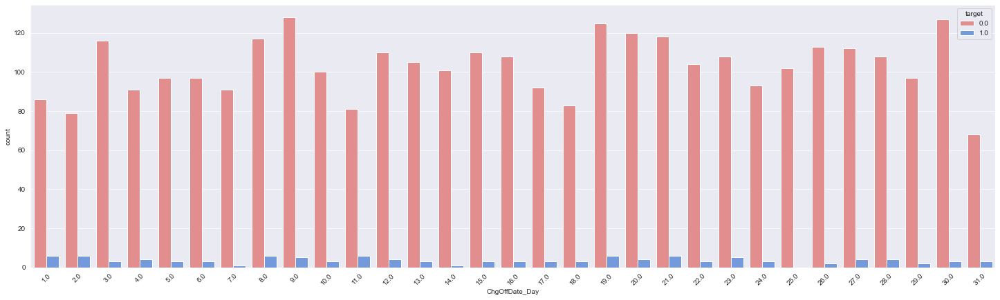

ChgOffDate_Year


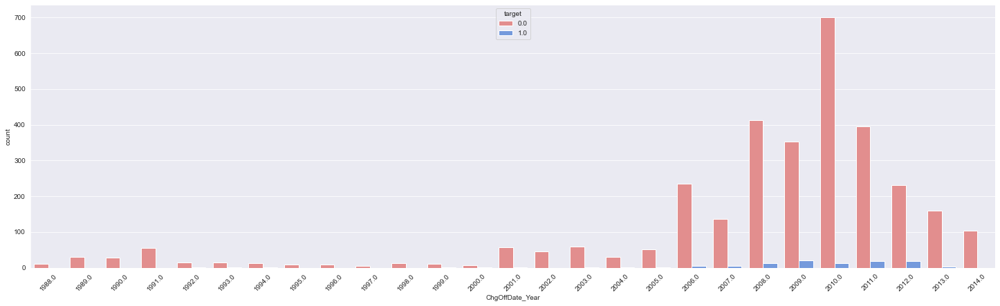

CreateJob


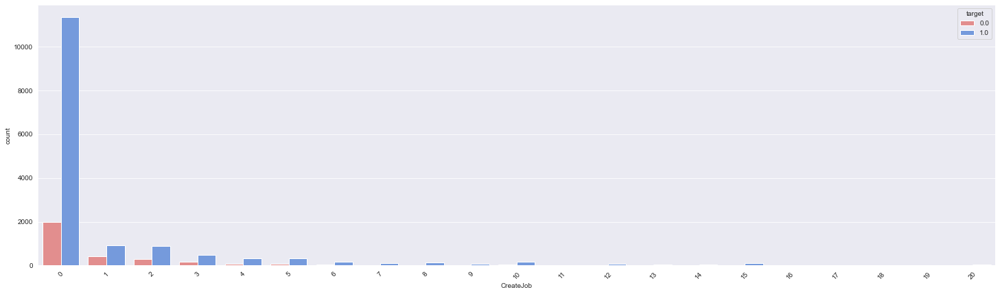

ApprovalDate_Month


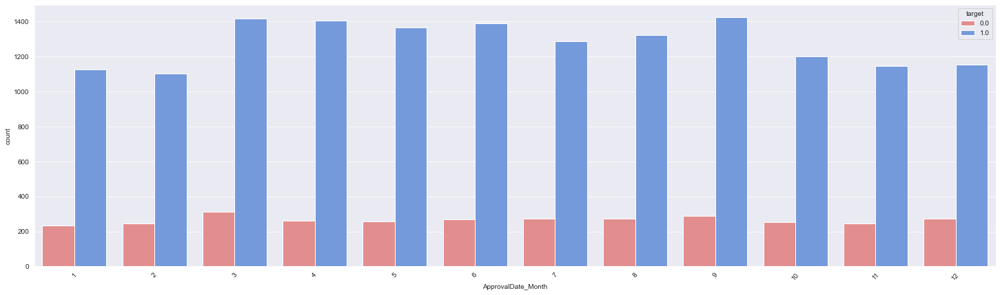

DisbursementDate_Month


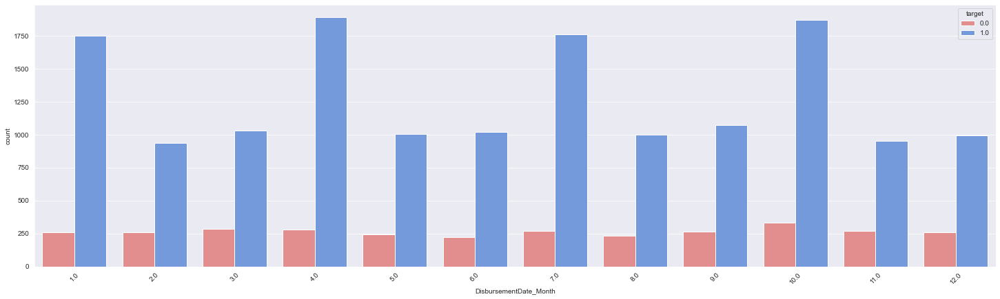

ChgOffDate_Month


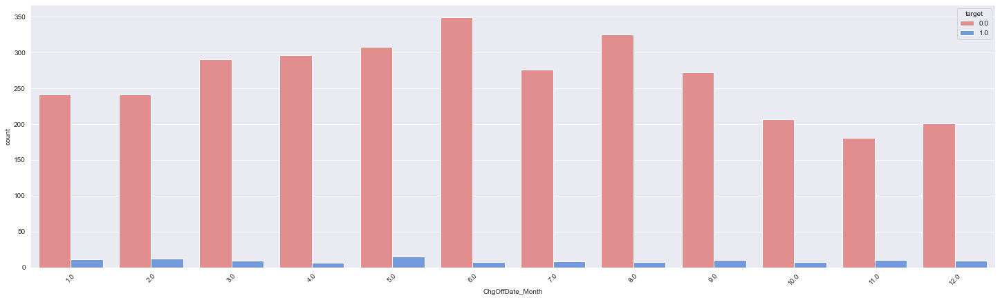

Newbusiness


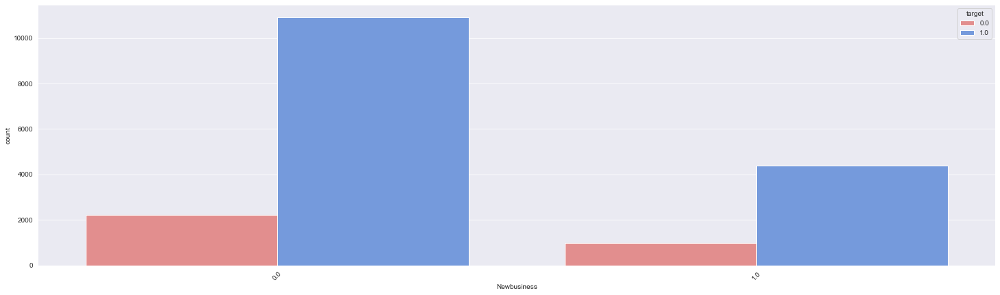

In [194]:
for col in discrete_features:
    print(col)
    plt.figure(figsize = (25,7))
    plt.xlabel(col)
    plt.ylabel('count')
    sns.countplot(data=train_df, x=col, hue="target",palette=['lightcoral','cornflowerblue'])
    plt.xticks(rotation = 45)
    plt.show()

Newbusiness


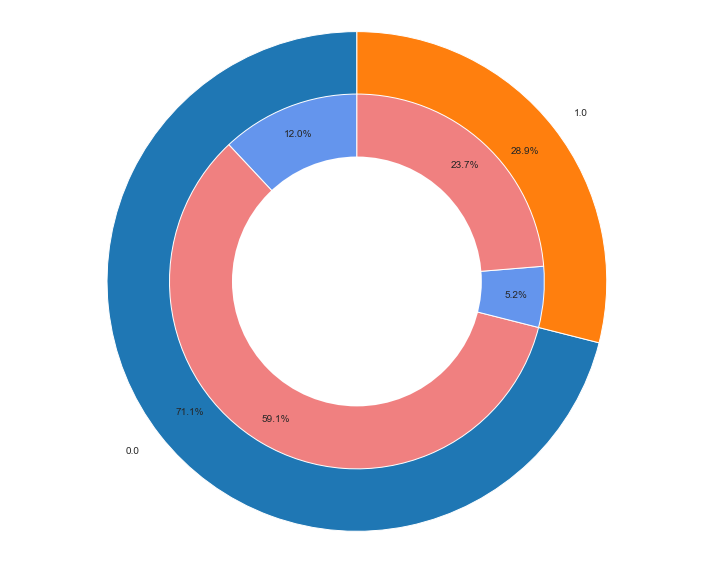

In [195]:
print('Newbusiness')
labels = train_df['Newbusiness'].value_counts().sort_index().index
sizes = train_df['Newbusiness'].value_counts().sort_index().values
#labels_gender = [0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1]
sizes_gender = train_df.groupby(['Newbusiness','target'])['target'].count().values
#colors = ['slategrey', '#ffcc99']
colors = ['cornflowerblue','lightcoral','cornflowerblue','lightcoral']
 
# Plot
plt.figure(figsize = (10,8))
plt.pie(sizes, labels=labels, startangle=90,frame=True,autopct='%1.1f%%', pctdistance=0.85)
plt.pie(sizes_gender,colors=colors,radius=0.75,startangle=90,autopct='%1.1f%%', pctdistance=0.85)
centre_circle = plt.Circle((0,0),0.5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
 
plt.axis('equal')
plt.tight_layout()
plt.show()

### Observation :

1. From above we can clearly observe that the chances of getting diabetic is more as the no.of pregencies increasing

In [196]:
train_df[discrete_features].nunique()

ApprovalDate_Year         42
ApprovalFY                41
DisbursementDate_Year     41
RetainedJob               31
ApprovalDate_Day          31
DisbursementDate_Day      31
ChgOffDate_Day            31
ChgOffDate_Year           27
CreateJob                 21
ApprovalDate_Month        12
DisbursementDate_Month    12
ChgOffDate_Month          12
Newbusiness                2
dtype: int64

ApprovalDate_Year


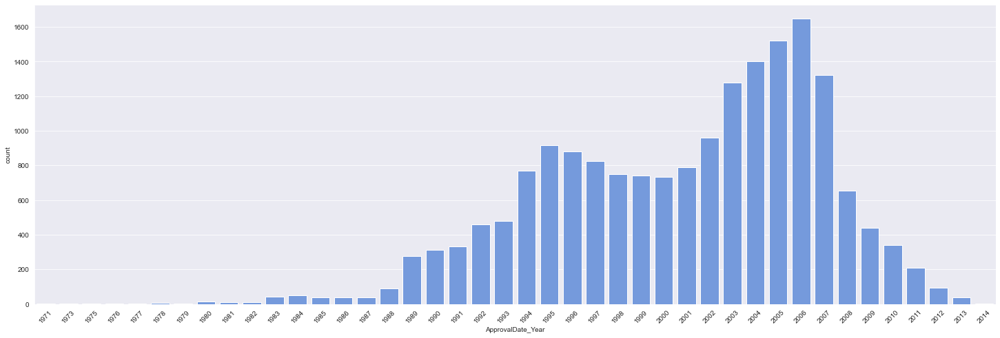

ApprovalFY


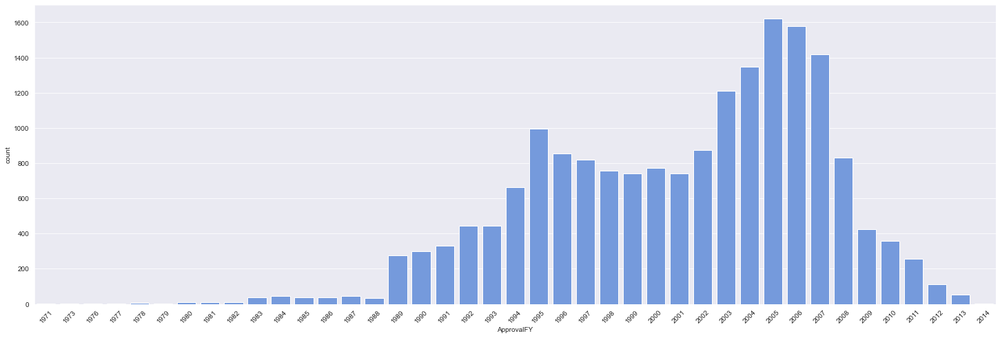

DisbursementDate_Year


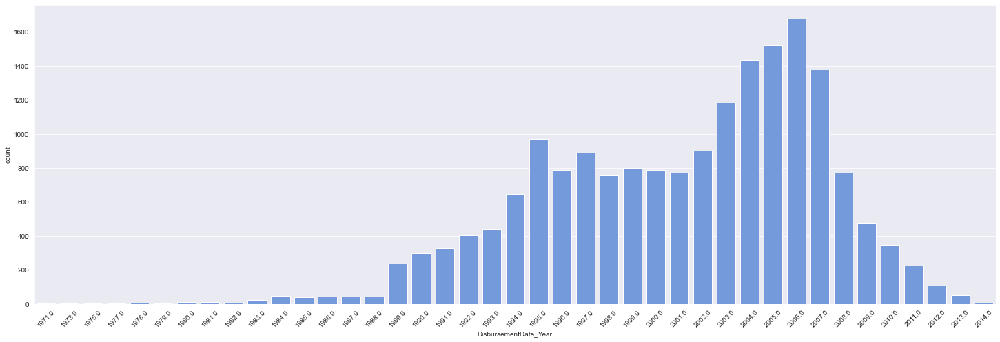

RetainedJob


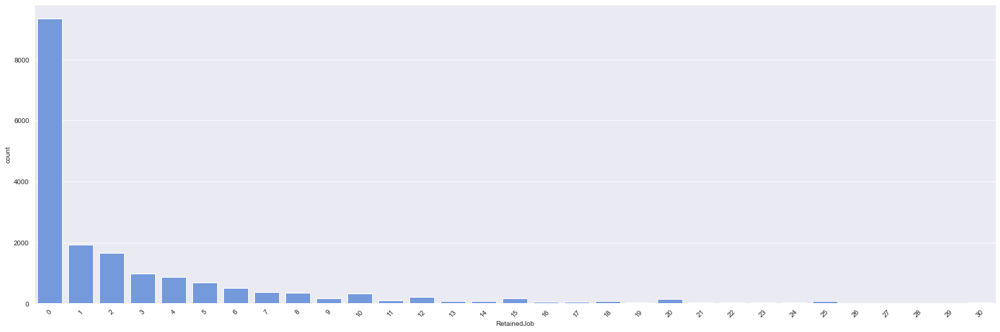

ApprovalDate_Day


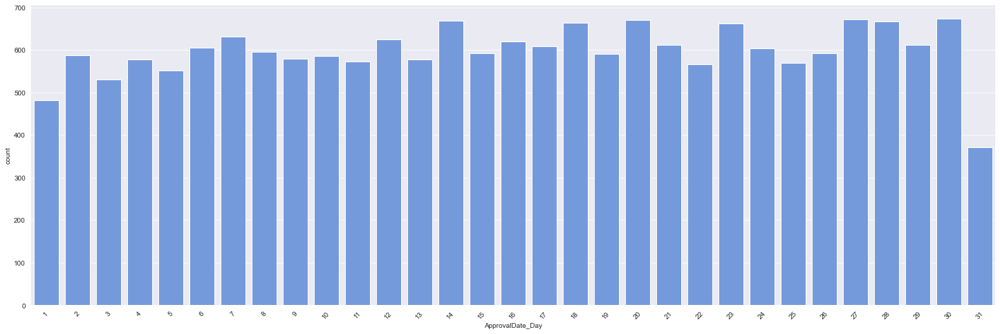

DisbursementDate_Day


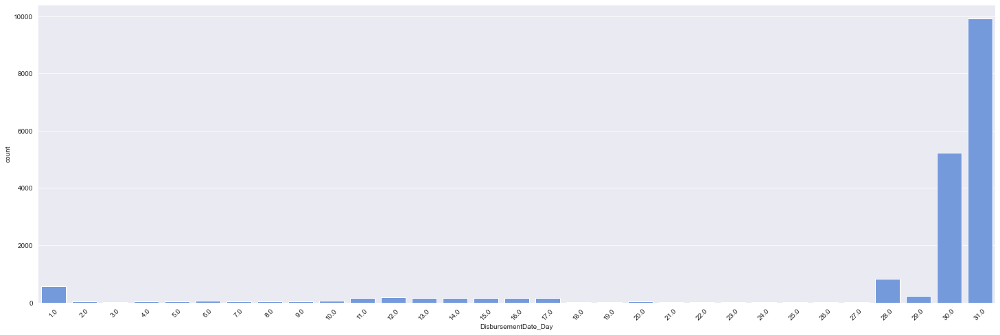

ChgOffDate_Day


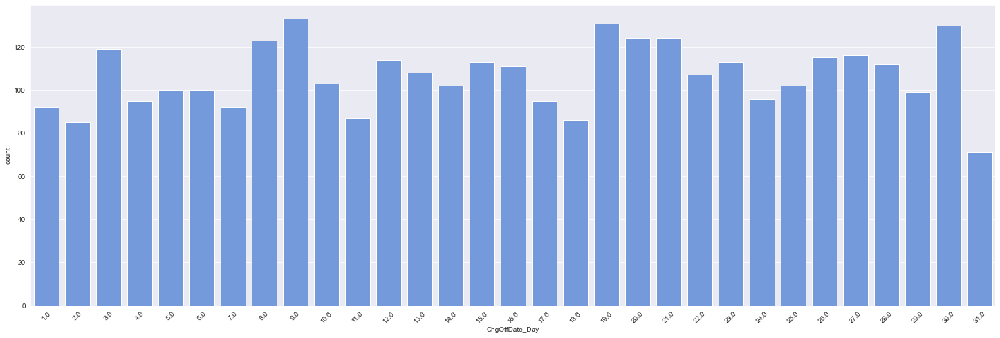

ChgOffDate_Year


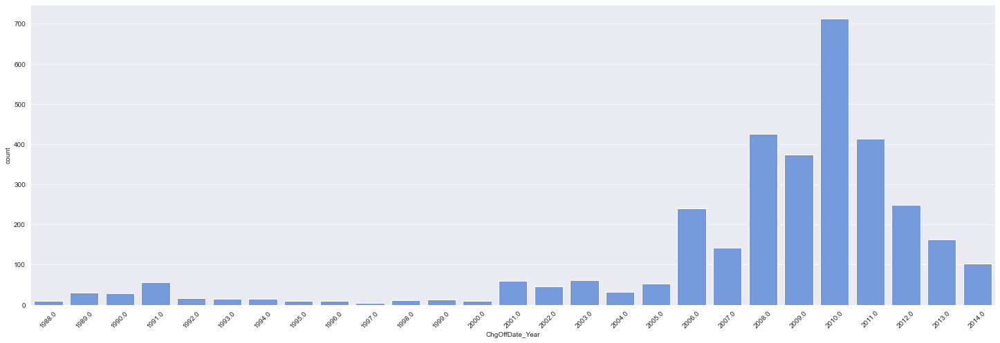

CreateJob


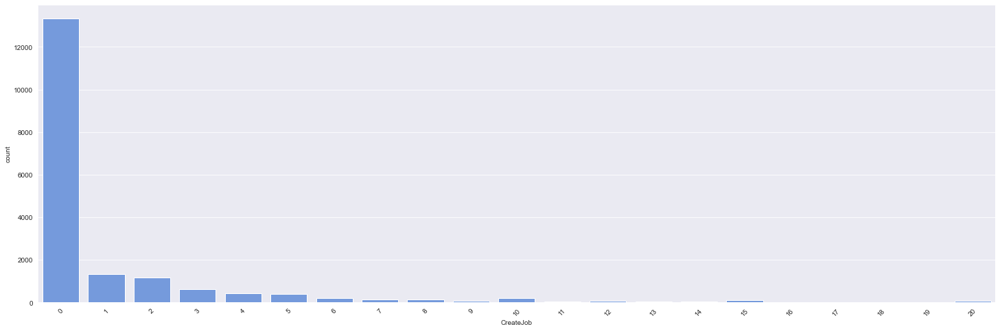

ApprovalDate_Month


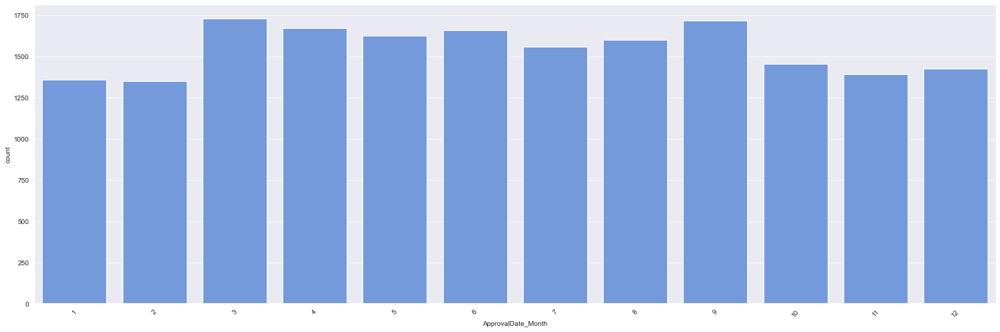

DisbursementDate_Month


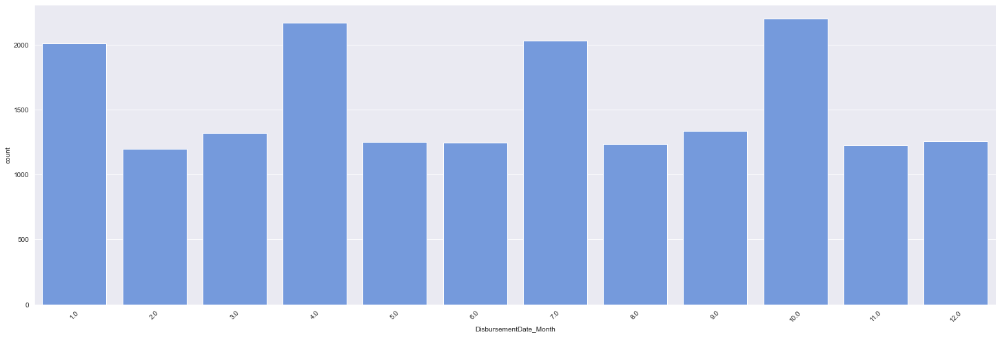

ChgOffDate_Month


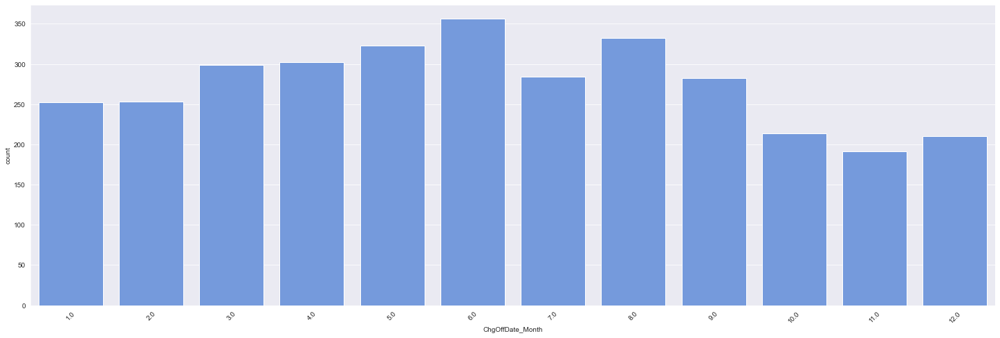

Newbusiness


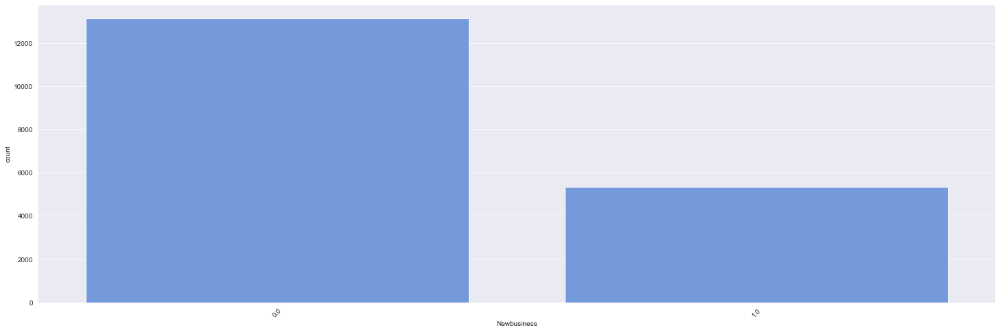

In [197]:
for col in discrete_features:
    print(col)
    plt.figure(figsize = (25,8))
    plt.xlabel(col)
    plt.ylabel('count')
    sns.countplot(data=train_df, x=col,color='cornflowerblue')
    plt.xticks(rotation = 45)
    plt.show()

ApprovalDate_Year


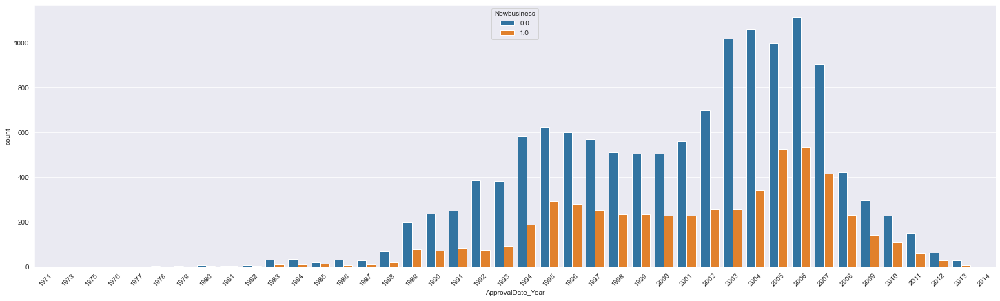

ApprovalFY


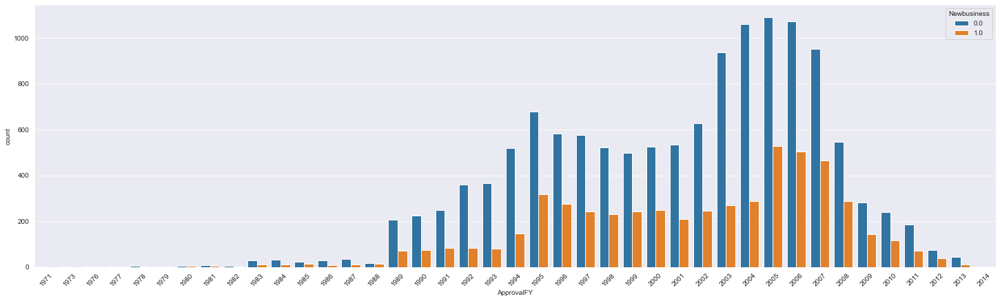

DisbursementDate_Year


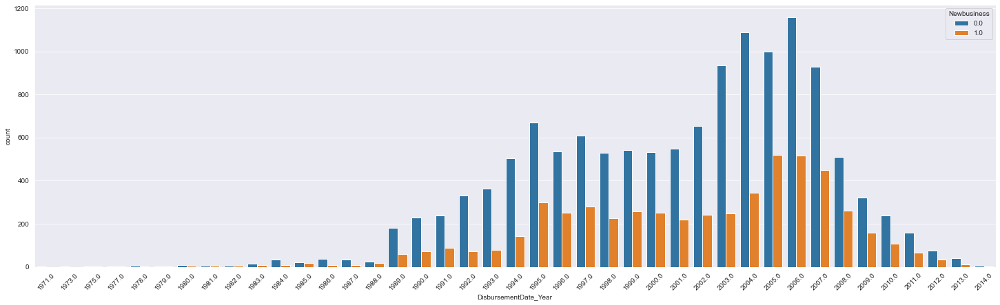

RetainedJob


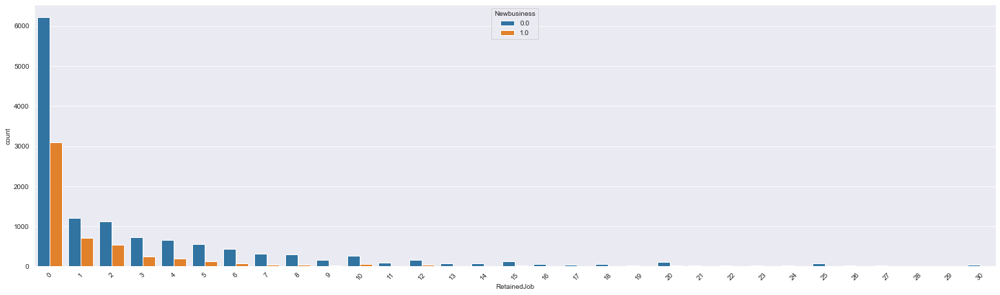

ApprovalDate_Day


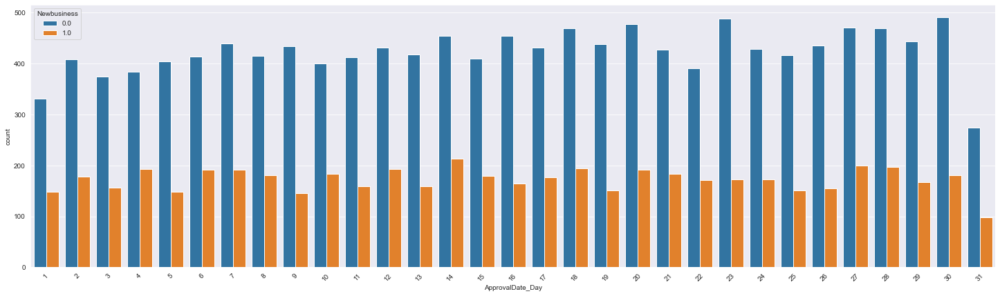

DisbursementDate_Day


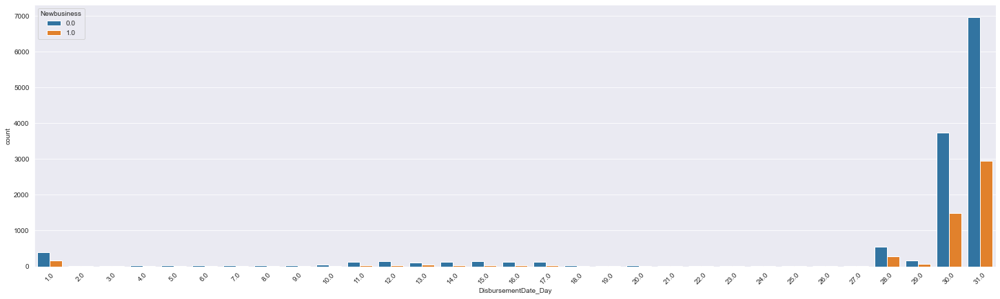

ChgOffDate_Day


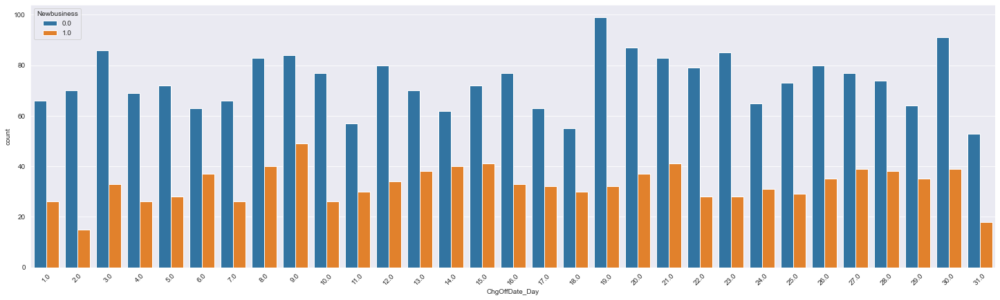

ChgOffDate_Year


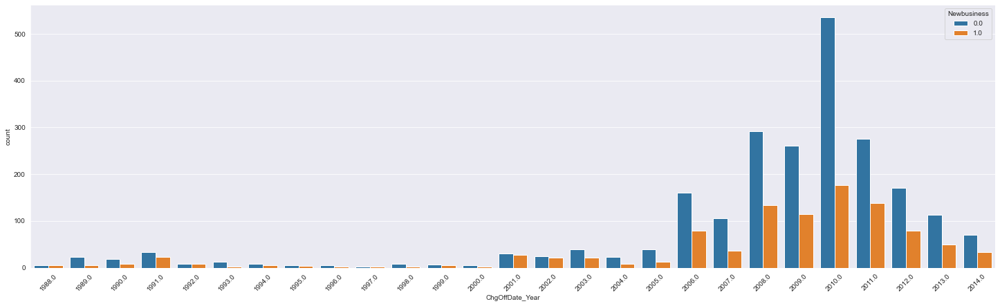

CreateJob


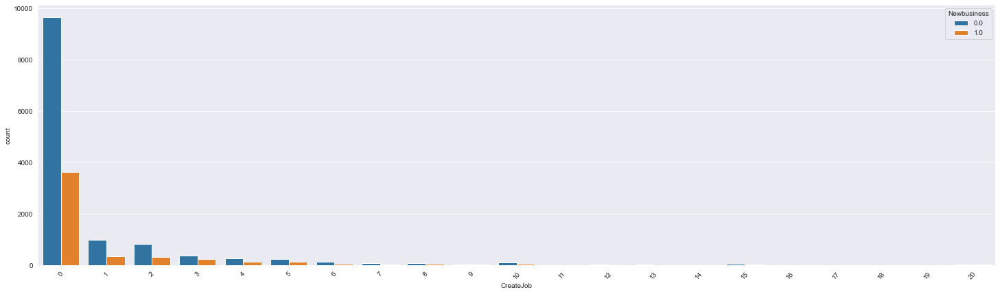

ApprovalDate_Month


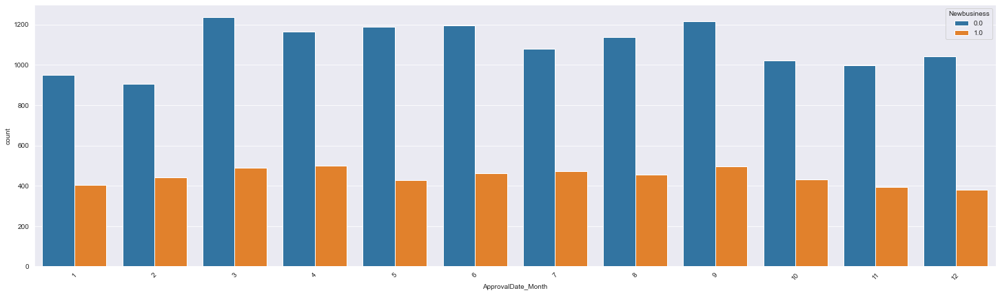

DisbursementDate_Month


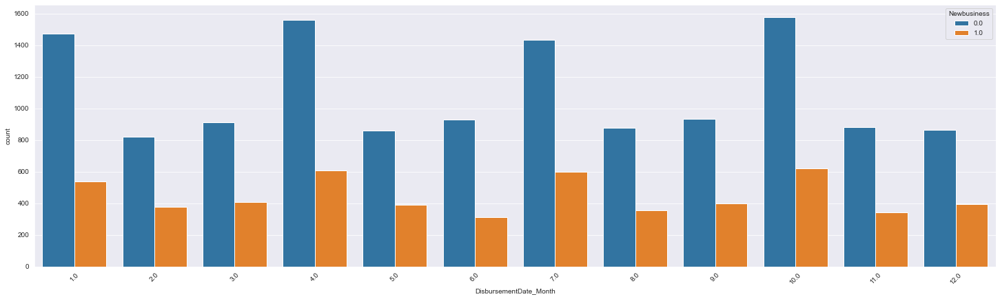

ChgOffDate_Month


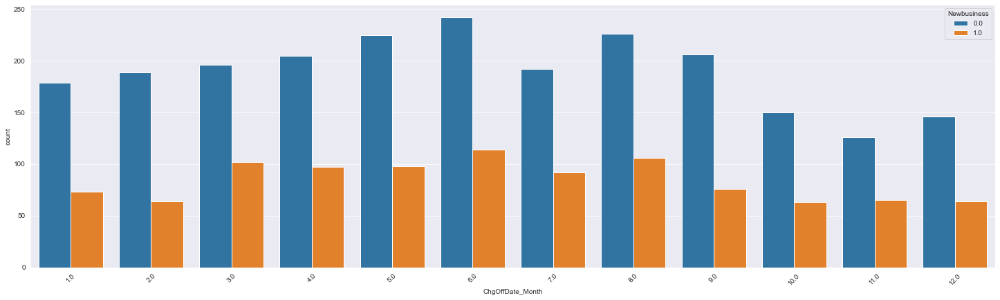

Newbusiness


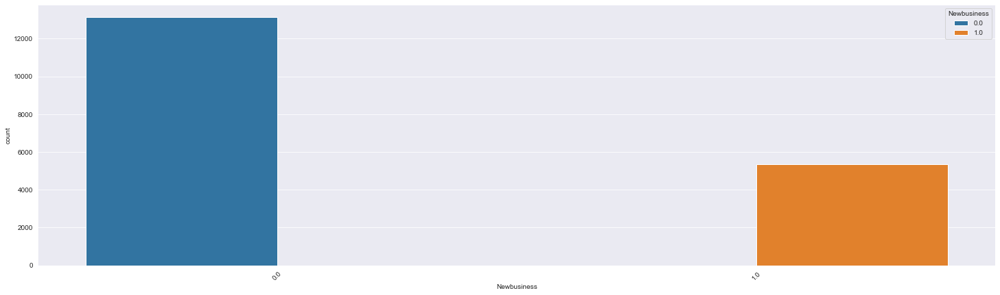

In [198]:
for col in discrete_features:
    print(col)
    plt.figure(figsize = (25,7))
    plt.xlabel(col)
    plt.ylabel('count')
    sns.countplot(data=train_df, x=col, hue="Newbusiness")
    plt.xticks(rotation = 45)
    plt.show()

In [199]:
continuous_features

['Term',
 'NoEmp',
 'CreateJob',
 'RetainedJob',
 'DisbursementGross',
 'ChgOffPrinGr',
 'GrAppv',
 'SBA_Appv']

In [200]:
discrete_features

Index(['ApprovalDate_Year', 'ApprovalFY', 'DisbursementDate_Year',
       'RetainedJob', 'ApprovalDate_Day', 'DisbursementDate_Day',
       'ChgOffDate_Day', 'ChgOffDate_Year', 'CreateJob', 'ApprovalDate_Month',
       'DisbursementDate_Month', 'ChgOffDate_Month', 'Newbusiness'],
      dtype='object')

Term


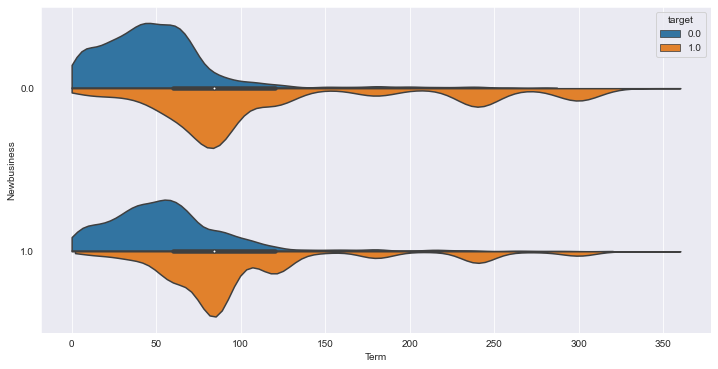

NoEmp


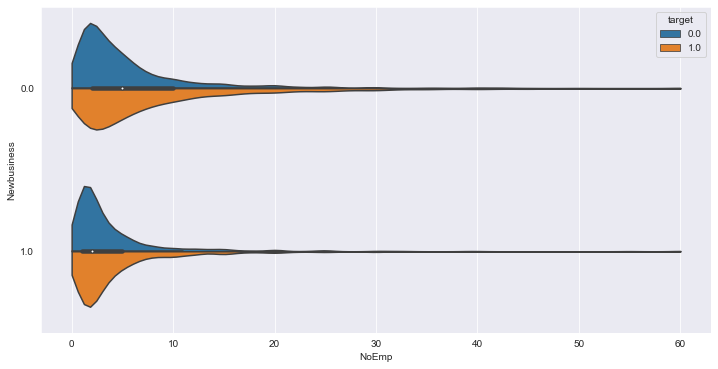

CreateJob


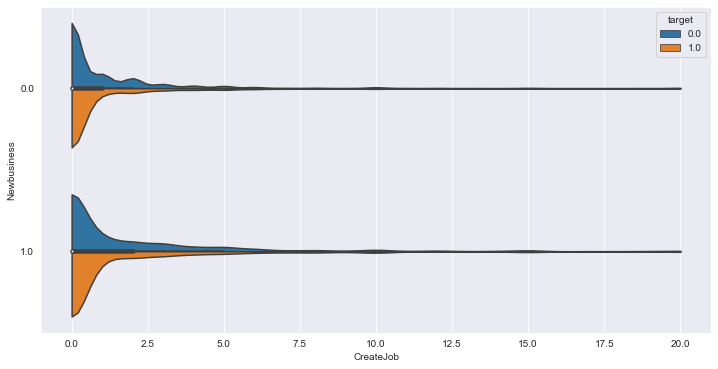

RetainedJob


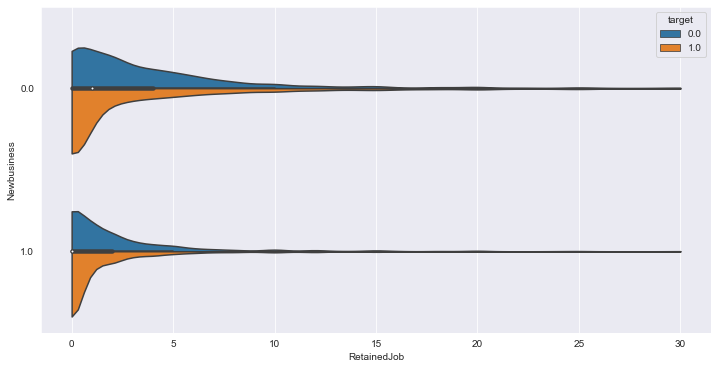

DisbursementGross


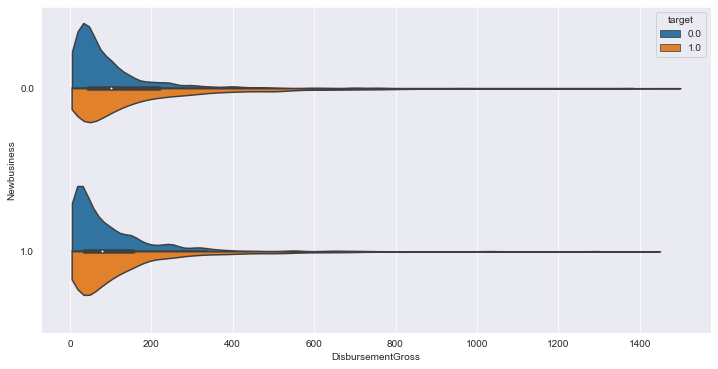

ChgOffPrinGr


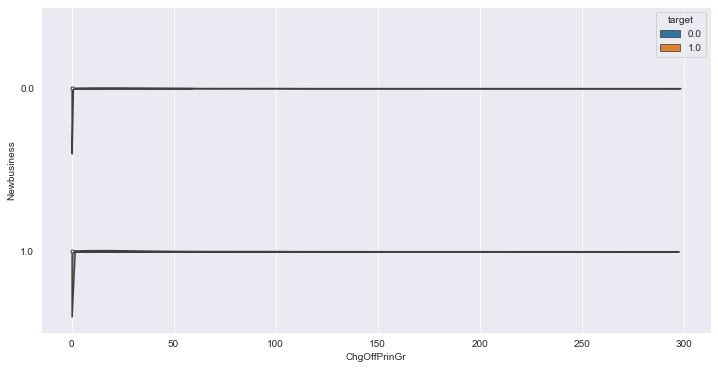

GrAppv


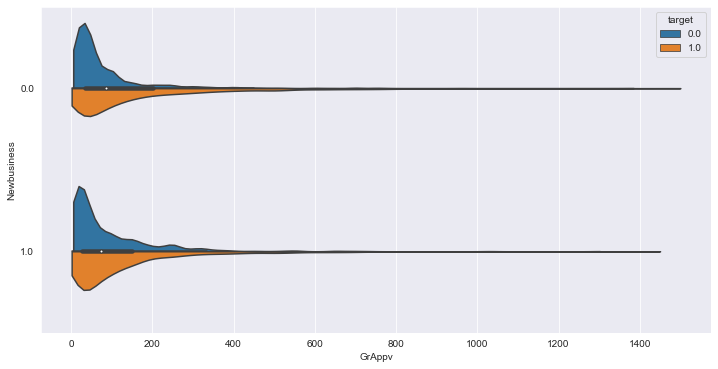

SBA_Appv


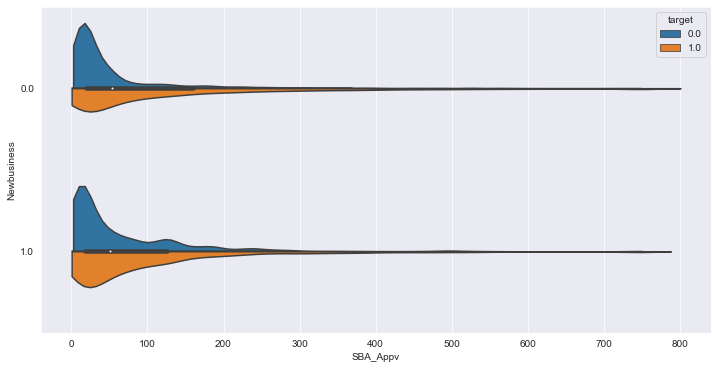

In [201]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (12,6))
    sns.violinplot(data=train_df, x=col, y="Newbusiness", hue="target", split=True,orient='h', bw=.15,cut=0)
    plt.xlabel(col)
    plt.ylabel('Newbusiness')
    plt.show()

### Observation :

1. From above we can observe that as the no.of pregnencies increasing [Glucose,Insulin,BMI,DiabetesPedigreeFunction] values are more

In [202]:
numerical_features

Index(['ApprovalFY', 'Term', 'NoEmp', 'CreateJob', 'RetainedJob',
       'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'ApprovalDate_Year', 'ApprovalDate_Month',
       'ApprovalDate_Day', 'DisbursementDate_Year', 'DisbursementDate_Month',
       'DisbursementDate_Day', 'ChgOffDate_Year', 'ChgOffDate_Month',
       'ChgOffDate_Day', 'target'],
      dtype='object')

In [203]:
categorical_features

Index(['City', 'State', 'Bank', 'BankState', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise'],
      dtype='object')

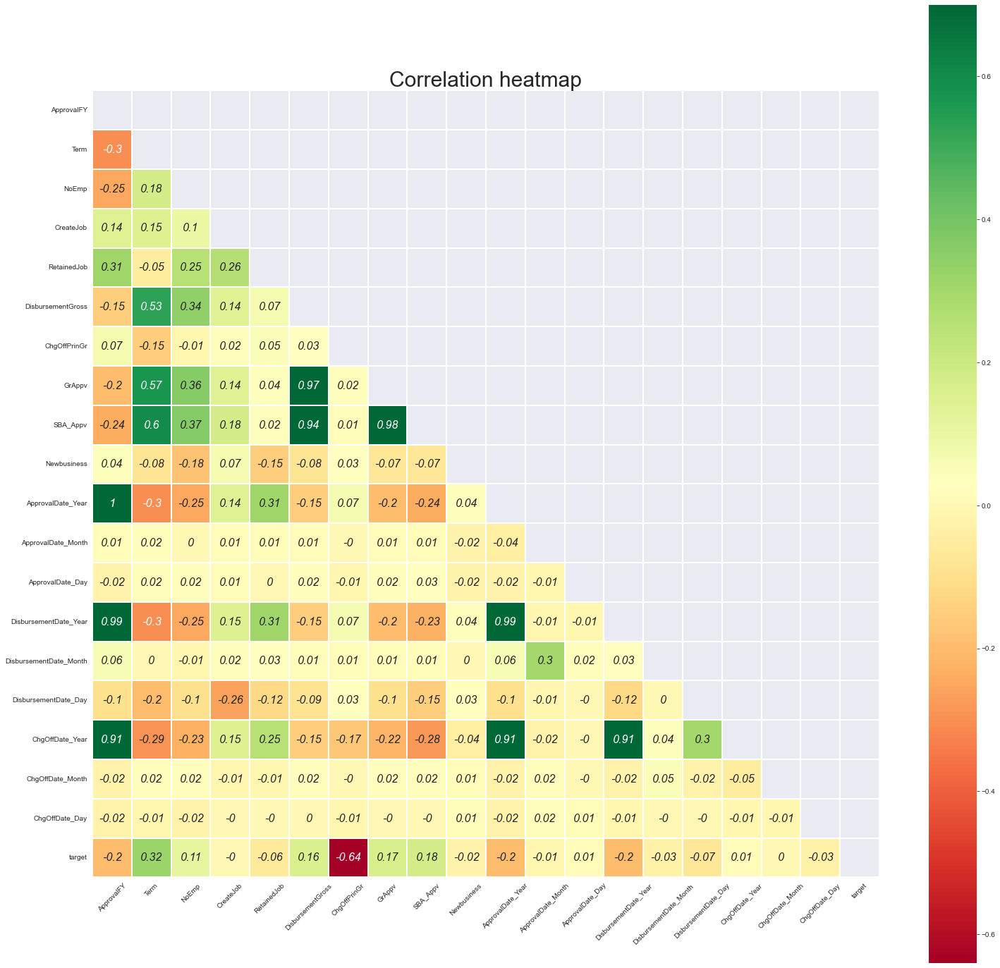

In [204]:
# Finds correlation between Independent and dependent attributes

mask = np.zeros_like(train_df[numerical_features].corr(),dtype = np.bool_)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize = (25,25))
plt.title('Correlation heatmap', fontsize = 30)

sns.heatmap(np.round_(train_df[numerical_features].corr(),decimals=2),cmap='RdYlGn',linewidths=0.25,square=True,annot=True,
            vmax=0.7,linecolor='w',annot_kws={'size':16,'style':'oblique'},mask=mask)

plt.xticks(rotation = 45)

plt.show()

### Observation :

1. We can see there is positive correlation between 'Glucose' and 'Outcome'
2. follwed by a moderate correlation with 'Insulin'  and 'BMI'

### Multicollinearity

4. there is clear positive correlation among ('Age','Pregnancies'),('Glucose','Insulin'),('BMI','SkinThickness')

#### We need to be very careful with this Multicollinearity when using 'Linear ML Models'

## Categorical_features

### Univariate/Bivariate analysis

In [205]:
train_df[categorical_features].nunique().sort_values(ascending=False)

City             5654
Bank             1948
BankState          52
State              51
NAICS              21
UrbanRural          3
RevLineCr           2
LowDoc              2
Has_Franchise       2
dtype: int64

In [206]:
categorical_features = train_df[categorical_features].nunique().sort_values(ascending=False).index

categorical_features

Index(['City', 'Bank', 'BankState', 'State', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise'],
      dtype='object')

BankState


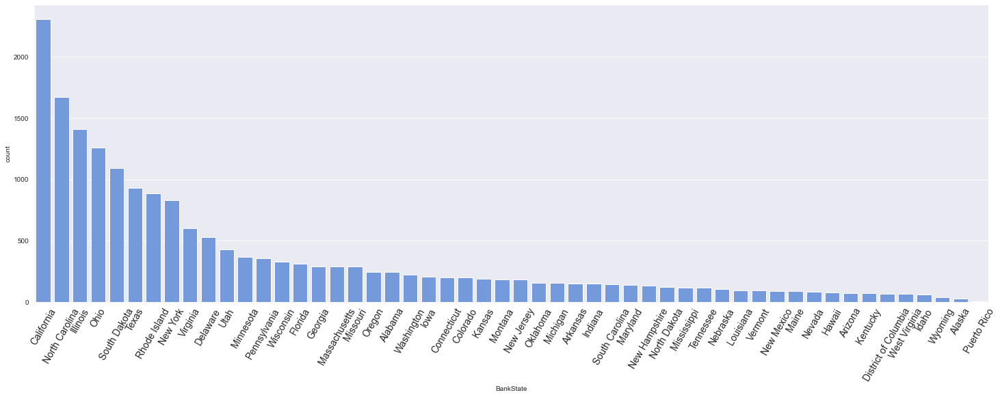

State


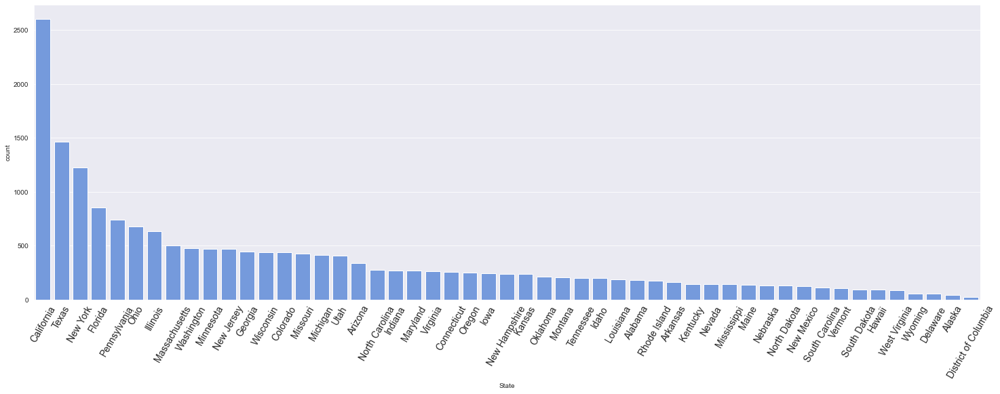

NAICS


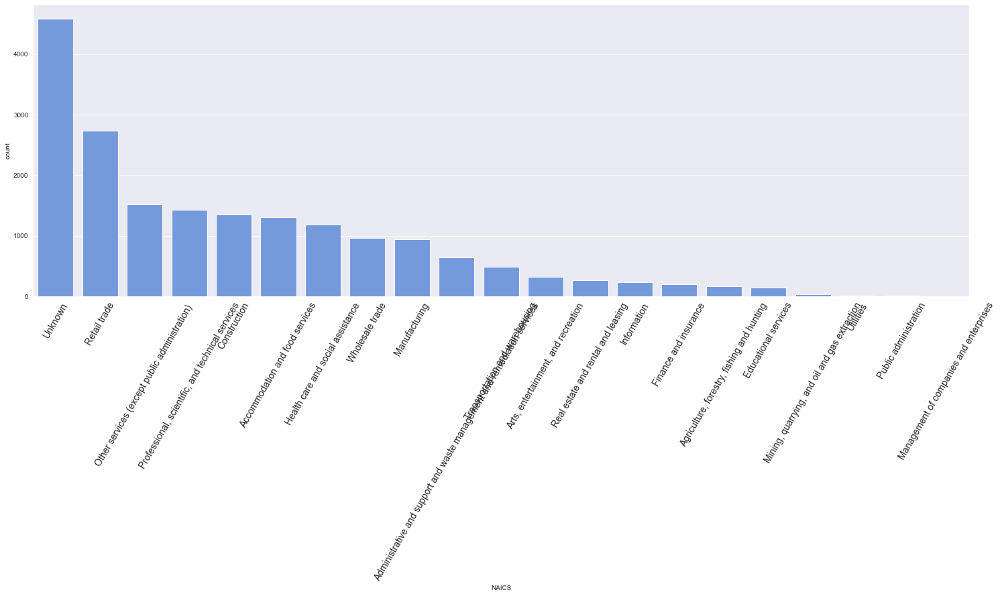

UrbanRural


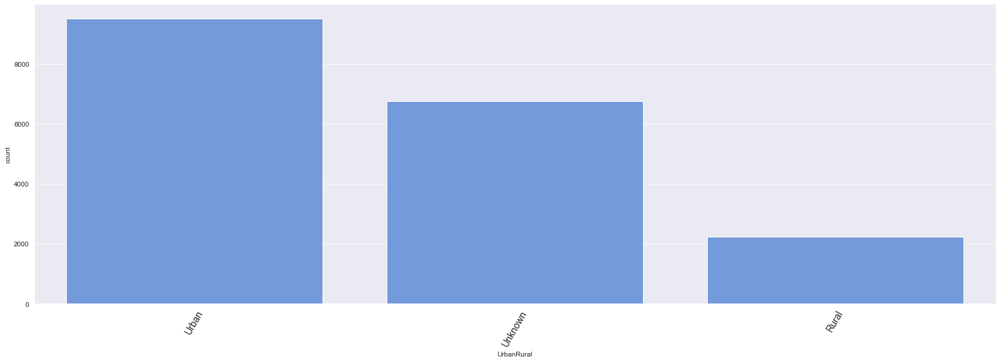

RevLineCr


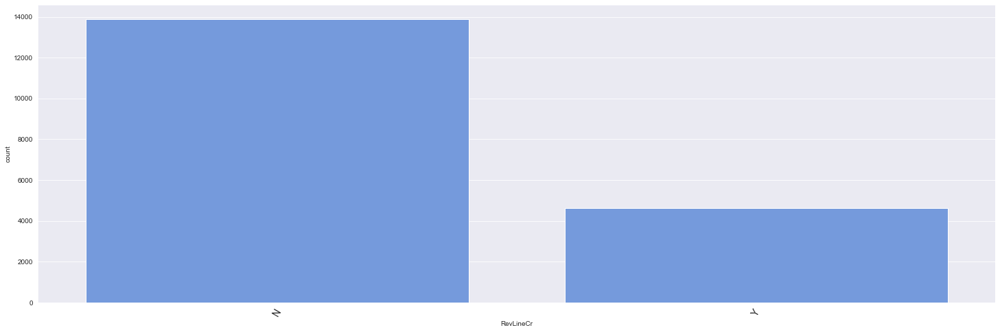

LowDoc


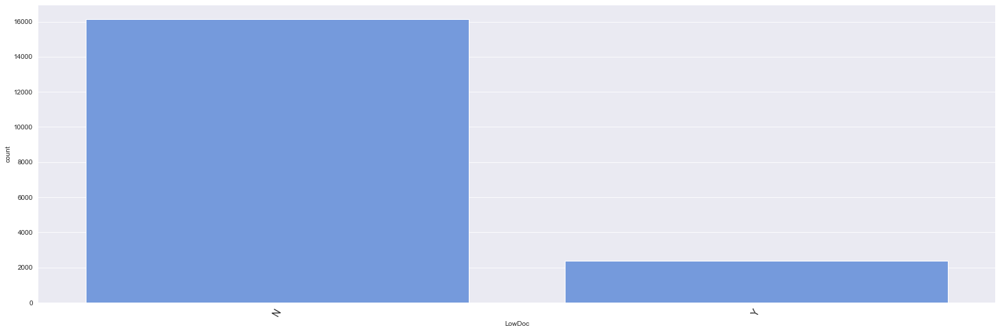

Has_Franchise


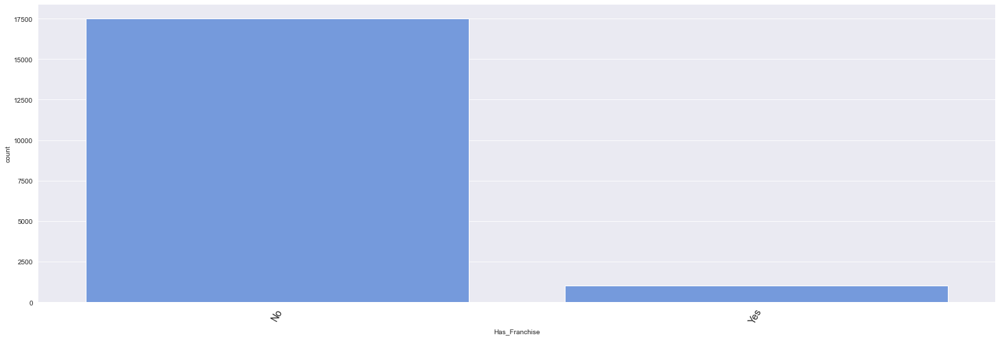

In [207]:
for col in categorical_features[2:]:
    print(col)
    plt.figure(figsize = (25,8))
    sns.countplot(data=train_df, x=col,color='cornflowerblue',order=train_df[col].value_counts().index)
    plt.xlabel(col)
    plt.xticks(rotation=60,fontsize=14)
    plt.ylabel('count')
    plt.show()

BankState


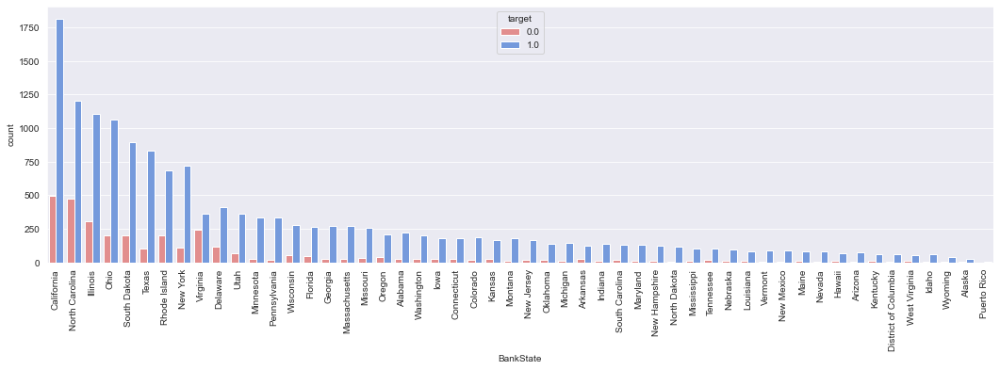

State


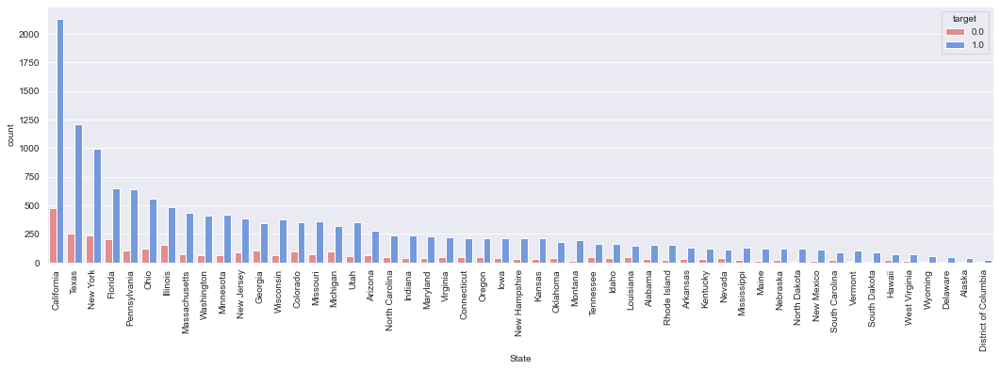

NAICS


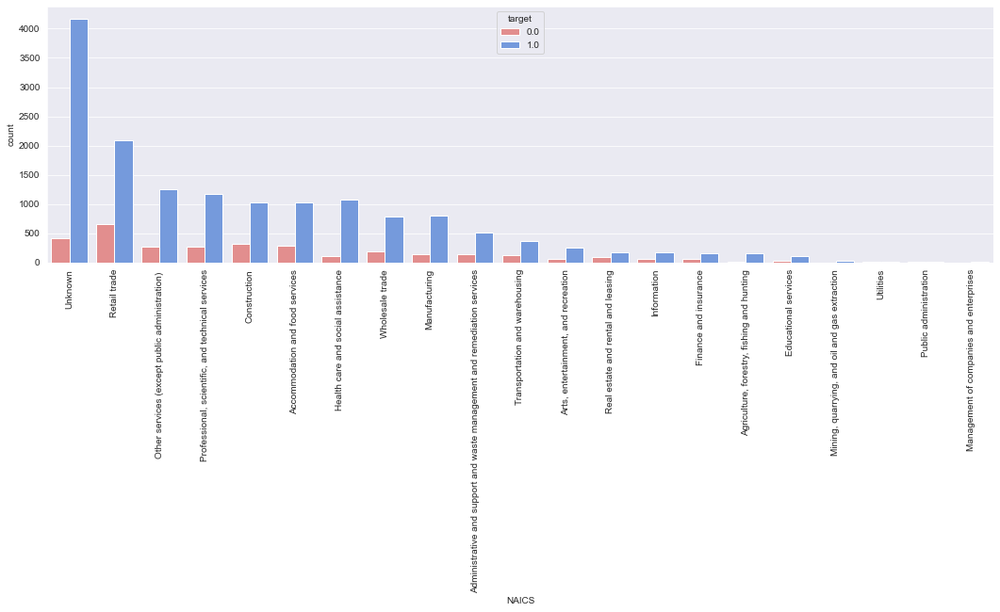

UrbanRural


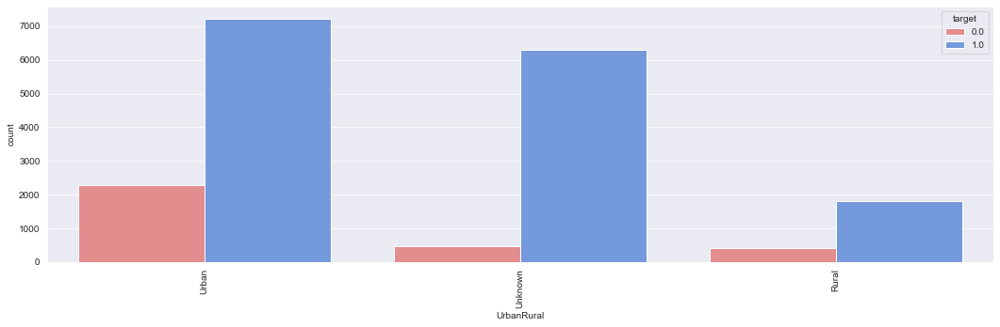

RevLineCr


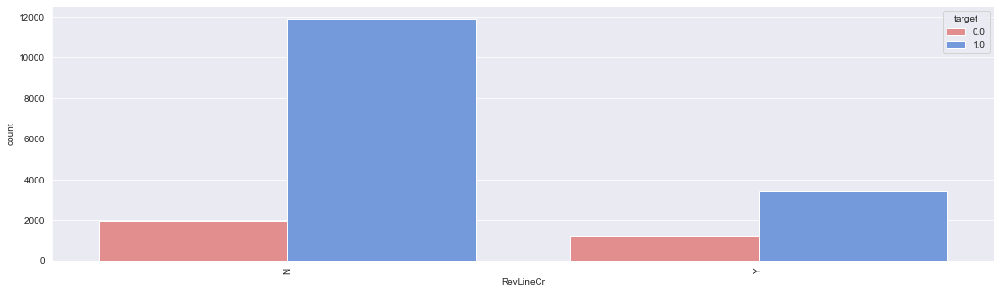

LowDoc


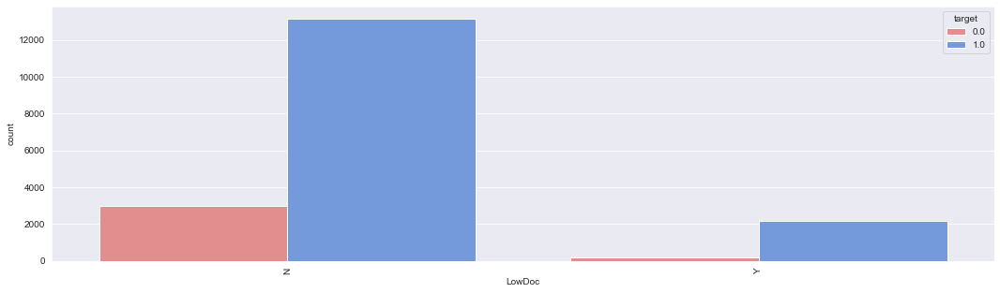

Has_Franchise


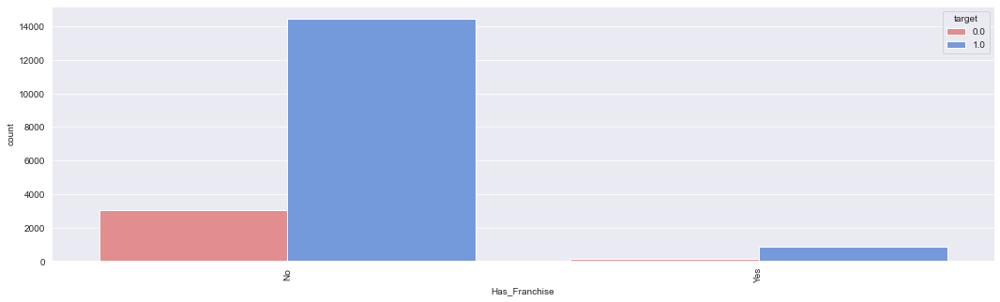

In [208]:
for col in categorical_features[2:]:
    print(col)
    plt.figure(figsize = (18,5))
    plt.xlabel(col)
    plt.ylabel('count')
    sns.countplot(data=train_df, x=col, hue="target",palette=['lightcoral','cornflowerblue'],order=train_df[col].value_counts().index)
    plt.xticks(rotation=90)
    plt.show()

In [209]:
['UrbanRural','RevLineCr', 'LowDoc', 'Has_Franchise']

['UrbanRural', 'RevLineCr', 'LowDoc', 'Has_Franchise']

UrbanRural


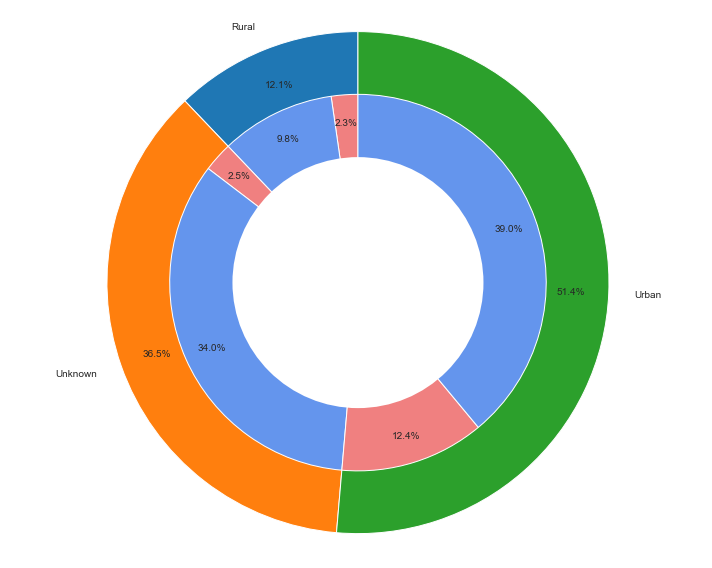

In [210]:
print('UrbanRural')
labels = train_df['UrbanRural'].value_counts().sort_index().index
sizes = train_df['UrbanRural'].value_counts().sort_index().values
#labels_gender = [0,1,0,1]
sizes_gender = train_df.groupby(['UrbanRural','target'])['target'].count().values
#colors = ['slategrey', '#ffcc99']
colors_gender = ['lightcoral','cornflowerblue','lightcoral','cornflowerblue','lightcoral','cornflowerblue']
 
# Plot
plt.figure(figsize = (10,8))
plt.pie(sizes, labels=labels, startangle=90,frame=True,autopct='%1.1f%%', pctdistance=0.85)
plt.pie(sizes_gender,colors=colors_gender,radius=0.75,startangle=90,autopct='%1.1f%%', pctdistance=0.85)
centre_circle = plt.Circle((0,0),0.5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
 
plt.axis('equal')
plt.tight_layout()
plt.show()

RevLineCr


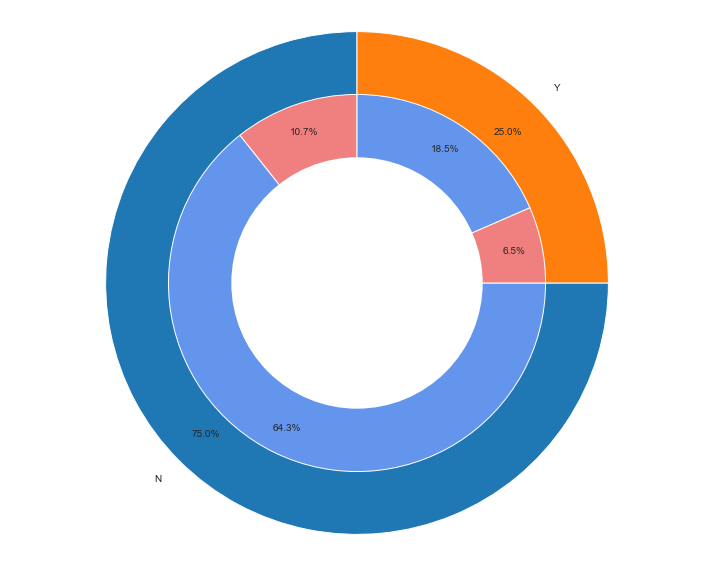

In [211]:
print('RevLineCr')
labels = train_df['RevLineCr'].value_counts().sort_index().index
sizes = train_df['RevLineCr'].value_counts().sort_index().values
#labels_gender = [0,1,0,1]
sizes_gender = train_df.groupby(['RevLineCr','target'])['target'].count().values
#colors = ['slategrey', '#ffcc99']
colors_gender = ['lightcoral','cornflowerblue','lightcoral','cornflowerblue']
 
# Plot
plt.figure(figsize = (10,8))
plt.pie(sizes, labels=labels, startangle=90,frame=True,autopct='%1.1f%%', pctdistance=0.85)
plt.pie(sizes_gender,colors=colors_gender,radius=0.75,startangle=90,autopct='%1.1f%%', pctdistance=0.85)
centre_circle = plt.Circle((0,0),0.5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
 
plt.axis('equal')
plt.tight_layout()
plt.show()

LowDoc


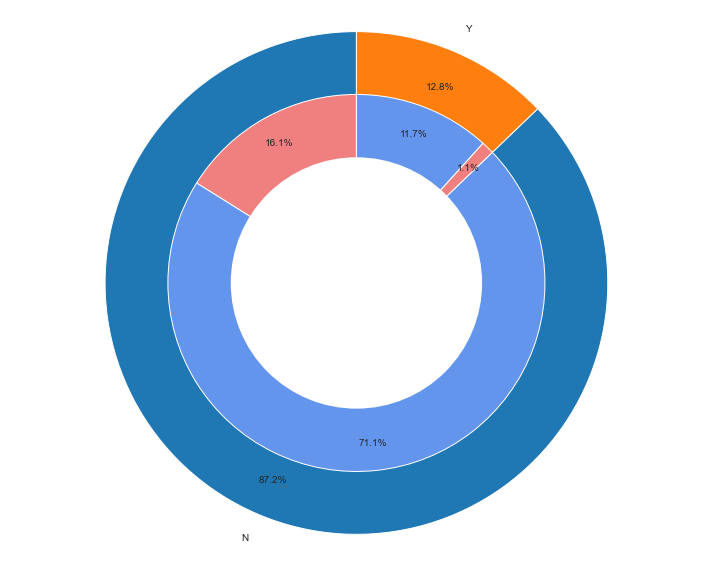

In [212]:
print('LowDoc')
labels = train_df['LowDoc'].value_counts().sort_index().index
sizes = train_df['LowDoc'].value_counts().sort_index().values
#labels_gender = [0,1,0,1]
sizes_gender = train_df.groupby(['LowDoc','target'])['target'].count().values
#colors = ['slategrey', '#ffcc99']
colors_gender = ['lightcoral','cornflowerblue','lightcoral','cornflowerblue']
 
# Plot
plt.figure(figsize = (10,8))
plt.pie(sizes, labels=labels, startangle=90,frame=True,autopct='%1.1f%%', pctdistance=0.85)
plt.pie(sizes_gender,colors=colors_gender,radius=0.75,startangle=90,autopct='%1.1f%%', pctdistance=0.85)
centre_circle = plt.Circle((0,0),0.5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
 
plt.axis('equal')
plt.tight_layout()
plt.show()

Has_Franchise


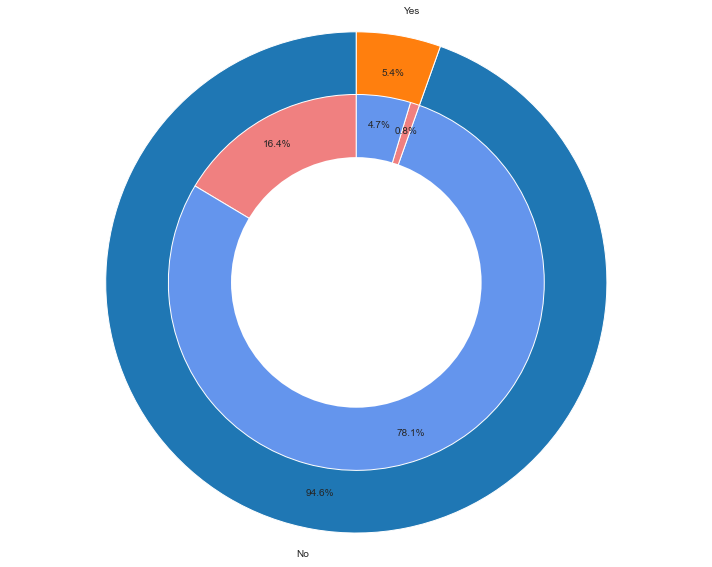

In [213]:
print('Has_Franchise')
labels = train_df['Has_Franchise'].value_counts().sort_index().index
sizes = train_df['Has_Franchise'].value_counts().sort_index().values
#labels_gender = [0,1,0,1]
sizes_gender = train_df.groupby(['Has_Franchise','target'])['target'].count().values
#colors = ['slategrey', '#ffcc99']
colors_gender = ['lightcoral','cornflowerblue','lightcoral','cornflowerblue']
 
# Plot
plt.figure(figsize = (10,8))
plt.pie(sizes, labels=labels, startangle=90,frame=True,autopct='%1.1f%%', pctdistance=0.85)
plt.pie(sizes_gender,colors=colors_gender,radius=0.75,startangle=90,autopct='%1.1f%%', pctdistance=0.85)
centre_circle = plt.Circle((0,0),0.5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
 
plt.axis('equal')
plt.tight_layout()
plt.show()

In [214]:
categorical_features

Index(['City', 'Bank', 'BankState', 'State', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise'],
      dtype='object')

In [215]:
discrete_features

Index(['ApprovalDate_Year', 'ApprovalFY', 'DisbursementDate_Year',
       'RetainedJob', 'ApprovalDate_Day', 'DisbursementDate_Day',
       'ChgOffDate_Day', 'ChgOffDate_Year', 'CreateJob', 'ApprovalDate_Month',
       'DisbursementDate_Month', 'ChgOffDate_Month', 'Newbusiness'],
      dtype='object')

BankState


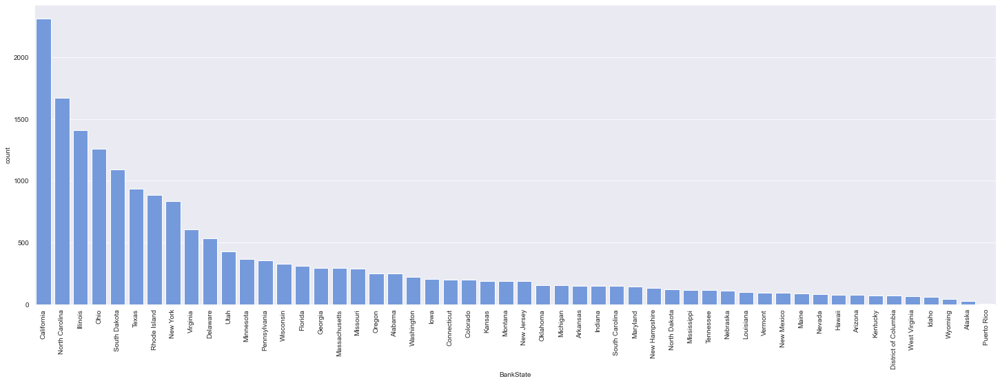

State


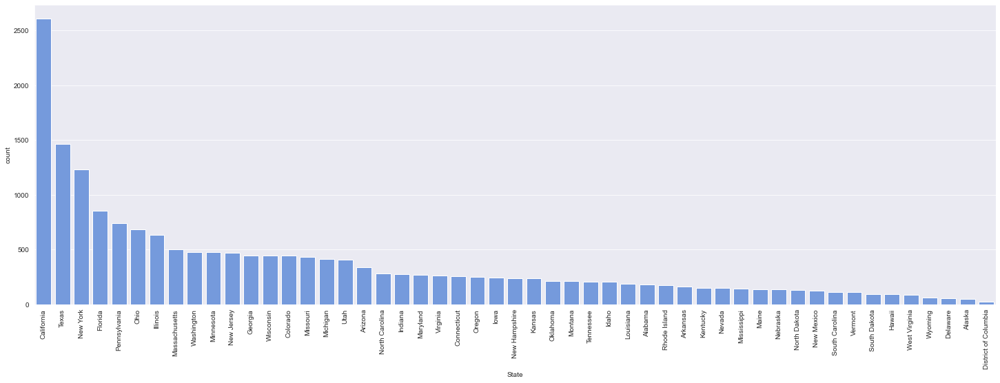

NAICS


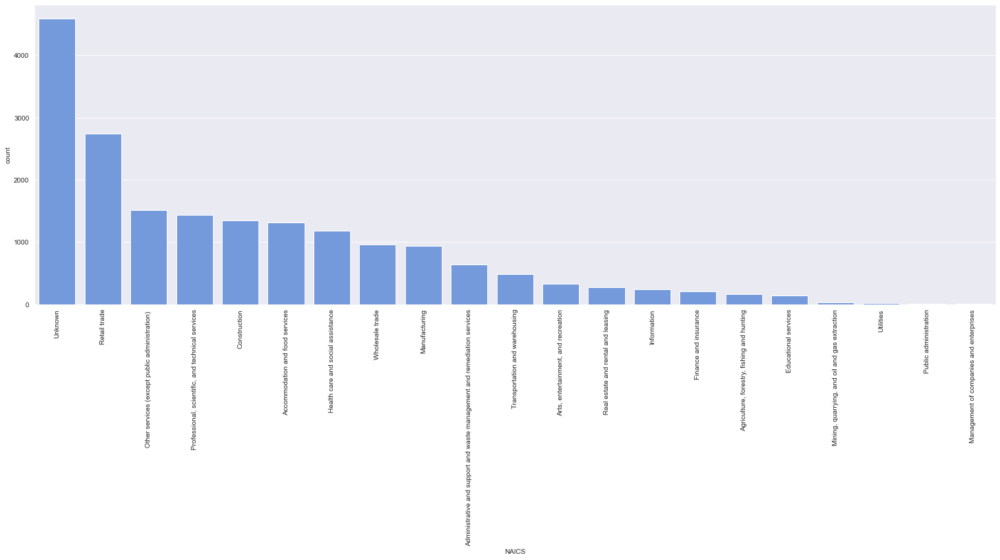

UrbanRural


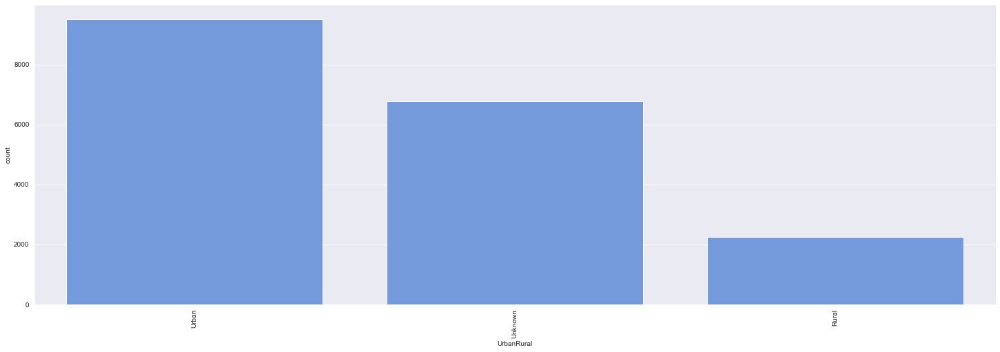

RevLineCr


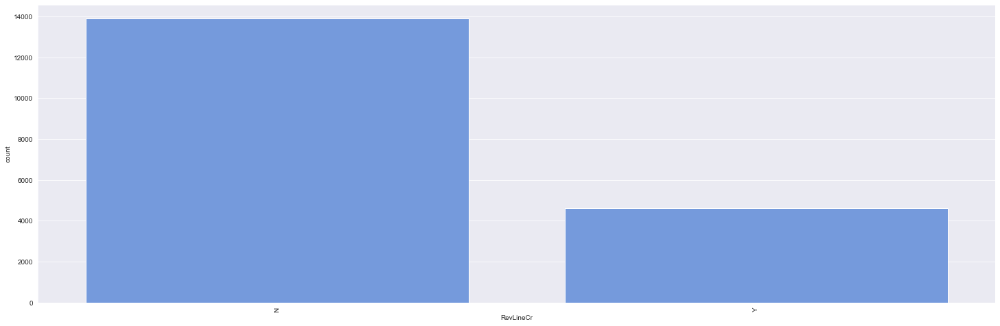

LowDoc


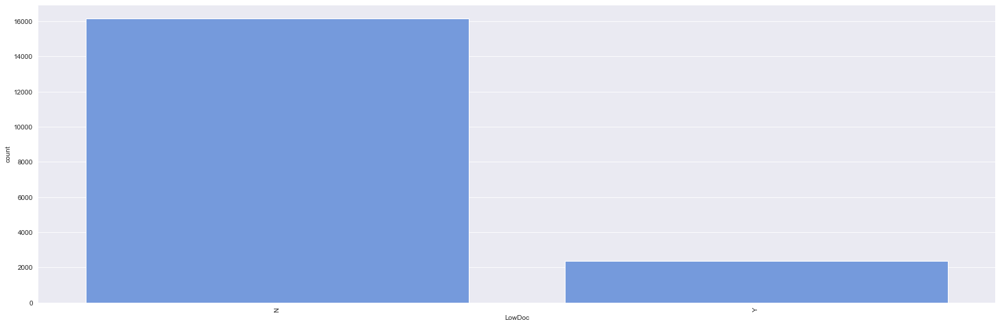

Has_Franchise


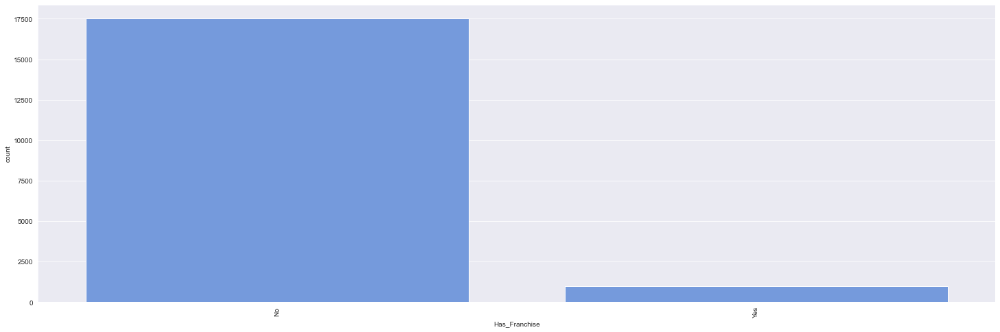

In [216]:
for col in categorical_features[2:]:
    print(col)
    plt.figure(figsize = (25,8))
    sns.countplot(data=train_df, x=col,color='cornflowerblue',order=train_df[col].value_counts().index)
    plt.xlabel(col)
    plt.xticks(rotation=90)
    plt.ylabel('count')
    plt.show()

BankState


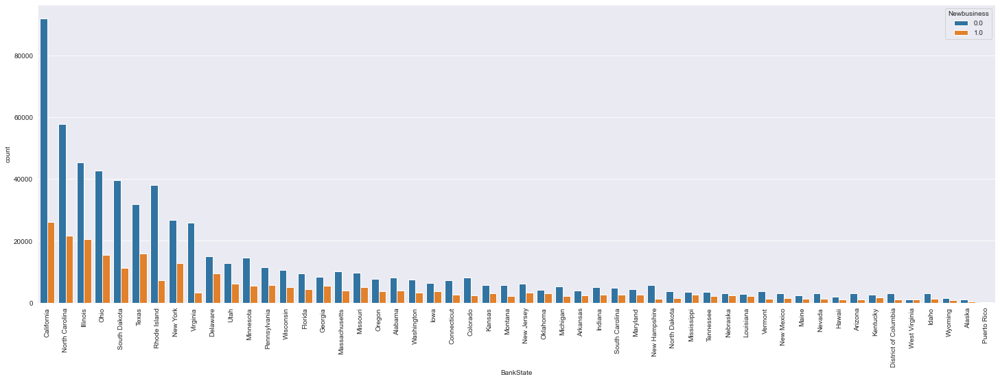

State


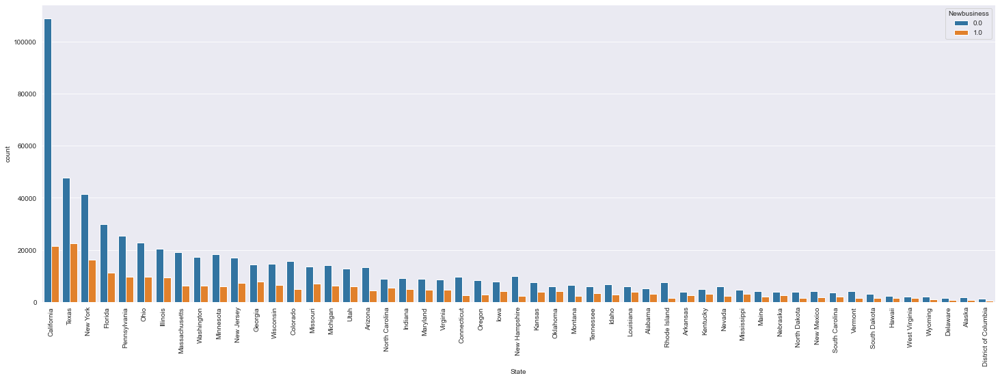

NAICS


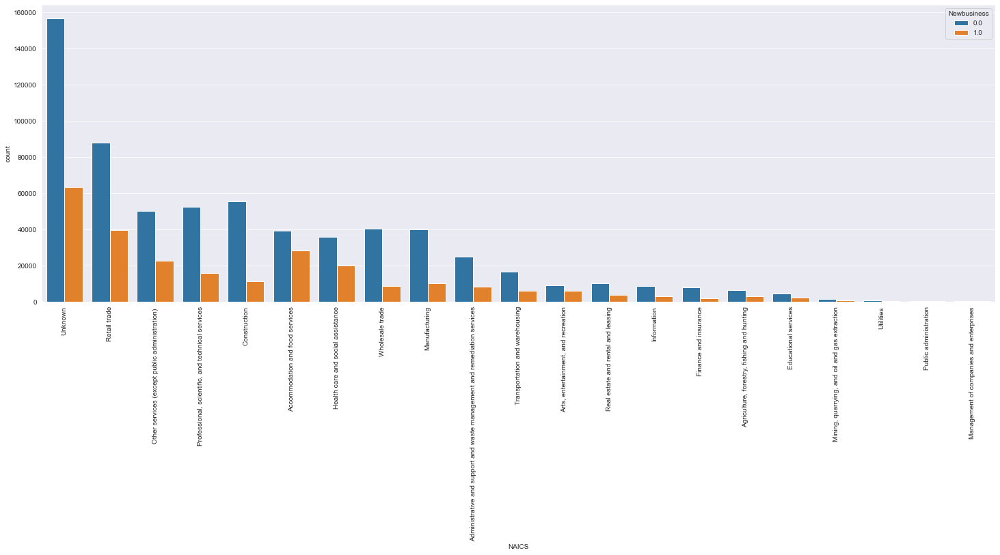

UrbanRural


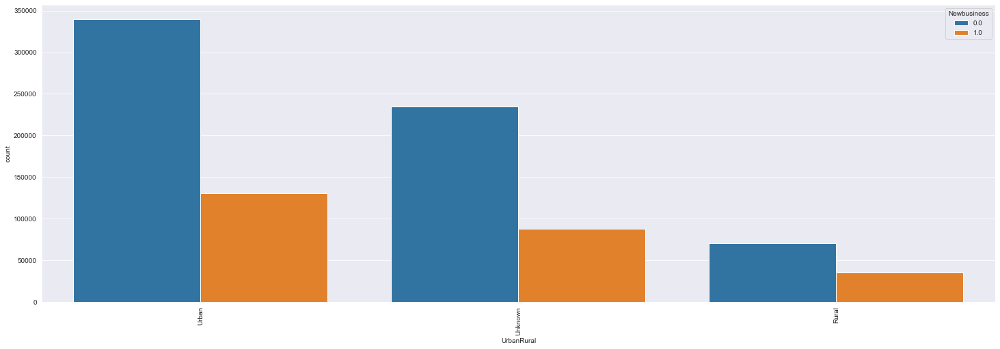

RevLineCr


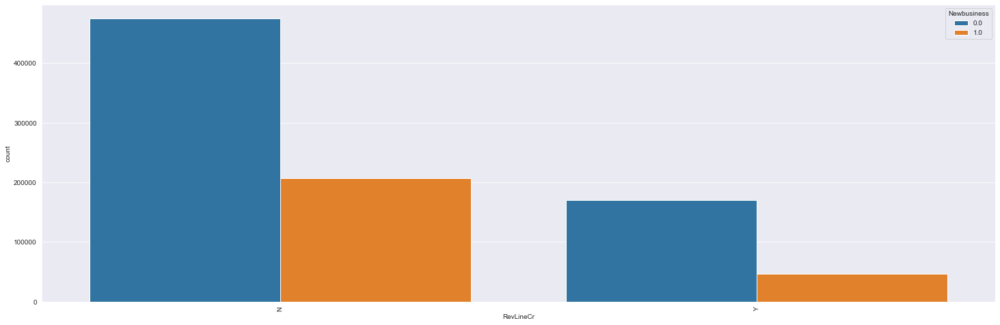

LowDoc


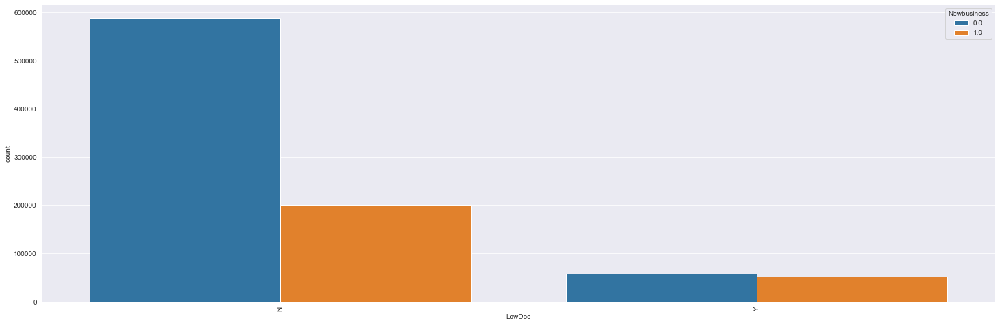

Has_Franchise


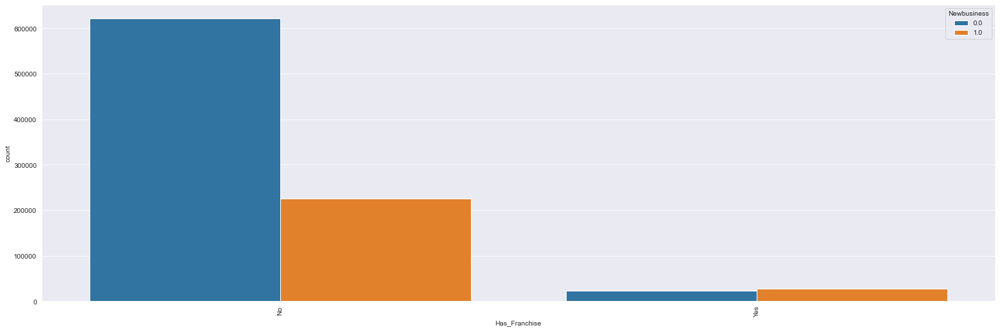

In [217]:
for col in categorical_features[2:]:
    print(col)
    plt.figure(figsize = (25,8))
    plt.xlabel(col)
    plt.ylabel('count')
    sns.countplot(data=df, x=col, hue="Newbusiness",order=train_df[col].value_counts().index)
    plt.xticks(rotation=90)
    plt.show()

In [218]:
categorical_features

Index(['City', 'Bank', 'BankState', 'State', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise'],
      dtype='object')

Term


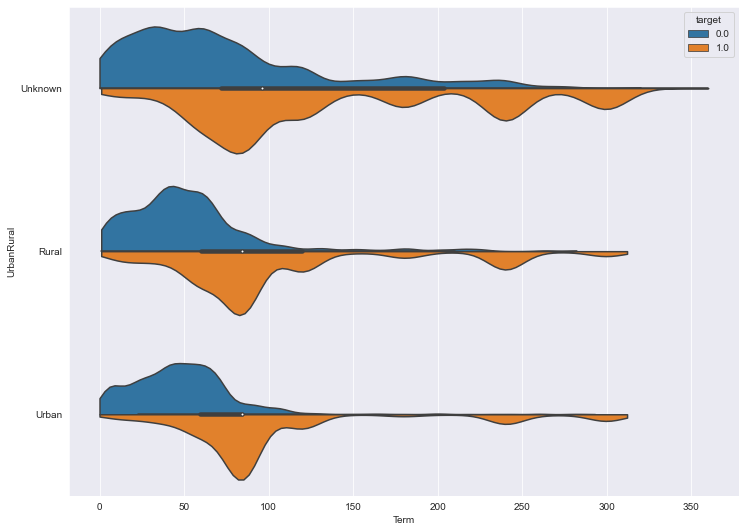

NoEmp


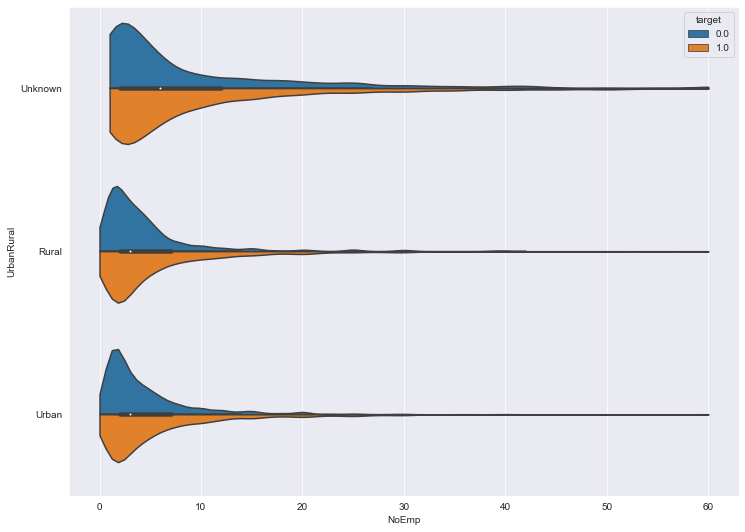

CreateJob


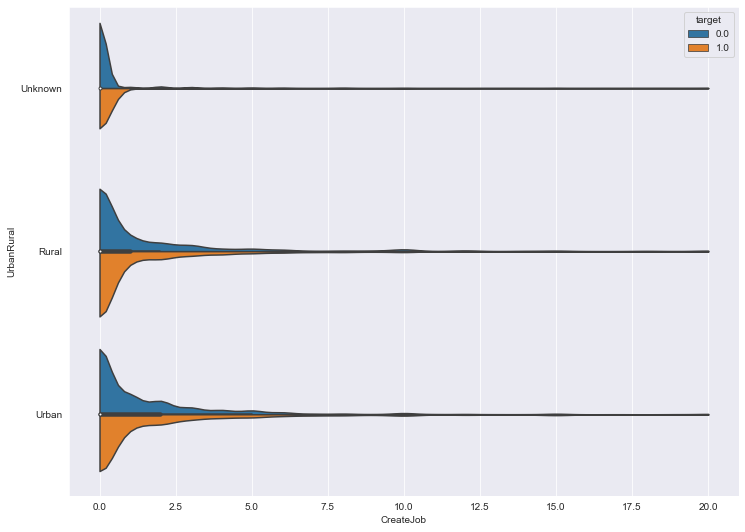

RetainedJob


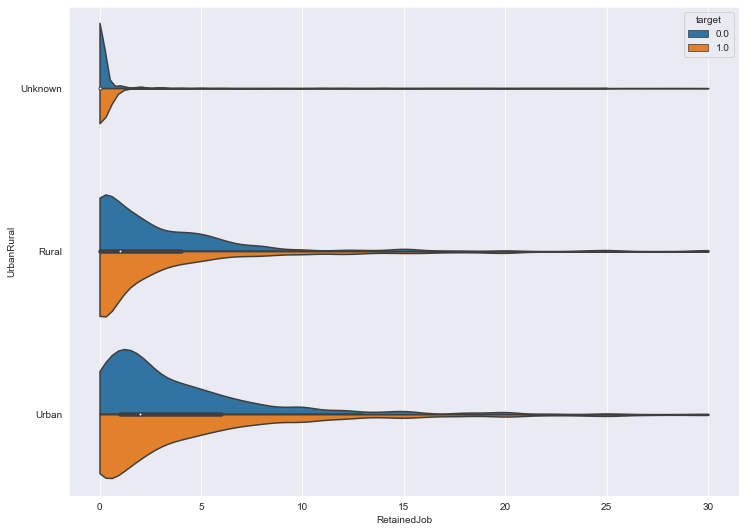

DisbursementGross


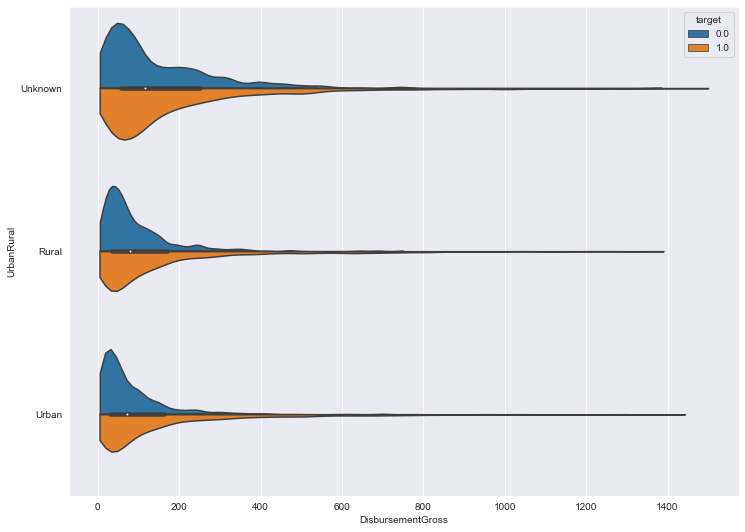

ChgOffPrinGr


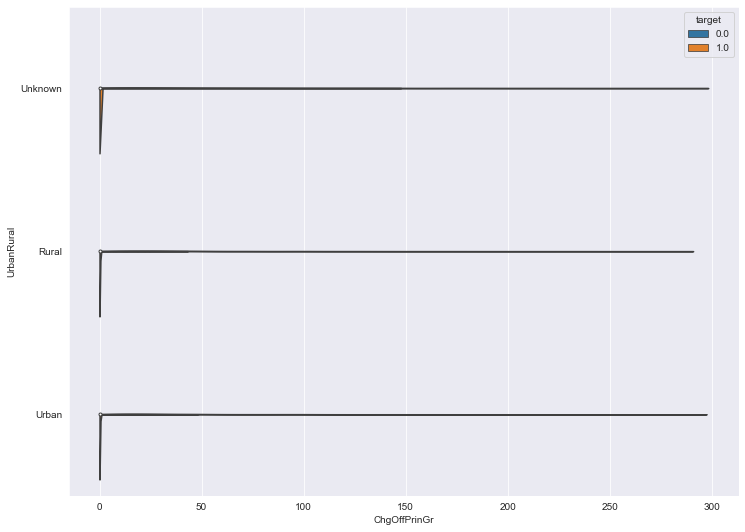

GrAppv


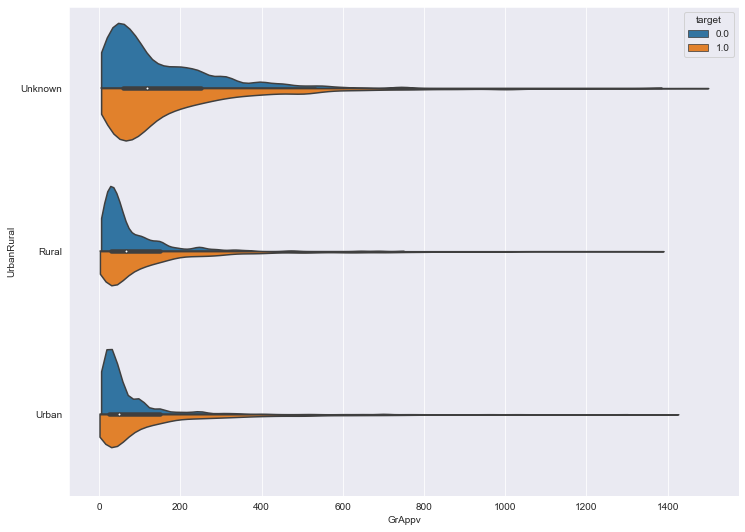

SBA_Appv


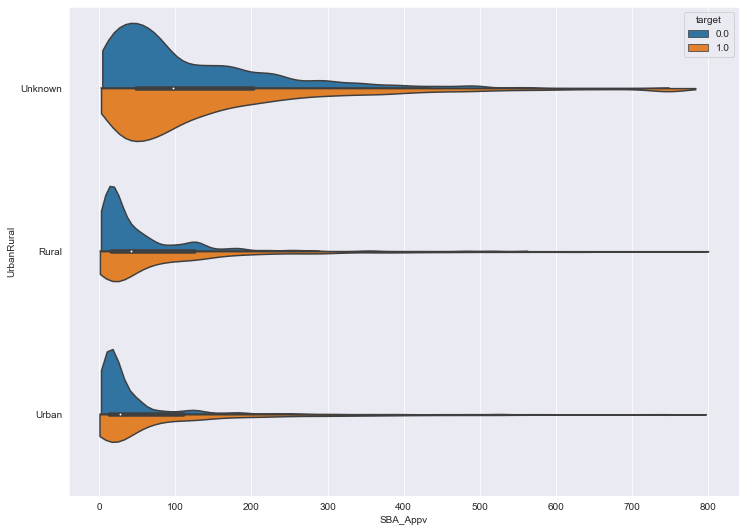

In [219]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (12,9))
    sns.violinplot(data=train_df, x=col, y="UrbanRural", hue="target", split=True,orient='h', bw=.15,cut=0)
    plt.xlabel(col)
    plt.ylabel('UrbanRural')
    plt.show()

Term


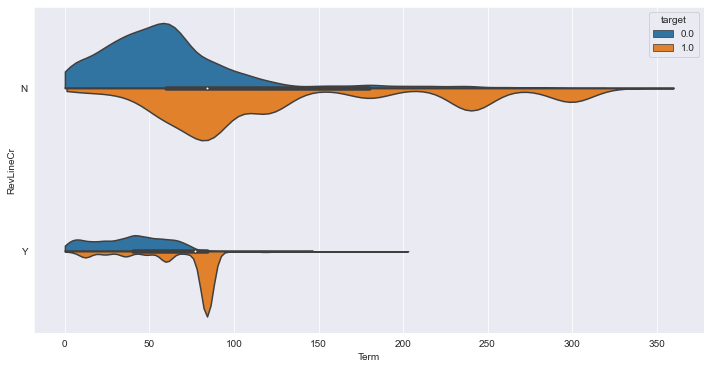

NoEmp


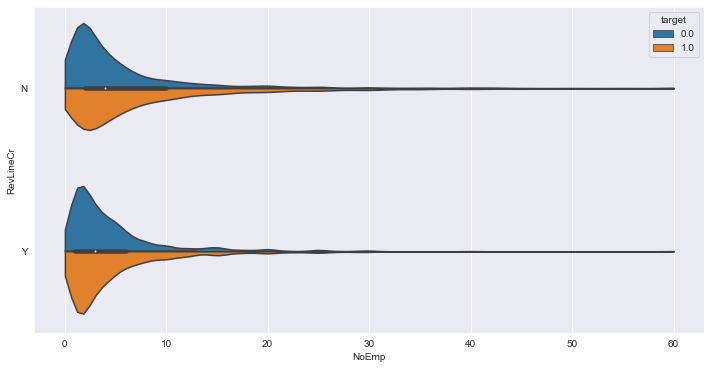

CreateJob


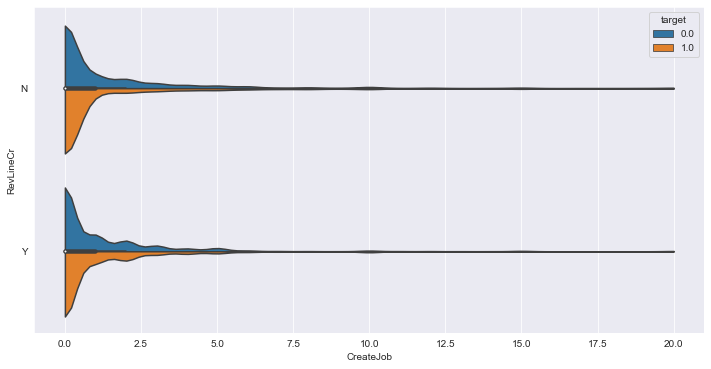

RetainedJob


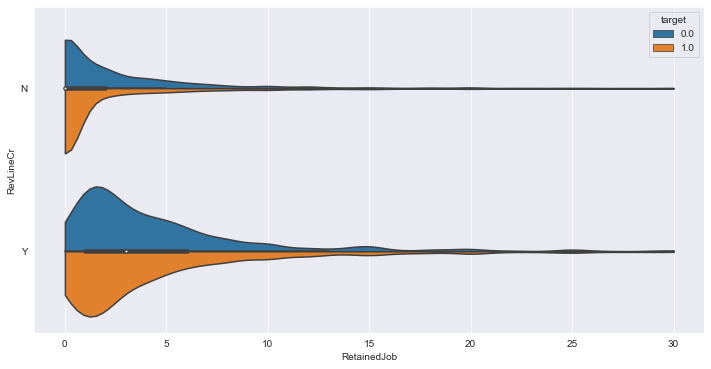

DisbursementGross


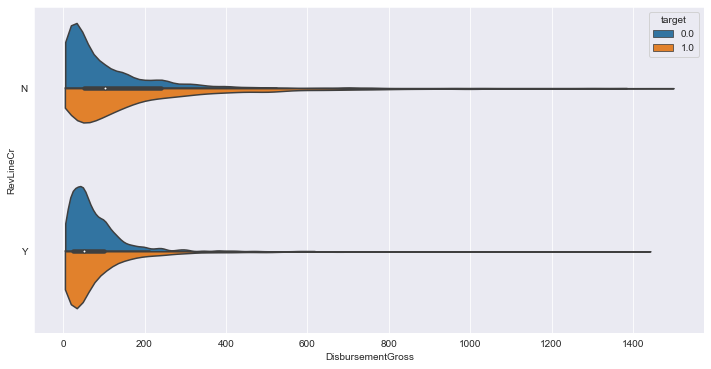

ChgOffPrinGr


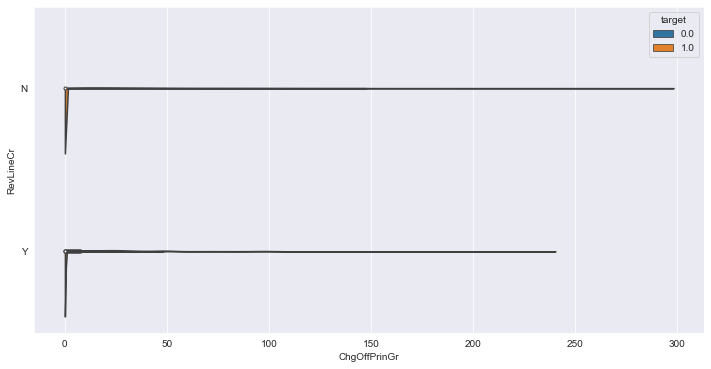

GrAppv


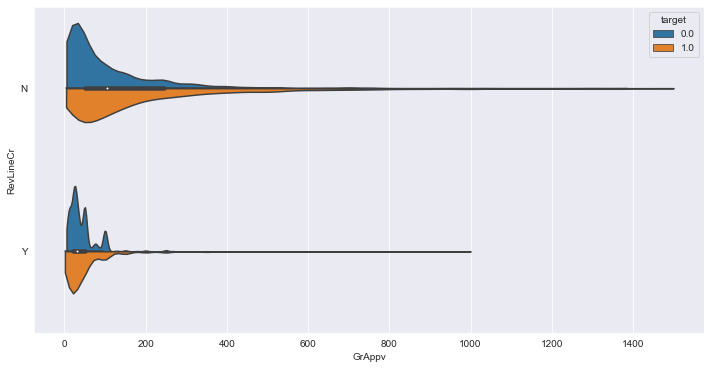

SBA_Appv


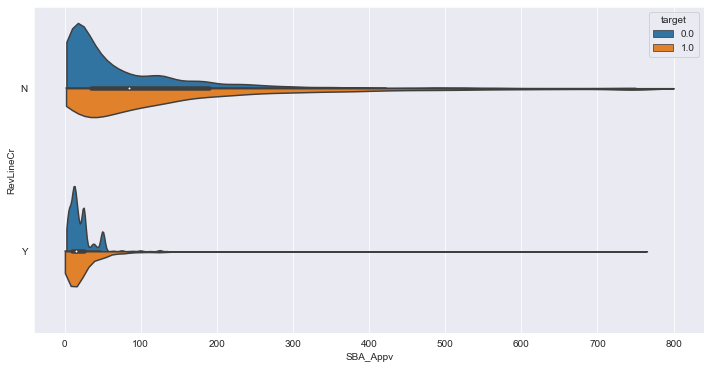

In [220]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (12,6))
    sns.violinplot(data=train_df, x=col, y="RevLineCr", hue="target", split=True,orient='h', bw=.15,cut=0)
    plt.xlabel(col)
    plt.ylabel('RevLineCr')
    plt.show()

Term


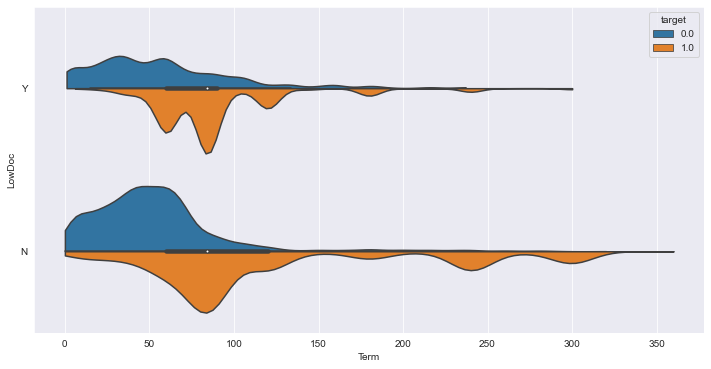

NoEmp


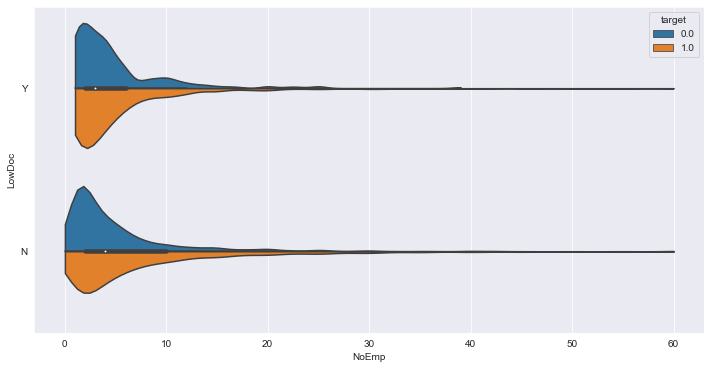

CreateJob


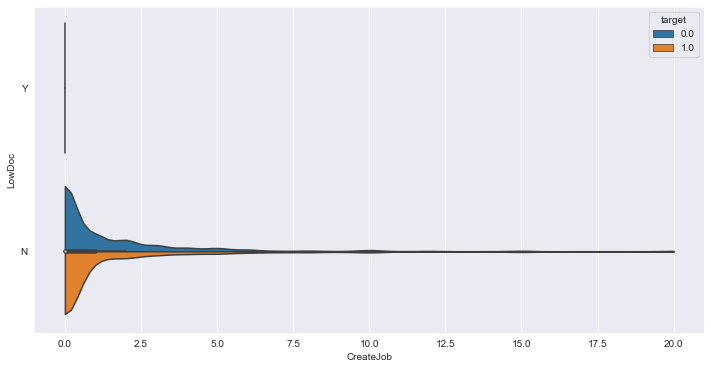

RetainedJob


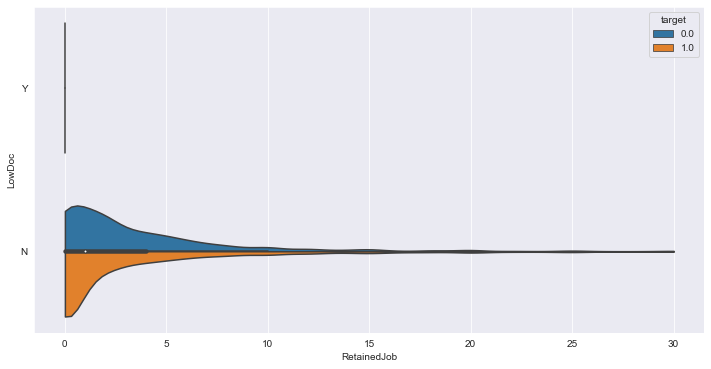

DisbursementGross


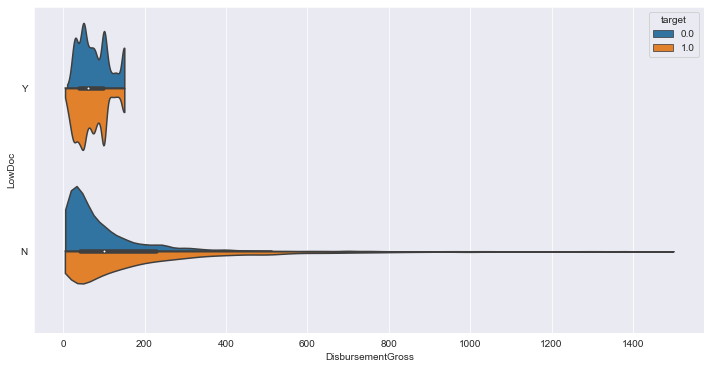

ChgOffPrinGr


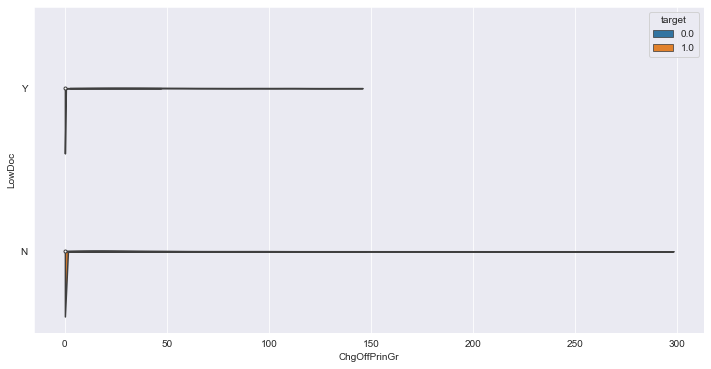

GrAppv


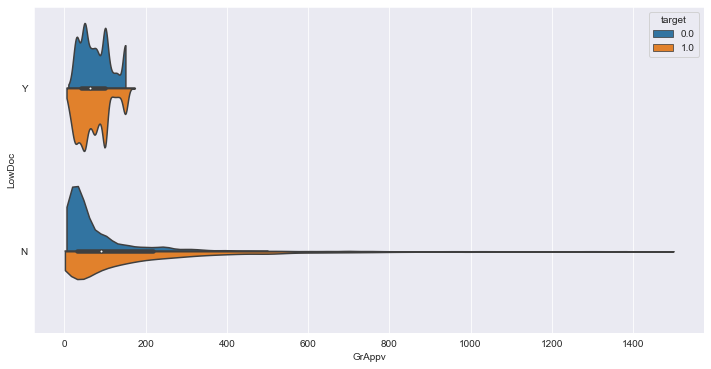

SBA_Appv


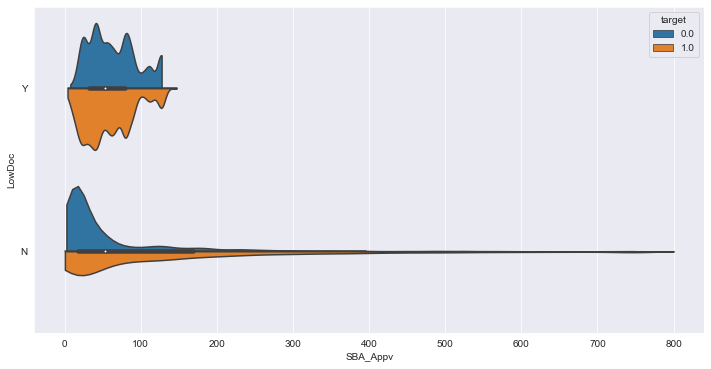

In [221]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (12,6))
    sns.violinplot(data=train_df, x=col, y="LowDoc", hue="target", split=True,orient='h', bw=.15,cut=0)
    plt.xlabel(col)
    plt.ylabel('LowDoc')
    plt.show()

Term


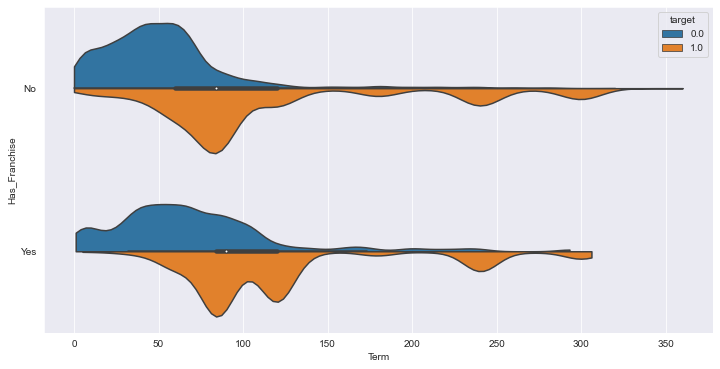

NoEmp


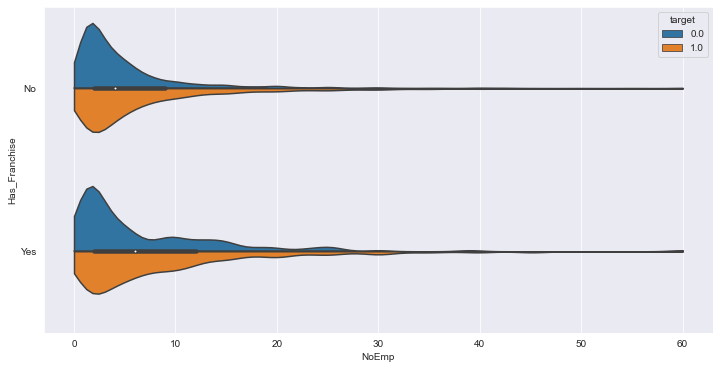

CreateJob


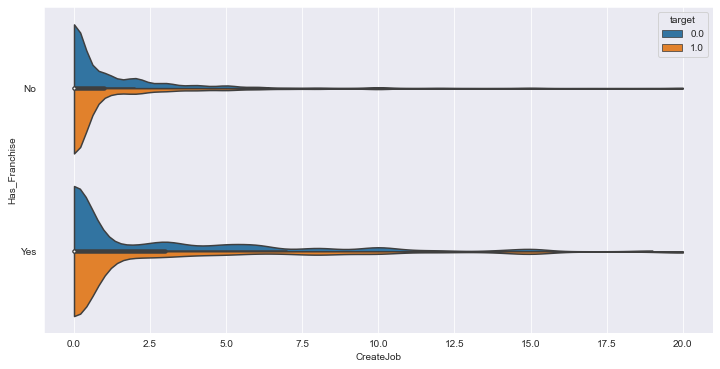

RetainedJob


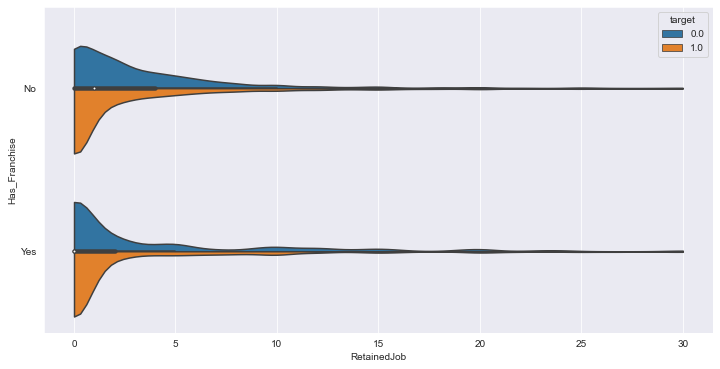

DisbursementGross


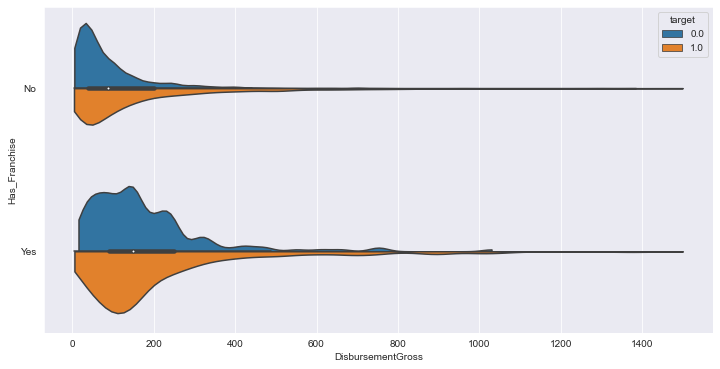

ChgOffPrinGr


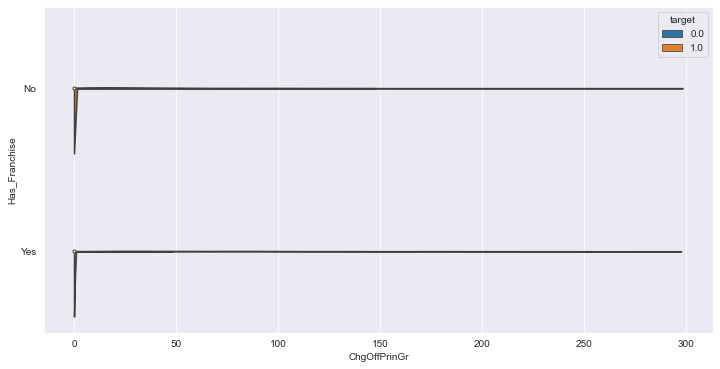

GrAppv


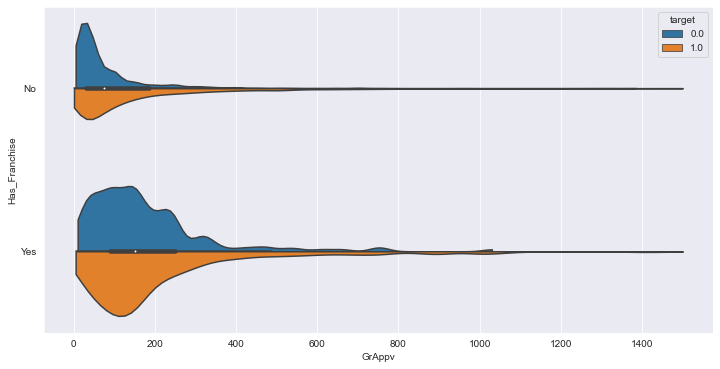

SBA_Appv


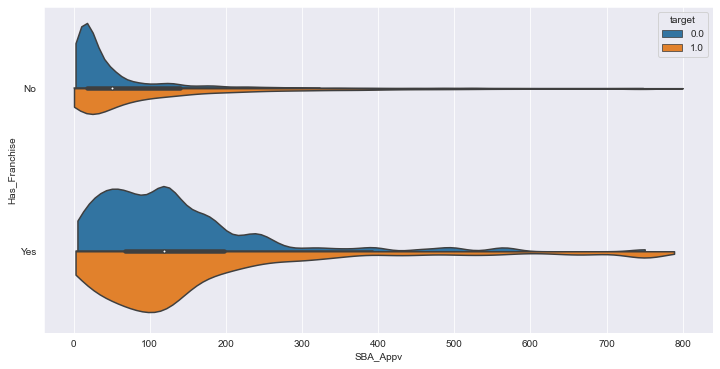

In [222]:
for col in continuous_features:
    print(col)
    plt.figure(figsize = (12,6))
    sns.violinplot(data=train_df, x=col, y="Has_Franchise", hue="target", split=True,orient='h', bw=.15,cut=0)
    plt.xlabel(col)
    plt.ylabel('Has_Franchise')
    plt.show()

In [223]:
train_df.ncudoy0s8uv()

AttributeError: 'DataFrame' object has no attribute 'ncudoy0s8uv'

In [224]:
train_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
1,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
2,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
3,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
4,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,NEW YORK,New York,CAPITAL ONE NATL ASSOC,Virginia,Construction,1991,144,20,0,0,Unknown,N,N,200.0,0.0,250.0,212.5,0.0,No,1991,5,13,1991.0,10.0,31.0,NaN,NaN,NaN,1.0
19996,ST. ALBANS,West Virginia,BRANCH BK. & TR CO,West Virginia,Unknown,1992,231,5,0,0,Unknown,N,N,285.0,0.0,285.0,242.2,0.0,No,1992,4,3,1992.0,4.0,30.0,NaN,NaN,NaN,1.0
19997,BUENA PARK,California,WELLS FARGO BANK NATL ASSOC,California,Other services (except public administration),2001,120,1,3,0,Urban,N,N,240.0,0.0,240.0,180.0,1.0,No,2001,6,29,2001.0,7.0,31.0,NaN,NaN,NaN,1.0
19998,KENNER,Louisiana,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Other services (except public administration),2007,84,1,4,1,Urban,Y,N,108.8,0.0,25.0,12.5,1.0,No,2006,11,21,2006.0,11.0,30.0,NaN,NaN,NaN,1.0


In [225]:
test_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,KINGSPORT,Tennessee,1ST BK & TR CO,Tennessee,Manufacturing,2004,42,1,0,0,Urban,N,Y,31.0,0.0,31.0,26.4,1.0,No,2004,6,29,2006.0,3.0,31.0,NaN,NaN,NaN,1.0
1,BOTHELL,Washington,NORTHWEST BUS. DEVEL ASSOC,Washington,Unknown,2000,240,5,3,0,Rural,N,N,209.0,0.0,209.0,209.0,0.0,No,1999,12,21,2000.0,5.0,17.0,NaN,NaN,NaN,1.0
2,GLENDALE,Wisconsin,MILLER & SCHROEDER SMALL,Wisconsin,Construction,1997,120,30,0,0,Unknown,N,N,750.0,0.0,750.0,562.5,0.0,No,1997,3,21,1997.0,5.0,31.0,NaN,NaN,NaN,1.0
3,LUBBOCK,Texas,PLAINSCAPITAL BANK,Texas,Accommodation and food services,2004,87,19,19,38,Urban,N,N,202.0,0.0,202.0,151.5,1.0,Yes,2004,5,4,2006.0,1.0,31.0,NaN,NaN,NaN,1.0
4,COLUMBIA,Missouri,BANK OF AMERICA NATL ASSOC,North Carolina,Retail trade,2004,84,7,0,7,Rural,N,N,50.0,0.0,50.0,25.0,0.0,No,2004,9,8,2004.0,9.0,30.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,MOORPARK,California,U.S. BANK NATIONAL ASSOCIATION,California,Other services (except public administration),1998,300,1,0,0,Unknown,N,N,241.0,0.0,241.0,180.8,1.0,No,1998,3,11,1998.0,4.0,30.0,NaN,NaN,NaN,1.0
1996,FAIRFAX,Virginia,BRANCH BK. & TR CO,North Carolina,Accommodation and food services,2007,36,5,0,5,Urban,N,N,25.0,0.0,25.0,12.5,0.0,No,2007,1,2,2007.0,1.0,31.0,NaN,NaN,NaN,1.0
1997,ALLIANCE,Ohio,THE HUNTINGTON NATIONAL BANK,Ohio,Construction,2006,87,9,1,9,Urban,N,N,82.0,0.0,82.0,61.5,0.0,No,2006,3,24,2006.0,4.0,30.0,NaN,NaN,NaN,1.0
1998,REDLANDS,California,SECURITY BANK OF CALIFORNIA,California,Health care and social assistance,2007,120,9,1,9,Urban,N,N,1060.0,0.0,1060.0,795.0,1.0,No,2007,1,5,2007.0,2.0,28.0,NaN,NaN,NaN,1.0


In [226]:
# writing the final df to a file

train_df.to_csv('C://Users//rahul//Machine Learning//Projects//Finance Industry Projects//Should This Loan be Approved or Denied//Final_train_df.csv',index=False)

In [227]:
# writing the final df to a file

test_df.to_csv('C://Users//rahul//Machine Learning//Projects//Finance Industry Projects//Should This Loan be Approved or Denied//Final_test_df.csv',index=False)

# Feature Engineering

In [228]:
#Preprocessing imports
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer,QuantileTransformer,PowerTransformer
from sklearn.preprocessing import OneHotEncoder,OrdinalEncoder,LabelEncoder
from sklearn.preprocessing import StandardScaler,RobustScaler,MinMaxScaler

#Models
from sklearn.linear_model import LogisticRegression,SGDClassifier,RidgeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB,BernoulliNB,CategoricalNB,MultinomialNB
from sklearn.tree import DecisionTreeClassifier,ExtraTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier,RandomForestClassifier,IsolationForest,ExtraTreesClassifier,AdaBoostClassifier
from xgboost import XGBClassifier,XGBRFClassifier

#cross-validation
from sklearn.model_selection import cross_val_score

#Hyperparameter tuning
from sklearn.model_selection import GridSearchCV

#Pipeline
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.compose import ColumnTransformer,TransformedTargetRegressor

#Metrics
from sklearn.metrics import accuracy_score,classification_report,precision_score,recall_score,f1_score,precision_recall_curve

from imblearn.over_sampling import SMOTE

##visualize Pipeline
from sklearn import set_config

In [229]:
train_df = pd.read_csv('Final_train_df.csv')
X = train_df.drop('target',axis=1)
y = train_df['target']

In [230]:
test_df = pd.read_csv('Final_test_df.csv')
X_test = test_df.drop('target',axis=1)
y_test = test_df['target']

In [231]:
train_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN,1.0
1,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN,1.0
2,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN,1.0
3,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN,1.0
4,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18512,NEW YORK,New York,CAPITAL ONE NATL ASSOC,Virginia,Construction,1991,144,20,0,0,Unknown,N,N,200.0,0.0,250.0,212.5,0.0,No,1991,5,13,1991.0,10.0,31.0,NaN,NaN,NaN,1.0
18513,ST. ALBANS,West Virginia,BRANCH BK. & TR CO,West Virginia,Unknown,1992,231,5,0,0,Unknown,N,N,285.0,0.0,285.0,242.2,0.0,No,1992,4,3,1992.0,4.0,30.0,NaN,NaN,NaN,1.0
18514,BUENA PARK,California,WELLS FARGO BANK NATL ASSOC,California,Other services (except public administration),2001,120,1,3,0,Urban,N,N,240.0,0.0,240.0,180.0,1.0,No,2001,6,29,2001.0,7.0,31.0,NaN,NaN,NaN,1.0
18515,KENNER,Louisiana,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Other services (except public administration),2007,84,1,4,1,Urban,Y,N,108.8,0.0,25.0,12.5,1.0,No,2006,11,21,2006.0,11.0,30.0,NaN,NaN,NaN,1.0


In [232]:
test_df

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day,target
0,KINGSPORT,Tennessee,1ST BK & TR CO,Tennessee,Manufacturing,2004,42,1,0,0,Urban,N,Y,31.0,0.0,31.0,26.4,1.0,No,2004,6,29,2006.0,3.0,31.0,NaN,NaN,NaN,1.0
1,BOTHELL,Washington,NORTHWEST BUS. DEVEL ASSOC,Washington,Unknown,2000,240,5,3,0,Rural,N,N,209.0,0.0,209.0,209.0,0.0,No,1999,12,21,2000.0,5.0,17.0,NaN,NaN,NaN,1.0
2,GLENDALE,Wisconsin,MILLER & SCHROEDER SMALL,Wisconsin,Construction,1997,120,30,0,0,Unknown,N,N,750.0,0.0,750.0,562.5,0.0,No,1997,3,21,1997.0,5.0,31.0,NaN,NaN,NaN,1.0
3,LUBBOCK,Texas,PLAINSCAPITAL BANK,Texas,Accommodation and food services,2004,87,19,19,38,Urban,N,N,202.0,0.0,202.0,151.5,1.0,Yes,2004,5,4,2006.0,1.0,31.0,NaN,NaN,NaN,1.0
4,COLUMBIA,Missouri,BANK OF AMERICA NATL ASSOC,North Carolina,Retail trade,2004,84,7,0,7,Rural,N,N,50.0,0.0,50.0,25.0,0.0,No,2004,9,8,2004.0,9.0,30.0,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,MOORPARK,California,U.S. BANK NATIONAL ASSOCIATION,California,Other services (except public administration),1998,300,1,0,0,Unknown,N,N,241.0,0.0,241.0,180.8,1.0,No,1998,3,11,1998.0,4.0,30.0,NaN,NaN,NaN,1.0
1996,FAIRFAX,Virginia,BRANCH BK. & TR CO,North Carolina,Accommodation and food services,2007,36,5,0,5,Urban,N,N,25.0,0.0,25.0,12.5,0.0,No,2007,1,2,2007.0,1.0,31.0,NaN,NaN,NaN,1.0
1997,ALLIANCE,Ohio,THE HUNTINGTON NATIONAL BANK,Ohio,Construction,2006,87,9,1,9,Urban,N,N,82.0,0.0,82.0,61.5,0.0,No,2006,3,24,2006.0,4.0,30.0,NaN,NaN,NaN,1.0
1998,REDLANDS,California,SECURITY BANK OF CALIFORNIA,California,Health care and social assistance,2007,120,9,1,9,Urban,N,N,1060.0,0.0,1060.0,795.0,1.0,No,2007,1,5,2007.0,2.0,28.0,NaN,NaN,NaN,1.0


In [233]:
train_df['target'].value_counts(normalize=True)

1.0    0.827888
0.0    0.172112
Name: target, dtype: float64

In [234]:
numerical_features = ['ApprovalFY', 'Term', 'NoEmp', 'CreateJob', 'RetainedJob',
       'DisbursementGross', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv',
       'Newbusiness', 'ApprovalDate_Year', 'ApprovalDate_Month',
       'ApprovalDate_Day', 'DisbursementDate_Year', 'DisbursementDate_Month',
       'DisbursementDate_Day', 'ChgOffDate_Year', 'ChgOffDate_Month',
       'ChgOffDate_Day']

In [235]:
numerical_features

['ApprovalFY',
 'Term',
 'NoEmp',
 'CreateJob',
 'RetainedJob',
 'DisbursementGross',
 'ChgOffPrinGr',
 'GrAppv',
 'SBA_Appv',
 'Newbusiness',
 'ApprovalDate_Year',
 'ApprovalDate_Month',
 'ApprovalDate_Day',
 'DisbursementDate_Year',
 'DisbursementDate_Month',
 'DisbursementDate_Day',
 'ChgOffDate_Year',
 'ChgOffDate_Month',
 'ChgOffDate_Day']

In [236]:
categorical_features = ['City', 'State', 'Bank', 'BankState', 'NAICS', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'Has_Franchise']

In [237]:
len(numerical_features)

19

In [238]:
len(categorical_features)

9

In [239]:
train_df[categorical_features].nunique()

City             5654
State              51
Bank             1948
BankState          52
NAICS              21
UrbanRural          3
RevLineCr           2
LowDoc              2
Has_Franchise       2
dtype: int64

In [240]:
numeric_processor=Pipeline([("imputation_mean",SimpleImputer(strategy='median',add_indicator=True)),
                           ("quantiletransformer",QuantileTransformer(output_distribution='normal'))])

categorical_processor=Pipeline([("imputation_consatnt",SimpleImputer(fill_value="missing",strategy="constant")),
                                ("onehotencoder",OneHotEncoder(handle_unknown='ignore',sparse_output=False,min_frequency=0.01,max_categories=15))])

preprocessor=ColumnTransformer([("numeric_processor",numeric_processor,numerical_features),
                               ("categorical_processor",categorical_processor,categorical_features)])

final_pipe=Pipeline([("preprocessor",preprocessor),
                     ("scaler",RobustScaler())])

In [241]:
final_pipe

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numeric_processor',
                                                  Pipeline(steps=[('imputation_mean',
                                                                   SimpleImputer(add_indicator=True,
                                                                                 strategy='median')),
                                                                  ('quantiletransformer',
                                                                   QuantileTransformer(output_distribution='normal'))]),
                                                  ['ApprovalFY', 'Term',
                                                   'NoEmp', 'CreateJob',
                                                   'RetainedJob',
                                                   'DisbursementGross',
                                                   'ChgOffPrinGr', 'GrAppv',
                                                   'S...
                                                 ('categorical_processor',
                                                  Pipeline(steps=[('imputation_consatnt',
                                                                   SimpleImputer(fill_value='missing',
                                                                                 strategy='constant')),
                                                                  ('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 max_categories=15,
                                                                                 min_frequency=0.01,
                                                                                 sparse_output=False))]),
                                                  ['City', 'State', 'Bank',
                                                   'BankState', 'NAICS',
                                                   'UrbanRural', 'RevLineCr',
                                                   'LowDoc',
                                                   'Has_Franchise'])])),
                ('scaler', RobustScaler())])

In [242]:
X

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day
0,SARASOTA,Florida,REGIONS BANK,Florida,Wholesale trade,1996,84,2,0,0,Unknown,N,Y,70.0,0.0,70.0,56.0,0.0,No,1996,7,31,1997.0,6.0,30.0,NaN,NaN,NaN
1,AMERICAN FALLS,Idaho,ZIONS FIRST NATIONAL BANK,Utah,Manufacturing,2008,12,10,0,10,Rural,Y,N,500.0,0.0,500.0,450.0,0.0,No,2008,2,25,2009.0,5.0,31.0,NaN,NaN,NaN
2,DALLAS,Texas,"CITIBANK, N.A.",Texas,Wholesale trade,1994,107,4,0,0,Unknown,N,N,40.0,0.0,40.0,33.0,0.0,No,1994,6,9,1994.0,7.0,31.0,NaN,NaN,NaN
3,COSTA MESA,California,MERRILL LYNCH BANK USA,Utah,Unknown,1999,114,2,0,0,Unknown,N,N,329.0,0.0,329.0,246.8,1.0,No,1998,10,13,1998.0,11.0,30.0,NaN,NaN,NaN
4,ROSEDALE,New York,UNITY BANK,New Jersey,Accommodation and food services,2001,104,12,0,12,Urban,N,N,392.0,166.4,392.0,294.0,1.0,No,2001,8,30,2001.0,10.0,31.0,2009.0,11.0,17.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18512,NEW YORK,New York,CAPITAL ONE NATL ASSOC,Virginia,Construction,1991,144,20,0,0,Unknown,N,N,200.0,0.0,250.0,212.5,0.0,No,1991,5,13,1991.0,10.0,31.0,NaN,NaN,NaN
18513,ST. ALBANS,West Virginia,BRANCH BK. & TR CO,West Virginia,Unknown,1992,231,5,0,0,Unknown,N,N,285.0,0.0,285.0,242.2,0.0,No,1992,4,3,1992.0,4.0,30.0,NaN,NaN,NaN
18514,BUENA PARK,California,WELLS FARGO BANK NATL ASSOC,California,Other services (except public administration),2001,120,1,3,0,Urban,N,N,240.0,0.0,240.0,180.0,1.0,No,2001,6,29,2001.0,7.0,31.0,NaN,NaN,NaN
18515,KENNER,Louisiana,JPMORGAN CHASE BANK NATL ASSOC,Illinois,Other services (except public administration),2007,84,1,4,1,Urban,Y,N,108.8,0.0,25.0,12.5,1.0,No,2006,11,21,2006.0,11.0,30.0,NaN,NaN,NaN


In [243]:
y

0        1.0
1        1.0
2        1.0
3        1.0
4        0.0
        ... 
18512    1.0
18513    1.0
18514    1.0
18515    1.0
18516    0.0
Name: target, Length: 18517, dtype: float64

In [244]:
y.value_counts()

1.0    15330
0.0     3187
Name: target, dtype: int64

In [245]:
3276+15195

18471

In [246]:
X = pd.DataFrame(final_pipe.fit_transform(X),columns=final_pipe.get_feature_names_out(X.columns))

In [247]:
X

,numeric_processor__ApprovalFY,numeric_processor__Term,numeric_processor__NoEmp,numeric_processor__CreateJob,numeric_processor__RetainedJob,numeric_processor__DisbursementGross,numeric_processor__ChgOffPrinGr,numeric_processor__GrAppv,numeric_processor__SBA_Appv,numeric_processor__Newbusiness,numeric_processor__ApprovalDate_Year,numeric_processor__ApprovalDate_Month,numeric_processor__ApprovalDate_Day,numeric_processor__DisbursementDate_Year,numeric_processor__DisbursementDate_Month,numeric_processor__DisbursementDate_Day,numeric_processor__ChgOffDate_Year,numeric_processor__ChgOffDate_Month,numeric_processor__ChgOffDate_Day,numeric_processor__missingindicator_Newbusiness,numeric_processor__missingindicator_DisbursementDate_Year,numeric_processor__missingindicator_DisbursementDate_Month,numeric_processor__missingindicator_DisbursementDate_Day,numeric_processor__missingindicator_ChgOffDate_Year,numeric_processor__missingindicator_ChgOffDate_Month,numeric_processor__missingindicator_ChgOffDate_Day,categorical_processor__City_HOUSTON,categorical_processor__City_LOS ANGELES,categorical_processor__City_infrequent_sklearn,categorical_processor__State_California,categorical_processor__State_Colorado,categorical_processor__State_Florida,categorical_processor__State_Georgia,categorical_processor__State_Illinois,categorical_processor__State_Massachusetts,categorical_processor__State_Minnesota,categorical_processor__State_New Jersey,categorical_processor__State_New York,categorical_processor__State_Ohio,categorical_processor__State_Pennsylvania,categorical_processor__State_Texas,categorical_processor__State_Washington,categorical_processor__State_Wisconsin,categorical_processor__State_infrequent_sklearn,categorical_processor__Bank_BANK OF AMERICA NATL ASSOC,categorical_processor__Bank_BBCN BANK,categorical_processor__Bank_CAPITAL ONE NATL ASSOC,categorical_processor__Bank_CITIZENS BANK NATL ASSOC,categorical_processor__Bank_JPMORGAN CHASE BANK NATL ASSOC,categorical_processor__Bank_KEYBANK NATIONAL ASSOCIATION,categorical_processor__Bank_MANUFACTURERS & TRADERS TR CO,"categorical_processor__Bank_PNC BANK, NATIONAL ASSOCIATION","categorical_processor__Bank_READYCAP LENDING, LLC",categorical_processor__Bank_THE HUNTINGTON NATIONAL BANK,categorical_processor__Bank_U.S. BANK NATIONAL ASSOCIATION,categorical_processor__Bank_WELLS FARGO BANK NATL ASSOC,categorical_processor__Bank_ZIONS FIRST NATIONAL BANK,categorical_processor__Bank_infrequent_sklearn,categorical_processor__BankState_California,categorical_processor__BankState_Delaware,categorical_processor__BankState_Illinois,categorical_processor__BankState_Minnesota,categorical_processor__BankState_New York,categorical_processor__BankState_North Carolina,categorical_processor__BankState_Ohio,categorical_processor__BankState_Pennsylvania,categorical_processor__BankState_Rhode Island,categorical_processor__BankState_South Dakota,categorical_processor__BankState_Texas,categorical_processor__BankState_Utah,categorical_processor__BankState_Virginia,categorical_processor__BankState_Wisconsin,categorical_processor__BankState_infrequent_sklearn,categorical_processor__NAICS_Accommodation and food services,categorical_processor__NAICS_Administrative and support and waste management and remediation services,"categorical_processor__NAICS_Arts, entertainment, and recreation",categorical_processor__NAICS_Construction,categorical_processor__NAICS_Health care and social assistance,categorical_processor__NAICS_Information,categorical_processor__NAICS_Manufacturing,categorical_processor__NAICS_Other services (except public administration),"categorical_processor__NAICS_Professional, scientific, and technical services",categorical_processor__NAICS_Real estate and rental and leasing,categorical_processor__NAICS_Retail trade,categorical_processor__NAICS_Transportation and warehousing,categorical_processor__NAICS_Unknown,categorical_processor__NAICS_Wholesale trade,categorical_processor__NAICS_infrequent_sklearn,

In [248]:
y.value_counts()

1.0    15330
0.0     3187
Name: target, dtype: int64

In [249]:
X_test

,City,State,Bank,BankState,NAICS,ApprovalFY,Term,NoEmp,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,DisbursementGross,ChgOffPrinGr,GrAppv,SBA_Appv,Newbusiness,Has_Franchise,ApprovalDate_Year,ApprovalDate_Month,ApprovalDate_Day,DisbursementDate_Year,DisbursementDate_Month,DisbursementDate_Day,ChgOffDate_Year,ChgOffDate_Month,ChgOffDate_Day
0,KINGSPORT,Tennessee,1ST BK & TR CO,Tennessee,Manufacturing,2004,42,1,0,0,Urban,N,Y,31.0,0.0,31.0,26.4,1.0,No,2004,6,29,2006.0,3.0,31.0,NaN,NaN,NaN
1,BOTHELL,Washington,NORTHWEST BUS. DEVEL ASSOC,Washington,Unknown,2000,240,5,3,0,Rural,N,N,209.0,0.0,209.0,209.0,0.0,No,1999,12,21,2000.0,5.0,17.0,NaN,NaN,NaN
2,GLENDALE,Wisconsin,MILLER & SCHROEDER SMALL,Wisconsin,Construction,1997,120,30,0,0,Unknown,N,N,750.0,0.0,750.0,562.5,0.0,No,1997,3,21,1997.0,5.0,31.0,NaN,NaN,NaN
3,LUBBOCK,Texas,PLAINSCAPITAL BANK,Texas,Accommodation and food services,2004,87,19,19,38,Urban,N,N,202.0,0.0,202.0,151.5,1.0,Yes,2004,5,4,2006.0,1.0,31.0,NaN,NaN,NaN
4,COLUMBIA,Missouri,BANK OF AMERICA NATL ASSOC,North Carolina,Retail trade,2004,84,7,0,7,Rural,N,N,50.0,0.0,50.0,25.0,0.0,No,2004,9,8,2004.0,9.0,30.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,MOORPARK,California,U.S. BANK NATIONAL ASSOCIATION,California,Other services (except public administration),1998,300,1,0,0,Unknown,N,N,241.0,0.0,241.0,180.8,1.0,No,1998,3,11,1998.0,4.0,30.0,NaN,NaN,NaN
1996,FAIRFAX,Virginia,BRANCH BK. & TR CO,North Carolina,Accommodation and food services,2007,36,5,0,5,Urban,N,N,25.0,0.0,25.0,12.5,0.0,No,2007,1,2,2007.0,1.0,31.0,NaN,NaN,NaN
1997,ALLIANCE,Ohio,THE HUNTINGTON NATIONAL BANK,Ohio,Construction,2006,87,9,1,9,Urban,N,N,82.0,0.0,82.0,61.5,0.0,No,2006,3,24,2006.0,4.0,30.0,NaN,NaN,NaN
1998,REDLANDS,California,SECURITY BANK OF CALIFORNIA,California,Health care and social assistance,2007,120,9,1,9,Urban,N,N,1060.0,0.0,1060.0,795.0,1.0,No,2007,1,5,2007.0,2.0,28.0,NaN,NaN,NaN


In [250]:
y_test

0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
1995    1.0
1996    1.0
1997    1.0
1998    1.0
1999    1.0
Name: target, Length: 2000, dtype: float64

In [251]:
X_test = pd.DataFrame(final_pipe.transform(X_test),columns=final_pipe.get_feature_names_out(X_test.columns))

In [252]:
X_test

,numeric_processor__ApprovalFY,numeric_processor__Term,numeric_processor__NoEmp,numeric_processor__CreateJob,numeric_processor__RetainedJob,numeric_processor__DisbursementGross,numeric_processor__ChgOffPrinGr,numeric_processor__GrAppv,numeric_processor__SBA_Appv,numeric_processor__Newbusiness,numeric_processor__ApprovalDate_Year,numeric_processor__ApprovalDate_Month,numeric_processor__ApprovalDate_Day,numeric_processor__DisbursementDate_Year,numeric_processor__DisbursementDate_Month,numeric_processor__DisbursementDate_Day,numeric_processor__ChgOffDate_Year,numeric_processor__ChgOffDate_Month,numeric_processor__ChgOffDate_Day,numeric_processor__missingindicator_Newbusiness,numeric_processor__missingindicator_DisbursementDate_Year,numeric_processor__missingindicator_DisbursementDate_Month,numeric_processor__missingindicator_DisbursementDate_Day,numeric_processor__missingindicator_ChgOffDate_Year,numeric_processor__missingindicator_ChgOffDate_Month,numeric_processor__missingindicator_ChgOffDate_Day,categorical_processor__City_HOUSTON,categorical_processor__City_LOS ANGELES,categorical_processor__City_infrequent_sklearn,categorical_processor__State_California,categorical_processor__State_Colorado,categorical_processor__State_Florida,categorical_processor__State_Georgia,categorical_processor__State_Illinois,categorical_processor__State_Massachusetts,categorical_processor__State_Minnesota,categorical_processor__State_New Jersey,categorical_processor__State_New York,categorical_processor__State_Ohio,categorical_processor__State_Pennsylvania,categorical_processor__State_Texas,categorical_processor__State_Washington,categorical_processor__State_Wisconsin,categorical_processor__State_infrequent_sklearn,categorical_processor__Bank_BANK OF AMERICA NATL ASSOC,categorical_processor__Bank_BBCN BANK,categorical_processor__Bank_CAPITAL ONE NATL ASSOC,categorical_processor__Bank_CITIZENS BANK NATL ASSOC,categorical_processor__Bank_JPMORGAN CHASE BANK NATL ASSOC,categorical_processor__Bank_KEYBANK NATIONAL ASSOCIATION,categorical_processor__Bank_MANUFACTURERS & TRADERS TR CO,"categorical_processor__Bank_PNC BANK, NATIONAL ASSOCIATION","categorical_processor__Bank_READYCAP LENDING, LLC",categorical_processor__Bank_THE HUNTINGTON NATIONAL BANK,categorical_processor__Bank_U.S. BANK NATIONAL ASSOCIATION,categorical_processor__Bank_WELLS FARGO BANK NATL ASSOC,categorical_processor__Bank_ZIONS FIRST NATIONAL BANK,categorical_processor__Bank_infrequent_sklearn,categorical_processor__BankState_California,categorical_processor__BankState_Delaware,categorical_processor__BankState_Illinois,categorical_processor__BankState_Minnesota,categorical_processor__BankState_New York,categorical_processor__BankState_North Carolina,categorical_processor__BankState_Ohio,categorical_processor__BankState_Pennsylvania,categorical_processor__BankState_Rhode Island,categorical_processor__BankState_South Dakota,categorical_processor__BankState_Texas,categorical_processor__BankState_Utah,categorical_processor__BankState_Virginia,categorical_processor__BankState_Wisconsin,categorical_processor__BankState_infrequent_sklearn,categorical_processor__NAICS_Accommodation and food services,categorical_processor__NAICS_Administrative and support and waste management and remediation services,"categorical_processor__NAICS_Arts, entertainment, and recreation",categorical_processor__NAICS_Construction,categorical_processor__NAICS_Health care and social assistance,categorical_processor__NAICS_Information,categorical_processor__NAICS_Manufacturing,categorical_processor__NAICS_Other services (except public administration),"categorical_processor__NAICS_Professional, scientific, and technical services",categorical_processor__NAICS_Real estate and rental and leasing,categorical_processor__NAICS_Retail trade,categorical_processor__NAICS_Transportation and warehousing,categorical_processor__NAICS_Unknown,categorical_processor__NAICS_Wholesale trade,categorical_processor__NAICS_infrequent_sklearn,

In [253]:
models = [['LogisticRegression',LogisticRegression()],
         ['RidgeClassifier', RidgeClassifier()],
         ['SGDClassifier',SGDClassifier()],
         ['SVC',SVC()],
         ['GaussianNB',GaussianNB()],
         ['KNeighborsClassifier', KNeighborsClassifier()],
         ['DecisionTreeClassifier',DecisionTreeClassifier()],
         ['RandomForestClassifier', RandomForestClassifier()],
         ['AdaBoostClassifier',AdaBoostClassifier()],
         ['ExtraTreesClassifier',ExtraTreesClassifier()],
         ['GradientBoostingClassifier',GradientBoostingClassifier()],
         ['XGBClassifier', XGBClassifier()]]

In [254]:
results = pd.DataFrame(index=None, columns=['Model','cv_results','Train_Accuracy','Precision','Recall','F1_score','Test_Accuracy'])

for mod in models:
    name = mod[0]
    model = mod[1]
    cv_results = cross_val_score(model, X, y, cv=3, scoring='f1_macro',n_jobs=-1).mean()
    model.fit(X,y)
    y_train_pred = model.predict(X)
    train_score = accuracy_score(y,y_train_pred)
    
    precision = precision_score(y,y_train_pred,average='macro')
    recall = recall_score(y,y_train_pred,average='macro')
    f1 = f1_score(y,y_train_pred,average='macro')
    
    print(name)
    print(classification_report(y,y_train_pred))
    
    y_test_pred = model.predict(X_test)
    test_score = accuracy_score(y_test,y_test_pred)
            
    results = results.append(pd.Series({'Model':name,'cv_results':cv_results,'Train_Accuracy':train_score,'Precision':precision,'Recall':recall,'F1_score':f1,'Test_Accuracy':test_score}),ignore_index=True )

LogisticRegression
              precision    recall  f1-score   support

         0.0       0.97      1.00      0.98      3187
         1.0       1.00      0.99      1.00     15330

    accuracy                           0.99     18517
   macro avg       0.98      1.00      0.99     18517
weighted avg       0.99      0.99      0.99     18517

RidgeClassifier
              precision    recall  f1-score   support

         0.0       0.97      1.00      0.98      3187
         1.0       1.00      0.99      1.00     15330

    accuracy                           0.99     18517
   macro avg       0.98      1.00      0.99     18517
weighted avg       0.99      0.99      0.99     18517

SGDClassifier
              precision    recall  f1-score   support

         0.0       0.97      1.00      0.98      3187
         1.0       1.00      0.99      1.00     15330

    accuracy                           0.99     18517
   macro avg       0.98      1.00      0.99     18517
weighted avg       0.99  

In [255]:
results

,Model,cv_results,Train_Accuracy,Precision,Recall,F1_score,Test_Accuracy
0,LogisticRegression,0.989343,0.993952,0.983134,0.996223,0.98953,0.993
1,RidgeClassifier,0.989628,0.994006,0.983172,0.99638,0.989625,0.993
2,SGDClassifier,0.989533,0.993952,0.983569,0.995726,0.98952,0.993
3,SVC,0.989628,0.994006,0.983172,0.99638,0.989625,0.993
4,GaussianNB,0.989249,0.993952,0.983134,0.996223,0.98953,0.993
5,KNeighborsClassifier,0.989438,0.99406,0.983427,0.996288,0.989715,0.993
6,DecisionTreeClassifier,0.978624,1.0,1.0,1.0,1.0,0.988
7,RandomForestClassifier,0.989628,0.999946,0.999843,0.999967,0.999905,0.993
8,AdaBoostClassifier,0.987906,0.993952,0.984008,0.995229,0.98951,0.9925
9,ExtraTreesClassifier,0.989533,1.0,1.0,1.0,1.0,0.993


In [256]:
results.style.highlight_max(color = 'lightgreen', axis = 0)

,Model,cv_results,Train_Accuracy,Precision,Recall,F1_score,Test_Accuracy
0,LogisticRegression,0.989343,0.993952,0.983134,0.996223,0.989530,0.993000
1,RidgeClassifier,0.989628,0.994006,0.983172,0.996380,0.989625,0.993000
2,SGDClassifier,0.989533,0.993952,0.983569,0.995726,0.989520,0.993000
3,SVC,0.989628,0.994006,0.983172,0.996380,0.989625,0.993000
4,GaussianNB,0.989249,0.993952,0.983134,0.996223,0.989530,0.993000
5,KNeighborsClassifier,0.989438,0.994060,0.983427,0.996288,0.989715,0.993000
6,DecisionTreeClassifier,0.978624,1.000000,1.000000,1.000000,1.000000,0.988000
7,RandomForestClassifier,0.989628,0.999946,0.999843,0.999967,0.999905,0.993000
8,AdaBoostClassifier,0.987906,0.993952,0.984008,0.995229,0.989510,0.992500
9,ExtraTreesClassifier,0.989533,1.000000,1.000000,1.000000,1.000000,0.993000


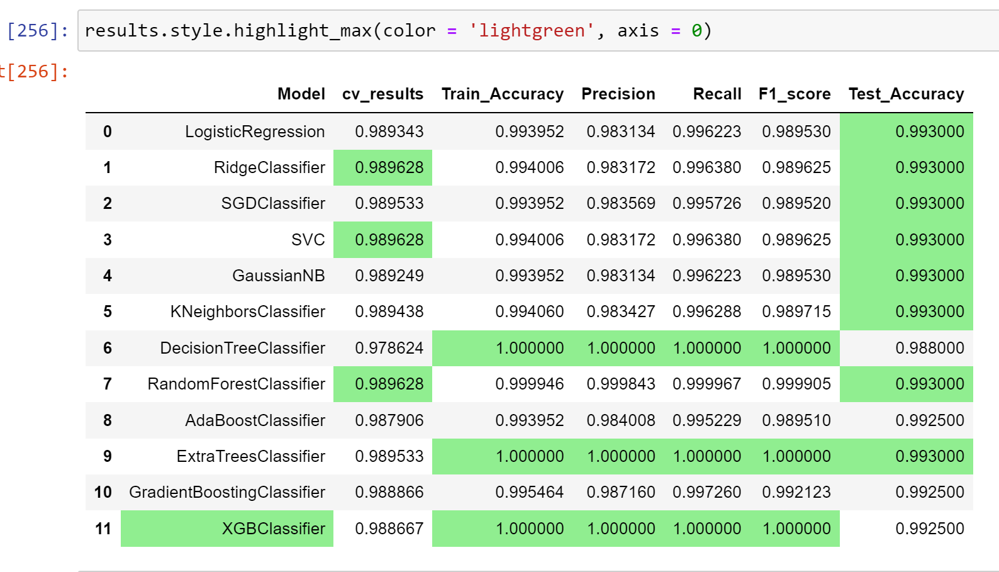

## Handling Imbalanced dataset

In [257]:
X

,numeric_processor__ApprovalFY,numeric_processor__Term,numeric_processor__NoEmp,numeric_processor__CreateJob,numeric_processor__RetainedJob,numeric_processor__DisbursementGross,numeric_processor__ChgOffPrinGr,numeric_processor__GrAppv,numeric_processor__SBA_Appv,numeric_processor__Newbusiness,numeric_processor__ApprovalDate_Year,numeric_processor__ApprovalDate_Month,numeric_processor__ApprovalDate_Day,numeric_processor__DisbursementDate_Year,numeric_processor__DisbursementDate_Month,numeric_processor__DisbursementDate_Day,numeric_processor__ChgOffDate_Year,numeric_processor__ChgOffDate_Month,numeric_processor__ChgOffDate_Day,numeric_processor__missingindicator_Newbusiness,numeric_processor__missingindicator_DisbursementDate_Year,numeric_processor__missingindicator_DisbursementDate_Month,numeric_processor__missingindicator_DisbursementDate_Day,numeric_processor__missingindicator_ChgOffDate_Year,numeric_processor__missingindicator_ChgOffDate_Month,numeric_processor__missingindicator_ChgOffDate_Day,categorical_processor__City_HOUSTON,categorical_processor__City_LOS ANGELES,categorical_processor__City_infrequent_sklearn,categorical_processor__State_California,categorical_processor__State_Colorado,categorical_processor__State_Florida,categorical_processor__State_Georgia,categorical_processor__State_Illinois,categorical_processor__State_Massachusetts,categorical_processor__State_Minnesota,categorical_processor__State_New Jersey,categorical_processor__State_New York,categorical_processor__State_Ohio,categorical_processor__State_Pennsylvania,categorical_processor__State_Texas,categorical_processor__State_Washington,categorical_processor__State_Wisconsin,categorical_processor__State_infrequent_sklearn,categorical_processor__Bank_BANK OF AMERICA NATL ASSOC,categorical_processor__Bank_BBCN BANK,categorical_processor__Bank_CAPITAL ONE NATL ASSOC,categorical_processor__Bank_CITIZENS BANK NATL ASSOC,categorical_processor__Bank_JPMORGAN CHASE BANK NATL ASSOC,categorical_processor__Bank_KEYBANK NATIONAL ASSOCIATION,categorical_processor__Bank_MANUFACTURERS & TRADERS TR CO,"categorical_processor__Bank_PNC BANK, NATIONAL ASSOCIATION","categorical_processor__Bank_READYCAP LENDING, LLC",categorical_processor__Bank_THE HUNTINGTON NATIONAL BANK,categorical_processor__Bank_U.S. BANK NATIONAL ASSOCIATION,categorical_processor__Bank_WELLS FARGO BANK NATL ASSOC,categorical_processor__Bank_ZIONS FIRST NATIONAL BANK,categorical_processor__Bank_infrequent_sklearn,categorical_processor__BankState_California,categorical_processor__BankState_Delaware,categorical_processor__BankState_Illinois,categorical_processor__BankState_Minnesota,categorical_processor__BankState_New York,categorical_processor__BankState_North Carolina,categorical_processor__BankState_Ohio,categorical_processor__BankState_Pennsylvania,categorical_processor__BankState_Rhode Island,categorical_processor__BankState_South Dakota,categorical_processor__BankState_Texas,categorical_processor__BankState_Utah,categorical_processor__BankState_Virginia,categorical_processor__BankState_Wisconsin,categorical_processor__BankState_infrequent_sklearn,categorical_processor__NAICS_Accommodation and food services,categorical_processor__NAICS_Administrative and support and waste management and remediation services,"categorical_processor__NAICS_Arts, entertainment, and recreation",categorical_processor__NAICS_Construction,categorical_processor__NAICS_Health care and social assistance,categorical_processor__NAICS_Information,categorical_processor__NAICS_Manufacturing,categorical_processor__NAICS_Other services (except public administration),"categorical_processor__NAICS_Professional, scientific, and technical services",categorical_processor__NAICS_Real estate and rental and leasing,categorical_processor__NAICS_Retail trade,categorical_processor__NAICS_Transportation and warehousing,categorical_processor__NAICS_Unknown,categorical_processor__NAICS_Wholesale trade,categorical_processor__NAICS_infrequent_sklearn,

In [258]:
y

0        1.0
1        1.0
2        1.0
3        1.0
4        0.0
        ... 
18512    1.0
18513    1.0
18514    1.0
18515    1.0
18516    0.0
Name: target, Length: 18517, dtype: float64

In [259]:
y.value_counts()

1.0    15330
0.0     3187
Name: target, dtype: int64

In [260]:
y.value_counts(normalize=True)

1.0    0.827888
0.0    0.172112
Name: target, dtype: float64

In [261]:
smote = SMOTE(sampling_strategy='minority',random_state=5,n_jobs=-1)
X_res, y_res = smote.fit_resample(X, y)

In [262]:
X_res

,numeric_processor__ApprovalFY,numeric_processor__Term,numeric_processor__NoEmp,numeric_processor__CreateJob,numeric_processor__RetainedJob,numeric_processor__DisbursementGross,numeric_processor__ChgOffPrinGr,numeric_processor__GrAppv,numeric_processor__SBA_Appv,numeric_processor__Newbusiness,numeric_processor__ApprovalDate_Year,numeric_processor__ApprovalDate_Month,numeric_processor__ApprovalDate_Day,numeric_processor__DisbursementDate_Year,numeric_processor__DisbursementDate_Month,numeric_processor__DisbursementDate_Day,numeric_processor__ChgOffDate_Year,numeric_processor__ChgOffDate_Month,numeric_processor__ChgOffDate_Day,numeric_processor__missingindicator_Newbusiness,numeric_processor__missingindicator_DisbursementDate_Year,numeric_processor__missingindicator_DisbursementDate_Month,numeric_processor__missingindicator_DisbursementDate_Day,numeric_processor__missingindicator_ChgOffDate_Year,numeric_processor__missingindicator_ChgOffDate_Month,numeric_processor__missingindicator_ChgOffDate_Day,categorical_processor__City_HOUSTON,categorical_processor__City_LOS ANGELES,categorical_processor__City_infrequent_sklearn,categorical_processor__State_California,categorical_processor__State_Colorado,categorical_processor__State_Florida,categorical_processor__State_Georgia,categorical_processor__State_Illinois,categorical_processor__State_Massachusetts,categorical_processor__State_Minnesota,categorical_processor__State_New Jersey,categorical_processor__State_New York,categorical_processor__State_Ohio,categorical_processor__State_Pennsylvania,categorical_processor__State_Texas,categorical_processor__State_Washington,categorical_processor__State_Wisconsin,categorical_processor__State_infrequent_sklearn,categorical_processor__Bank_BANK OF AMERICA NATL ASSOC,categorical_processor__Bank_BBCN BANK,categorical_processor__Bank_CAPITAL ONE NATL ASSOC,categorical_processor__Bank_CITIZENS BANK NATL ASSOC,categorical_processor__Bank_JPMORGAN CHASE BANK NATL ASSOC,categorical_processor__Bank_KEYBANK NATIONAL ASSOCIATION,categorical_processor__Bank_MANUFACTURERS & TRADERS TR CO,"categorical_processor__Bank_PNC BANK, NATIONAL ASSOCIATION","categorical_processor__Bank_READYCAP LENDING, LLC",categorical_processor__Bank_THE HUNTINGTON NATIONAL BANK,categorical_processor__Bank_U.S. BANK NATIONAL ASSOCIATION,categorical_processor__Bank_WELLS FARGO BANK NATL ASSOC,categorical_processor__Bank_ZIONS FIRST NATIONAL BANK,categorical_processor__Bank_infrequent_sklearn,categorical_processor__BankState_California,categorical_processor__BankState_Delaware,categorical_processor__BankState_Illinois,categorical_processor__BankState_Minnesota,categorical_processor__BankState_New York,categorical_processor__BankState_North Carolina,categorical_processor__BankState_Ohio,categorical_processor__BankState_Pennsylvania,categorical_processor__BankState_Rhode Island,categorical_processor__BankState_South Dakota,categorical_processor__BankState_Texas,categorical_processor__BankState_Utah,categorical_processor__BankState_Virginia,categorical_processor__BankState_Wisconsin,categorical_processor__BankState_infrequent_sklearn,categorical_processor__NAICS_Accommodation and food services,categorical_processor__NAICS_Administrative and support and waste management and remediation services,"categorical_processor__NAICS_Arts, entertainment, and recreation",categorical_processor__NAICS_Construction,categorical_processor__NAICS_Health care and social assistance,categorical_processor__NAICS_Information,categorical_processor__NAICS_Manufacturing,categorical_processor__NAICS_Other services (except public administration),"categorical_processor__NAICS_Professional, scientific, and technical services",categorical_processor__NAICS_Real estate and rental and leasing,categorical_processor__NAICS_Retail trade,categorical_processor__NAICS_Transportation and warehousing,categorical_processor__NAICS_Unknown,categorical_processor__NAICS_Wholesale trade,categorical_processor__NAICS_infrequent_sklearn,

In [263]:
y_res

0        1.0
1        1.0
2        1.0
3        1.0
4        0.0
        ... 
30655    0.0
30656    0.0
30657    0.0
30658    0.0
30659    0.0
Name: target, Length: 30660, dtype: float64

In [264]:
y_res.value_counts()

1.0    15330
0.0    15330
Name: target, dtype: int64

In [265]:
results2 = pd.DataFrame(index=None, columns=['Model','cv_results','Train_Accuracy','Precision','Recall','F1_score','Test_Accuracy'])

for mod in models:
    name = mod[0]
    model = mod[1]
    cv_results = cross_val_score(model, X_res, y_res, cv=3, scoring='f1_macro',n_jobs=-1).mean()
    model.fit(X_res, y_res)
    y_train_pred = model.predict(X_res)
    train_score = accuracy_score(y_res,y_train_pred)
    
    precision = precision_score(y_res,y_train_pred,average='macro')
    recall = recall_score(y_res,y_train_pred,average='macro')
    f1 = f1_score(y_res,y_train_pred,average='macro')
    
    print(name)
    print(classification_report(y_res,y_train_pred))
    
    y_test_pred = model.predict(X_test)
    test_score = accuracy_score(y_test,y_test_pred)
            
    results2 = results2.append(pd.Series({'Model':name,'cv_results':cv_results,'Train_Accuracy':train_score,'Precision':precision,'Recall':recall,'F1_score':f1,'Test_Accuracy':test_score}),ignore_index=True )

LogisticRegression
              precision    recall  f1-score   support

         0.0       0.99      1.00      1.00     15330
         1.0       1.00      0.99      1.00     15330

    accuracy                           1.00     30660
   macro avg       1.00      1.00      1.00     30660
weighted avg       1.00      1.00      1.00     30660

RidgeClassifier
              precision    recall  f1-score   support

         0.0       0.99      1.00      1.00     15330
         1.0       1.00      0.99      1.00     15330

    accuracy                           1.00     30660
   macro avg       1.00      1.00      1.00     30660
weighted avg       1.00      1.00      1.00     30660

SGDClassifier
              precision    recall  f1-score   support

         0.0       0.99      1.00      1.00     15330
         1.0       1.00      0.99      1.00     15330

    accuracy                           1.00     30660
   macro avg       1.00      1.00      1.00     30660
weighted avg       1.00  

In [266]:
results2

,Model,cv_results,Train_Accuracy,Precision,Recall,F1_score,Test_Accuracy
0,LogisticRegression,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
1,RidgeClassifier,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
2,SGDClassifier,0.996184,0.99638,0.996406,0.99638,0.99638,0.993
3,SVC,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
4,GaussianNB,0.996151,0.996151,0.996174,0.996151,0.996151,0.993
5,KNeighborsClassifier,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
6,DecisionTreeClassifier,0.988712,1.0,1.0,1.0,1.0,0.988
7,RandomForestClassifier,0.996347,1.0,1.0,1.0,1.0,0.993
8,AdaBoostClassifier,0.990148,0.996086,0.996101,0.996086,0.996086,0.991
9,ExtraTreesClassifier,0.99638,1.0,1.0,1.0,1.0,0.993


In [267]:
results2.style.highlight_max(color = 'lightgreen', axis = 0)

,Model,cv_results,Train_Accuracy,Precision,Recall,F1_score,Test_Accuracy
0,LogisticRegression,0.996380,0.996380,0.996406,0.996380,0.996380,0.993000
1,RidgeClassifier,0.996380,0.996380,0.996406,0.996380,0.996380,0.993000
2,SGDClassifier,0.996184,0.996380,0.996406,0.996380,0.996380,0.993000
3,SVC,0.996380,0.996380,0.996406,0.996380,0.996380,0.993000
4,GaussianNB,0.996151,0.996151,0.996174,0.996151,0.996151,0.993000
5,KNeighborsClassifier,0.996380,0.996380,0.996406,0.996380,0.996380,0.993000
6,DecisionTreeClassifier,0.988712,1.000000,1.000000,1.000000,1.000000,0.988000
7,RandomForestClassifier,0.996347,1.000000,1.000000,1.000000,1.000000,0.993000
8,AdaBoostClassifier,0.990148,0.996086,0.996101,0.996086,0.996086,0.991000
9,ExtraTreesClassifier,0.996380,1.000000,1.000000,1.000000,1.000000,0.993000


In [268]:
results2.sort_values(by='Test_Accuracy',ascending=False)

,Model,cv_results,Train_Accuracy,Precision,Recall,F1_score,Test_Accuracy
0,LogisticRegression,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
1,RidgeClassifier,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
2,SGDClassifier,0.996184,0.99638,0.996406,0.99638,0.99638,0.993
3,SVC,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
4,GaussianNB,0.996151,0.996151,0.996174,0.996151,0.996151,0.993
5,KNeighborsClassifier,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
7,RandomForestClassifier,0.996347,1.0,1.0,1.0,1.0,0.993
9,ExtraTreesClassifier,0.99638,1.0,1.0,1.0,1.0,0.993
11,XGBClassifier,0.994488,1.0,1.0,1.0,1.0,0.993
8,AdaBoostClassifier,0.990148,0.996086,0.996101,0.996086,0.996086,0.991


In [269]:
results2.sort_values(by='cv_results',ascending=False)

,Model,cv_results,Train_Accuracy,Precision,Recall,F1_score,Test_Accuracy
0,LogisticRegression,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
1,RidgeClassifier,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
3,SVC,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
5,KNeighborsClassifier,0.99638,0.99638,0.996406,0.99638,0.99638,0.993
9,ExtraTreesClassifier,0.99638,1.0,1.0,1.0,1.0,0.993
7,RandomForestClassifier,0.996347,1.0,1.0,1.0,1.0,0.993
2,SGDClassifier,0.996184,0.99638,0.996406,0.99638,0.99638,0.993
4,GaussianNB,0.996151,0.996151,0.996174,0.996151,0.996151,0.993
11,XGBClassifier,0.994488,1.0,1.0,1.0,1.0,0.993
10,GradientBoostingClassifier,0.993411,0.997489,0.997499,0.997489,0.997489,0.991


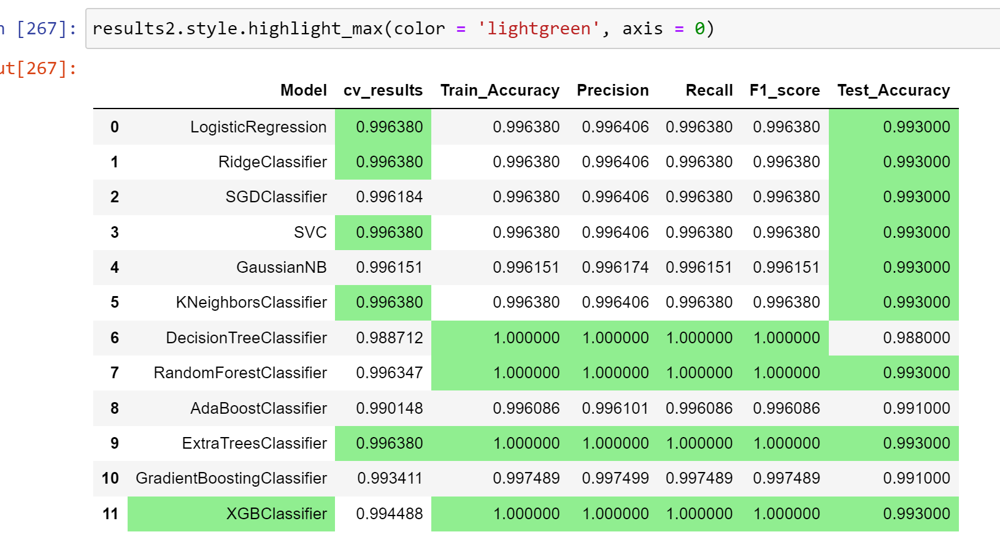

## Hyperparameter Tuning

In [ ]:
model_params = {
    'svc': {
        'model': SVC(),
        'params' : {
            'C': [1,5,10,15,20,25],
            'kernel': ['rbf','linear','poly','sigmoid'],
            'gamma':['scale','auto']
        }  
    },
    'random_forest': {
        'model': RandomForestClassifier(bootstrap=True,oob_score=True,n_jobs=-1),
        'params' : {
            'n_estimators': [200,400,600,800,1000],
            'max_depth':[20,25,30,35]
        }
    },
    'GB_clf': {
        'model': GradientBoostingClassifier(),
        'params' : {
            'learning_rate': list(np.linspace(0.01, 0.19, num=5)),
            'n_estimators': [600,800,1000,1500,2000],
            'max_depth':[4,6,8,10,15]
        }  
    },
    'XGB_clf': {
        'model': XGBClassifier(),
        'params' : {
            'learning_rate': list(np.linspace(0.01, 0.19, num=5)),
            'n_estimators': [600,800,1000,1500,2000],
            'max_depth':[4,6,8,10,15]
        }  
    },
    'AdaBoost_clf': {
        'model': AdaBoostClassifier(),
        'params' : {
            'n_estimators': [300,350,400,500,600],
            'learning_rate': list(np.linspace(0.01, 0.19, num=5)),
        }  
    },
    'ExtraTrees_clf': {
        'model': ExtraTreesClassifier(),
        'params' : {
            'n_estimators': [600,800,1000,1500,2000],
            'max_depth':[4,6,8,10,15]
        }  
    }
}

In [ ]:
results3 = pd.DataFrame(index=None, columns=['Model','cv_results','Train_Accuracy','Precision','Recall','F1_score',
                                            'Test_Accuracy'])

for model_name, mp in model_params.items():
    clf =  GridSearchCV(mp['model'], mp['params'], cv=3,scoring='f1_macro',n_jobs=-1)
    clf.fit(X_res, y_res)
    
    print(model_name+' - '+str(np.round(clf.best_score_,6)))
    print(clf.best_params_)
    
    y_train_pred = clf.predict(X_res)
    train_score = accuracy_score(y_res,y_train_pred)
    
    precision = precision_score(y_res,y_train_pred,average='macro')
    recall = recall_score(y_res,y_train_pred,average='macro')
    f1 = f1_score(y_res,y_train_pred,average='macro')
    print(classification_report(y_res,y_train_pred))

    y_test_pred = clf.predict(X_test)
    test_score = accuracy_score(y_test,y_test_pred)
    
    print('train_score - ',train_score)
    print('test_score - ',test_score)
    
    results3 = results3.append(pd.Series({'Model':model_name,'cv_results':clf.best_score_,'Train_Accuracy':train_score,'Precision':precision,
                                        'Recall':recall,'F1_score':f1,'Test_Accuracy':test_score}),ignore_index=True )

In [ ]:
results3

In [ ]:
results3.style.highlight_max(color = 'lightgreen', axis = 0)

### 1.Handling Missing values

### All the techniques of handling Missing values

### For Numerical Features
1. Mean, Median,Mode replacement
2. Random Sample Imputation
3. Capturing NAN values with a new feature
4. End of Distribution imputation
5. Arbitrary imputation

### For Categorical Features
6. Frequent categories imputation
7. If too many are missing, Impute with new category 'Missing'
8. Capturing NAN values with a new feature

In [ ]:
print(train_df[categorical_features].columns)
print(len(train_df[categorical_features].columns))

In [ ]:
print(train_df[numerical_features].columns)
print(len(train_df[numerical_features].columns))

In [ ]:
# prints the no.of null values in each feature
# prints the % of null values in each feature

df_cat = train_df[categorical_features]

total = df_cat.isnull().sum().sort_values(ascending=False)
percent = np.round_(((df_cat.isnull().sum()/df_cat.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head()

#### We dont have any null values in categorical_features (less work)

In [ ]:
df_num = train_df[numerical_features]

total = df_num.isnull().sum().sort_values(ascending=False)
percent = np.round_(((df_num.isnull().sum()/df_num.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head()

In [ ]:
# Drop only if NaN in 'Engine' column you know the reason

train_df = train_df.dropna(subset = ['Engine'])

In [ ]:
df_cat = train_df[categorical_features]

total = df_cat.isnull().sum().sort_values(ascending=False)
percent = np.round_(((df_cat.isnull().sum()/df_cat.isnull().count())*100),decimals=2).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head()

In [ ]:
num_features_nan=[feature for feature in train_df.columns if train_df[feature].isnull().sum()>0 and train_df[feature].dtypes!='O']
print(num_features_nan)
print(len(num_features_nan))

In [ ]:
## Replacing the numerical Missing Values

for feature in num_features_nan:
    
    ## We will replace by using median since there are outliers
    median_value=train_df[feature].median()
    
    print(feature,train_df[feature].median())
    
    ## create a new feature to capture nan values
    train_df[feature+'_nan']=np.where(train_df[feature].isnull(),1,0)
    train_df[feature].fillna(median_value,inplace=True)
    
train_df[num_features_nan].isnull().sum()

In [ ]:
train_df.head(20)

### 2.Handling Rare Categorical Feature

We will remove categorical variables that are present less than 1% of the observations

In [ ]:
train_df[categorical_features].nunique()

In [ ]:
# We want to perform this operation only on 'Model' because there are too many models. we gonna keep the brands as they are.

In [ ]:
temp=train_df.groupby('Model')['Price'].count()/len(train_df)
temp_df=temp[temp>0.01].index
print(temp_df)
train_df['Model']=np.where(train_df['Model'].isin(temp_df),train_df['Model'],'Rare_var')

In [ ]:
train_df[categorical_features].nunique()

In [ ]:
for col in categorical_features:
    print(col,(train_df[col] == 'Rare_var').sum())

In [ ]:
train_df[categorical_features]

### 3.Handling Ouliers 

In [ ]:
continuous_features

In [ ]:
for col in continuous_features:
    print(col)
    #plt.figure(figsize = (35,8))
    #plt.subplot(1, 2, 1)
    sns.scatterplot(data=train_df, x=col,y='Price')
    plt.xlabel(col)
    plt.ylabel('Price')
    #plt.subplot(1, 2, 2)
    #sns.lineplot(data=train_df, x=train_df[col], y="Price",estimator=np.median)
    plt.show()

In [ ]:
for col in continuous_features:
    print(col)
    #plt.figure(figsize = (35,8))
    #plt.subplot(1, 2, 1)
    sns.boxplot(x=train_df[col])
    plt.xlabel(col)
    plt.ylabel('Price')
    #plt.subplot(1, 2, 2)
    #sns.lineplot(data=train_df, x=train_df[col], y="Price",estimator=np.median)
    plt.show()

In [ ]:
discrete_features

In [ ]:
for col in discrete_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    plt.figure(figsize = (18,5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(data=train_df, x=col,y='Price')
    plt.xlabel(col)
    plt.ylabel('count')
    plt.subplot(1, 2, 2)
    sns.boxplot(x=train_df[col])
    plt.show()

#### Its not always a good idea to remove outliers because we lose the training data and our model wont be robust (thumb rule always our model should be generalized) to the test data when there are outliers in train data..
#### The best way is to handle them
#### Ofcourse Linear Models will be sensitive to outliers like Linear Regression,L1,L2,Polynomial ,SVM regressors but the non-linear models like DT,ensemble models are not sensitive to the outliers

#### We gonna remove very few oulier data point based on some conditions because we gonna try Linear models initially 

#### Out of all continuous features 'Mileage' is the one close to Normal distribution. the rest are skewed(['Kilometers_Driven','Engine','Power','Price'])

In [ ]:
uppper_boundary=train_df['Mileage'].mean() + 3* train_df['Mileage'].std()
lower_boundary=train_df['Mileage'].mean() - 3* train_df['Mileage'].std()
print(lower_boundary), print(uppper_boundary),print(train_df['Mileage'].mean())

In [ ]:
train_df.loc[train_df['Mileage']>=30.8]

In [ ]:
train_df.loc[train_df['Mileage']>=30.8].shape

In [ ]:
# From above we can see that there 13 instances falling out of 3rd standard deviation. 
# And these 13 also not so deviated all are under 34 so we gonna leave those. 

In [ ]:
for col in continuous_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    print('no.of zeros :',(train_df[col]==0).sum())
    print('% of zeros :',np.round_((train_df[col]==0).sum()/len(train_df)*100,decimals=2))
    print('no.of nulls :',train_df[col].isna().sum())
    print('% of nulls :',np.round_(train_df[col].isna().sum()/len(train_df)*100,decimals=2))
    plot_comparison(train_df, train_df[col], col)

In [ ]:
continuous_features

In [ ]:
#### Lets compute the Interquantile range to calculate the boundaries

for col in ['Kilometers_Driven', 'Engine', 'Power']:
    IQR=train_df[col].quantile(0.75)-train_df[col].quantile(0.25)
    lower_bridge=train_df[col].quantile(0.25)-(IQR*1.5)
    upper_bridge=train_df[col].quantile(0.75)+(IQR*1.5)
    print(col), print(train_df[col].median(), lower_bridge, upper_bridge)

In [ ]:
train_df['Power'].median()

In [ ]:
#### Extreme outliers

for col in ['Kilometers_Driven', 'Engine', 'Power', 'Price']:
    IQR=train_df[col].quantile(0.75)-train_df[col].quantile(0.25)
    lower_bridge=train_df[col].quantile(0.25)-(IQR*3)
    upper_bridge=train_df[col].quantile(0.75)+(IQR*3)
    print(col), print(train_df[col].median(), lower_bridge, upper_bridge)

In [ ]:
train_df.loc[(train_df['Kilometers_Driven']>=131551.75)].shape

In [ ]:
train_df.loc[(train_df['Kilometers_Driven']>=190103.5)].shape

In [ ]:
train_df.loc[(train_df['Kilometers_Driven']>=190103.5)].sort_values(by=['Kilometers_Driven'],ascending=False)

In [ ]:
train_df.loc[(train_df['Kilometers_Driven']>=190103.5), 'Kilometers_Driven'] = 190103.5

In [ ]:
train_df.loc[(train_df['Kilometers_Driven']>190103.5)].shape

In [ ]:
train_df['Engine'].hist()

In [ ]:
train_df.loc[(train_df['Engine']>=3163.0)].shape

In [ ]:
train_df.loc[(train_df['Engine']>=4342.0)].shape

In [ ]:
train_df.loc[(train_df['Engine']>=4342.0)].sort_values(by=['Engine'],ascending=False)

In [ ]:
train_df.loc[(train_df['Engine']>=4342.0),'Engine'] = 4342.0

In [ ]:
train_df.loc[(train_df['Engine']>4342.0)].shape

In [ ]:
train_df.loc[(train_df['Power']>=229.75)].shape

In [ ]:
train_df.loc[(train_df['Power']>=321.4)].shape

In [ ]:
train_df.loc[(train_df['Power']>=321.4)].sort_values(by=['Power'],ascending=False)

In [ ]:
train_df.loc[(train_df['Power']>=321.4),'Power'] = 321.4

In [ ]:
train_df.loc[(train_df['Power']>321.4)].shape

### 4.Feature transformation

#### Linear models assumes that the data is normally disrtibutes
#### The Goal of Feature transformation is to convert non-normal distributed features into normal distribution

In [ ]:
train_df[continuous_features].columns

In [ ]:
transform_features = ['Kilometers_Driven', 'Mileage', 'Engine', 'Power', 'Price']

In [ ]:
skew = []
for col in transform_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    skew.append(train_df[col].skew())
print('avg_skew : ',round(sum(skew)/len(skew), 2))

In [ ]:
train_df

In [ ]:
def get_avg_skew(df,features):
    skew = []
    for col in features:
        skew.append(np.absolute(df[col].skew()))   
    return round(sum(skew)/len(skew), 2)

In [ ]:
get_avg_skew(train_df,transform_features)

In [ ]:
def plot_data(train_df,feature):
    plt.figure(figsize=(18,6))
    plt.subplot(1,2,1)
    train_df[feature].hist()
    plt.subplot(1,2,2)
    stat.probplot(train_df[feature],dist='norm',plot=pylab)
    plt.show()

In [ ]:
#log transformation 
#log1p Calculates log(1 + x).

log_df = train_df.copy()
for col in transform_features:
    log_df[col]=np.log1p(log_df[col])
get_avg_skew(log_df,transform_features)

In [ ]:
#boxcox transformation

bc_df = train_df.copy()
for col in transform_features:
    bc_df[col],parameters=stat.boxcox(bc_df[col]+1)
get_avg_skew(bc_df,transform_features)

In [ ]:
#reciprocal transformation

rp_df = train_df.copy()
for col in transform_features:
    rp_df[col]=1/(rp_df[col]+1)
get_avg_skew(rp_df,transform_features)

In [ ]:
#square root transformation

sq_df = train_df.copy()
for col in transform_features:
    sq_df[col]=(sq_df[col]+1)**(1/2)
get_avg_skew(sq_df,transform_features)

In [ ]:
#exponential transformation

ex_df = train_df.copy()
for col in transform_features:
    ex_df[col]=(ex_df[col]+1)**(1/1.2)
get_avg_skew(ex_df,transform_features)

In [ ]:
for col in transform_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    plot_data(train_df,col)

In [ ]:
#From above boxcox seems giving the least avg skew of features.I am not sure is this a good practice to follow but it's working for now.

In [ ]:
for col in transform_features:
    print(col)
    print('Skew :', round(bc_df[col].skew(), 2))
    plot_data(bc_df,col)

In [ ]:
## seems boxcox is giving us the best transformation so will go with that
## boxcox only takes positive values and the +1 is to handle the zero's in the data

for col in transform_features:
    if col == 'Price':
        train_df[col],parameters=stat.boxcox(train_df[col]+1)
        Price_Lambda = parameters
        print('Price Lambda : ',Price_Lambda)
    else:
        train_df[col],parameters=stat.boxcox(train_df[col]+1)
    
train_df.head(20)

In [ ]:
skew = []
for col in transform_features:
    print(col)
    print('Skew :', round(train_df[col].skew(), 2))
    skew.append(train_df[col].skew())
print('avg_skew : ',round(sum(skew)/len(skew), 2))

### 5.Categorical Feature Encoding

1. One Hot Encoding
2. Frequent labels one hot encoding (10 or 15)
3. Label encoding
4. count or frequency encoding
5. Target Guided Ordinal Encoding
6. Target Mean Encoding

In [ ]:
print(categorical_features)
print(len(categorical_features))

In [ ]:
print(discrete_features)
print(len(discrete_features))

In [ ]:
## we gonna leave all the discrete variables as they are becoz all are ordinal variables means if the value is more it has a more effect on target variable
## here take ['Car_Age', 'Seats'] if these variable values are more there is a definite positive effect on Price. there is exception for Seats becoz high price 
## cars have 2 seats but thats ok the info will be there in other features like brand

## any way in feature scaling they all come under on scale

In [ ]:
train_df[categorical_features].nunique()

In [ ]:
train_df['Model'].value_counts().plot.bar()

In [ ]:
# We will not go with one hot encoding here becoz too many feature will get generated and its a curse of dimentionality

# i think its a good idea to go with Target Encoding becoz the individual categories will get the respective wieghts according to their predictive power
# initially i wanted to go with Mean encoding but it will become too spesific for train data rather Target encoding and model will overfit

### Target Guided Ordinal Encoding

In [ ]:
categorical_features

In [ ]:
for col in categorical_features:  
    ordinal_labels=train_df.groupby([col])['Price'].mean().sort_values().index
    ordinal_labels2={k:i for i,k in enumerate(ordinal_labels,1)}
    train_df[col]=train_df[col].map(ordinal_labels2)
train_df.head(20)

In [ ]:
train_df.shape

### 6.Feature scaling

In [ ]:
from sklearn.preprocessing import RobustScaler

In [ ]:
features_to_scale = [feature for feature in train_df.columns if feature not in ['Price']]
print(features_to_scale)

In [ ]:
scaler=RobustScaler()
train_df_robust_scaler=pd.DataFrame(scaler.fit_transform(train_df[features_to_scale]),columns=train_df[features_to_scale].columns)

In [ ]:
train_df_robust_scaler.head(20)

In [ ]:
train_df_robust_scaler.shape

In [ ]:
train_df = pd.concat([pd.DataFrame(scaler.transform(train_df[features_to_scale]), columns=features_to_scale),
                     train_df[['Price']].reset_index(drop=True)],
                     axis=1)

In [ ]:
train_df.head(20)

### 7.Imbalanced dataset

In [ ]:
## Its the one main issue in classification problems where target classes are imbalanced
## ex: heart attack classification dataset contains 5000 records/observation
## but in that 372 are positive(there is a Heart attack) class and the rest 4628 are negative class(there is no heart attack)
## in that case the model will more likely to predict the test record as false class means model is baised towards the majority class


## when it comes to regressin problems like price prediction we dont have that problem becoz we are predicting continuous value not a class label
## but we need to make sure that the Target variable here the Price must be close to Normal distribution becoz linear models assumes variables are Normally distributed

In [ ]:
from scipy.special import boxcox, inv_boxcox

df['SalePrice'].to_numpy()

In [ ]:
#y = boxcox(df['SalePrice'].to_numpy(), SalePrice_Lambda)
SalePrice_Lambda = -0.10000692036172426
inv_boxcox(df['SalePrice'].to_numpy(), SalePrice_Lambda)

In [ ]:
pd.DataFrame(inv_boxcox(df['SalePrice'].to_numpy(), SalePrice_Lambda), columns = ['SalePrice'])

In [ ]:
train_df.head()

In [ ]:
train_df.shape

In [ ]:
X_train = train_df.iloc[ : , :-1]
y_train = train_df.iloc[ : ,-1]

In [ ]:
X_train.head()

In [ ]:
X_train.shape

In [ ]:
y_train

In [ ]:
y_train.shape